<a href="https://colab.research.google.com/github/acse-moj20/msc-irp/blob/main/PredGAN.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

**Prediction using GANs For Fluid Problem** 

This notebook contains the workflow, development code and some results of the PredGAN for 2D turbulent fluid modelling completed as an independent research component of the M.Sc. degree in [Applied Computational Science and Engineering](https://www.imperial.ac.uk/earth-science/prosp-students/pg-courses/applied-computational-msc/) at Royal School of Mines at Imperial College London (ICL).

The project was part of the Applied Modelling and Computational Group @ ICL and was supervised by :
- Prof Christopher Pain
- Dr. Claire E. Heaney
- Vinicius Santos Silva 

This notebook is divided in sections that included data preprocessing tasks, core code body and results visualization. Part of this project is the data assimilation of sensor data. For more information about this and the rest of the work, here is a link to the report completed alongside this code development. More details can also be found in the [github repository](https://github.com/acse-moj20/msc-irp)



Contact: Mustapha Jolaade, moj20@ic.ac.uk

September 02, 2021





*Required environment and packages*

In [ ]:
%matplotlib inline
import sys
import os
import sklearn
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib as mpl
import joblib
import functools
import time
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler, MinMaxScaler

# Plot formatting 
mpl.rc('axes', labelsize=14)
mpl.rc('xtick', labelsize=12)
mpl.rc('ytick', labelsize=12)

In [ ]:
import jax
import jax.numpy as jnp  # JAX version of numpy with a very similar API.
try:
  import haiku as hk
except ModuleNotFoundError:
  !pip install dm-haiku
  import haiku as hk
try:
  import optax
except ModuleNotFoundError:
  !pip install optax
  import optax
try:
  import immutabledict
except ModuleNotFoundError:
  !pip install immutabledict
  import immutabledict

     |████████████████████████████████| 309 kB 14.8 MB/s 
     |████████████████████████████████| 136 kB 13.7 MB/s 
     |████████████████████████████████| 72 kB 675 kB/s 


In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


# Processing and memory details

In [ ]:
# ******** GPU Specifications *************
# *****************************************

gpu_info = !nvidia-smi
gpu_info = '\n'.join(gpu_info)
if gpu_info.find('failed') >= 0:
  print('GPU info not found.')
else:
  print(gpu_info)
print('Num of available GPUs: ', len(tf.config.list_physical_devices('GPU')))

# ******** Allocated memmory *************
# ****************************************
from psutil import virtual_memory
ram_gb = virtual_memory().total / 1e9
print()
print('Your runtime has {:.1f} gigabytes of available RAM\n'.format(ram_gb))

if ram_gb < 20:
  print('You are using a high-RAM runtime!')

Sun Apr  3 09:50:50 2022       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.32.03    Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla V100-SXM2...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    23W / 300W |      0MiB / 16160MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

#Utility Functions

Functions used for auxiliary tasks like error calculation, result visualization, data manipulation, etc.

In [ ]:

def calculate_error(data, prediction):
  '''
  Computes the absolute and percentage error between two arrays.
  Arrays must be of equal length.

  Parameters
  ----------
      data : ndarr
          m-by-n array of true values.
      data_recovered : ndarr
          m-by-n array of predicted values.

  Returns
  -------
      max_abs_error (float)
          max absolute error between data and prediction.
      mean_abs_error (float)
          mean absolute error between data and prediction.
  '''
  assert(len(data)==len(prediction))
  abs_error = abs(data - prediction)
  perc_error = abs_error*100/abs(data)
  max_abs_error = np.max(abs_error)
  mean_abs_error = np.mean(abs_error)
  return max_abs_error, mean_abs_error


def plot_vortex(data, times, cols, rows=1, skips=1, c_bar=True, cmap='RdBu'):
  '''
  Visualization of vortices in the spatial domain.

  Parameters
  ----------
      data : ndarr
          m-by-n array of vorticity field.
      times : list
          list of times at which snapshots were captured.
      cols : int
          number of columns in plot.
      rows : int
          number of rows in plot.
      skips : int
          skips/gaps between time snapshots.
      c_bar : bool
          flag to show/hide color bar.
      cmap : str
          color map choice.

  Returns
  -------
      vorticity field visualization.
  '''
  fig, ax = plt.subplots(rows, cols, figsize=[5* cols, 20])
  for i, step in enumerate(times):
    im = ax.flatten()[i].imshow(data[step], cmap=cmap)
    if c_bar:
      cbar = plt.colorbar(im, ax=ax.flatten()[i], shrink=0.15, pad=0.05, panchor=(0.0, 0.0))
    ax.flatten()[i].set_title('t = {}'.format(step*skips), y=1.05, 
                          fontsize=16, fontweight="bold")
   
  plt.show()



def plot_linevortex(data_dict, times, cols, rows=1, skips=1):
  '''
  Visualization of vortices as projected on a 1D domain. 
  Built to compare vortex magnitude between true anf generated. 

  Parameters
  ----------
      data_dict : dict of arr
          dict of true and predicted/generated data.
      times : list
          list of times at which snapshots were captured.
      cols : int
          number of columns in plot.
      rows : int
          number of rows in plot.
      skips : int
          skips/gaps between time snapshots.

  Returns
  -------
      vorticity field visualization in 1D.
  '''
  # use a gray background
  fig, ax = plt.subplots(rows, cols, figsize=[5* cols, 9], sharey='all')
  
  for i, step in enumerate(times):
    #im = ax.flatten()[i].imshow(data[step], cmap=cmap)
    for label in data_dict:
      plot_data = data_dict[label]
      plot_data_1d = plot_data[step].reshape(-1, 1)
      line_plt = ax.flatten()[i].plot(plot_data_1d, label=label)
      
      # Plot max and min locations
      ax.flatten()[i].plot(np.where(plot_data_1d == np.amax(plot_data_1d))[0], 
               np.amax(plot_data_1d), "bo", label='Pos. vortex')
      ax.flatten()[i].plot(np.where(plot_data_1d == np.amin(plot_data_1d))[0], 
               np.amin(plot_data_1d), "ro", label='Neg. vortex')

    if i == 0:
      ax.flatten()[i].legend(loc='best', prop={'size':10})
      ax.flatten()[i].set_ylabel('Magnitude of vortices')
    ax.flatten()[i].set_title('t = {}'.format(step*skips), y=1.05, 
                          fontsize=16, fontweight="bold")
    fig.text(0.5, -0.04, '1D Spatial domain', fontdict={
        'weight': 'normal',
        'size': 14,}, ha='center')
    
    
  plt.show()

def concat_timesteps(X_train, ntimes, step, window_start, window_end, verbose=0):
  '''
  Concatenates time steps in preparation for training and evaluation.

  Parameters
  ----------
      X_train : ndarr
          m-by-n array of training data.
      ntimes : int
          number of snapshots in one time series.
      step : int
          size of gap between sanpshots in time series.
      window_start : int
          start position in trajectory (snapshot set). 
      window_end : int 
          end position in trajectory (snapshot set)

  Returns
  -------
      X_train_concat : ndarr
          array of concatenated time snapshots.
  '''
  X_train_concat = []
  for start, end in zip(window_start, window_end):
    for i in range(start, end+step): 
      X_train_concat.append(X_train[i:i+ntimes*step:step])
      if verbose:
        print('sample starts from {} :'.format(i))
        for j in range(i, i+ntimes*step, step):
          print('{}'.format(j) , end=', ')
        print('\n')
  return np.array(X_train_concat)

def invert_data(X_data, flag=None):
  '''
  Inverts the reduced/transformed data to enable visualization and analysis.

  Parameters
  ----------
      X_data : ndarr
          m-by-n array of true values.
      flag : str
          flag to switch between pca and scaler versions.

  Returns
  -------
      X_pca_inverted : ndarr
          inverted X_data. 

  '''
  if flag=='3':
    X_scale_inverted = scaler3.inverse_transform(X_data)
    X_pca_inverted = pca3.inverse_transform(X_scale_inverted)
  else:
    X_scale_inverted = scaler.inverse_transform(X_data)
    X_pca_inverted = pca.inverse_transform(X_scale_inverted)
  return X_pca_inverted

def transform_data(X_data, flag=None):
  '''
  Transforms the original data to reduced dimension to enable training.

  Parameters
  ----------
      X_data : ndarr
          m-by-n array of true values.
      flag : str
          flag to switch between pca and scaler versions.

  Returns
  -------
      X_pca_scaled : ndarr
          transformed X_data. 

  '''
  X_pca = pca.fit_transform(X_data)
  X_pca_scaled = scaler.fit_transform(X_pca)
  return X_pca_scaled

In [ ]:

# *** Computing vorticity from vector field ***
# *********************************************

def curl(u,v):
  """ 
  Function to calculate the curl of a 2-dimensional vector field.
  Parameters:
  -----------
    u : 2d array of size n*m
      vector component in the x direction.

    v : 2d array of size n*m
      vector component in the y direction
  Output:
  -------
    curl : 2d array of size n*m
      curl of vector field [i.e. (dv/dx)i - (du/dy)j]
  """
  curl = np.gradient(v)[0] - np.gradient(u)[1]
  return curl

def process(data, save=False):
  """ 
  Function to calculate the curl of a 2-dimensional vector field.
  Parameters:
  -----------
    u : 2d array of size n*m
      vector component in the x direction.

    v : 2d array of size n*m
      vector component in the y direction
  Output:
  -------
    curl : 2d array of size n*m
      curl of vector field [i.e. (dv/dx)i - (du/dy)j]
  """
  assert(len(data)>0)
  assert(len(data.shape) > 3)
  size = len(data)

  vorticity = np.zeros_like(data[:,:,:,:,0])
  # placehodler for vorticity 
  start = time.time()
  for i in range(len(data_file)):
    for j in range(len(data_file[0])):
      vorticity[i][j] = curl(data_file[i][j][:, :, 0], data_file[i][j][:, :, 1])
  if save:
    save_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex_' + str(len(data))+'.npy'
    np.save(save_dir, vorticity)
    print(' Processed data saved at: ' + save_dir)
  print('--------- Done in {:.5f}s. -------- '.format( time.time()-start))

In [ ]:
# ********* Data details ***********
# **********************************
mem_load = True
SAVE_DIR = 'drive/MyDrive/MSC_IRP/PredGAN/'

# spatial domain 
nx, ny = 256, 256

# temporal domain
timestep = 50 

num_of_coeff = 292
ntimes = 7 # Consecutive times for the GAN
step = 5 # step between times



#**POD Based Non-Intrusive Reduced Order Modelling**

##Data Details

*   Raw dataset represents the parameter values of u, v and p for 1200 separate examples of the high fidelity solution.
*   Each example is computed over 50 timesteps and a on a 256-by-256 grid.

*   Vorticity over the vector field is obatined by computing the curl of u (x-component velocity vector) and v (y-component velocity vector)


**Note:** Due to memory constraints, only implementation of a fraction of the dataset (100 trajectories - 7GB) is shown here. The workflow does not chnage for a much larger dataset.






In [ ]:
# ==================== LOAD X AND Y COMPONENTS =================================
data_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex1200.npy'
raw_data_trajs = np.memmap(data_dir, mode='r', dtype= np.float64, shape=(300, 50, 256, 256))
raw_data_trajs = raw_data_trajs#[1:] # there is some error in the first trajectory. Unsure what this is so I am omiting it for now.



# ===================== SPLIT TRAJS INTO TRAIN AND TEST ========================
# To avoid data leak, train amd test data should be split prior to PCA and scaling.

raw_train_trajs = raw_data_trajs[:250] # 250 samples for traing and validation 
raw_test_trajs = raw_data_trajs[250:]   # 49 samples for testing 

In [ ]:
# ========================== PRINT DATA DETAILS ================================
print('Size of training dataset:', raw_data_trajs.shape)
print('Size of training dataset:', raw_train_trajs.shape)
print('Size of testing dataset: ', raw_test_trajs.shape)
print('Number of time steps:    ', len(raw_test_trajs[0]))

x_sz = 256
y_sz  = 256

Size of training dataset: (300, 50, 256, 256)
Size of training dataset: (250, 50, 256, 256)
Size of testing dataset:  (50, 50, 256, 256)
Number of time steps:     50


##Dataset visualization

In [ ]:
raw_data_trajs.shape

(299, 50, 256, 256)

In [ ]:
# We want to visualize the trajectory at times: 0, 15, 35 and 49
idx = 1
times = [0, 15, 35, 49]
for idx in range(10):
  plot_vortex(raw_train_trajs[idx], times, cols=4, rows=1)


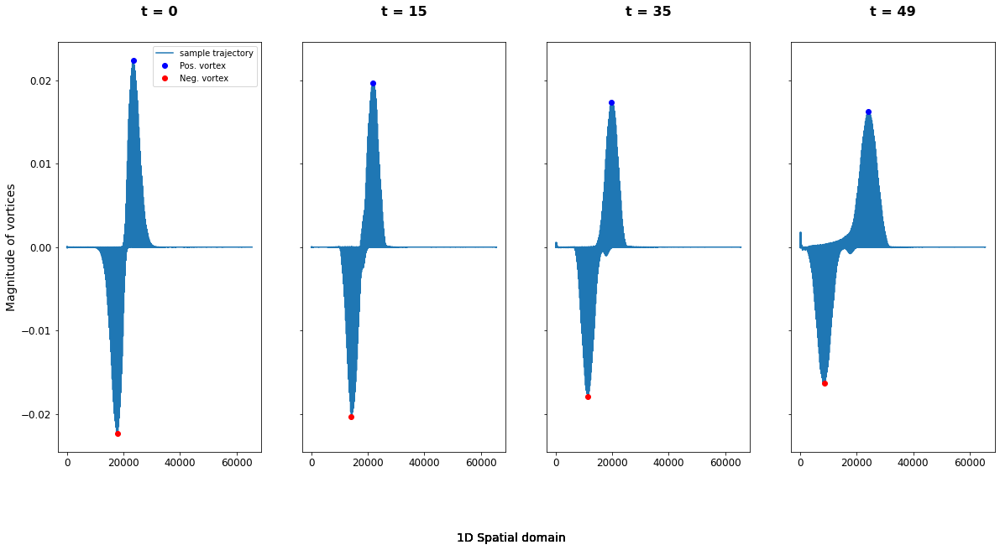

In [ ]:
# We want to visualize the trajectory projected on a linear domain to observe vortices magnitude
plot_linevortex({'sample trajectory': raw_train_trajs[idx]}, times, cols=4, rows=1)

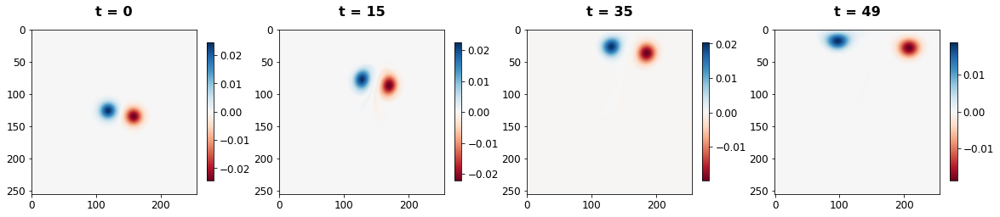

In [ ]:
plot_vortex(raw_test_trajs[idx], times, cols=4, rows=1)

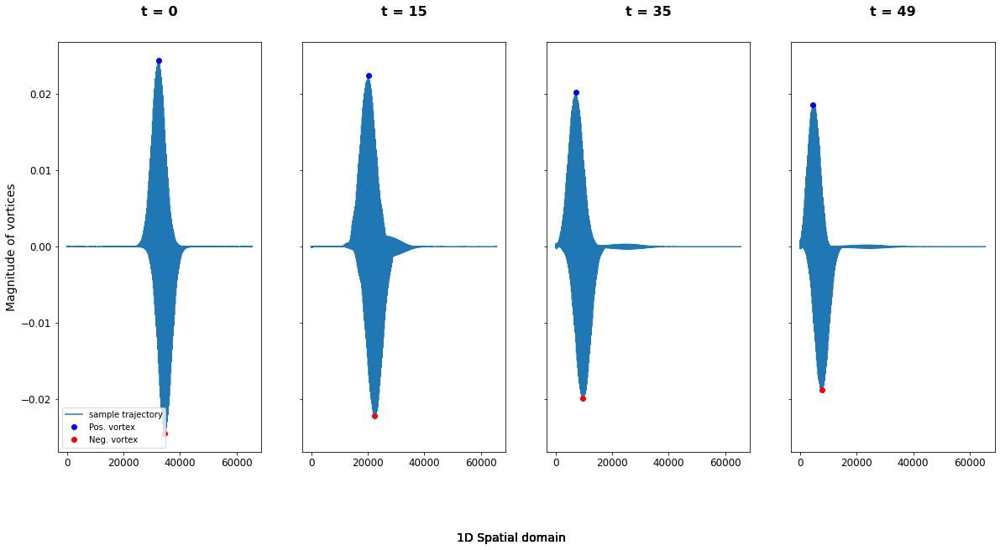

In [ ]:
plot_linevortex({'sample trajectory': raw_test_trajs[idx]}, times, cols=4, rows=1)

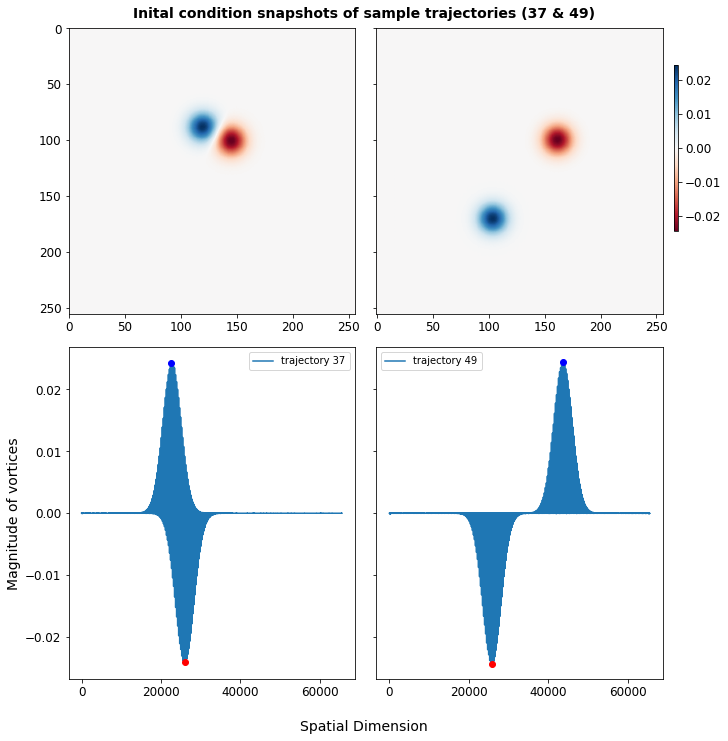

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:34: UserWarning: This figure was using constrained_layout==True, but that is incompatible with subplots_adjust and or tight_layout: setting constrained_layout==False. 


In [ ]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(2, 2, figsize=[10,10], sharex='row', sharey='row', constrained_layout=True)
im = ax.flatten()[0].imshow(raw_train_trajs[37][0], cmap='RdBu')
im = ax.flatten()[1].imshow(raw_train_trajs[49][0], cmap='RdBu')

ax.flatten()[2].plot(raw_train_trajs[37][0].reshape(-1, 1), label='trajectory 37')
ax.flatten()[2].legend()

# Plot max and min locations
ax.flatten()[2].plot(np.where(raw_train_trajs[37][0].reshape(-1, 1) == np.amax(raw_train_trajs[37][0].reshape(-1, 1)))[0], 
          np.amax(raw_train_trajs[37][0].reshape(-1, 1)), "bo", label='Pos. vortex')
ax.flatten()[2].plot(np.where(raw_train_trajs[37][0].reshape(-1, 1) == np.amin(raw_train_trajs[37][0].reshape(-1, 1)))[0], 
          np.amin(raw_train_trajs[37][0].reshape(-1, 1)), "ro", label='Neg. vortex')

ax.flatten()[3].plot(raw_train_trajs[49][0].reshape(-1, 1), label='trajectory 49')
ax.flatten()[3].legend()
ax.flatten()[3].plot(np.where(raw_train_trajs[49][0].reshape(-1, 1) == np.amax(raw_train_trajs[49][0].reshape(-1, 1)))[0], 
          np.amax(raw_train_trajs[49][0].reshape(-1, 1)), "bo", label='Pos. vortex')
ax.flatten()[3].plot(np.where(raw_train_trajs[49][0].reshape(-1, 1) == np.amin(raw_train_trajs[49][0].reshape(-1, 1)))[0], 
          np.amin(raw_train_trajs[49][0].reshape(-1, 1)), "ro", label='Neg. vortex')

fig.text(0.5, -0.04, 'Spatial Dimension', fontdict={
        'weight': 'normal',
        'size': 14,
        }, ha='center')
fig.text(0.5, 0.95,  'Inital condition snapshots of sample trajectories (37 & 49)', fontdict={
        'weight': 'bold',
        'size': 14,
        }, ha='center')
ax[1, 0].set_ylabel('Magnitude of vortices')
fig.colorbar(im, ax=ax[0,:].flatten(), shrink=0.5, pad=0.00, panchor=(0.0, 0.0))
plt.show()

fig.tight_layout()

##Dimensionality reduction - POD/PCA

The training dataset consists of samples of a high-fidelity numerical simulation each with 50 evenly sampled snapshots (in time). Each simulation represents velocity (in x and y directions) and pressure for the turbulent flow model over a region of grid size 256x256. These values can be used to generate a vorticity field for the model. Thus, there is a total number of 256 * 256 = 65,536 variables per time step and a total of 50 * 100 = 5,000 samples. Dimensionality reduction of this high dimensional space is then performed using Principal Component Analysis (PCA) in order to work with a relatively low dimension space. The PCA model uses 292 expansion coefficients that gave > 99.9% variance in the reduction.

###Build PCA Model

First we find the appropriate number of POD expansion coefficients given the requirement to retain 99.99% of information/relative cumulative energy, p. 
Below we show that 292 modes is appropriate to fulfill the criteria. 

The model reduction is then carried out using the number of modes. 

In [ ]:
nx = raw_train_trajs.shape[-2]  # snapshot x dim
ny = raw_train_trajs.shape[-1]  # snapshot y dim

# Initiate PCA
pca = PCA(raw_data_trajs.reshape((-1, nx*ny)).shape[0])
pca_scaled_train_trajs = pca.fit_transform(raw_data_trajs.reshape((-1, nx*ny)))


In [ ]:
p = 0.999
cumsum_eig = np.cumsum(pca.explained_variance_ratio_)
n_components_eig = np.argmax(cumsum_eig >= p) + 1 # returns the indices of the maximum values along an axis.
n_components_eig

352

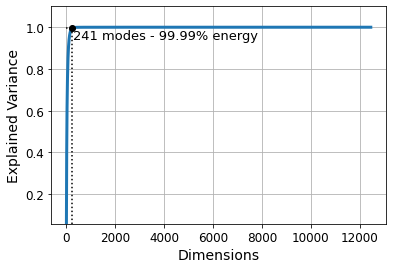

In [ ]:
plt.figure(figsize=(6,4))
plt.plot(cumsum_eig, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Explained Variance")
plt.ylim([cumsum_eig[0],1.1])
plt.plot([n_components_eig, n_components_eig], [0, p], "k:")
plt.plot([0, n_components_eig], [p, p], "k:")
plt.plot(n_components_eig, p, "ko")
plt.annotate(f"{n_components_eig} modes - 99.99% energy", xy=(n_components_eig, p), xytext=(n_components_eig+10, p-0.05), fontsize=13)
plt.grid(True)
plt.show()

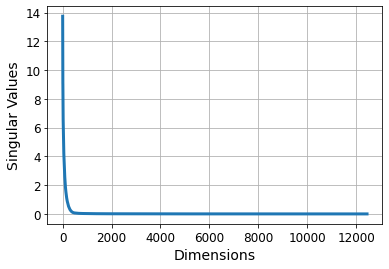

In [ ]:
sv = pca.singular_values_
plt.figure(figsize=(6,4))
plt.plot(sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Singular Values")
plt.grid(True)
plt.show()

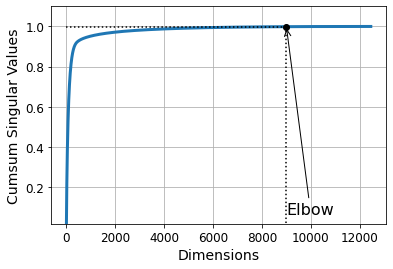

8997


In [ ]:
p = 0.999
cumsum_sv = np.cumsum(pca.singular_values_/sum(pca.singular_values_))
n_components_sv = np.argmax(cumsum_sv >= p) + 1

d = n_components_sv
plt.figure(figsize=(6,4))
plt.plot(cumsum_sv, linewidth=3)
plt.xlabel("Dimensions")
plt.ylabel("Cumsum Singular Values")
plt.ylim([cumsum_sv[0],1.1])
plt.plot([d, d], [0, p], "k:")
plt.plot([0, d], [p, p], "k:")
plt.plot(d, p, "ko")
plt.annotate("Elbow", xy=(d, p), xytext=(d, cumsum_sv[0]+0.05),
             arrowprops=dict(arrowstyle="->"), fontsize=16)
plt.grid(True)
plt.show()
print(d)

**Re-compression using 292 components)**

In [ ]:
pca_rom = PCA(n_components=n_components_eig)
pca_scaled_train_trajs = pca_rom.fit_transform(raw_train_trajs.reshape((-1, nx*ny)))
print(pca_scaled_train_trajs.shape)

(12450, 241)


In [ ]:
reconstruct_train_data = pca_rom.inverse_transform(pca_scaled_train_trajs)

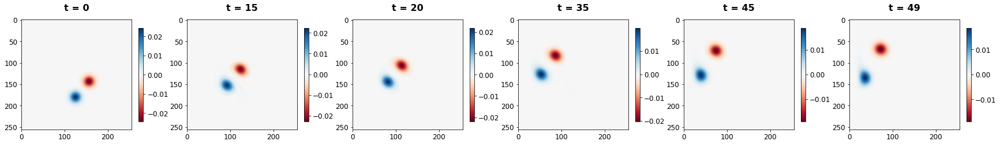

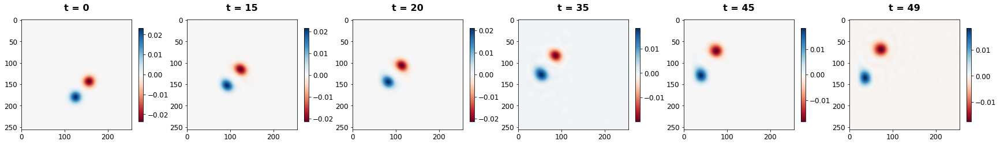

In [ ]:
# Comparing actual data and pca reduced data

times = [0, 15, 20, 35, 45, 49]
actual_data = raw_train_trajs.reshape((-1, timestep, nx, nx))[69]
recon_data = reconstruct_train_data.reshape((-1, timestep, nx, nx))[69]
plot_vortex(actual_data, times, len(times))
plot_vortex(recon_data, times, len(times))

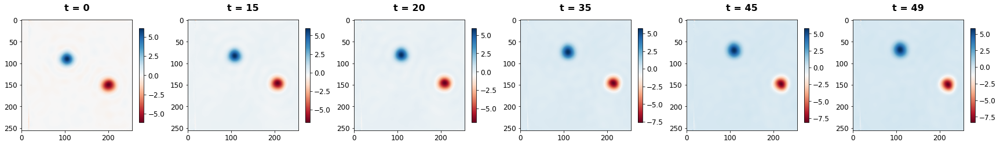

In [ ]:
plot_vortex(recon_data, times, len(times))

In [ ]:
# Calculate error 

max_abs_err, mean_abs_err = calculate_error(actual_data, recon_data)
print("Max. abs. error: {}". format(max_abs_err))
print("Mean abs. error: {}".format(mean_abs_err))

Max. abs. error: 0.0026068006677143927
Mean abs. error: 5.0103895884519914e-05


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:5: RuntimeWarning: divide by zero encountered in true_divide
  """


In [ ]:
# Save compression
import joblib
pca_file_dir = "drive/MyDrive/MSC_IRP/PredGAN/pca_rom_292.pkl"
with open(pca_file_dir, 'wb') as save_file:  
  joblib.dump(pca_rom, save_file)
np.save('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_100.npy', X_train_pca)

#**Convolutional Auto Encoder Based ROM**



##Data Details

*   Raw dataset represents the parameter values of u, v and p for 1200 separate examples of the high fidelity solution.
*   Each example is computed over 50 timesteps and a on a 256-by-256 grid.

*   Vorticity over the vector field is obatined by computing the curl of u (x-component velocity vector) and v (y-component velocity vector)


**Note:** Due to memory constraints, only implementation of a fraction of the dataset is shown here. The workflow should not chnage for a much larger dataset.


In [ ]:
# Load x and y velocity components 
data_dir = 'drive/MyDrive/MSC_IRP/data/calc_vortex_300.npy'
data_trajs = np.memmap(data_dir, mode='r', dtype= 'float64', shape=(300, 50, 256, 256))
data_trajs = data_trajs[1:] # there is some error in the first trajectory. Unsure what this is so I am omiting it for now.
# Print data details
print('Size of dataset:         ', data_trajs.shape)
print('Number of data samples:  ', len(data_trajs))
print('Size of each sample:     ', data_trajs[0].shape)
print('Number of time steps:    ', len(data_trajs[0]))
# Prepping data for dimensionality reduction using CAE
x_sz = 256
y_sz  = 256

Size of dataset:          (299, 50, 256, 256)
Number of data samples:   299
Size of each sample:      (50, 256, 256)
Number of time steps:     50


## Data Visualization

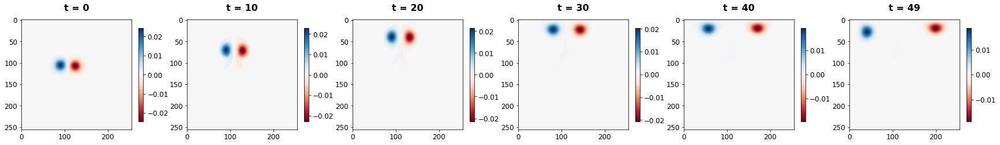

In [ ]:
idx = 68
times = [i*10 for i in range(5)] + [49]
plot_vortex(data_trajs[idx], times, cols=6, rows=1)

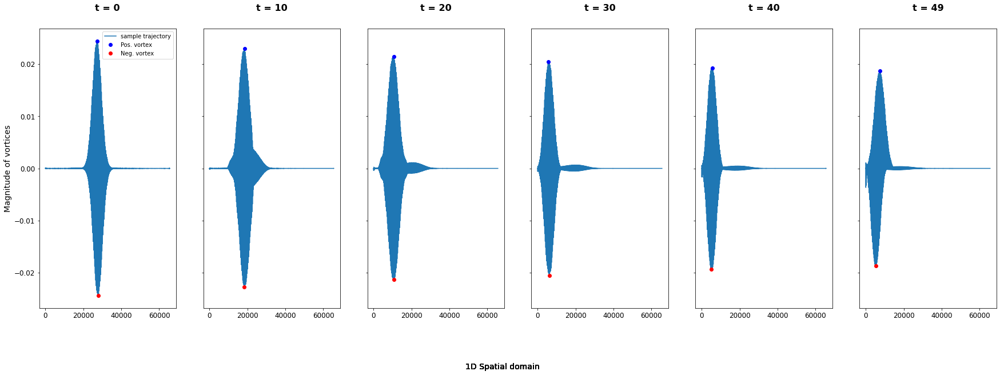

In [ ]:
# We want to visualize the trajectory projected on a linear domain to observe vortices magnitude
plot_linevortex({'sample trajectory': data_trajs[idx]}, times, cols=6, rows=1)

## Dimensionality Reduction

In [ ]:
n_train = 200 # number of trajectories for training (out of 299)
scaler = StandardScaler()
scaler_test = StandardScaler()

test_trajs =  scaler_test.fit_transform(data_trajs[n_train:,:,:,:].reshape(-1, x_sz*y_sz))
trajs =  scaler.fit_transform(data_trajs[:n_train,:,:,:].reshape(-1, x_sz*y_sz))
# trajs =  data_trajs[:n_train,:,:,:].reshape(-1, x_sz*y_sz).astype("float32")/ 0.0245
# test_trajs =  data_trajs[n_train:,:,:,:].reshape(-1, x_sz*y_sz).astype("float32") / 0.0245
print('training data shape: ')
print(trajs.shape)
print()
print('test data shape: ')
print(test_trajs.shape)



training data shape: 
(10000, 65536)

test data shape: 
(4950, 65536)


In [ ]:
print(np.max(test_trajs[700]))
print(np.min(test_trajs[700]))
print('mean: ', np.mean(trajs[700]))

1.0000000000000002
-1.0
mean:  -0.009460088646159028


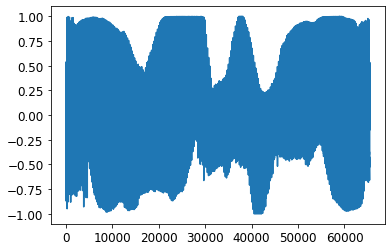

In [ ]:
fig, ax = plt.subplots()
ax.plot(test_trajs[700])

In [ ]:
from tensorflow.keras.regularizers import l1, l2

In [ ]:
cae_latent_dim = 100
# Encoder 
def build_rom_encoder():

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=[x_sz, y_sz, 1]))
    model.add(tf.keras.layers.Dense(1))

    model.add(tf.keras.layers.Conv2D(1, (4, 4), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))

    model.add(tf.keras.layers.Conv2D(4, (5, 5), strides=(2, 2), padding='same', ))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))

    model.add(tf.keras.layers.Conv2D(8, (6, 6), activation='relu', strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.MaxPooling2D((2, 2)))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(cae_latent_dim))
    return model

cae_encoder = build_rom_encoder()
cae_encoder.summary()

Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 256, 256, 1)       2         
                                                                 
 conv2d_10 (Conv2D)          (None, 128, 128, 1)       17        
                                                                 
 batch_normalization_10 (Bat  (None, 128, 128, 1)      4         
 chNormalization)                                                
                                                                 
 leaky_re_lu_10 (LeakyReLU)  (None, 128, 128, 1)       0         
                                                                 
 max_pooling2d_6 (MaxPooling  (None, 64, 64, 1)        0         
 2D)                                                             
                                                                 
 conv2d_11 (Conv2D)          (None, 32, 32, 4)        

In [ ]:
#from tensorflow.python.ops.gen_math_ops import sigmoid
def build_rom_decoder():
  
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=[cae_latent_dim]))
    model.add(tf.keras.layers.Dense(256))

    model.add(tf.keras.layers.Reshape((16, 16, 1)))

    # model.add(tf.keras.layers.Conv2D(16, (5, 5), strides=(1, 1),  padding='same', kernel_regularizer=l2(0.0005)))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.1))
    # model.add(tf.keras.layers.UpSampling2D((2, 2)))

    model.add(tf.keras.layers.Conv2D(16, (6, 6), strides=(1, 1),  padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.UpSampling2D((2,2)))
   
    model.add(tf.keras.layers.Conv2D(8, (5, 5), strides=(1, 1), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.UpSampling2D((2, 2)))
   
    model.add(tf.keras.layers.Conv2D(4, (4, 4), strides=(1, 1), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.UpSampling2D((2, 2)))

    model.add(tf.keras.layers.Conv2D(1, (3, 3), strides=(1, 1), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.7))
    model.add(tf.keras.layers.UpSampling2D((2, 2)))


    model.add(tf.keras.layers.Dense(1))

    return model

cae_decoder = build_rom_decoder()
cae_decoder.summary();

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_8 (Dense)             (None, 256)               25856     
                                                                 
 reshape_1 (Reshape)         (None, 16, 16, 1)         0         
                                                                 
 conv2d_13 (Conv2D)          (None, 16, 16, 16)        592       
                                                                 
 batch_normalization_13 (Bat  (None, 16, 16, 16)       64        
 chNormalization)                                                
                                                                 
 leaky_re_lu_13 (LeakyReLU)  (None, 16, 16, 16)        0         
                                                                 
 up_sampling2d_4 (UpSampling  (None, 32, 32, 16)       0         
 2D)                                                  

##Testing CAE 

(1, 256, 256, 1)
tf.Tensor(4.639167400455335e-06, shape=(), dtype=float64)


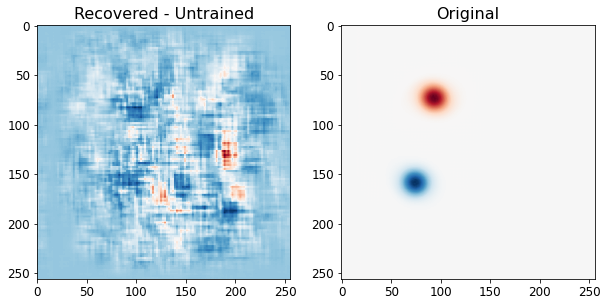

In [ ]:
n_try = 957
trajs = trajs.reshape(-1, x_sz, y_sz)
cae_latent_output = cae_encoder(trajs[n_try].reshape(-1, 256, 256, 1), training=False)
generated_image = cae_decoder(cae_latent_output, training=False)
print(generated_image.shape)
recovered_image = scaler.inverse_transform(tf.reshape(generated_image[0, :, :, 0], [1, -1]))
true_image = scaler.inverse_transform(trajs[n_try].reshape(1, -1))

# recovered_image = tf.reshape(generated_image[0, :, :, 0], [1, -1]).numpy() * 0.0245
# true_image = trajs[n_try].reshape(1, -1) * 0.0245

fig, ax = plt.subplots(1, 2, figsize=[10, 10])
ax[0].imshow(recovered_image.reshape(256, 256), cmap='RdBu');
ax[0].set_title('Recovered - Untrained', fontsize=16);

ax[1].imshow(true_image.reshape(256, 256), cmap='RdBu');
ax[1].set_title('Original', fontsize=16);

diff = tf.keras.losses.MeanSquaredError()
print(diff(true_image, recovered_image))

In [ ]:
class PlotLosses(tf.keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.fig = plt.figure()
        self.logs = []

    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1

        # if self.i % 100 == 0:
        plt.plot(self.x, self.losses, label="loss", c = 'green')
        plt.plot(self.x, self.val_losses, label="val_loss", c = 'red')
        plt.legend()
        plt.show()
class PlotPredict(tf.keras.callbacks.Callback):
    def on_train_begin (self, logs={}):
      pass

In [ ]:
# Train autoencoder 

def train_cae(dataset, epochs, log=False):
      encoded_img = cae_encoder(dataset)
      decoded_ing = cae_decoder(encoded_img)

      rom_autoencoder = tf.keras.models.Sequential([cae_encoder, cae_decoder])
      opt = tf.keras.optimizers.Adam(1e-4)
      rom_autoencoder.compile(optimizer=opt, 
                          loss=diff, 
                          metrics=['mae'])
      hist_loss = PlotLosses()
      # hist_test = PlotPredict()
      history = rom_autoencoder.fit(dataset, dataset,
                          epochs = epochs,
                          batch_size = 64,
                          shuffle=True,
                          validation_split=0.2,
                          callbacks=[hist_loss])
      if log:
        rom_autoencoder.save('rom_autoencoder_with128bAnd1e-5lr.h5')
      return rom_autoencoder
# batch size 64 is too high. val loss (3e-4) is low but bigger than training loss (2e-4).
# very good result and reconstruction but PCA with 100 dimensions might be better lol.
# - high latent dimension (100) gives lower training loss but prone to overfitting. Maybe try 50. 
#    -- 50: more overfitting. training loss @ 1500 epochs = 2.4e-4, mae = 0.102
#    -- try increasing lr and see what happens. 
# - reduce batch size and see what happens.

# 19/2 TRYING 300 LATENT DIMENSION
# architecture uses 1, 4, 8 neurons and enc+param = dec * 2
# batch size is reduced but sigmoid and bin_crossentropy for loss 
# training for 2000 epochs with 1e-4 lr on 200 data
# - higher t. loss (4e-4) compared to other architectures. 
# - suspecting because of model architecture (enc = dec * 2) as opposed to dec/2 or batch size

# 100 latent dim with 3 layers and lower filter sizes gives less smooth fit and 8e-4 loss (not good)

# 50 latent dim, with batch 256 and MSE loss t. loss 3e-4, val loss = 6e-4
#  - using sigmoid and mse loss 5.4e-4 amd 7.05e-4 loss. less overfitting but higher loss. maybe more epochs can fix this
# - perhaps reducing batch size is better cus see above when loss = 2e-4?
# - also try binary cross entropy loss

In [ ]:
print('Training Start ... ')
rom_autoencoder = train_cae(trajs, epochs=1500)

In [ ]:
train_trajs = trajs.reshape(-1, x_sz, y_sz, 1) 
recons_train = rom_autoencoder.predict(train_trajs) 
test_trajs = test_trajs.reshape(-1, x_sz, y_sz, 1) 
recons_test_trajs = rom_autoencoder.predict(test_trajs) 
maxAbsError, MAE = calculate_error(train_trajs, recons_train)
print('max absolute error: ', maxAbsError)
print('mean absolute error: ', MAE)

max absolute error:  55.20672814439344
mean absolute error:  0.07339974762409542


In [ ]:
maxAbsError, MAE = calculate_error(test_trajs, recons_test_trajs)
print('max absolute error: ', maxAbsError)
print('mean absolute error: ', MAE)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in true_divide


max absolute error:  0.09984459
mean absolute error:  0.00080098835


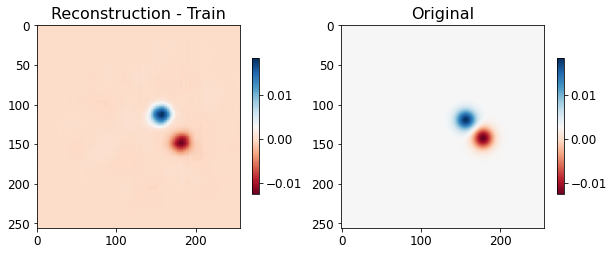

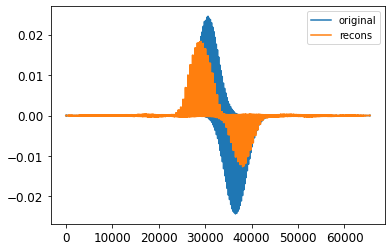

In [ ]:

traj_id = 9400
real_trajs = scaler.inverse_transform(train_trajs[traj_id].reshape(1,-1))
recon_trajs = scaler.inverse_transform(recons_train[traj_id].reshape(1, -1))

# real_trajs = train_trajs[traj_id].reshape(1,-1) 
# recon_trajs = recons_train[traj_id].reshape(1, -1) 

fig, ax = plt.subplots(1, 2, figsize=[10, 10])
im = ax[0].imshow(recon_trajs.reshape(x_sz, y_sz), cmap='RdBu');
ax[0].set_title('Reconstruction - Train', fontsize=16);
plt.colorbar(im, ax=ax[0], shrink=0.25, pad=0.05, panchor=(0.0, 0.0))

ax[1].imshow(real_trajs.reshape(x_sz, y_sz), cmap='RdBu');
ax[1].set_title('Original', fontsize=16);
plt.colorbar(im, ax=ax[1], shrink=0.25, pad=0.05, panchor=(0.0, 0.0))

print()
fig, ax = plt.subplots(1, 1)
ax.plot(real_trajs.reshape(-1,1), label='original')
ax.plot(recon_trajs.reshape(-1, 1), label='recons')
ax.legend()
plt.show()

In [ ]:
diff_mse = tf.keras.losses.MeanAbsoluteError()
print (diff_mse(train_trajs[traj_id], recons_train[traj_id]))

tf.Tensor(0.0028261598, shape=(), dtype=float32)


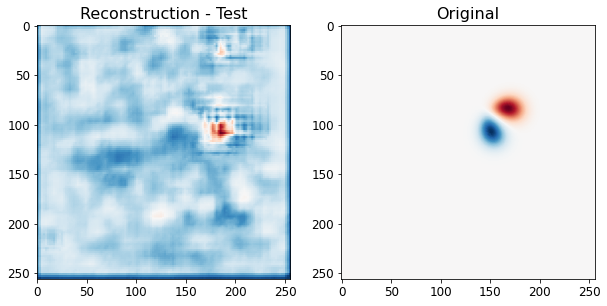

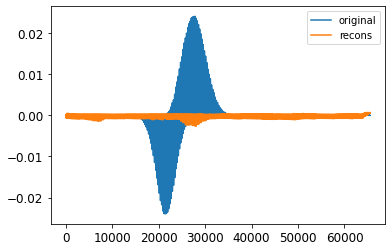

In [ ]:

test_id = 1
# real_test_traj = scaler_test.inverse_transform(test_trajs[test_id].reshape(1, -1))
# recons_test_traj = scaler_test.inverse_transform(recons_test_trajs[test_id].reshape(1, -1))
real_test_traj = test_trajs[test_id].reshape(1, -1)
recons_test_traj = recons_test_trajs[test_id].reshape(1, -1)

fig, ax = plt.subplots(1, 2, figsize=[10, 10])
ax[0].imshow(recons_test_traj.reshape(x_sz, y_sz), cmap='RdBu');
ax[0].set_title('Reconstruction - Test', fontsize=16);

ax[1].imshow(real_test_traj.reshape(x_sz, y_sz), cmap='RdBu');
ax[1].set_title('Original', fontsize=16);
fig, ax = plt.subplots(1, 1)
ax.plot(real_test_traj.reshape(-1,1), label='original')
ax.plot(recons_test_traj.reshape(-1, 1), label='recons')
ax.legend()
plt.show()


In [ ]:
maxAbsError, MAE = calculate_error(real_test_traj, recons_test_traj)
print('max absolute error: ', maxAbsError)
print('mean absolute error: ', MAE)

max absolute error:  0.0142553742043674
mean absolute error:  0.00022063470667685325


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in true_divide


In [ ]:
results = rom_autoencoder.evaluate(x=test_trajs, y=test_trajs, batch_size=64)
print(results)

78/78 [==============================] - 1s 15ms/step - loss: 4.2541e-06 - mae: 8.0099e-04
[4.2541146285657305e-06, 0.0008009878802113235]


#**Training Generative Adversarial Network**

Following reduction in dimension, we can now proceed to train a GAN/WGAN-GP for time series prediction using the POD axpansion coefficients. 

Prior to traing the GAN, we perform a time series concatenation of the 50 snapshots of a trajectory. This is necessary for timeseries prediction as the GAN needs to be learn what future state of each trajectory is. 
In contenating the snapshots, we select a suitable length of the resulting concantenation. This is also the max. length the GAN can generate/predict.
```
ntimes
```
To ensure coverage, we implement user-specified gap between consecutive time level in the concatenation so a good portion of the trajectry is learned. This variable is:
```
step
```
To concatenate, a helper function
```
concatenate_timesteps(reduced_trajs, ntimes, step, window_start, window_end)
```
is built that contenates within a window since there is limited snashots for each trajectory. The output trajectories are then used as training data. 
 

### Load Compressed Trajectories v1200

In [ ]:
if (mem_load):
  pca = joblib.load('drive/MyDrive/MSC_IRP/data/pca_rom1200_292.pkl')
  X_1d_pca = np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_1200.npy')
  scaler = joblib.load('drive/MyDrive/MSC_IRP/data/scaler_1200.pkl')
  
print('Number of snapshots: {}'.format(X_1d_pca.shape[0]))
X_1d_pca_scaled = scaler.fit_transform(X_1d_pca)
# np.allclose(X_1d_pca, scaler.inverse_transform((X_1d_pca_scaled)))

/usr/local/lib/python3.7/dist-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator PCA from version 0.22.2.post1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator MinMaxScaler from version 0.22.2.post1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,


Number of snapshots: 60000


AttributeError: ignored

### Load Compressed Trajectories v300

In [ ]:
if (mem_load):
  pca3 = joblib.load('drive/MyDrive/MSC_IRP/data/pca_rom300_292.pkl')
  X_1d_pca3= np.load('drive/MyDrive/MSC_IRP/data/pca_calc_vortex_300.npy')
  scaler3 = joblib.load('drive/MyDrive/MSC_IRP/data/scaler_300.pkl')
  
print('Number of snapshots: {}'.format(X_1d_pca3.shape[0]))
scaler3.clip = False
X_1d_pca_scaled = scaler3.transform(X_1d_pca3)

Number of snapshots: 15000


/usr/local/lib/python3.7/dist-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator PCA from version 0.22.1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,
/usr/local/lib/python3.7/dist-packages/sklearn/base.py:338: UserWarning: Trying to unpickle estimator MinMaxScaler from version 0.22.2.post1 when using version 1.0.2. This might lead to breaking code or invalid results. Use at your own risk. For more info please refer to:
https://scikit-learn.org/stable/modules/model_persistence.html#security-maintainability-limitations
  UserWarning,


### Test dimension reduction and visualize data

In [ ]:
train_sz = 10000 
svd_cae_train_data = X_1d_pca3[:train_sz]
svd_cae_test_data = X_1d_pca3[train_sz:]

svd_cae_scaler_train = StandardScaler()
svd_cae_scaler_test = StandardScaler()

svd_cae_train_trajs = svd_cae_scaler_train.fit_transform(X_1d_pca3)
svd_cae_test_trajs = svd_cae_scaler_test.fit_transform(svd_cae_test_data)

### SVD-CAE


In [ ]:
cae_latent_dim = 15
traj_size = 292
# Encoder 
def build_rom_encoder():
    # model = tf.keras.Sequential()
    # model.add(tf.keras.layers.InputLayer(input_shape=image_shape))
    
    # model.add(tf.keras.layers.Dense(64))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))
    

    # model.add(tf.keras.layers.Dense(32))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Dense(16))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Dense(cae_latent_dim))

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=[traj_size]))
    model.add(tf.keras.layers.Dense(1024))

    model.add(tf.keras.layers.Reshape((32, 32, 1)))
    model.add(tf.keras.layers.Conv2D(1, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.1))
    model.add(tf.keras.layers.MaxPooling2D(2,2))


    model.add(tf.keras.layers.Conv2D(4, (6, 6), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.1))
    model.add(tf.keras.layers.MaxPooling2D(2,2))

    # model.add(tf.keras.layers.Conv2D(8, (7, 7), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.1))
    # # model.add(tf.keras.layers.MaxPooling2D((2, 2)))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(cae_latent_dim))
    return model

cae_encoder = build_rom_encoder()
cae_encoder.summary()

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_33 (Dense)            (None, 1024)              300032    
                                                                 
 reshape_17 (Reshape)        (None, 32, 32, 1)         0         
                                                                 
 conv2d_34 (Conv2D)          (None, 16, 16, 1)         26        
                                                                 
 batch_normalization_34 (Bat  (None, 16, 16, 1)        4         
 chNormalization)                                                
                                                                 
 leaky_re_lu_34 (LeakyReLU)  (None, 16, 16, 1)         0         
                                                                 
 max_pooling2d_21 (MaxPoolin  (None, 8, 8, 1)          0         
 g2D)                                                

In [ ]:
def build_rom_decoder():

    # model = tf.keras.Sequential()
    # model.add(tf.keras.layers.InputLayer(input_shape=[cae_latent_dim]))
    # model.add(tf.keras.layers.Dense(128))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Dense(64))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Dense(image_shape, activation='sigmoid'))
    # model.add(tf.keras.layers.BatchNormalization())
  
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.InputLayer(input_shape=[cae_latent_dim]))
    model.add(tf.keras.layers.Dense(64))

    model.add(tf.keras.layers.Reshape((8, 8, 1)))

    # model.add(tf.keras.layers.Conv2D(8, (5, 5), strides=(1, 1), padding='same'))
    # model.add(tf.keras.layers.BatchNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    model.add(tf.keras.layers.Conv2D(4, (6, 6), strides=(1, 1), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.1))
    model.add(tf.keras.layers.UpSampling2D((2,2)))

    model.add(tf.keras.layers.Conv2D(1, (5, 5), strides=(1, 1), padding='same'))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.1))
    model.add(tf.keras.layers.UpSampling2D((2,2)))

    
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(traj_size))

    return model

cae_decoder = build_rom_decoder()
cae_decoder.summary();

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_35 (Dense)            (None, 64)                1024      
                                                                 
 reshape_18 (Reshape)        (None, 8, 8, 1)           0         
                                                                 
 conv2d_36 (Conv2D)          (None, 8, 8, 4)           148       
                                                                 
 batch_normalization_36 (Bat  (None, 8, 8, 4)          16        
 chNormalization)                                                
                                                                 
 leaky_re_lu_36 (LeakyReLU)  (None, 8, 8, 4)           0         
                                                                 
 up_sampling2d_10 (UpSamplin  (None, 16, 16, 4)        0         
 g2D)                                                

(15000, 292)
tf.Tensor(5.5872846132842824e-05, shape=(), dtype=float64)


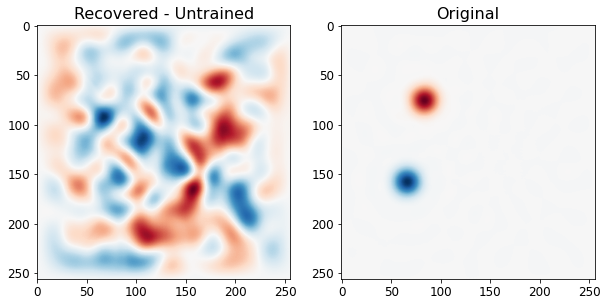

In [ ]:
n_try = 1000

cae_latent_output = cae_encoder(X_1d_pca_scaled.reshape(-1, traj_size), training=False)
generated_image = cae_decoder(cae_latent_output, training=False)
print(generated_image.shape)
recovered_image = invert_data(tf.reshape(generated_image[n_try], (1, -1)), flag='3')
true_image = invert_data(X_1d_pca_scaled[n_try].reshape(1, -1), flag='3')

fig, ax = plt.subplots(1, 2, figsize=[10, 10])
ax[0].imshow(recovered_image.reshape(256, 256), cmap='RdBu');
ax[0].set_title('Recovered - Untrained', fontsize=16);

ax[1].imshow(true_image.reshape(256, 256), cmap='RdBu');
ax[1].set_title('Original', fontsize=16);

diff = tf.keras.losses.MeanSquaredError()
print(diff(true_image, recovered_image))

Training Start ... 
Epoch 1/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.1441 - mae: 0.2246

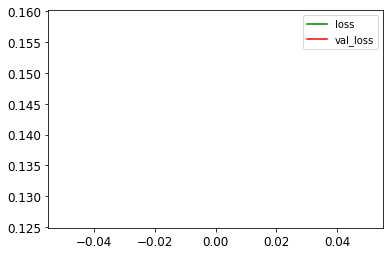

75/75 [==============================] - 2s 10ms/step - loss: 0.1265 - mae: 0.2054 - val_loss: 0.1586 - val_mae: 0.3832
Epoch 2/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0111 - mae: 0.0771

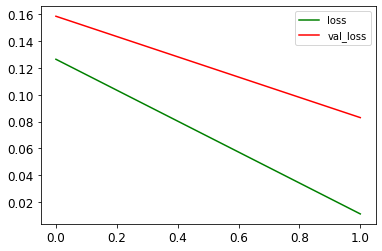

75/75 [==============================] - 1s 7ms/step - loss: 0.0110 - mae: 0.0767 - val_loss: 0.0829 - val_mae: 0.2667
Epoch 3/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0105 - mae: 0.0745

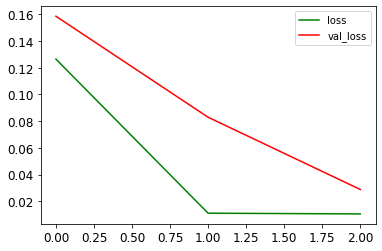

75/75 [==============================] - 1s 7ms/step - loss: 0.0105 - mae: 0.0743 - val_loss: 0.0288 - val_mae: 0.1446
Epoch 4/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0102 - mae: 0.0732

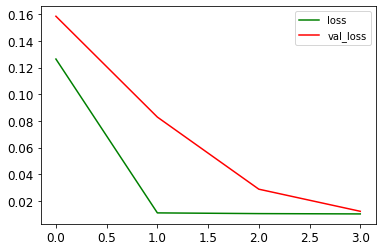

75/75 [==============================] - 1s 7ms/step - loss: 0.0103 - mae: 0.0733 - val_loss: 0.0122 - val_mae: 0.0839
Epoch 5/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0101 - mae: 0.0726

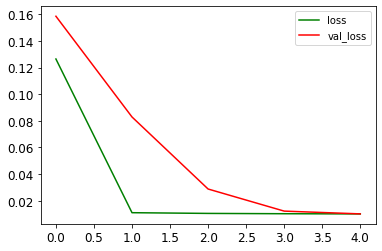

75/75 [==============================] - 1s 7ms/step - loss: 0.0101 - mae: 0.0726 - val_loss: 0.0101 - val_mae: 0.0730
Epoch 6/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0100 - mae: 0.0721

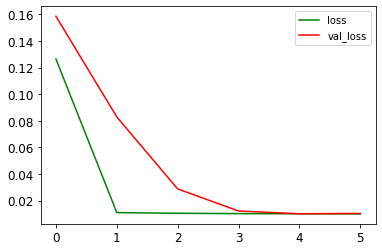

75/75 [==============================] - 1s 7ms/step - loss: 0.0100 - mae: 0.0721 - val_loss: 0.0104 - val_mae: 0.0743
Epoch 7/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0100 - mae: 0.0719

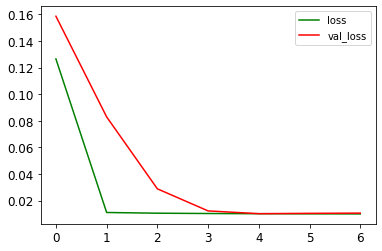

75/75 [==============================] - 1s 7ms/step - loss: 0.0100 - mae: 0.0718 - val_loss: 0.0106 - val_mae: 0.0752
Epoch 8/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0099 - mae: 0.0716

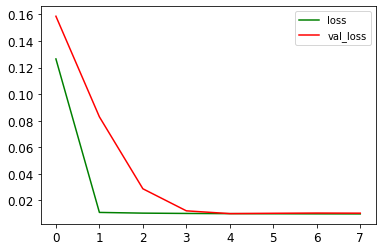

75/75 [==============================] - 1s 7ms/step - loss: 0.0099 - mae: 0.0716 - val_loss: 0.0105 - val_mae: 0.0748
Epoch 9/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0098 - mae: 0.0713

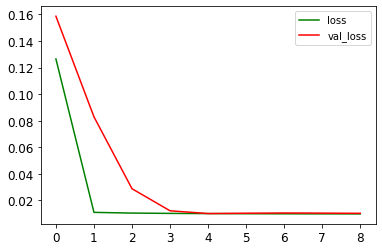

75/75 [==============================] - 1s 9ms/step - loss: 0.0099 - mae: 0.0714 - val_loss: 0.0103 - val_mae: 0.0741
Epoch 10/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0099 - mae: 0.0713

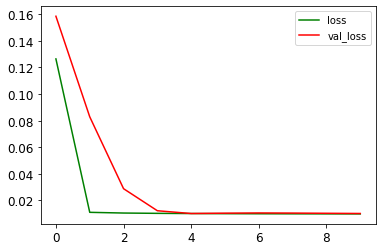

75/75 [==============================] - 0s 7ms/step - loss: 0.0098 - mae: 0.0713 - val_loss: 0.0102 - val_mae: 0.0733
Epoch 11/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0098 - mae: 0.0712

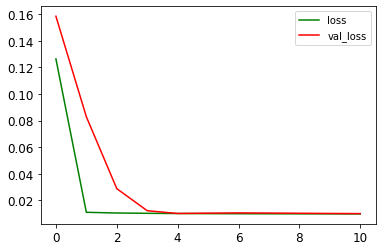

75/75 [==============================] - 1s 7ms/step - loss: 0.0098 - mae: 0.0711 - val_loss: 0.0100 - val_mae: 0.0728
Epoch 12/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0098 - mae: 0.0710

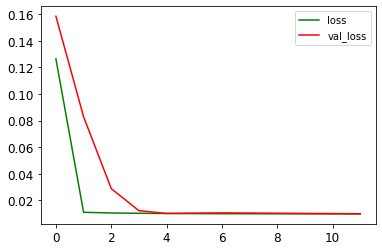

75/75 [==============================] - 1s 7ms/step - loss: 0.0098 - mae: 0.0710 - val_loss: 0.0099 - val_mae: 0.0722
Epoch 13/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0097 - mae: 0.0709

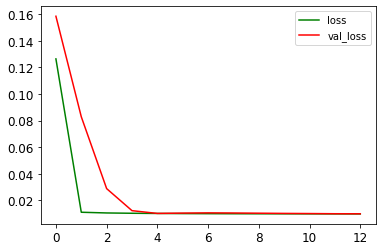

75/75 [==============================] - 1s 7ms/step - loss: 0.0098 - mae: 0.0710 - val_loss: 0.0099 - val_mae: 0.0719
Epoch 14/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0098 - mae: 0.0710

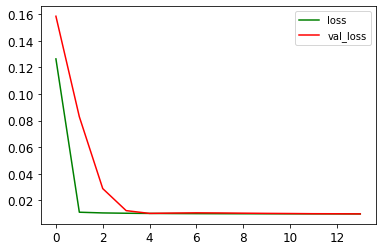

75/75 [==============================] - 1s 7ms/step - loss: 0.0098 - mae: 0.0709 - val_loss: 0.0098 - val_mae: 0.0715
Epoch 15/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0097 - mae: 0.0709

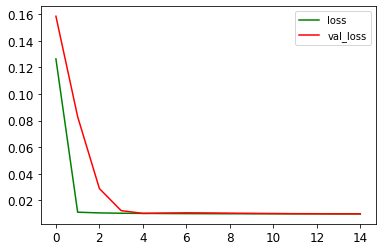

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0708 - val_loss: 0.0098 - val_mae: 0.0714
Epoch 16/1500
75/75 [==============================] - ETA: 0s - loss: 0.0097 - mae: 0.0708

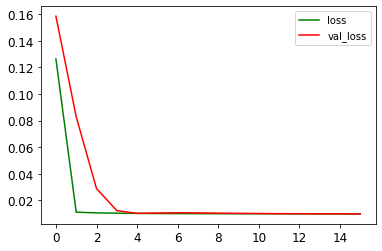

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0708 - val_loss: 0.0097 - val_mae: 0.0712
Epoch 17/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0097 - mae: 0.0707

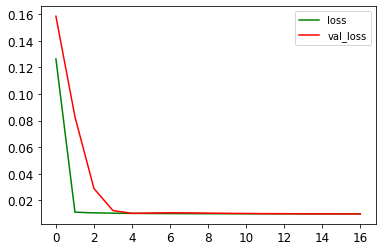

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0707 - val_loss: 0.0097 - val_mae: 0.0712
Epoch 18/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0097 - mae: 0.0706

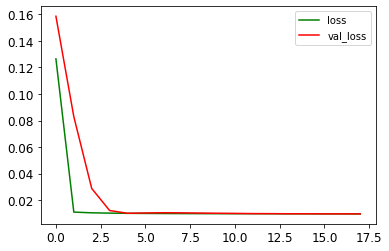

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0707 - val_loss: 0.0097 - val_mae: 0.0709
Epoch 19/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0097 - mae: 0.0706

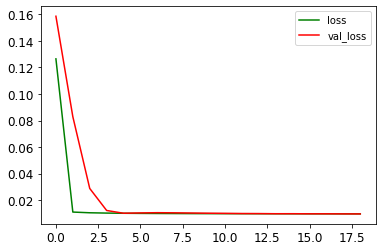

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0706 - val_loss: 0.0096 - val_mae: 0.0708
Epoch 20/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0097 - mae: 0.0706

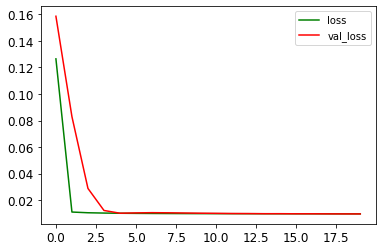

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0706 - val_loss: 0.0096 - val_mae: 0.0707
Epoch 21/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0097 - mae: 0.0705

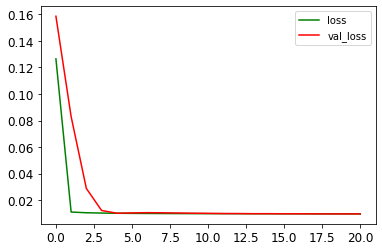

75/75 [==============================] - 1s 7ms/step - loss: 0.0097 - mae: 0.0705 - val_loss: 0.0096 - val_mae: 0.0707
Epoch 22/1500
75/75 [==============================] - ETA: 0s - loss: 0.0096 - mae: 0.0705

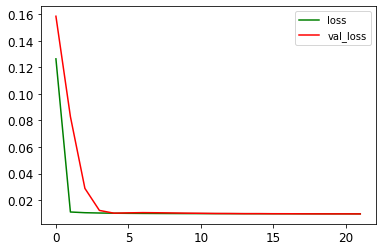

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0705 - val_loss: 0.0096 - val_mae: 0.0705
Epoch 23/1500
75/75 [==============================] - ETA: 0s - loss: 0.0096 - mae: 0.0705

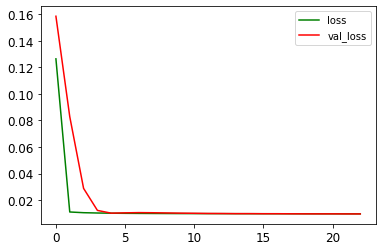

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0705 - val_loss: 0.0096 - val_mae: 0.0705
Epoch 24/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0096 - mae: 0.0704

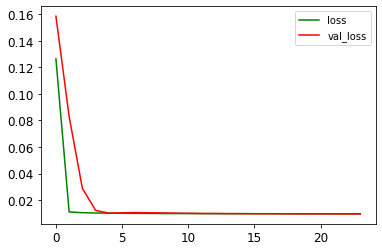

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0704 - val_loss: 0.0096 - val_mae: 0.0705
Epoch 25/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0096 - mae: 0.0705

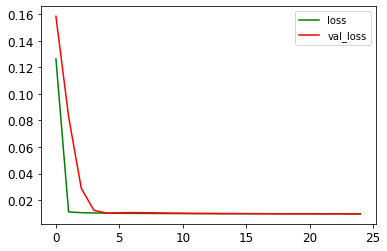

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0704 - val_loss: 0.0095 - val_mae: 0.0704
Epoch 26/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0097 - mae: 0.0706

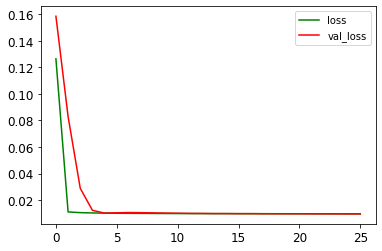

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0704 - val_loss: 0.0095 - val_mae: 0.0704
Epoch 27/1500
75/75 [==============================] - ETA: 0s - loss: 0.0096 - mae: 0.0703

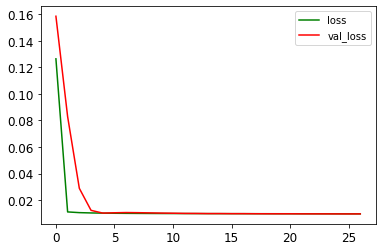

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0703 - val_loss: 0.0096 - val_mae: 0.0705
Epoch 28/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0096 - mae: 0.0706

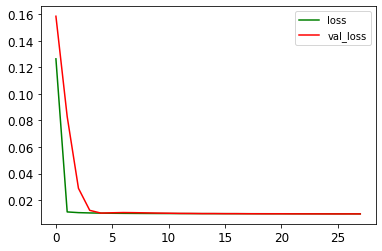

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0703 - val_loss: 0.0095 - val_mae: 0.0704
Epoch 29/1500
75/75 [==============================] - ETA: 0s - loss: 0.0096 - mae: 0.0703

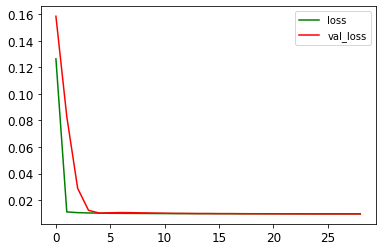

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0703 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 30/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0096 - mae: 0.0703

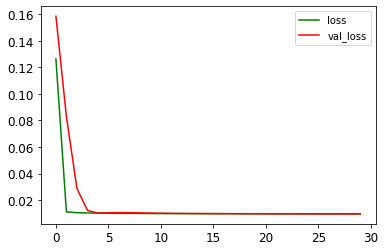

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0703 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 31/1500
75/75 [==============================] - ETA: 0s - loss: 0.0096 - mae: 0.0703

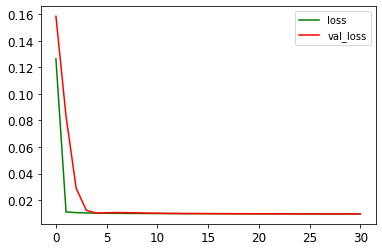

75/75 [==============================] - 1s 7ms/step - loss: 0.0096 - mae: 0.0703 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 32/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0095 - mae: 0.0703

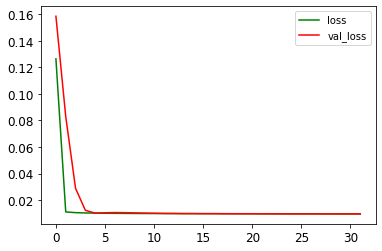

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0703 - val_loss: 0.0095 - val_mae: 0.0706
Epoch 33/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0095 - mae: 0.0700

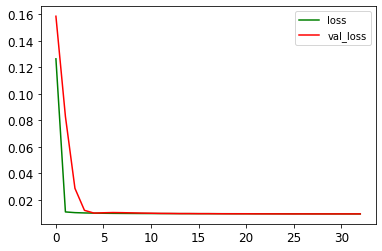

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0702 - val_loss: 0.0096 - val_mae: 0.0706
Epoch 34/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0095 - mae: 0.0702

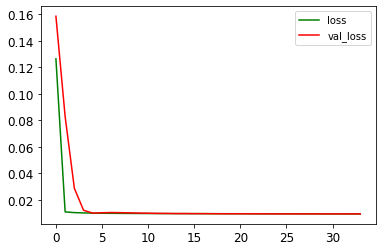

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0702 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 35/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0095 - mae: 0.0703

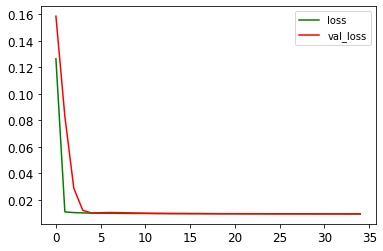

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0702 - val_loss: 0.0095 - val_mae: 0.0707
Epoch 36/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0095 - mae: 0.0701

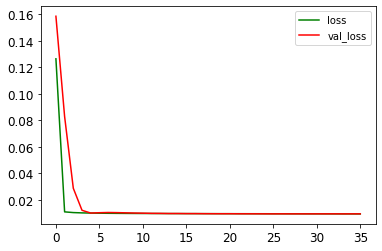

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0701 - val_loss: 0.0095 - val_mae: 0.0707
Epoch 37/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0095 - mae: 0.0701

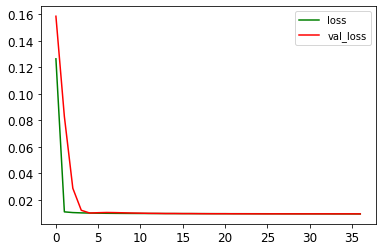

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0701 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 38/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0095 - mae: 0.0701

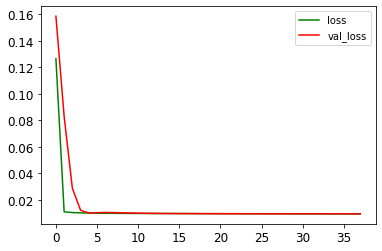

75/75 [==============================] - 1s 7ms/step - loss: 0.0095 - mae: 0.0701 - val_loss: 0.0095 - val_mae: 0.0707
Epoch 39/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0095 - mae: 0.0701

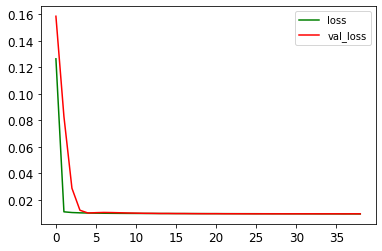

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0701 - val_loss: 0.0095 - val_mae: 0.0706
Epoch 40/1500
75/75 [==============================] - ETA: 0s - loss: 0.0094 - mae: 0.0700

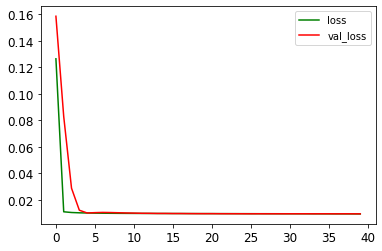

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0700 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 41/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0094 - mae: 0.0700

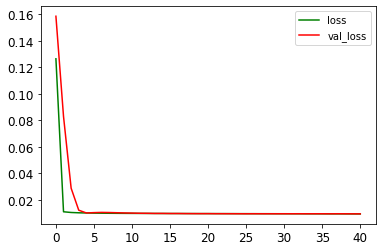

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0700 - val_loss: 0.0095 - val_mae: 0.0704
Epoch 42/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0094 - mae: 0.0700

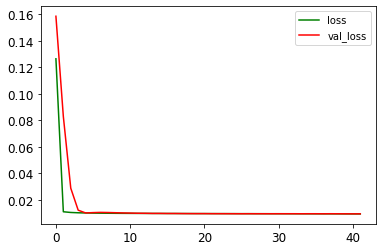

75/75 [==============================] - 1s 10ms/step - loss: 0.0094 - mae: 0.0700 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 43/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0094 - mae: 0.0700

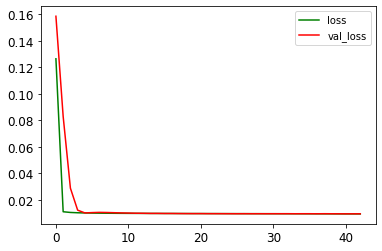

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0699 - val_loss: 0.0095 - val_mae: 0.0705
Epoch 44/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0094 - mae: 0.0698

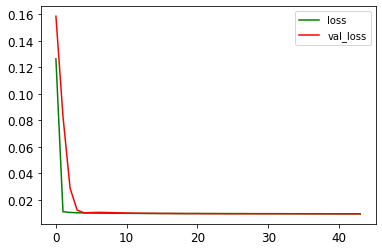

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0699 - val_loss: 0.0095 - val_mae: 0.0706
Epoch 45/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0094 - mae: 0.0699

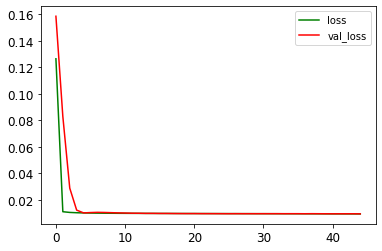

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0699 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 46/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0094 - mae: 0.0699

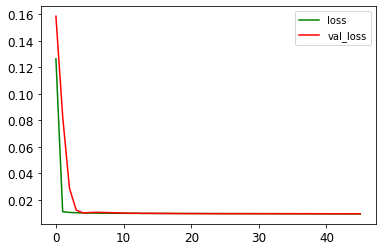

75/75 [==============================] - 1s 7ms/step - loss: 0.0094 - mae: 0.0699 - val_loss: 0.0095 - val_mae: 0.0706
Epoch 47/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0094 - mae: 0.0699

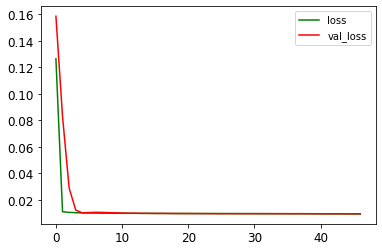

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0699 - val_loss: 0.0094 - val_mae: 0.0704
Epoch 48/1500
75/75 [==============================] - ETA: 0s - loss: 0.0093 - mae: 0.0698

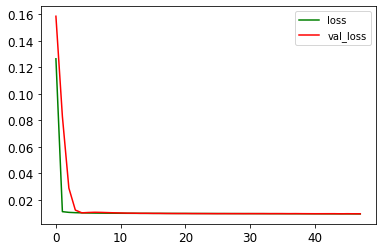

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0698 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 49/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0093 - mae: 0.0698

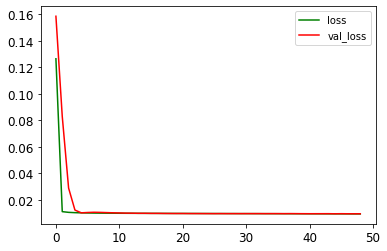

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0698 - val_loss: 0.0094 - val_mae: 0.0704
Epoch 50/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0093 - mae: 0.0698

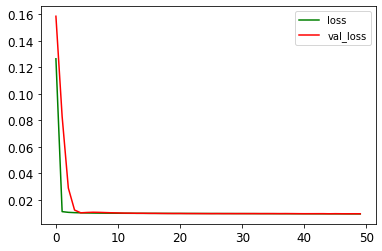

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0698 - val_loss: 0.0094 - val_mae: 0.0704
Epoch 51/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0093 - mae: 0.0697

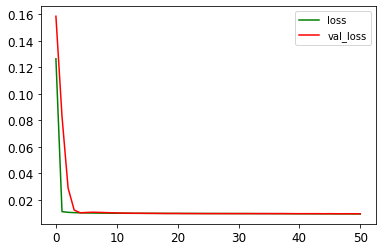

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0697 - val_loss: 0.0094 - val_mae: 0.0702
Epoch 52/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0093 - mae: 0.0697

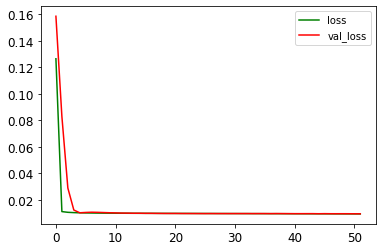

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0697 - val_loss: 0.0094 - val_mae: 0.0701
Epoch 53/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0092 - mae: 0.0695

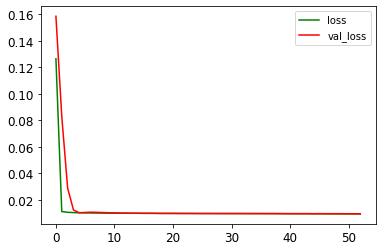

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0697 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 54/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0093 - mae: 0.0697

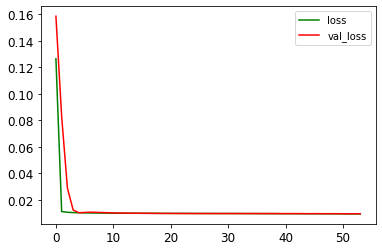

75/75 [==============================] - 1s 7ms/step - loss: 0.0093 - mae: 0.0696 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 55/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0092 - mae: 0.0696

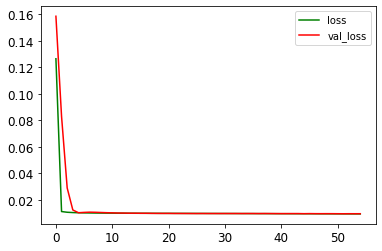

75/75 [==============================] - 1s 7ms/step - loss: 0.0092 - mae: 0.0696 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 56/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0092 - mae: 0.0696

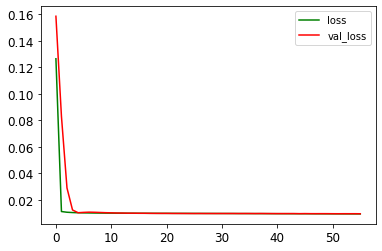

75/75 [==============================] - 1s 7ms/step - loss: 0.0092 - mae: 0.0696 - val_loss: 0.0094 - val_mae: 0.0701
Epoch 57/1500
75/75 [==============================] - ETA: 0s - loss: 0.0092 - mae: 0.0695

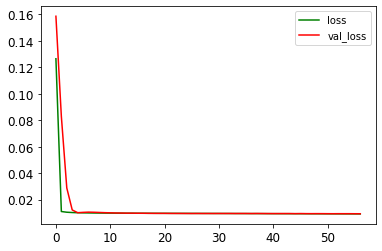

75/75 [==============================] - 1s 7ms/step - loss: 0.0092 - mae: 0.0695 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 58/1500
75/75 [==============================] - ETA: 0s - loss: 0.0092 - mae: 0.0695

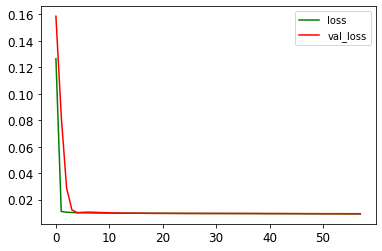

75/75 [==============================] - 1s 8ms/step - loss: 0.0092 - mae: 0.0695 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 59/1500
69/75 [==========================>...] - ETA: 0s - loss: 0.0092 - mae: 0.0694

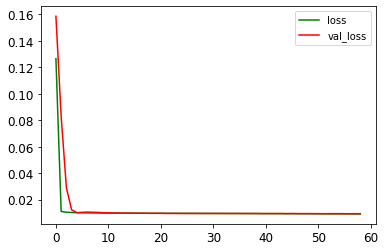

75/75 [==============================] - 1s 8ms/step - loss: 0.0092 - mae: 0.0695 - val_loss: 0.0094 - val_mae: 0.0703
Epoch 60/1500
75/75 [==============================] - ETA: 0s - loss: 0.0092 - mae: 0.0694

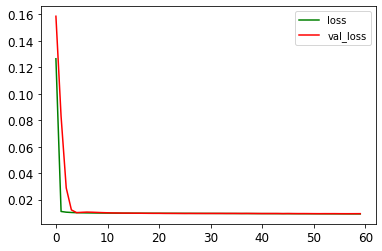

75/75 [==============================] - 1s 8ms/step - loss: 0.0092 - mae: 0.0694 - val_loss: 0.0094 - val_mae: 0.0704
Epoch 61/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0693

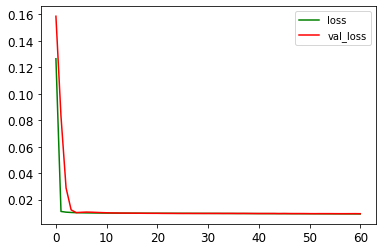

75/75 [==============================] - 1s 7ms/step - loss: 0.0092 - mae: 0.0694 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 62/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0092 - mae: 0.0694

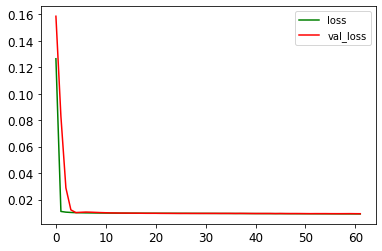

75/75 [==============================] - 1s 7ms/step - loss: 0.0092 - mae: 0.0694 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 63/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0092 - mae: 0.0694

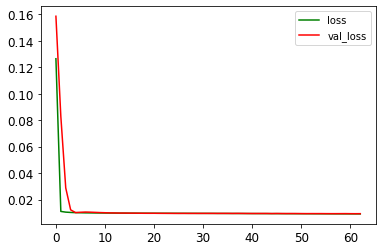

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0693 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 64/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0092 - mae: 0.0694

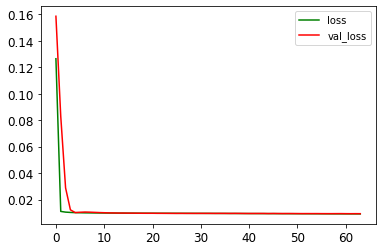

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0693 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 65/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0693

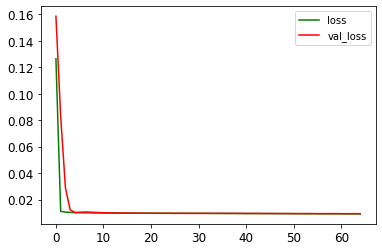

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0692 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 66/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0692

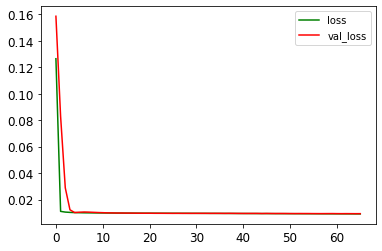

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0692 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 67/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0691

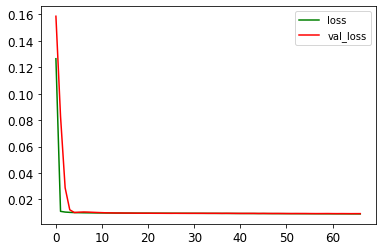

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0692 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 68/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0091 - mae: 0.0691

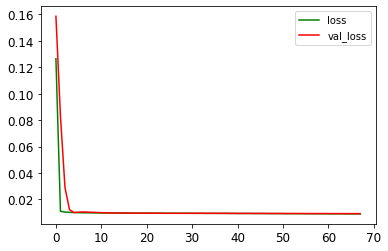

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0691 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 69/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0691

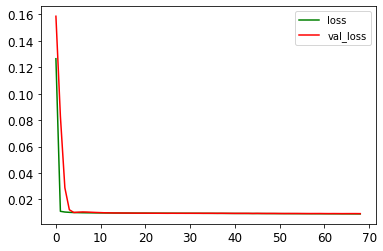

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0691 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 70/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0091 - mae: 0.0692

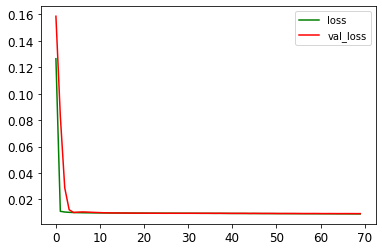

75/75 [==============================] - 1s 7ms/step - loss: 0.0091 - mae: 0.0691 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 71/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0090 - mae: 0.0688

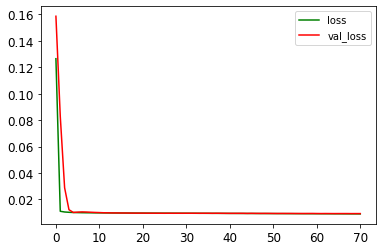

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0690 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 72/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0090 - mae: 0.0689

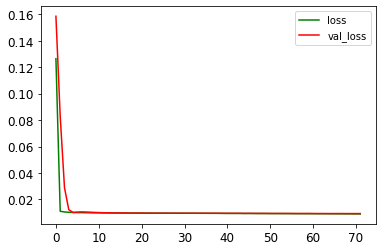

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0689 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 73/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0090 - mae: 0.0690

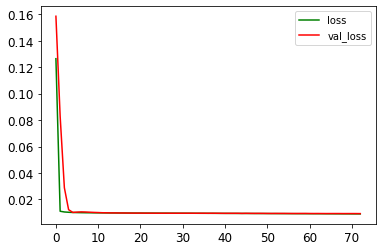

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0689 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 74/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0090 - mae: 0.0689

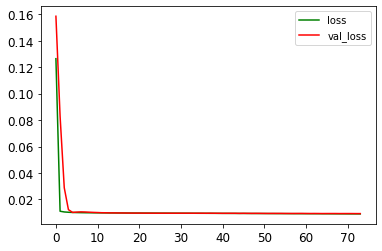

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0689 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 75/1500
75/75 [==============================] - ETA: 0s - loss: 0.0090 - mae: 0.0688

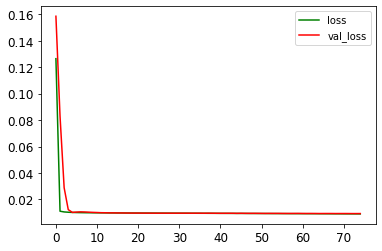

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0688 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 76/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0090 - mae: 0.0688

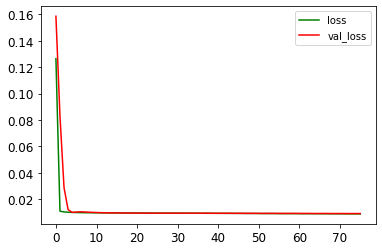

75/75 [==============================] - 1s 10ms/step - loss: 0.0090 - mae: 0.0688 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 77/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0090 - mae: 0.0688

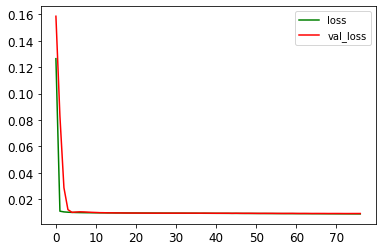

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0688 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 78/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0090 - mae: 0.0688

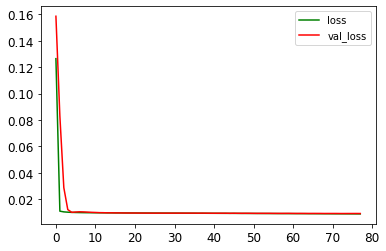

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0687 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 79/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0089 - mae: 0.0687

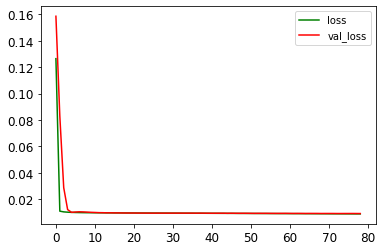

75/75 [==============================] - 1s 7ms/step - loss: 0.0090 - mae: 0.0687 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 80/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0089 - mae: 0.0686

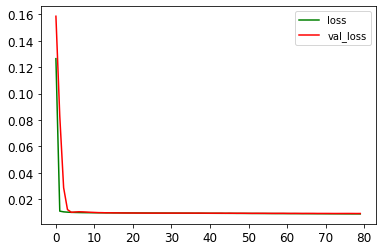

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0686 - val_loss: 0.0093 - val_mae: 0.0700
Epoch 81/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0089 - mae: 0.0686

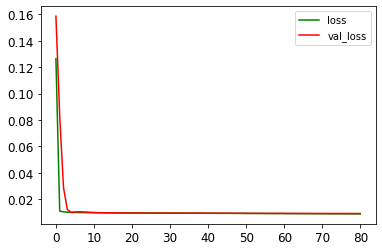

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0686 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 82/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0089 - mae: 0.0686

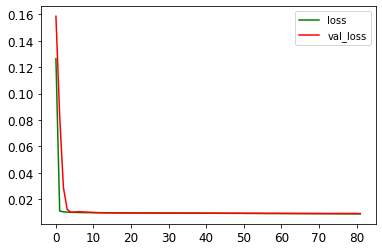

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0686 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 83/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0089 - mae: 0.0685

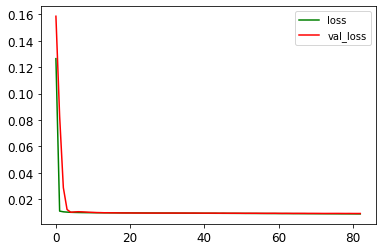

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0685 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 84/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0089 - mae: 0.0684

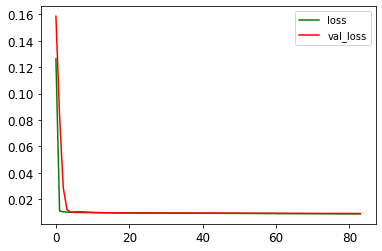

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0685 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 85/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0089 - mae: 0.0684

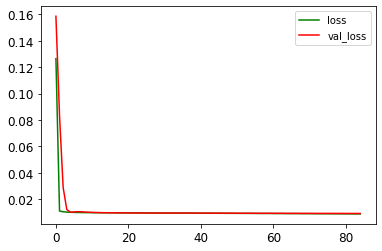

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0684 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 86/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0089 - mae: 0.0684

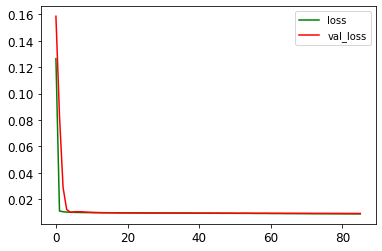

75/75 [==============================] - 1s 7ms/step - loss: 0.0089 - mae: 0.0684 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 87/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0088 - mae: 0.0683

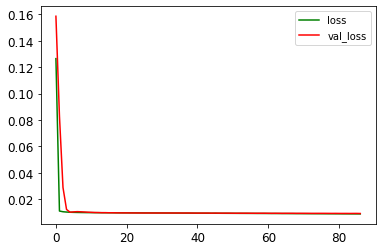

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0684 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 88/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0088 - mae: 0.0683

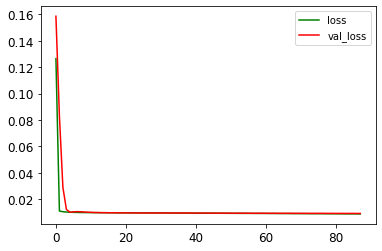

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0683 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 89/1500
75/75 [==============================] - ETA: 0s - loss: 0.0088 - mae: 0.0683

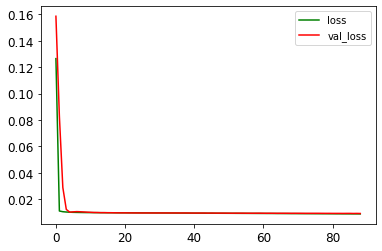

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0683 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 90/1500
75/75 [==============================] - ETA: 0s - loss: 0.0088 - mae: 0.0682

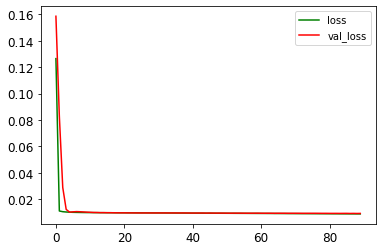

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0682 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 91/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0088 - mae: 0.0681

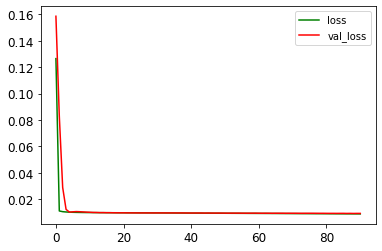

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0682 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 92/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0088 - mae: 0.0681

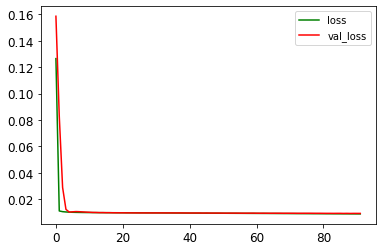

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0681 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 93/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0088 - mae: 0.0680

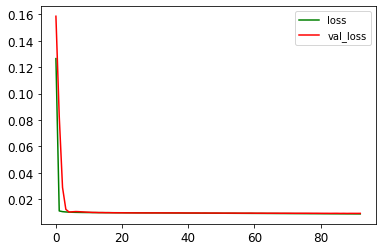

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0681 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 94/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0088 - mae: 0.0680

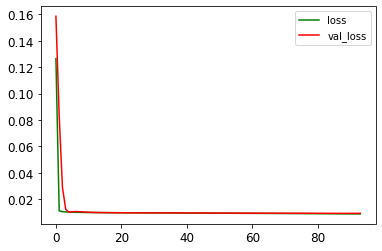

75/75 [==============================] - 1s 7ms/step - loss: 0.0088 - mae: 0.0680 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 95/1500
75/75 [==============================] - ETA: 0s - loss: 0.0087 - mae: 0.0680

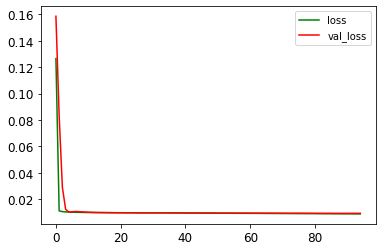

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0680 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 96/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0087 - mae: 0.0680

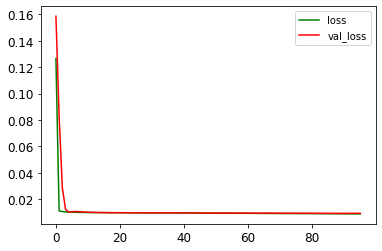

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0679 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 97/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0087 - mae: 0.0679

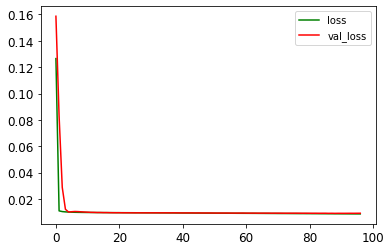

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0679 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 98/1500
75/75 [==============================] - ETA: 0s - loss: 0.0087 - mae: 0.0679

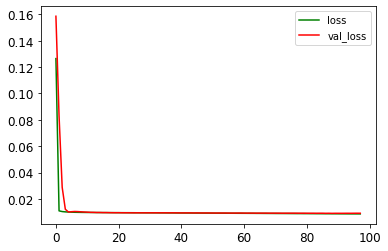

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0679 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 99/1500
75/75 [==============================] - ETA: 0s - loss: 0.0087 - mae: 0.0678

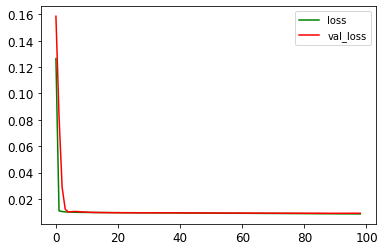

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0678 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 100/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0087 - mae: 0.0678

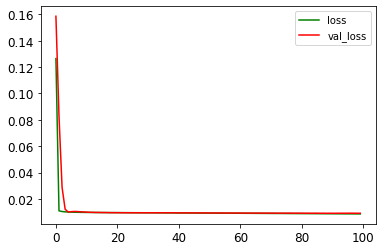

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0678 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 101/1500
75/75 [==============================] - ETA: 0s - loss: 0.0087 - mae: 0.0677

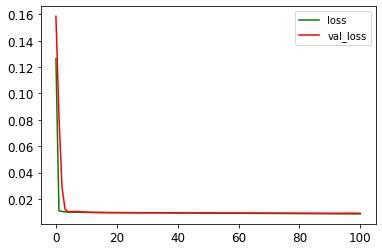

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0677 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 102/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0087 - mae: 0.0678

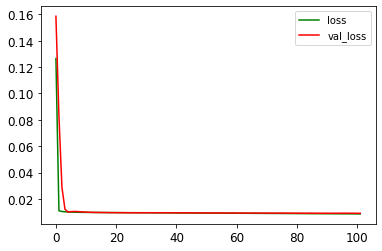

75/75 [==============================] - 1s 7ms/step - loss: 0.0087 - mae: 0.0677 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 103/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0086 - mae: 0.0676

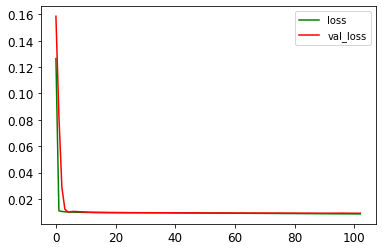

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0676 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 104/1500
75/75 [==============================] - ETA: 0s - loss: 0.0086 - mae: 0.0676

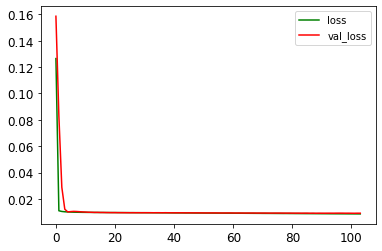

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0676 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 105/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0086 - mae: 0.0675

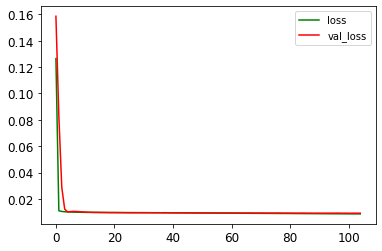

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0675 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 106/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0086 - mae: 0.0675

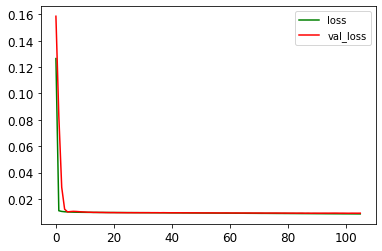

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0675 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 107/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0086 - mae: 0.0675

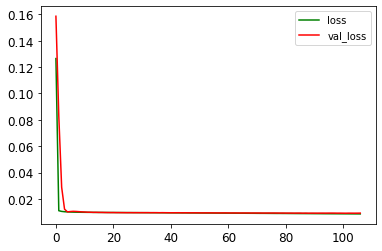

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0675 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 108/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0085 - mae: 0.0673

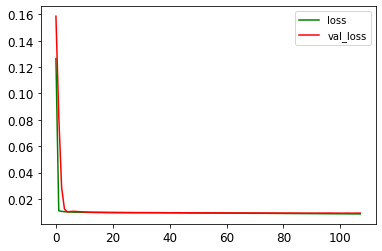

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0674 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 109/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0086 - mae: 0.0674

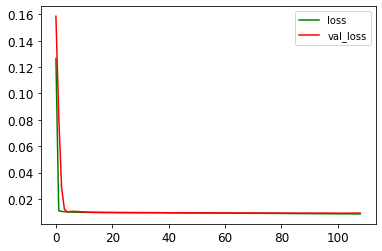

75/75 [==============================] - 1s 7ms/step - loss: 0.0086 - mae: 0.0674 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 110/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0085 - mae: 0.0673

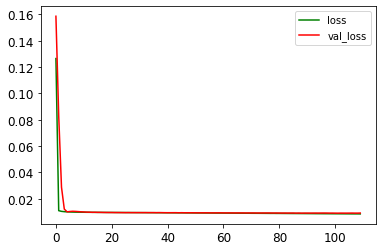

75/75 [==============================] - 1s 10ms/step - loss: 0.0086 - mae: 0.0673 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 111/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0673

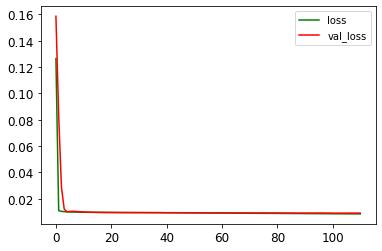

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0673 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 112/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0673

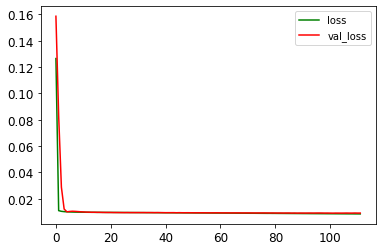

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0673 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 113/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0672

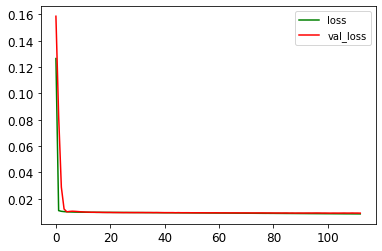

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0672 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 114/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0671

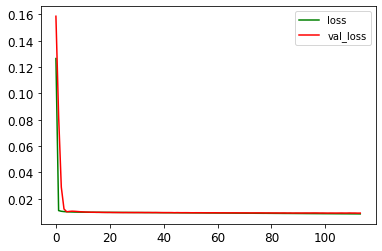

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0671 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 115/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0671

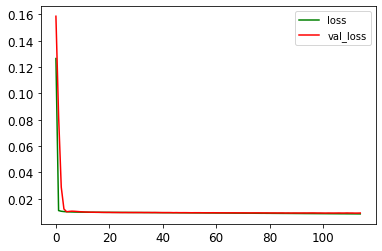

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0671 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 116/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0085 - mae: 0.0671

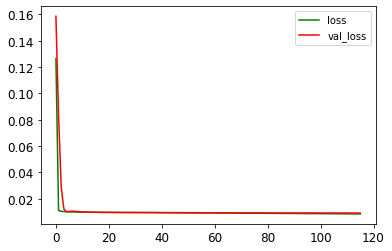

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0671 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 117/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0670

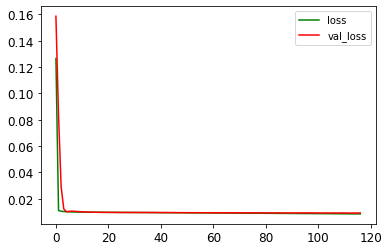

75/75 [==============================] - 1s 7ms/step - loss: 0.0085 - mae: 0.0670 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 118/1500
75/75 [==============================] - ETA: 0s - loss: 0.0084 - mae: 0.0669

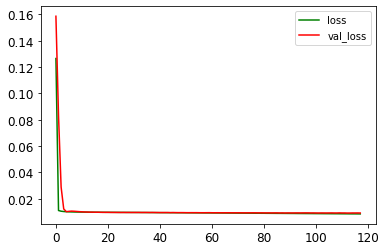

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0669 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 119/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0669

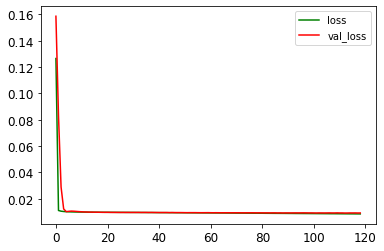

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0669 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 120/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0668

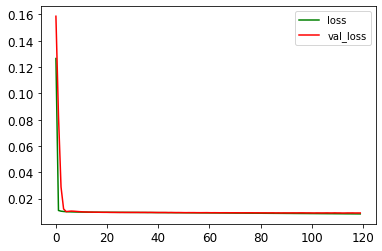

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0668 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 121/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0667

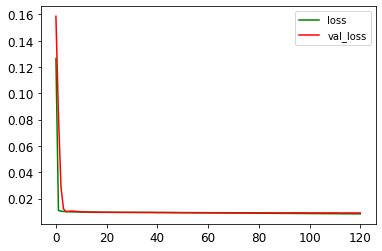

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0667 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 122/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0667

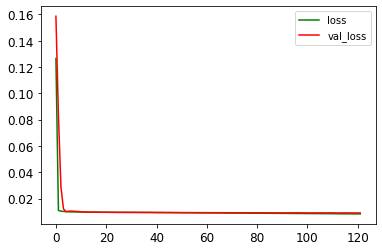

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0668 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 123/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0084 - mae: 0.0667

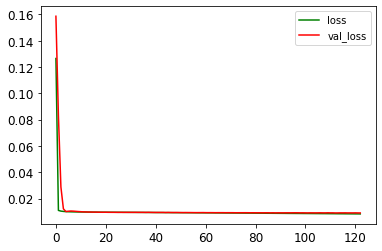

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0667 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 124/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0084 - mae: 0.0667

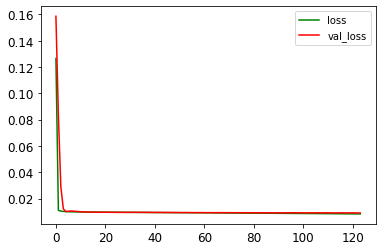

75/75 [==============================] - 1s 7ms/step - loss: 0.0084 - mae: 0.0666 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 125/1500
75/75 [==============================] - ETA: 0s - loss: 0.0083 - mae: 0.0665

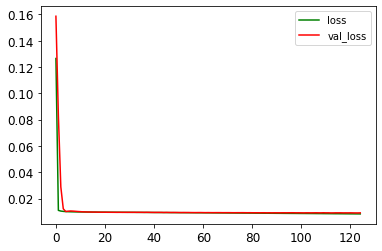

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0665 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 126/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0083 - mae: 0.0664

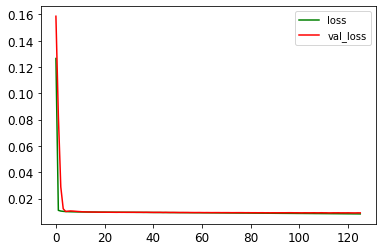

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0665 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 127/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0083 - mae: 0.0665

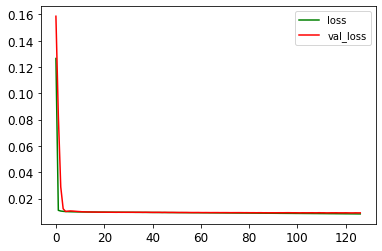

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0664 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 128/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0083 - mae: 0.0665

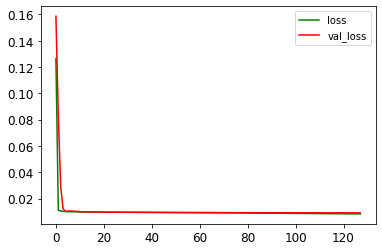

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0664 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 129/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0083 - mae: 0.0664

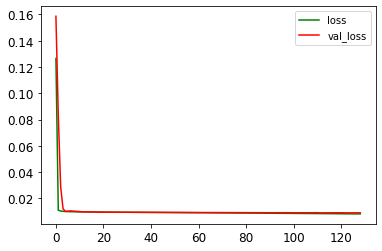

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0663 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 130/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0083 - mae: 0.0663

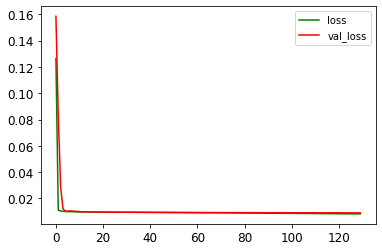

75/75 [==============================] - 1s 7ms/step - loss: 0.0083 - mae: 0.0663 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 131/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0082 - mae: 0.0662

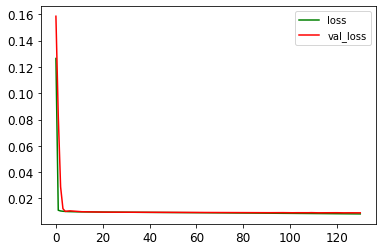

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0662 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 132/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0082 - mae: 0.0662

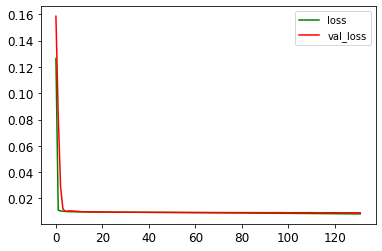

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0662 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 133/1500
75/75 [==============================] - ETA: 0s - loss: 0.0082 - mae: 0.0660

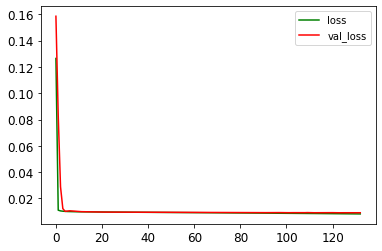

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0660 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 134/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0082 - mae: 0.0660

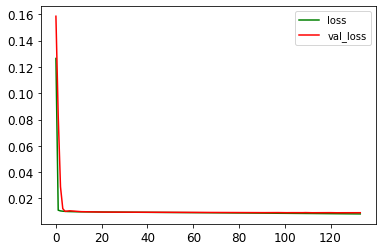

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0661 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 135/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0082 - mae: 0.0659

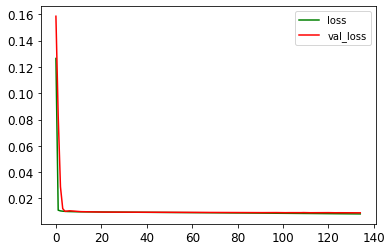

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0660 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 136/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0082 - mae: 0.0660

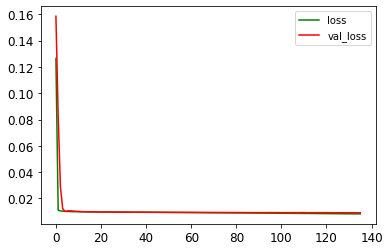

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0660 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 137/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0081 - mae: 0.0659

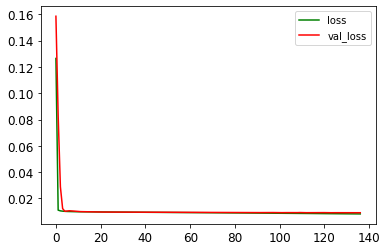

75/75 [==============================] - 1s 7ms/step - loss: 0.0082 - mae: 0.0659 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 138/1500
75/75 [==============================] - ETA: 0s - loss: 0.0081 - mae: 0.0659

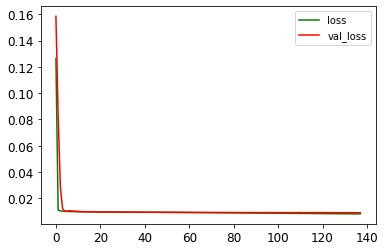

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0659 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 139/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0081 - mae: 0.0658

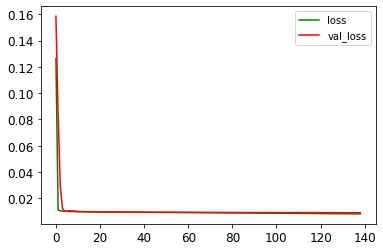

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0658 - val_loss: 0.0090 - val_mae: 0.0693
Epoch 140/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0081 - mae: 0.0657

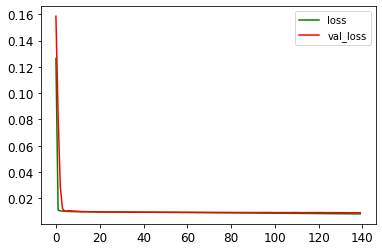

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0657 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 141/1500
75/75 [==============================] - ETA: 0s - loss: 0.0081 - mae: 0.0657

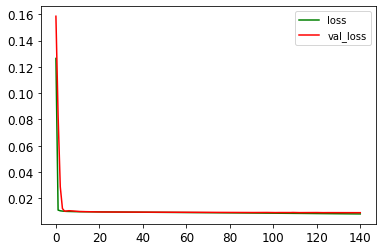

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0657 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 142/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0081 - mae: 0.0657

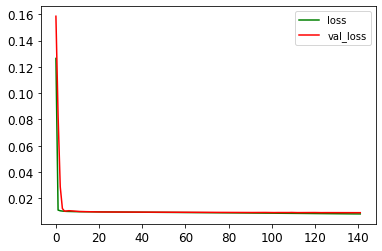

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0657 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 143/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0081 - mae: 0.0656

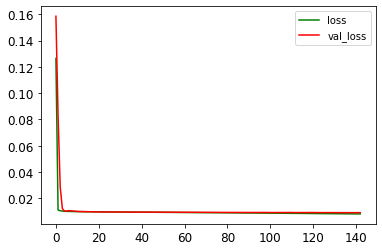

75/75 [==============================] - 1s 10ms/step - loss: 0.0081 - mae: 0.0657 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 144/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0081 - mae: 0.0656

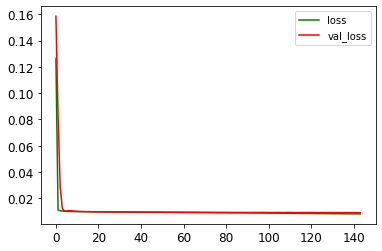

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0655 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 145/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0080 - mae: 0.0654

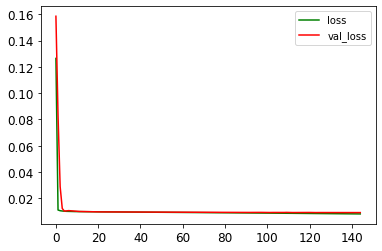

75/75 [==============================] - 1s 7ms/step - loss: 0.0081 - mae: 0.0655 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 146/1500
75/75 [==============================] - ETA: 0s - loss: 0.0080 - mae: 0.0655

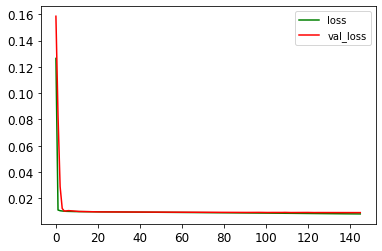

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0655 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 147/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0080 - mae: 0.0655

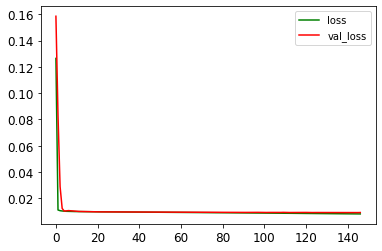

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0654 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 148/1500
75/75 [==============================] - ETA: 0s - loss: 0.0080 - mae: 0.0654

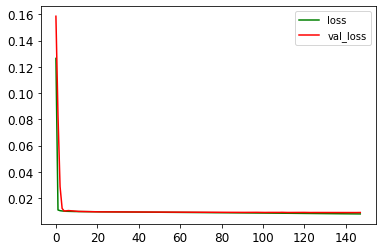

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0654 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 149/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0080 - mae: 0.0653

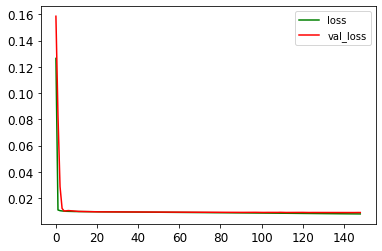

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0653 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 150/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0080 - mae: 0.0654

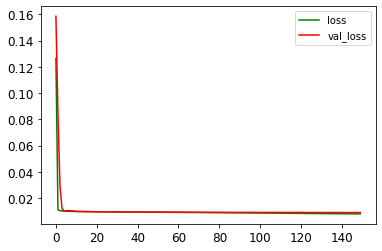

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0653 - val_loss: 0.0090 - val_mae: 0.0693
Epoch 151/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0080 - mae: 0.0652

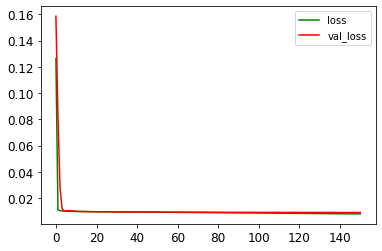

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0652 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 152/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0080 - mae: 0.0651

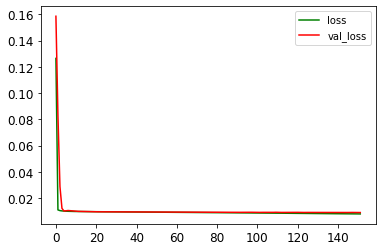

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0652 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 153/1500
75/75 [==============================] - ETA: 0s - loss: 0.0080 - mae: 0.0652

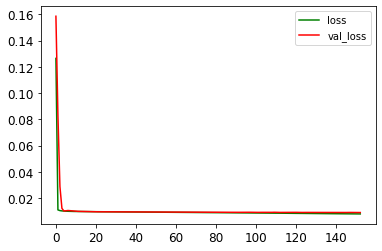

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0652 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 154/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0079 - mae: 0.0651

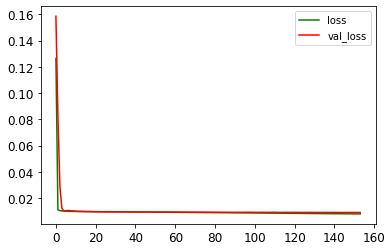

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0652 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 155/1500
75/75 [==============================] - ETA: 0s - loss: 0.0080 - mae: 0.0652

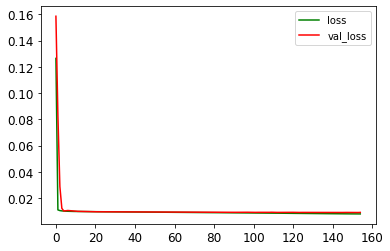

75/75 [==============================] - 1s 7ms/step - loss: 0.0080 - mae: 0.0652 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 156/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0079 - mae: 0.0651

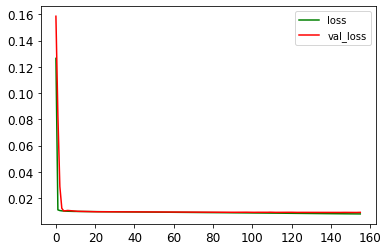

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0650 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 157/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0079 - mae: 0.0650

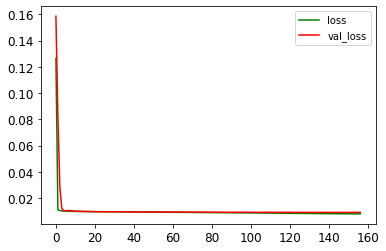

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0650 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 158/1500
75/75 [==============================] - ETA: 0s - loss: 0.0079 - mae: 0.0650

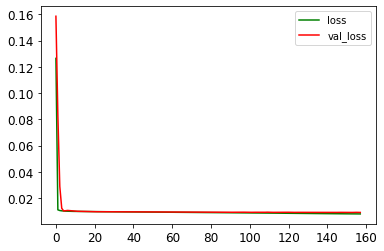

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0650 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 159/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0079 - mae: 0.0650

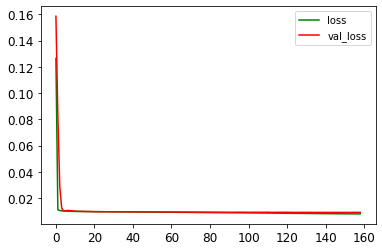

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0650 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 160/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0079 - mae: 0.0649

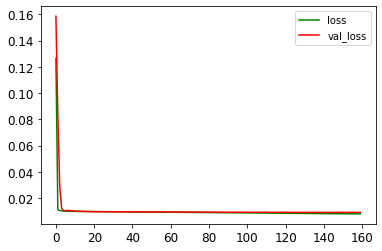

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0649 - val_loss: 0.0090 - val_mae: 0.0693
Epoch 161/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0079 - mae: 0.0649

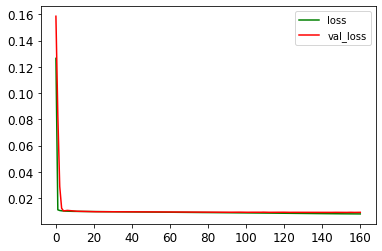

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0649 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 162/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0079 - mae: 0.0648

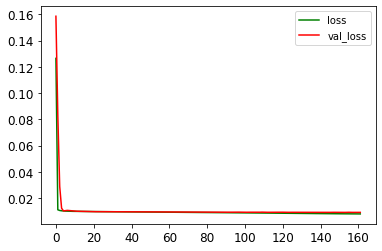

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0648 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 163/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0079 - mae: 0.0648

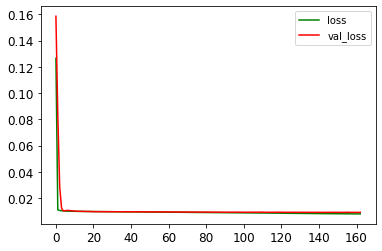

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0648 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 164/1500
75/75 [==============================] - ETA: 0s - loss: 0.0079 - mae: 0.0648

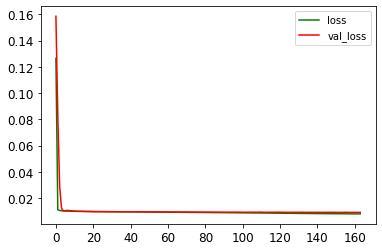

75/75 [==============================] - 1s 7ms/step - loss: 0.0079 - mae: 0.0648 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 165/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0079 - mae: 0.0648

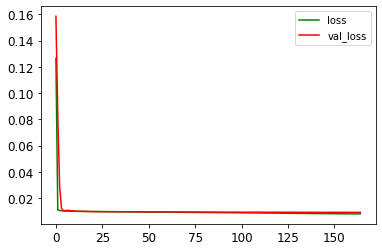

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0647 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 166/1500
75/75 [==============================] - ETA: 0s - loss: 0.0078 - mae: 0.0647

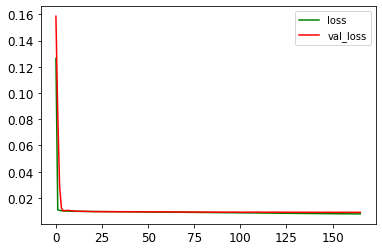

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0647 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 167/1500
75/75 [==============================] - ETA: 0s - loss: 0.0078 - mae: 0.0646

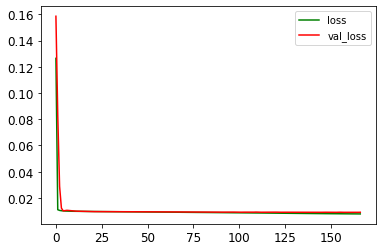

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0646 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 168/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0078 - mae: 0.0646

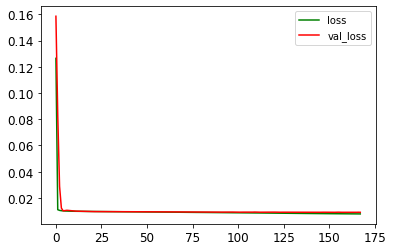

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0646 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 169/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0078 - mae: 0.0645

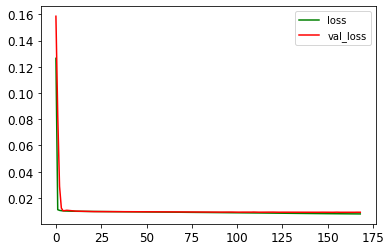

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0645 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 170/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0078 - mae: 0.0645

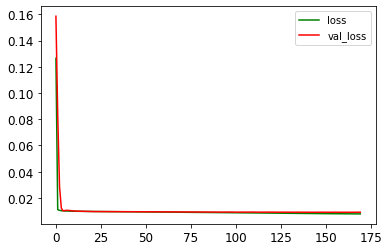

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0645 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 171/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0078 - mae: 0.0645

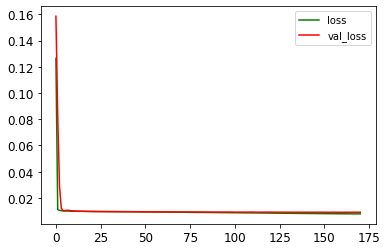

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0645 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 172/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0078 - mae: 0.0644

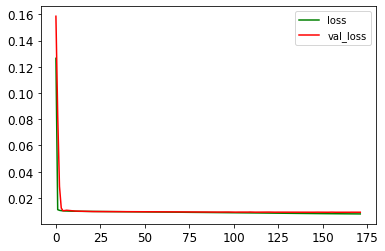

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0644 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 173/1500
75/75 [==============================] - ETA: 0s - loss: 0.0078 - mae: 0.0644

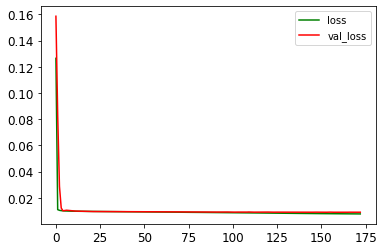

75/75 [==============================] - 1s 7ms/step - loss: 0.0078 - mae: 0.0644 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 174/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0643

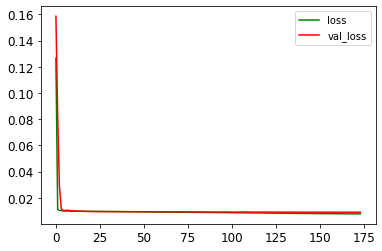

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0643 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 175/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0078 - mae: 0.0644

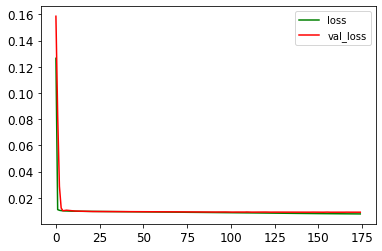

75/75 [==============================] - 1s 10ms/step - loss: 0.0077 - mae: 0.0643 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 176/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0643

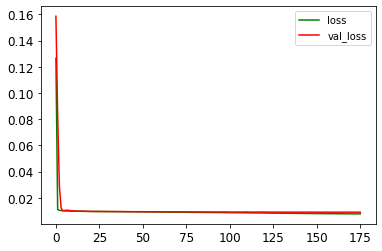

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0643 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 177/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0643

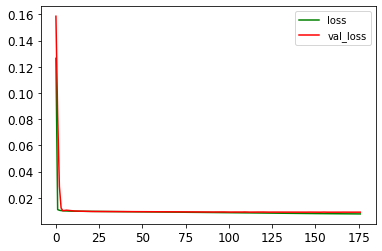

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0643 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 178/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0642

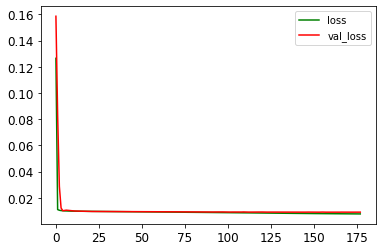

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0642 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 179/1500
75/75 [==============================] - ETA: 0s - loss: 0.0077 - mae: 0.0642

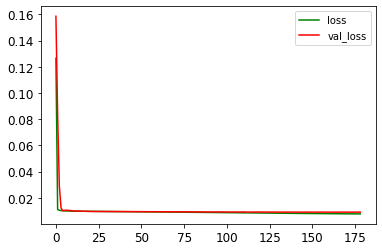

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0642 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 180/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0643

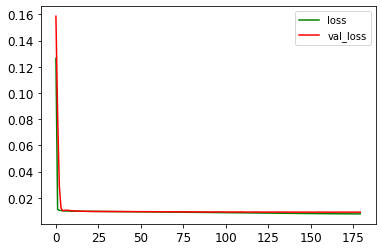

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0642 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 181/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0642

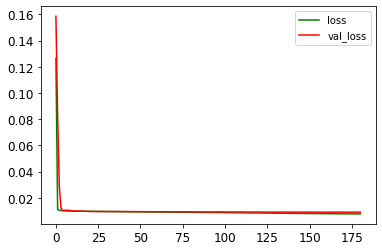

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0642 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 182/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0641

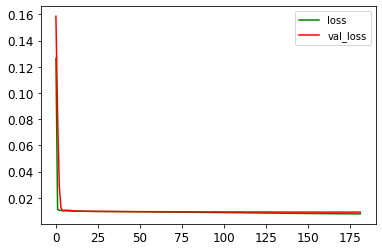

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0641 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 183/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0077 - mae: 0.0641

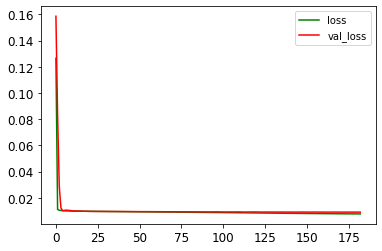

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0641 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 184/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0077 - mae: 0.0640

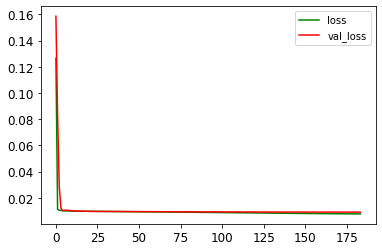

75/75 [==============================] - 1s 7ms/step - loss: 0.0077 - mae: 0.0640 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 185/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0076 - mae: 0.0640

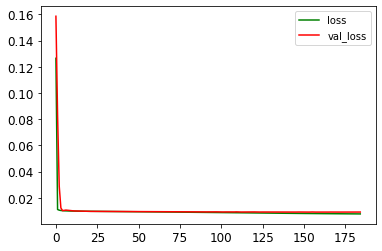

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0640 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 186/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0076 - mae: 0.0639

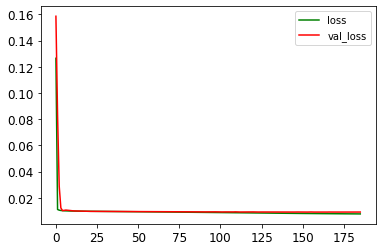

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0640 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 187/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0076 - mae: 0.0640

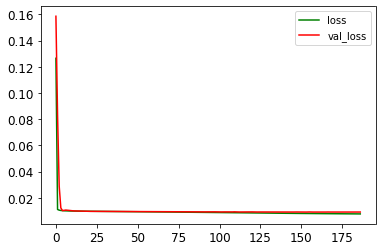

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0639 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 188/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0076 - mae: 0.0638

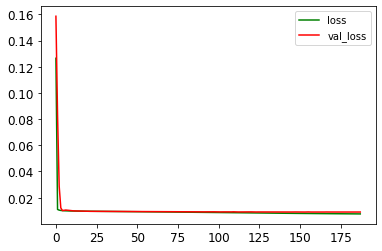

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0638 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 189/1500
75/75 [==============================] - ETA: 0s - loss: 0.0076 - mae: 0.0639

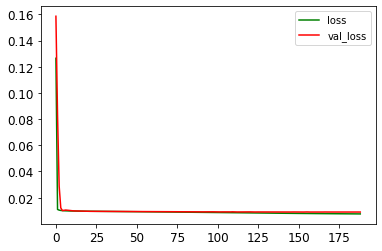

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0639 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 190/1500
75/75 [==============================] - ETA: 0s - loss: 0.0076 - mae: 0.0639

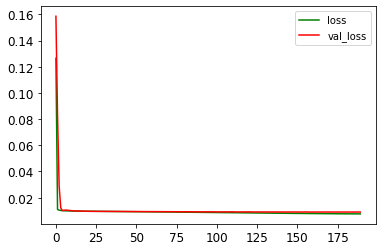

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0639 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 191/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0076 - mae: 0.0638

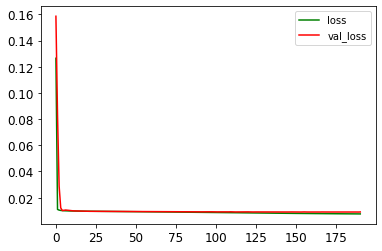

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0638 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 192/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0076 - mae: 0.0638

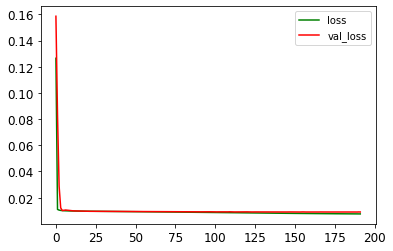

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0638 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 193/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0076 - mae: 0.0637

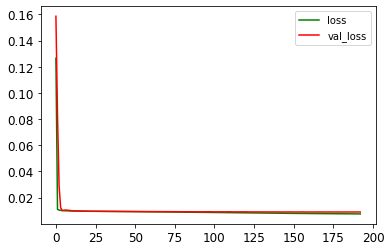

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0637 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 194/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0075 - mae: 0.0636

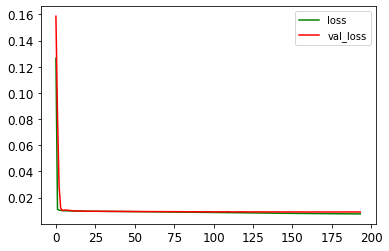

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0637 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 195/1500
75/75 [==============================] - ETA: 0s - loss: 0.0076 - mae: 0.0637

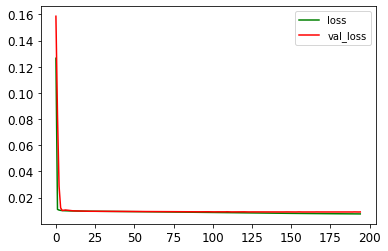

75/75 [==============================] - 1s 7ms/step - loss: 0.0076 - mae: 0.0637 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 196/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0636

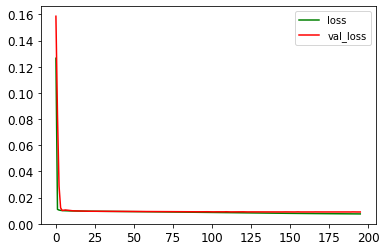

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0636 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 197/1500
69/75 [==========================>...] - ETA: 0s - loss: 0.0075 - mae: 0.0636

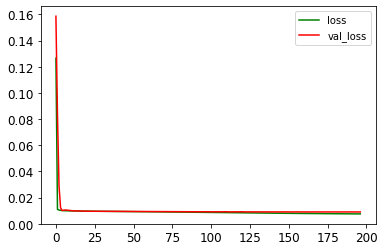

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0636 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 198/1500
75/75 [==============================] - ETA: 0s - loss: 0.0075 - mae: 0.0635

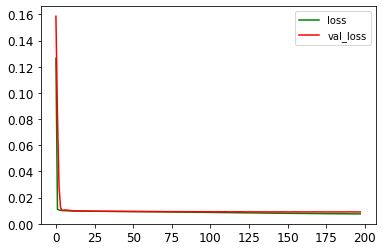

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0635 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 199/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0635

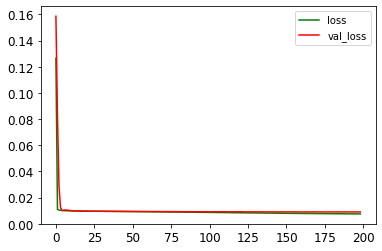

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0635 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 200/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0635

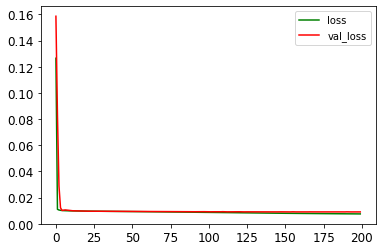

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0634 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 201/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0635

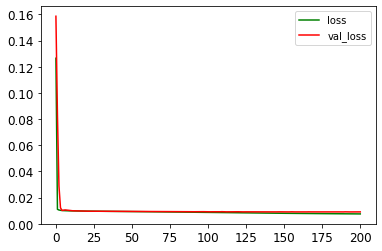

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0635 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 202/1500
75/75 [==============================] - ETA: 0s - loss: 0.0075 - mae: 0.0634

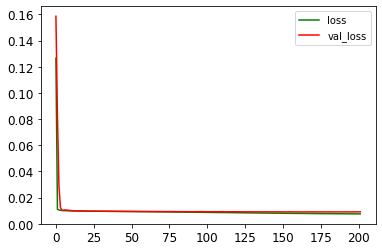

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0634 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 203/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0634

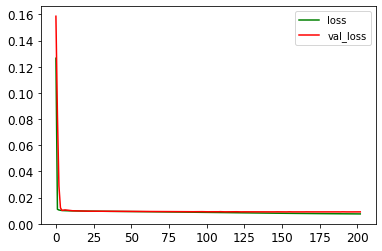

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0634 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 204/1500
75/75 [==============================] - ETA: 0s - loss: 0.0075 - mae: 0.0634

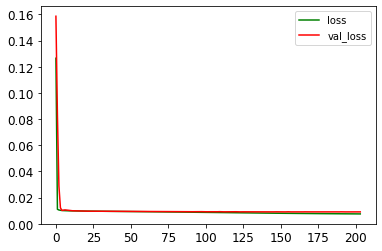

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0634 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 205/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0075 - mae: 0.0632

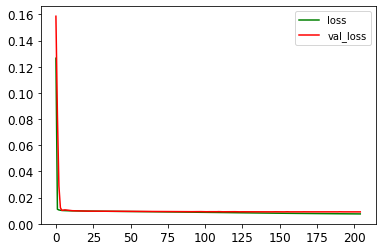

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0633 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 206/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0074 - mae: 0.0632

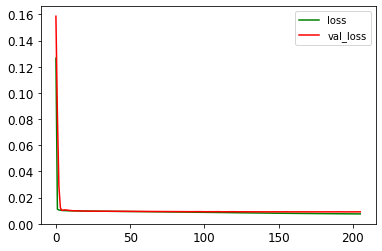

75/75 [==============================] - 1s 7ms/step - loss: 0.0075 - mae: 0.0633 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 207/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0632

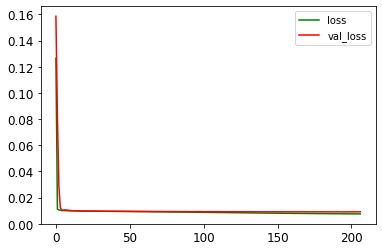

75/75 [==============================] - 1s 10ms/step - loss: 0.0075 - mae: 0.0633 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 208/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0632

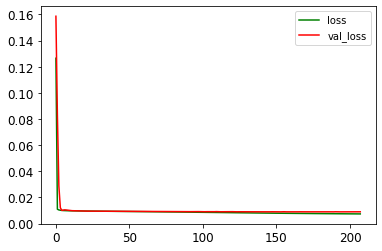

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0632 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 209/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0074 - mae: 0.0633

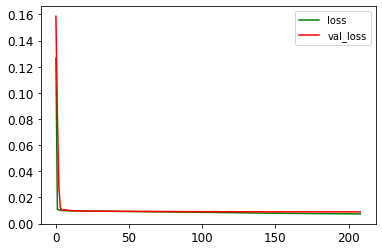

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0633 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 210/1500
75/75 [==============================] - ETA: 0s - loss: 0.0074 - mae: 0.0632

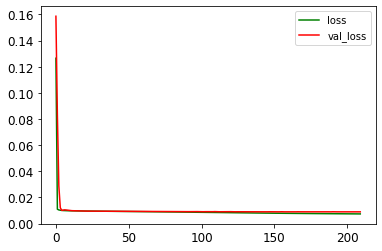

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0632 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 211/1500
75/75 [==============================] - ETA: 0s - loss: 0.0074 - mae: 0.0631

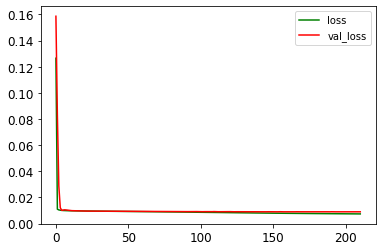

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0631 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 212/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0631

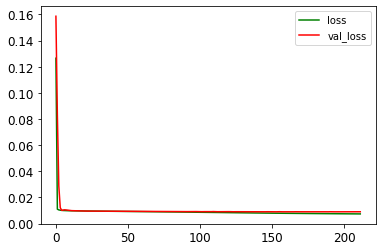

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0631 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 213/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0074 - mae: 0.0631

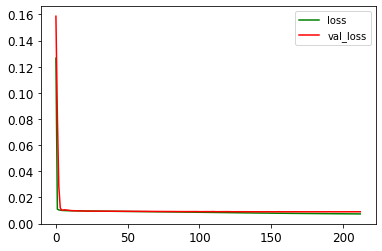

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0631 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 214/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0630

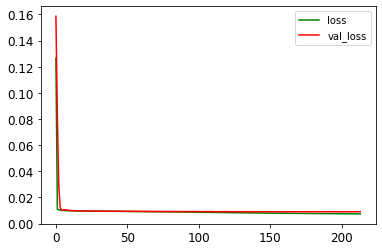

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0631 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 215/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0074 - mae: 0.0630

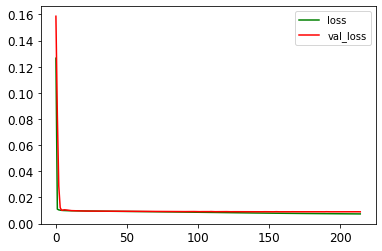

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0630 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 216/1500
75/75 [==============================] - ETA: 0s - loss: 0.0074 - mae: 0.0630

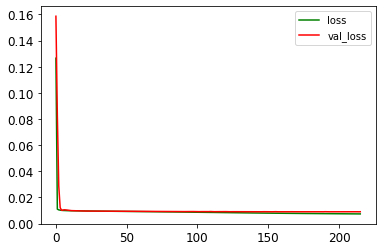

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0630 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 217/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0630

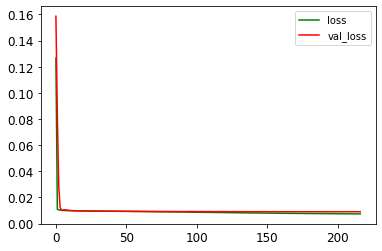

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0630 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 218/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0630

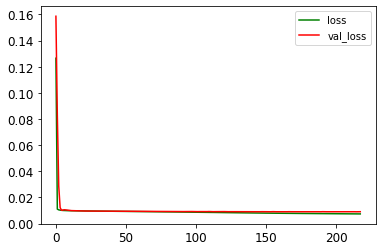

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0630 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 219/1500
75/75 [==============================] - ETA: 0s - loss: 0.0074 - mae: 0.0629

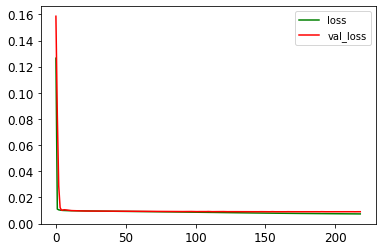

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0629 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 220/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0074 - mae: 0.0629

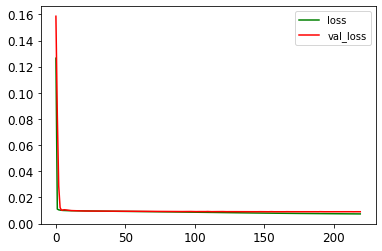

75/75 [==============================] - 1s 7ms/step - loss: 0.0074 - mae: 0.0629 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 221/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0628

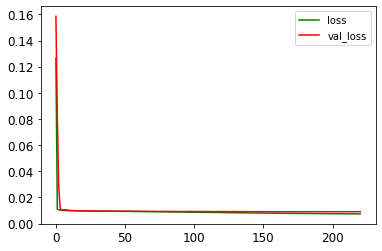

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0628 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 222/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0628

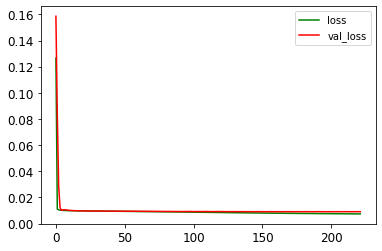

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0628 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 223/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0073 - mae: 0.0629

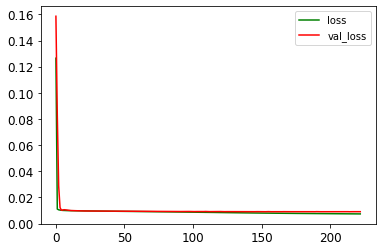

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0628 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 224/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0628

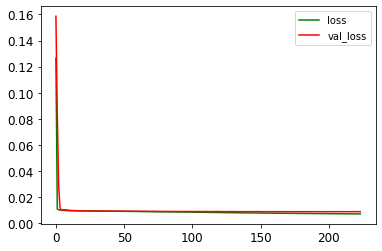

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0628 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 225/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0627

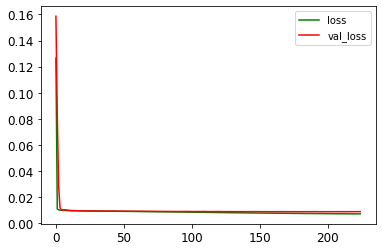

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0628 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 226/1500
75/75 [==============================] - ETA: 0s - loss: 0.0073 - mae: 0.0627

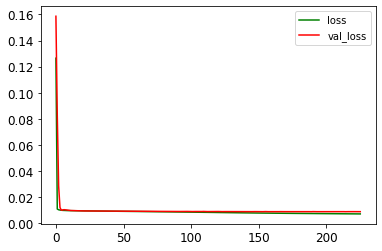

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0627 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 227/1500
75/75 [==============================] - ETA: 0s - loss: 0.0073 - mae: 0.0627

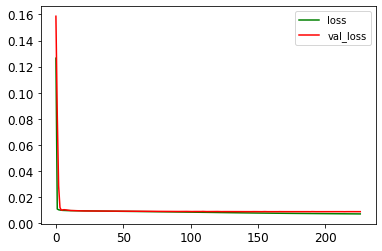

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0627 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 228/1500
75/75 [==============================] - ETA: 0s - loss: 0.0073 - mae: 0.0627

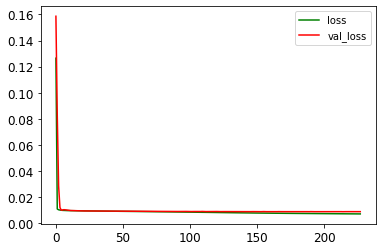

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0627 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 229/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0073 - mae: 0.0626

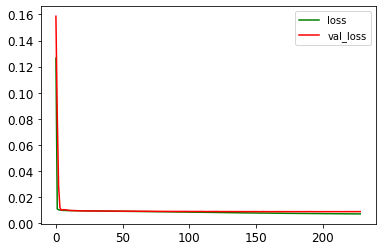

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0626 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 230/1500
75/75 [==============================] - ETA: 0s - loss: 0.0073 - mae: 0.0626

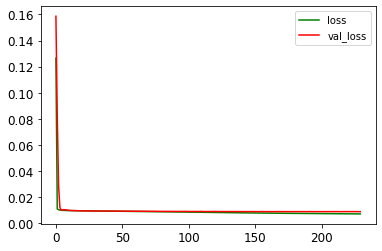

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0626 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 231/1500
75/75 [==============================] - ETA: 0s - loss: 0.0073 - mae: 0.0626

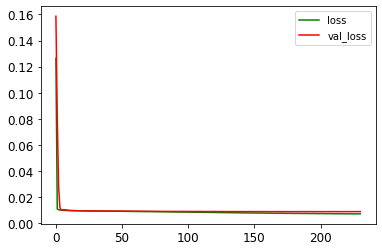

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0626 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 232/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0073 - mae: 0.0626

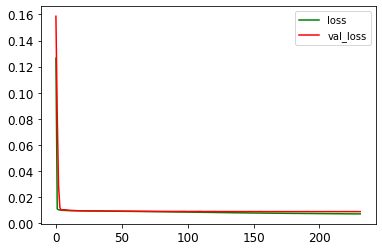

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0626 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 233/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0626

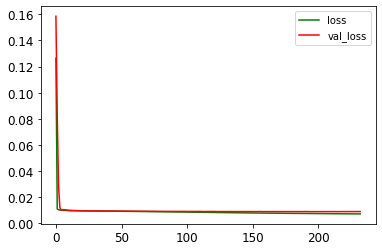

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0625 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 234/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0072 - mae: 0.0624

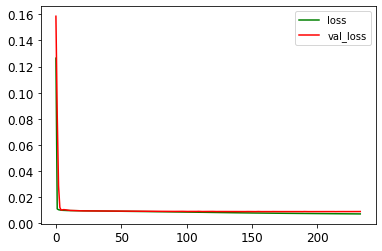

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0625 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 235/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0625

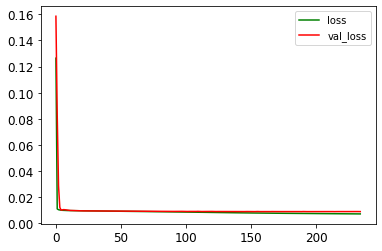

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0625 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 236/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0073 - mae: 0.0625

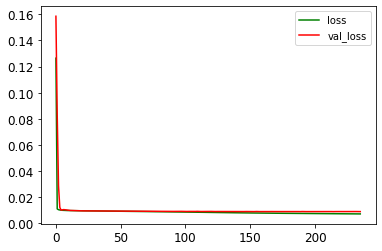

75/75 [==============================] - 1s 7ms/step - loss: 0.0073 - mae: 0.0625 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 237/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0624

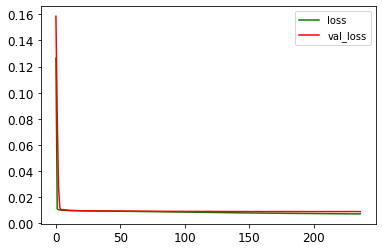

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0624 - val_loss: 0.0090 - val_mae: 0.0694
Epoch 238/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0072 - mae: 0.0624

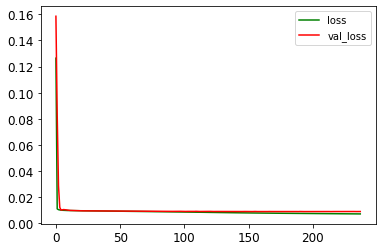

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0624 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 239/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0624

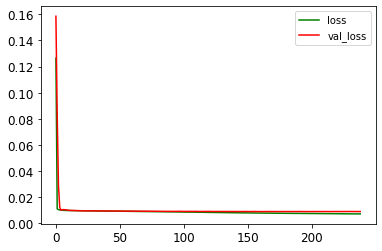

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0624 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 240/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0623

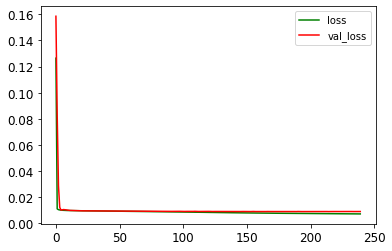

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0624 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 241/1500
75/75 [==============================] - ETA: 0s - loss: 0.0072 - mae: 0.0623

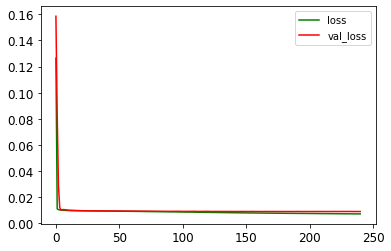

75/75 [==============================] - 1s 10ms/step - loss: 0.0072 - mae: 0.0623 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 242/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0623

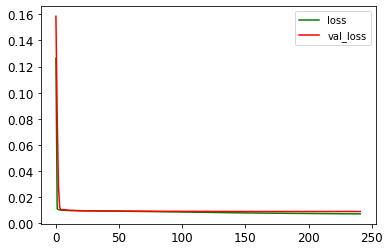

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0623 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 243/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0072 - mae: 0.0622

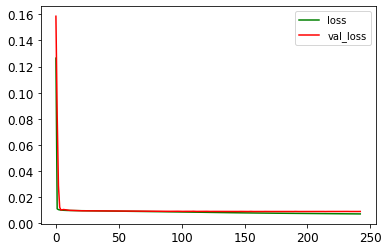

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0622 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 244/1500
75/75 [==============================] - ETA: 0s - loss: 0.0072 - mae: 0.0623

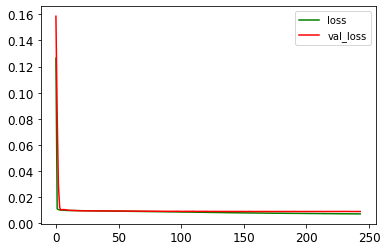

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0623 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 245/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0623

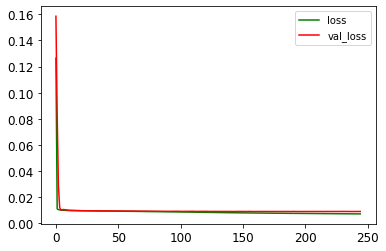

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0623 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 246/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0072 - mae: 0.0623

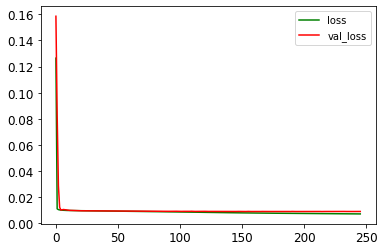

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0622 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 247/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0072 - mae: 0.0622

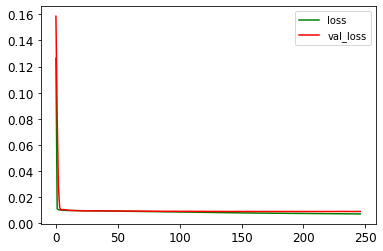

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0622 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 248/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0622

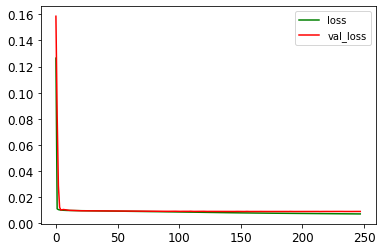

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0622 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 249/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0622

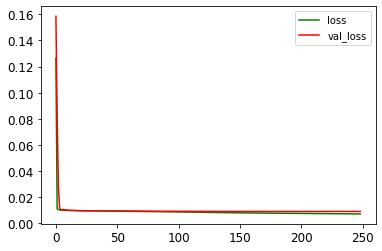

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0621 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 250/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0072 - mae: 0.0621

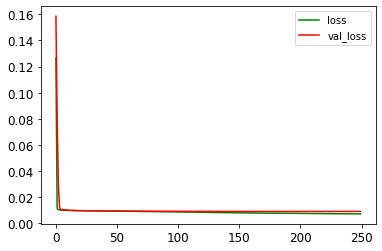

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0621 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 251/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0072 - mae: 0.0621

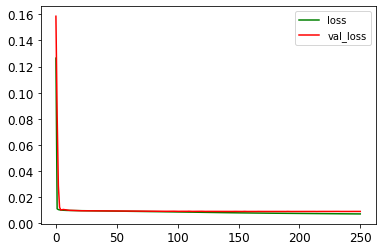

75/75 [==============================] - 1s 7ms/step - loss: 0.0072 - mae: 0.0621 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 252/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0621

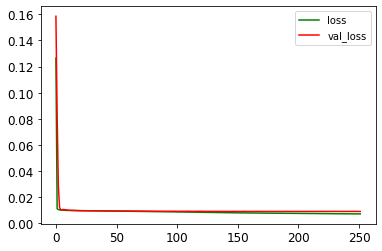

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0621 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 253/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0620

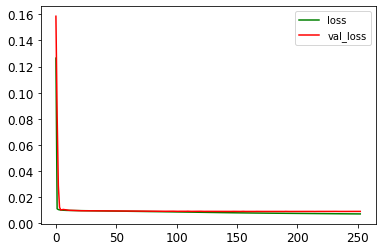

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0620 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 254/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0620

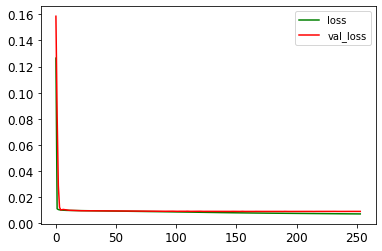

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0620 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 255/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0071 - mae: 0.0620

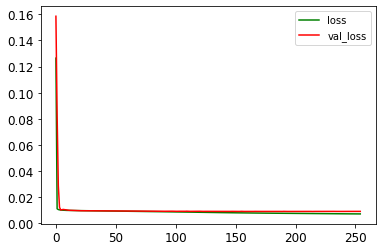

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0620 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 256/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0620

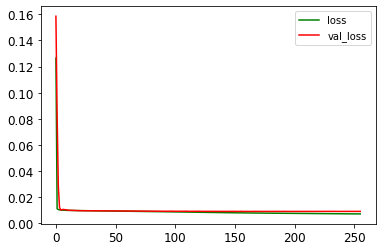

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0620 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 257/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0071 - mae: 0.0619

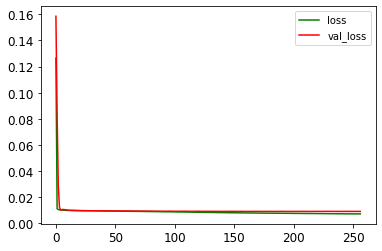

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0619 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 258/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0071 - mae: 0.0619

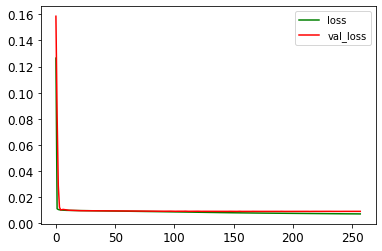

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0619 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 259/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0071 - mae: 0.0620

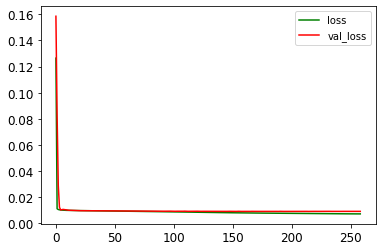

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0620 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 260/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0619

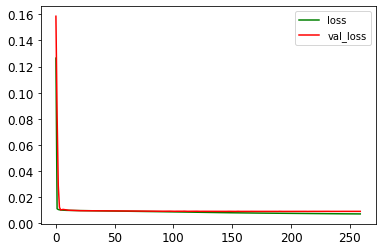

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0619 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 261/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0071 - mae: 0.0618

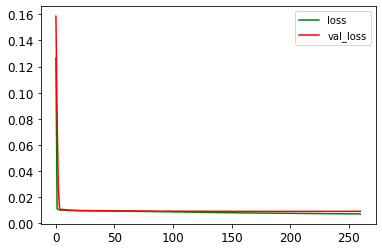

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0618 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 262/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0619

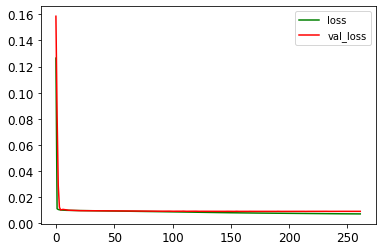

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0619 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 263/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0071 - mae: 0.0617

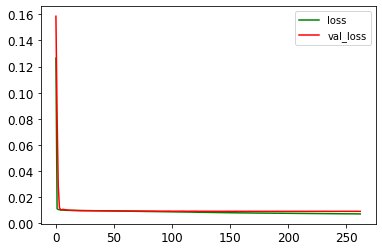

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0617 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 264/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0617

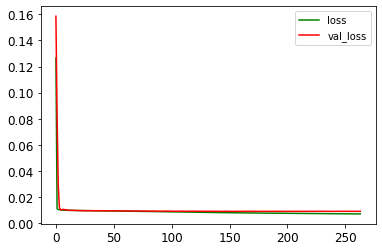

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0617 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 265/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0071 - mae: 0.0617

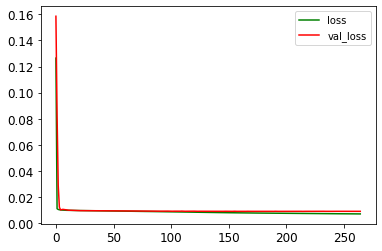

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0617 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 266/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0071 - mae: 0.0617

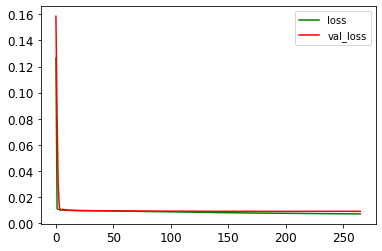

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0617 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 267/1500
75/75 [==============================] - ETA: 0s - loss: 0.0071 - mae: 0.0617

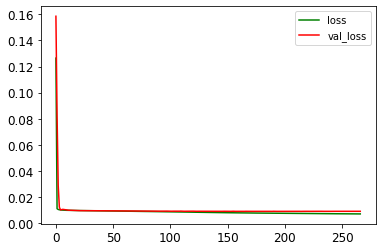

75/75 [==============================] - 1s 7ms/step - loss: 0.0071 - mae: 0.0617 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 268/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0616

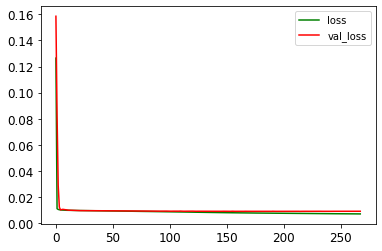

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 269/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0071 - mae: 0.0617

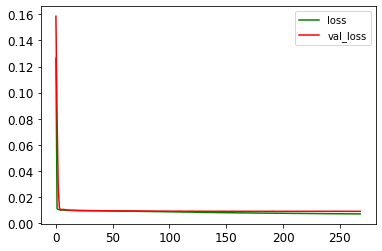

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 270/1500
75/75 [==============================] - ETA: 0s - loss: 0.0070 - mae: 0.0616

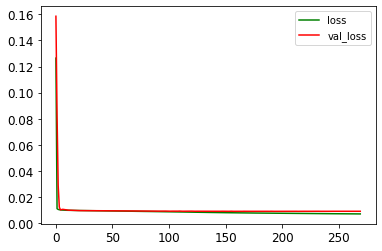

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 271/1500
75/75 [==============================] - ETA: 0s - loss: 0.0070 - mae: 0.0616

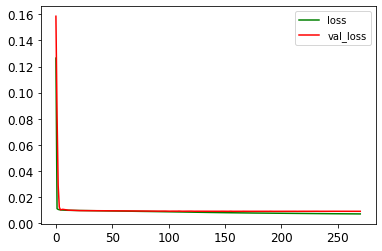

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 272/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0070 - mae: 0.0615

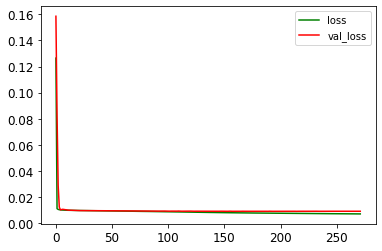

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 273/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0616

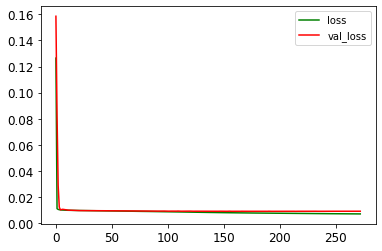

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 274/1500
75/75 [==============================] - ETA: 0s - loss: 0.0070 - mae: 0.0615

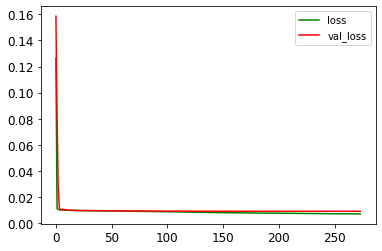

75/75 [==============================] - 1s 10ms/step - loss: 0.0070 - mae: 0.0615 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 275/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0070 - mae: 0.0614

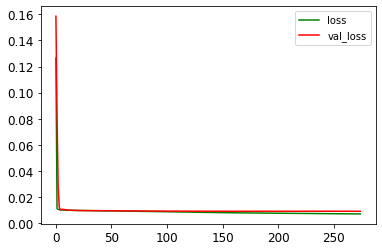

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0615 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 276/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0615

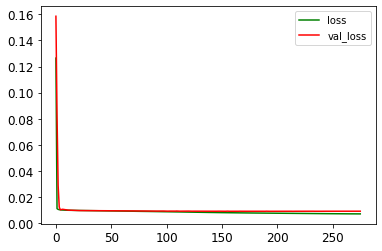

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0616 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 277/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0070 - mae: 0.0615

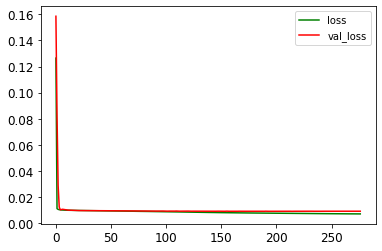

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0615 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 278/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0070 - mae: 0.0614

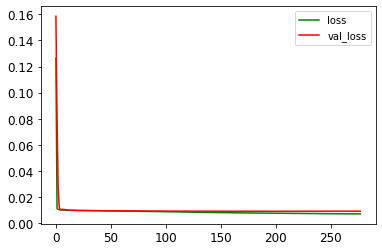

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 279/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0614

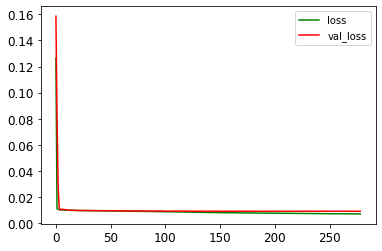

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 280/1500
75/75 [==============================] - ETA: 0s - loss: 0.0070 - mae: 0.0614

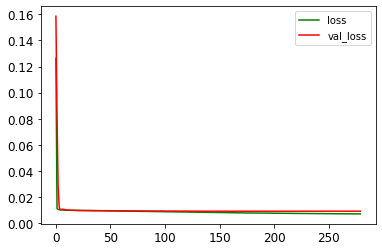

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 281/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0614

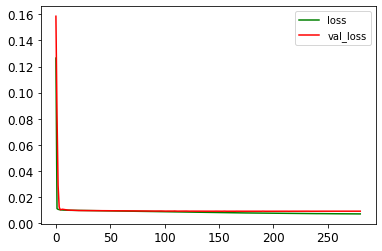

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 282/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0070 - mae: 0.0614

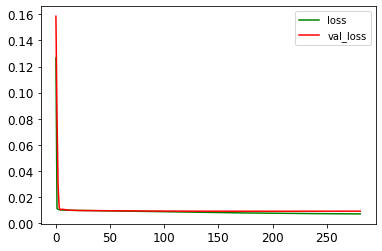

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 283/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0069 - mae: 0.0612

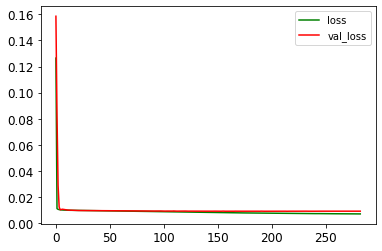

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0614 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 284/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0070 - mae: 0.0614

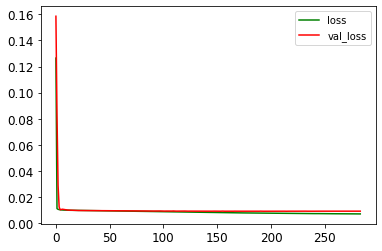

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0613 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 285/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0070 - mae: 0.0614

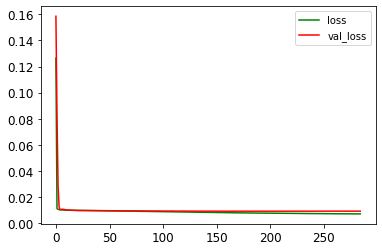

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0613 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 286/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0613

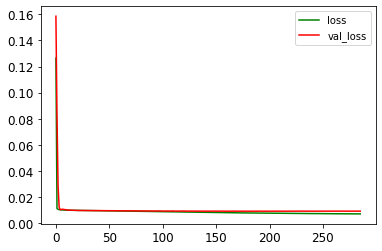

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0612 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 287/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0070 - mae: 0.0614

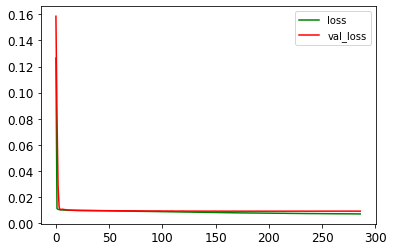

75/75 [==============================] - 1s 7ms/step - loss: 0.0070 - mae: 0.0613 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 288/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0069 - mae: 0.0611

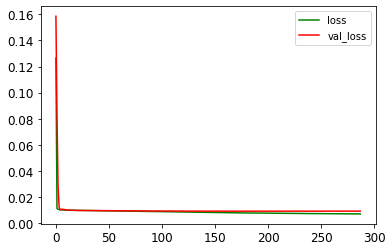

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0612 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 289/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0612

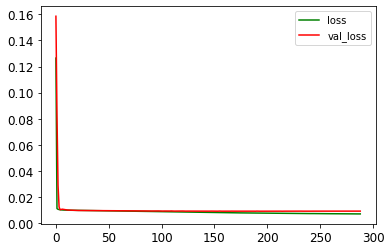

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0612 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 290/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0612

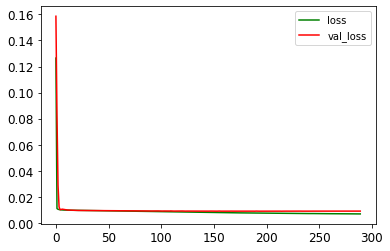

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0612 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 291/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0611

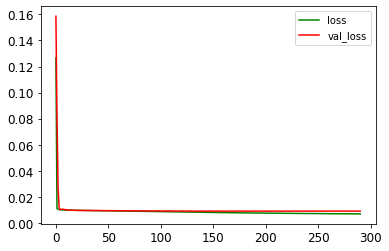

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 292/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0611

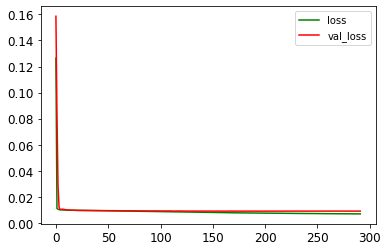

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 293/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0611

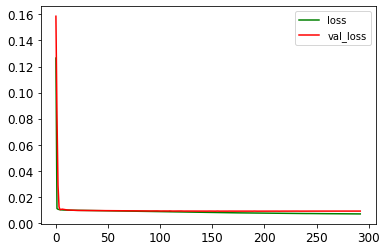

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 294/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0611

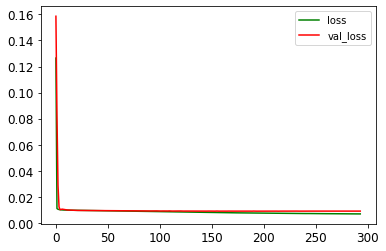

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 295/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0610

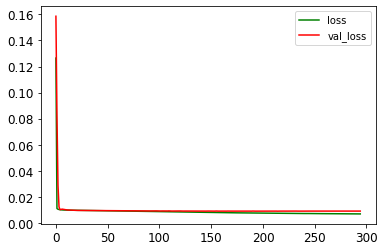

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0610 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 296/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0611

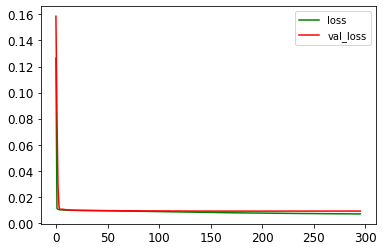

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 297/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0610

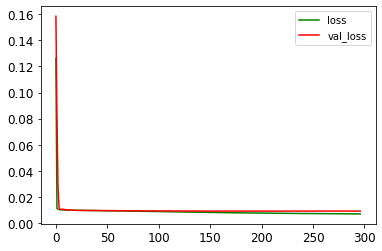

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0610 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 298/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0069 - mae: 0.0610

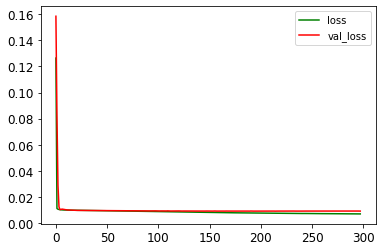

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0610 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 299/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0610

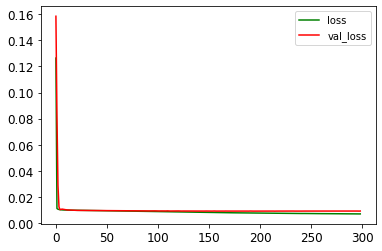

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0610 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 300/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0069 - mae: 0.0610

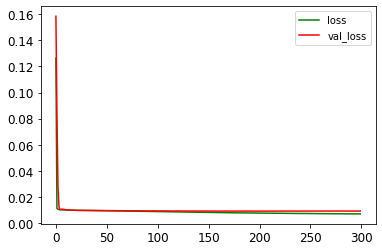

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0611 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 301/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0610

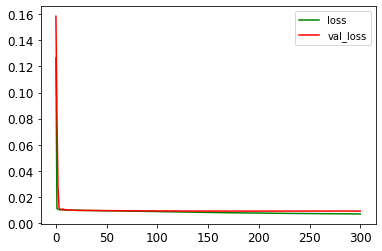

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0610 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 302/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0609

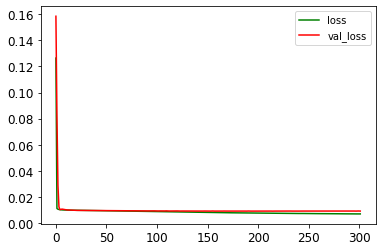

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0609 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 303/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0069 - mae: 0.0609

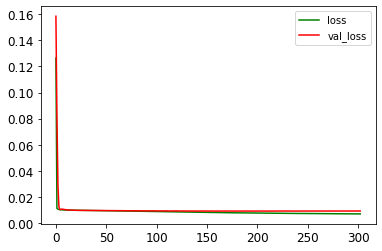

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0609 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 304/1500
75/75 [==============================] - ETA: 0s - loss: 0.0069 - mae: 0.0609

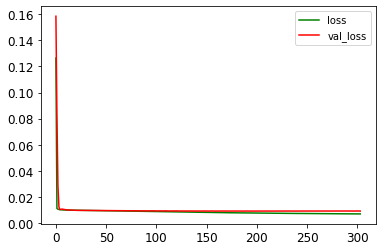

75/75 [==============================] - 1s 7ms/step - loss: 0.0069 - mae: 0.0609 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 305/1500
75/75 [==============================] - ETA: 0s - loss: 0.0068 - mae: 0.0609

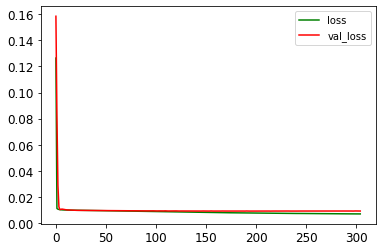

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0609 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 306/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0069 - mae: 0.0609

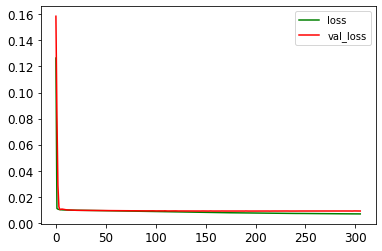

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0608 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 307/1500
75/75 [==============================] - ETA: 0s - loss: 0.0068 - mae: 0.0608

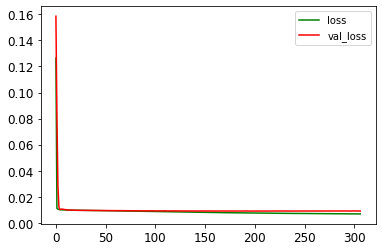

75/75 [==============================] - 1s 10ms/step - loss: 0.0068 - mae: 0.0608 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 308/1500
75/75 [==============================] - ETA: 0s - loss: 0.0068 - mae: 0.0608

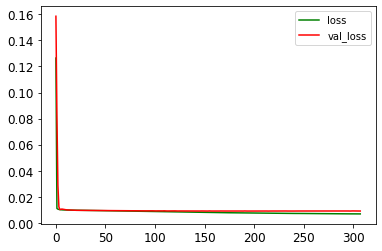

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0608 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 309/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0608

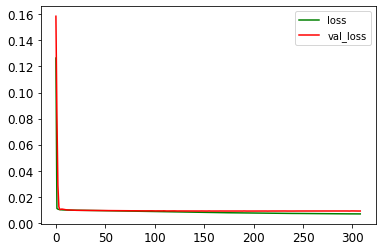

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0608 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 310/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0068 - mae: 0.0607

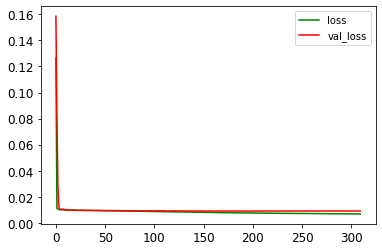

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0608 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 311/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0607

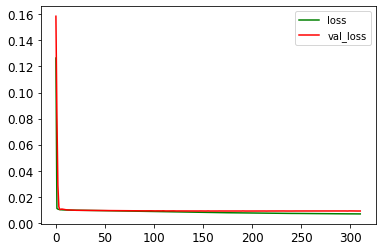

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0607 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 312/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0068 - mae: 0.0607

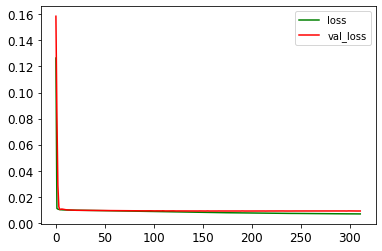

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0607 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 313/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0607

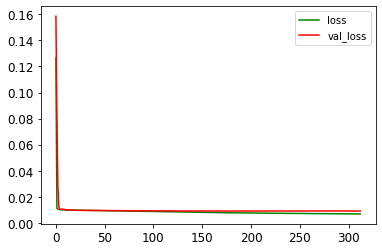

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0607 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 314/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0606

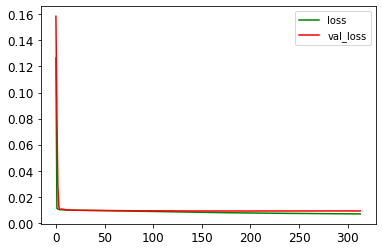

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 315/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0607

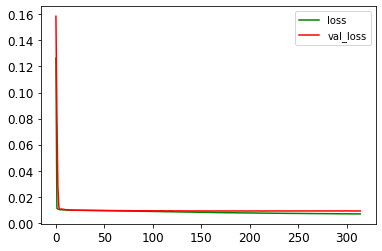

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 316/1500
75/75 [==============================] - ETA: 0s - loss: 0.0068 - mae: 0.0606

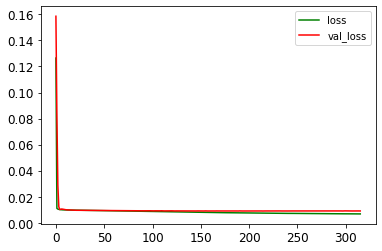

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 317/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0068 - mae: 0.0605

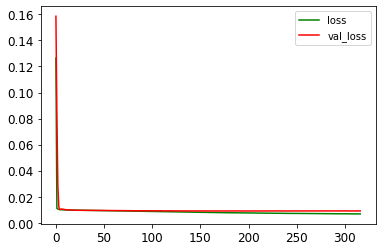

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 318/1500
75/75 [==============================] - ETA: 0s - loss: 0.0068 - mae: 0.0606

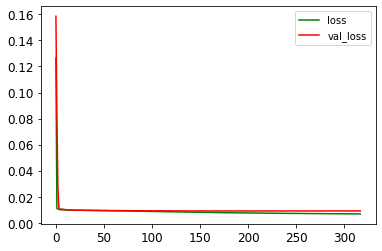

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 319/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0068 - mae: 0.0605

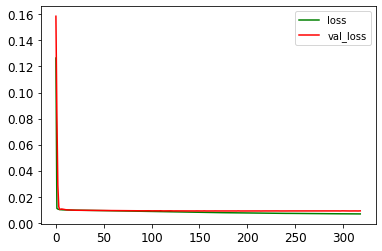

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 320/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0606

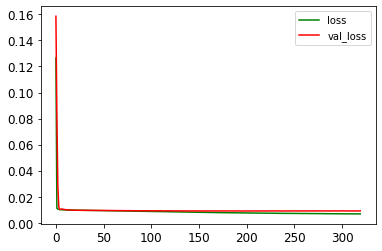

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0606 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 321/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0605

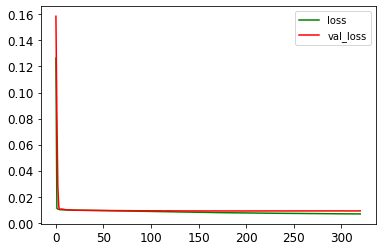

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0605 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 322/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0605

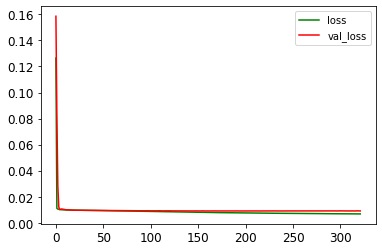

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0605 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 323/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0068 - mae: 0.0606

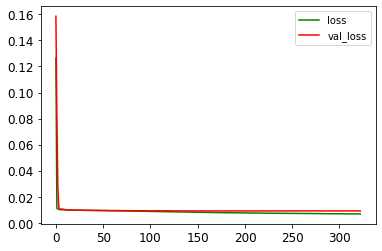

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0605 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 324/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0068 - mae: 0.0605

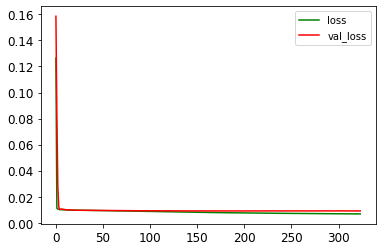

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0605 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 325/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0604

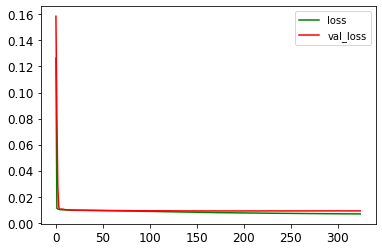

75/75 [==============================] - 1s 7ms/step - loss: 0.0068 - mae: 0.0605 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 326/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0068 - mae: 0.0605

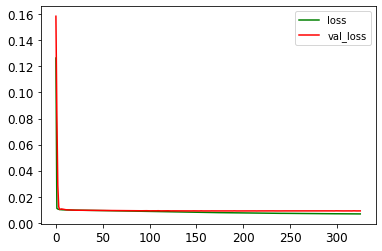

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0605 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 327/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0067 - mae: 0.0604

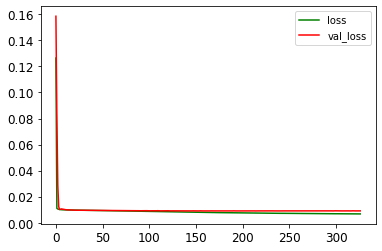

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0604 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 328/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0067 - mae: 0.0602

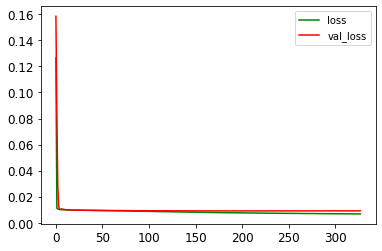

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0604 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 329/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0068 - mae: 0.0605

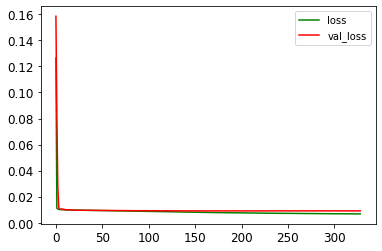

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0604 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 330/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0067 - mae: 0.0604

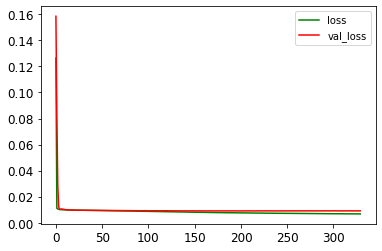

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 331/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0603

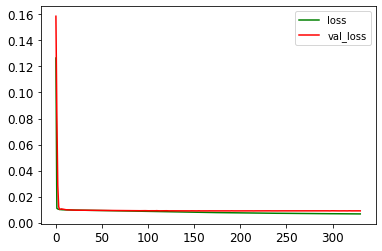

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 332/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0602

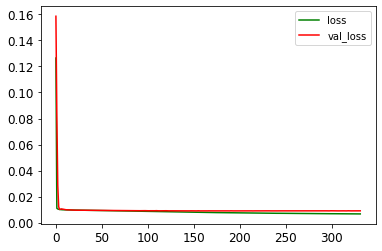

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 333/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0603

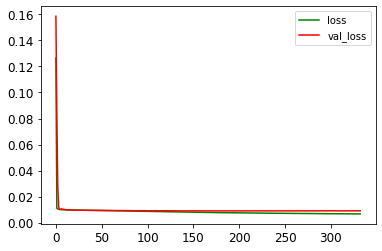

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 334/1500
75/75 [==============================] - ETA: 0s - loss: 0.0067 - mae: 0.0603

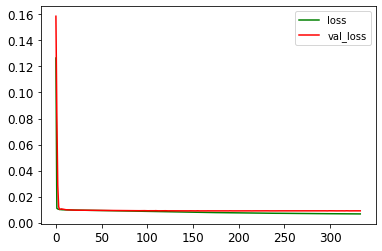

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 335/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0603

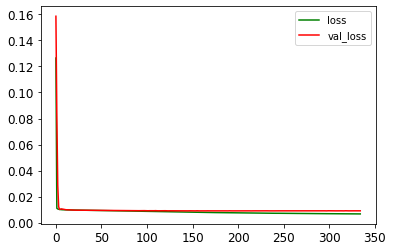

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0602 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 336/1500
75/75 [==============================] - ETA: 0s - loss: 0.0067 - mae: 0.0602

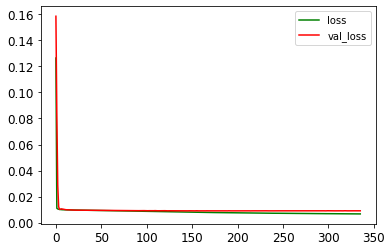

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0602 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 337/1500
75/75 [==============================] - ETA: 0s - loss: 0.0067 - mae: 0.0603

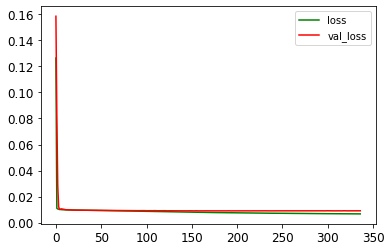

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 338/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0067 - mae: 0.0603

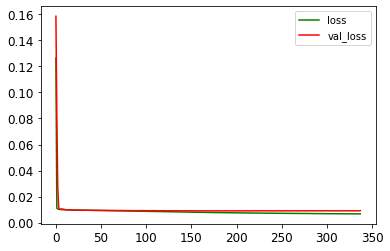

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0603 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 339/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0067 - mae: 0.0602

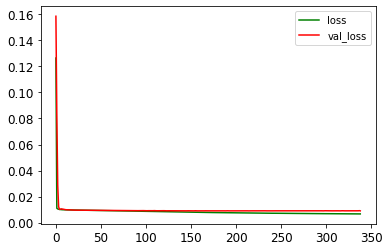

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0602 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 340/1500
75/75 [==============================] - ETA: 0s - loss: 0.0067 - mae: 0.0601

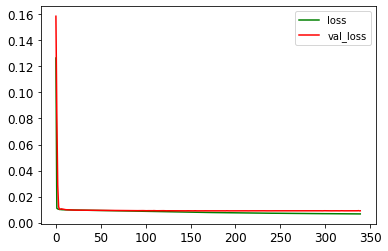

75/75 [==============================] - 1s 10ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 341/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

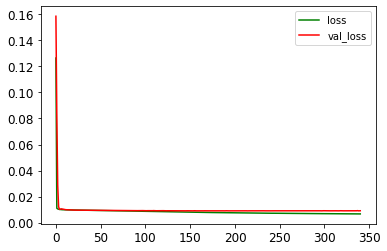

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 342/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0067 - mae: 0.0601

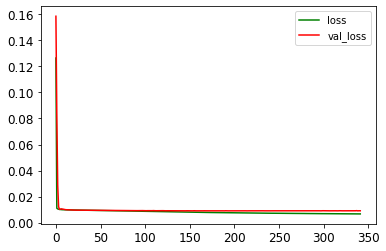

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 343/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

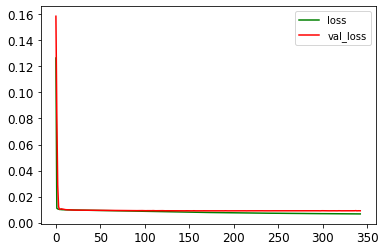

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 344/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

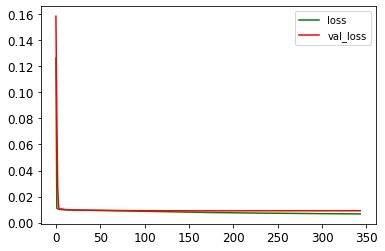

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0600 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 345/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0067 - mae: 0.0602

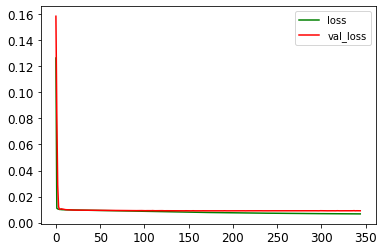

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 346/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0600

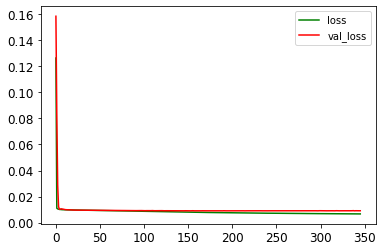

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 347/1500
75/75 [==============================] - ETA: 0s - loss: 0.0067 - mae: 0.0601

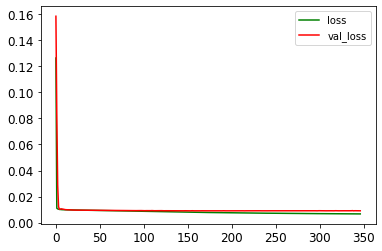

75/75 [==============================] - 1s 7ms/step - loss: 0.0067 - mae: 0.0601 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 348/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0600

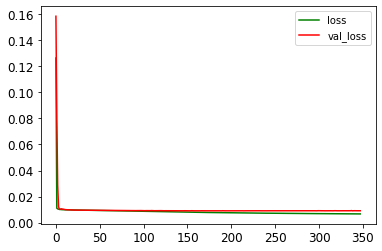

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0600 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 349/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0067 - mae: 0.0601

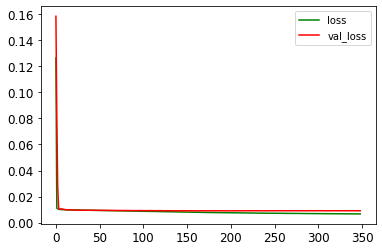

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0600 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 350/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

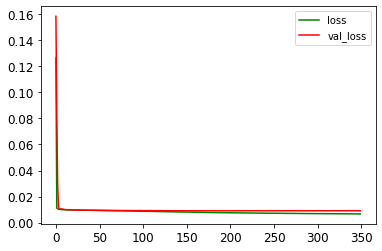

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0600 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 351/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0600

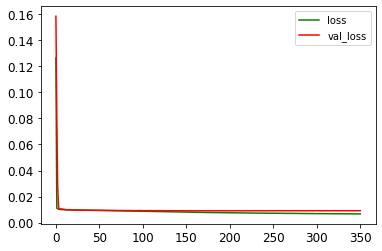

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0600 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 352/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

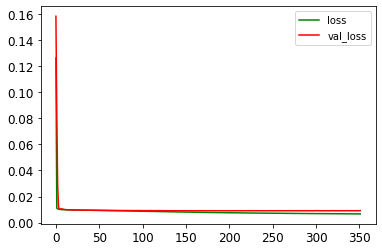

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 353/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0598

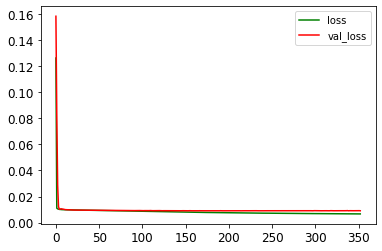

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 354/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0598

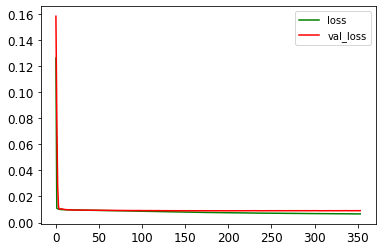

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 355/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0066 - mae: 0.0599

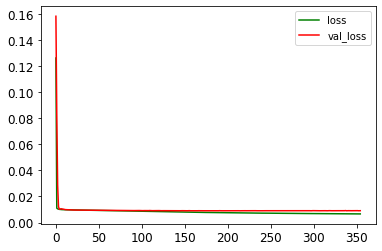

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 356/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0600

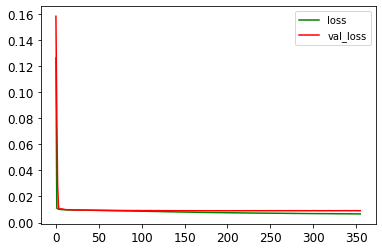

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 357/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0599

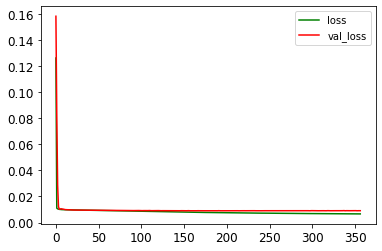

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 358/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0066 - mae: 0.0599

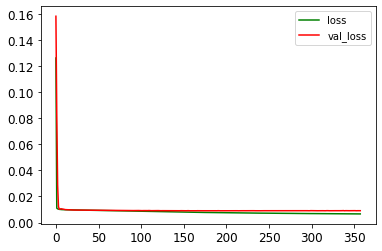

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0598 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 359/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0599

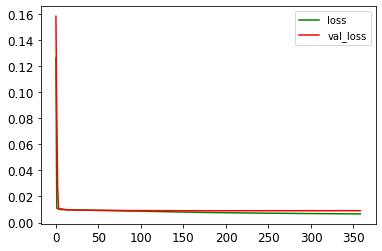

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0599 - val_loss: 0.0090 - val_mae: 0.0696
Epoch 360/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0597

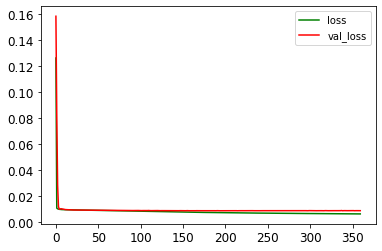

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0597 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 361/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0598

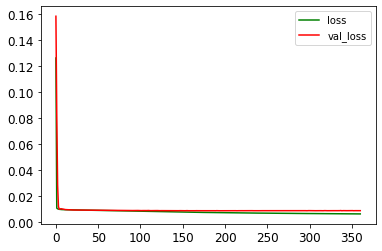

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0598 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 362/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

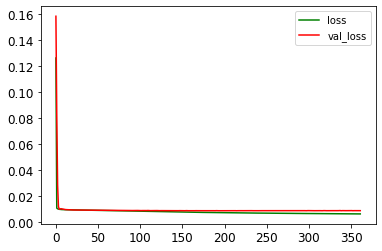

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0597 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 363/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

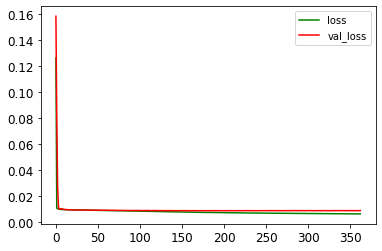

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 364/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0597

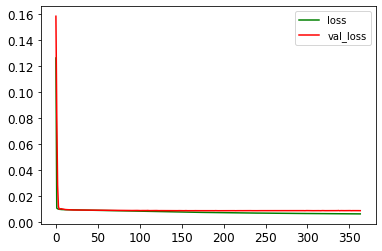

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0598 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 365/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0597

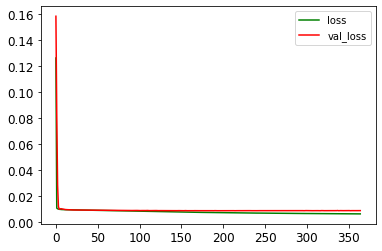

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0598 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 366/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0596

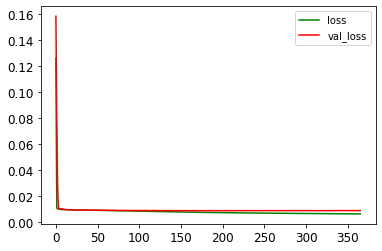

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 367/1500
75/75 [==============================] - ETA: 0s - loss: 0.0066 - mae: 0.0597

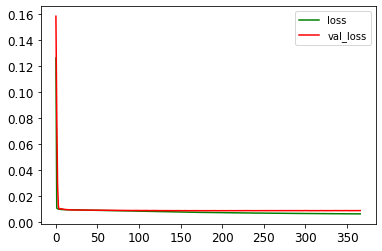

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0597 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 368/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0596

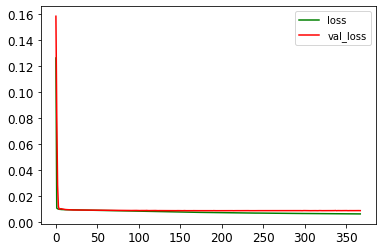

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 369/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0066 - mae: 0.0597

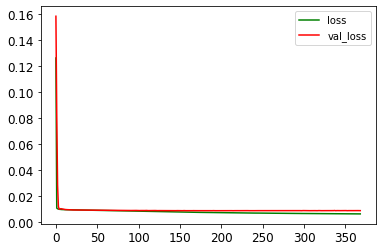

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0597 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 370/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0065 - mae: 0.0596

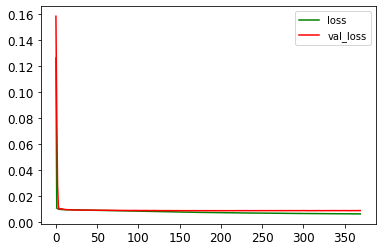

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 371/1500
75/75 [==============================] - ETA: 0s - loss: 0.0066 - mae: 0.0597

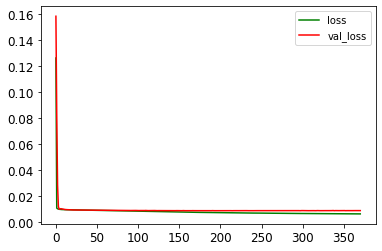

75/75 [==============================] - 1s 7ms/step - loss: 0.0066 - mae: 0.0597 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 372/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0066 - mae: 0.0597

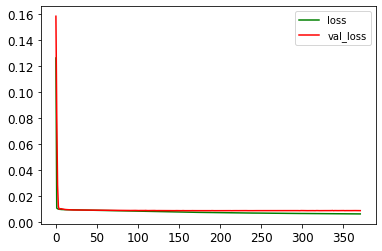

75/75 [==============================] - 1s 10ms/step - loss: 0.0065 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 373/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0595

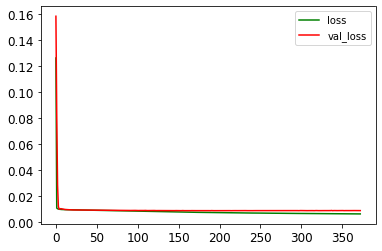

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 374/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0596

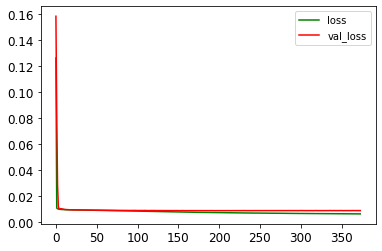

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0596 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 375/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

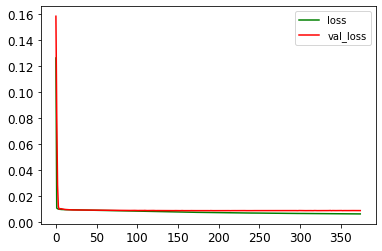

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 376/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0595

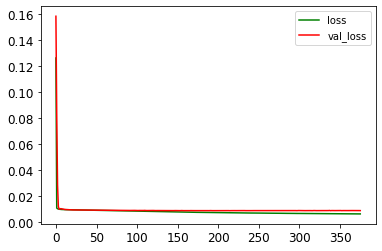

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 377/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0595

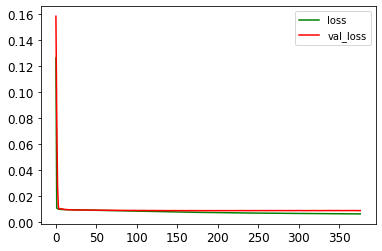

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 378/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

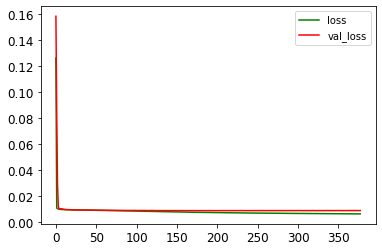

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 379/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0593

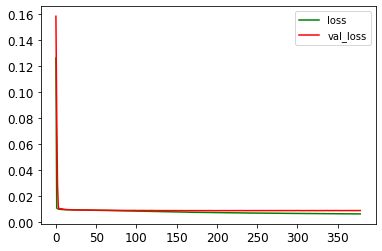

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 380/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

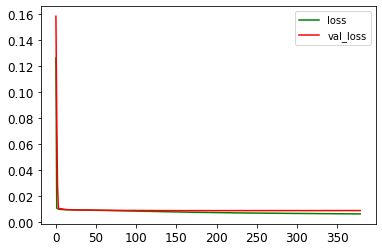

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 381/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0593

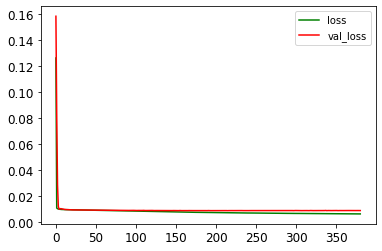

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0594 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 382/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0594

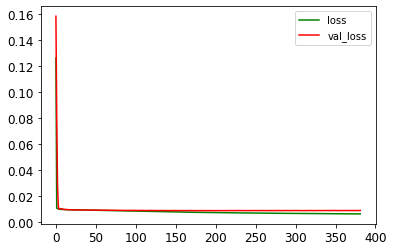

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0594 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 383/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0065 - mae: 0.0595

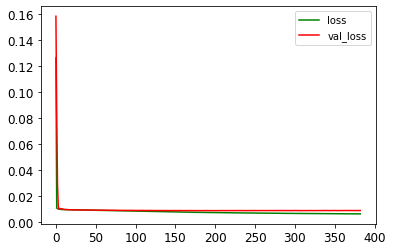

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0595 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 384/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0594

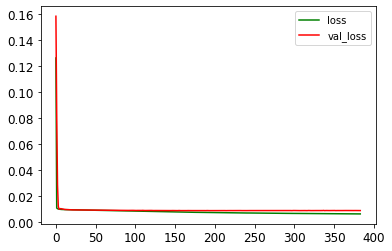

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0594 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 385/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0593

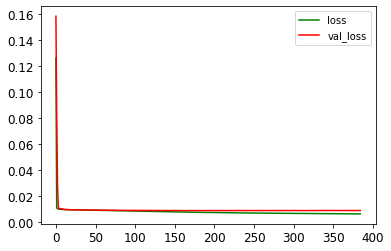

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 386/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0593

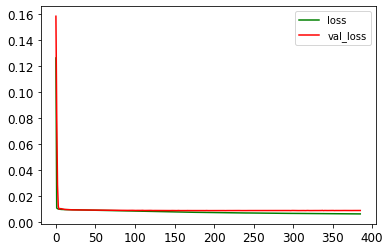

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 387/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0593

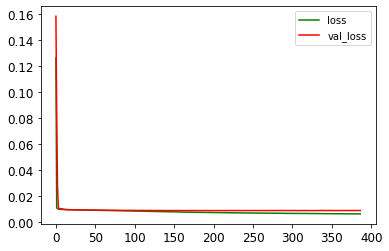

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 388/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0593

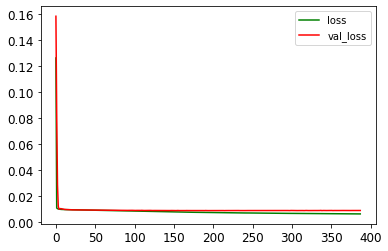

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 389/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0592

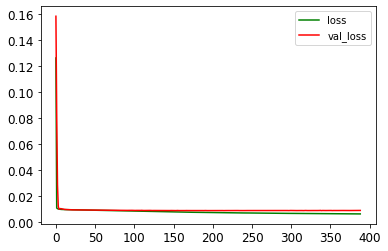

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 390/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0594

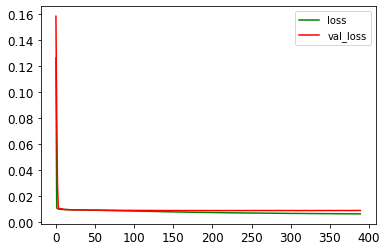

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0594 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 391/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0593

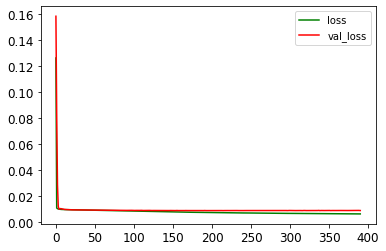

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0593 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 392/1500
75/75 [==============================] - ETA: 0s - loss: 0.0065 - mae: 0.0592

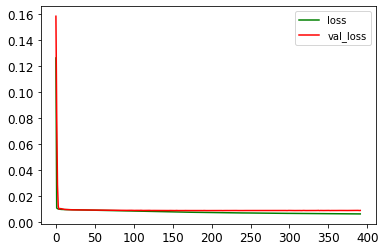

75/75 [==============================] - 1s 7ms/step - loss: 0.0065 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 393/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0592

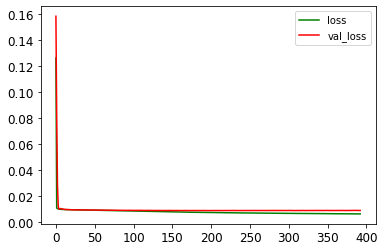

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 394/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0064 - mae: 0.0590

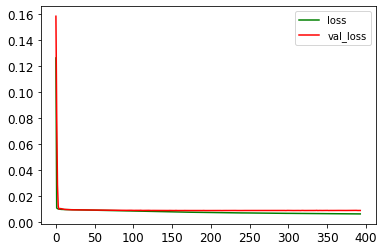

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 395/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0592

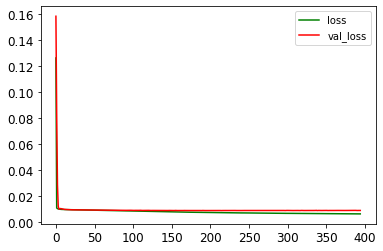

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 396/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0065 - mae: 0.0592

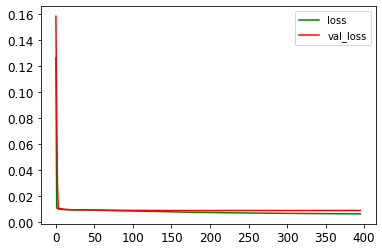

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 397/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0065 - mae: 0.0592

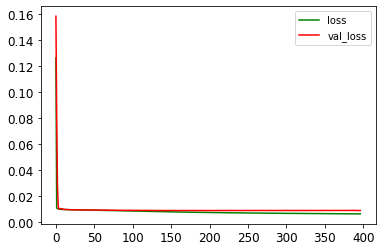

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 398/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0592

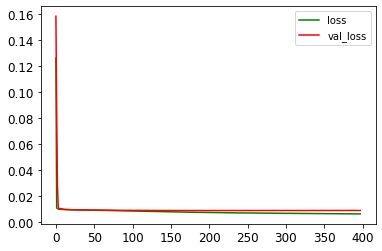

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 399/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0592

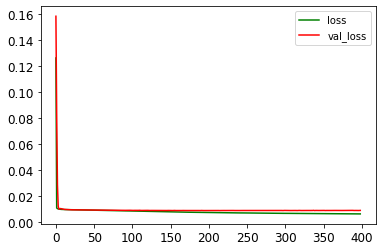

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0592 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 400/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0591

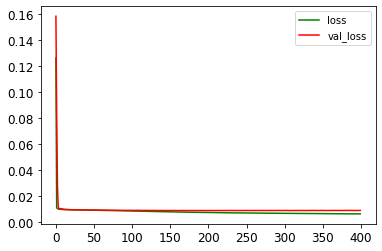

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 401/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0591

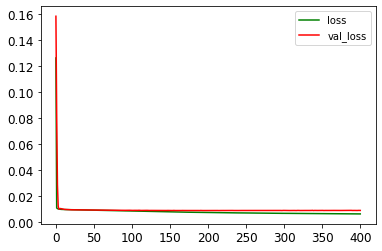

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 402/1500
75/75 [==============================] - ETA: 0s - loss: 0.0064 - mae: 0.0591

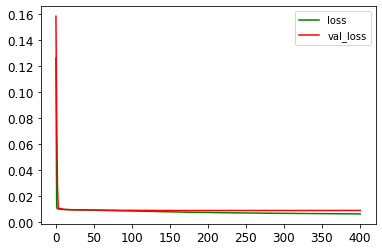

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 403/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0590

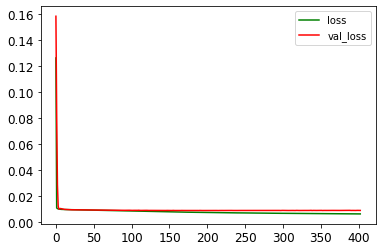

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0590 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 404/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0064 - mae: 0.0590

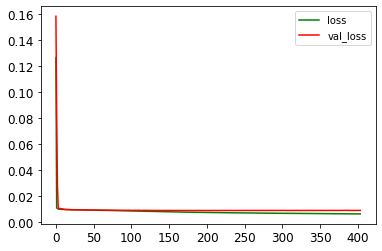

75/75 [==============================] - 1s 10ms/step - loss: 0.0064 - mae: 0.0590 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 405/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0591

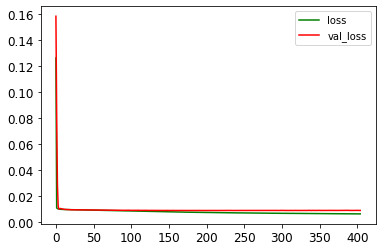

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 406/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0064 - mae: 0.0590

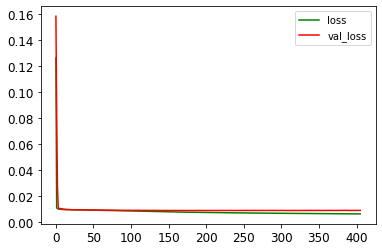

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0590 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 407/1500
75/75 [==============================] - ETA: 0s - loss: 0.0064 - mae: 0.0591

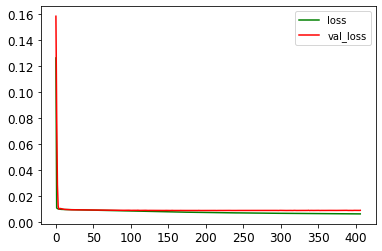

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 408/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0591

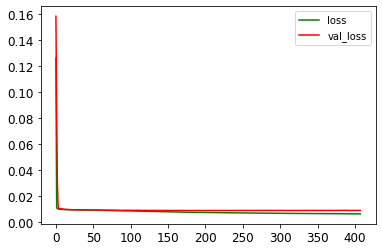

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0591 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 409/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0591

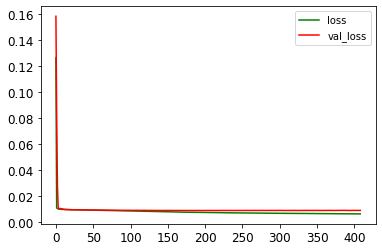

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0590 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 410/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0064 - mae: 0.0588

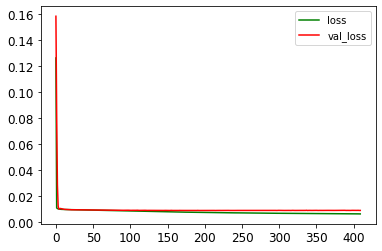

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0589 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 411/1500
75/75 [==============================] - ETA: 0s - loss: 0.0064 - mae: 0.0588

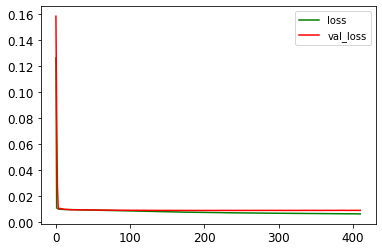

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 412/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0590

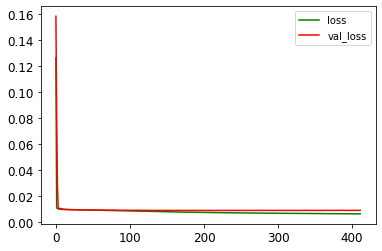

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0589 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 413/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0589

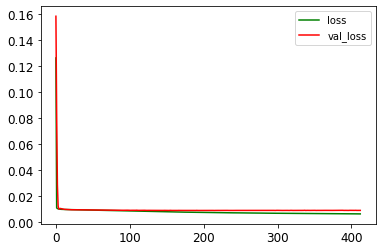

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0589 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 414/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0589

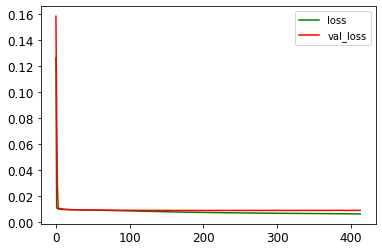

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0589 - val_loss: 0.0090 - val_mae: 0.0695
Epoch 415/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0588

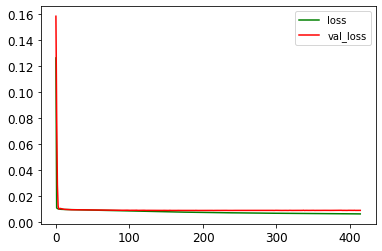

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 416/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0064 - mae: 0.0588

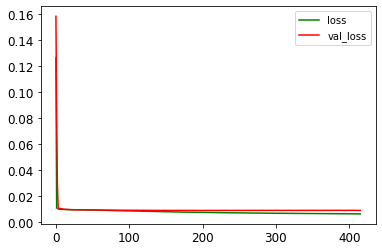

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 417/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

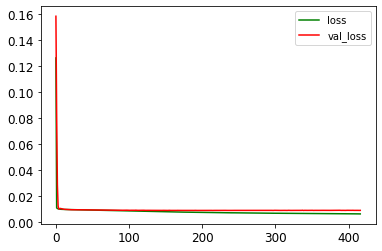

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 418/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0589

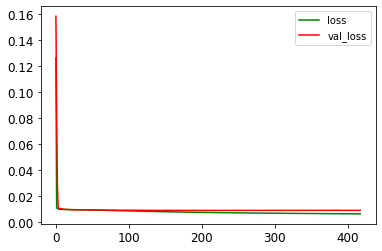

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0589 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 419/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0588

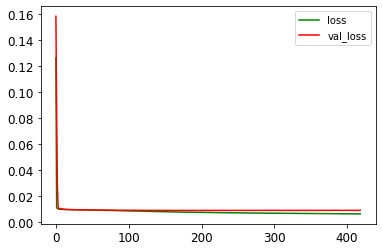

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 420/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

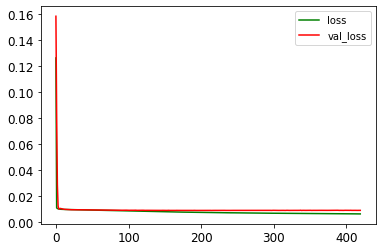

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 421/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0588

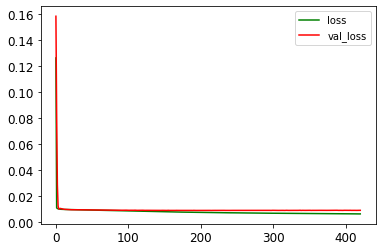

75/75 [==============================] - 1s 7ms/step - loss: 0.0064 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 422/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0063 - mae: 0.0587

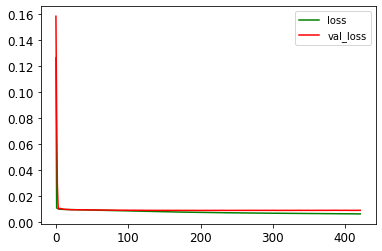

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 423/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0588

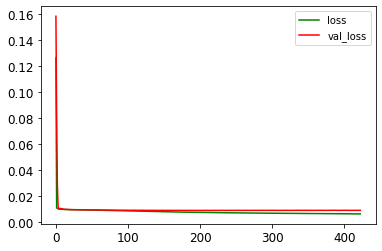

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 424/1500
75/75 [==============================] - ETA: 0s - loss: 0.0063 - mae: 0.0587

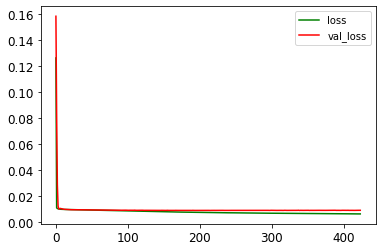

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 425/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0064 - mae: 0.0588

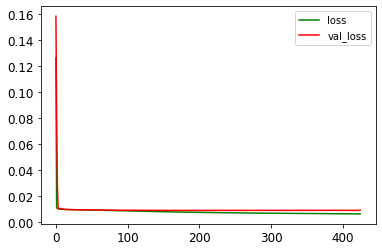

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0588 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 426/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

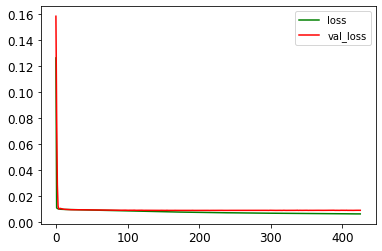

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 427/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

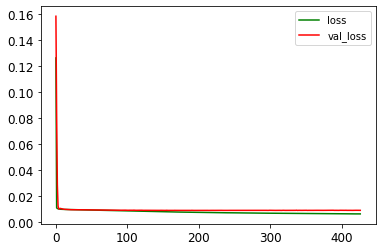

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 428/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

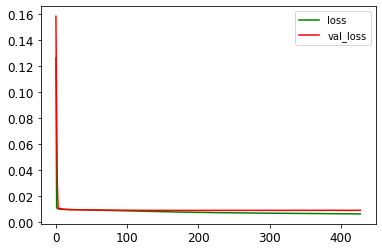

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 429/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0063 - mae: 0.0586

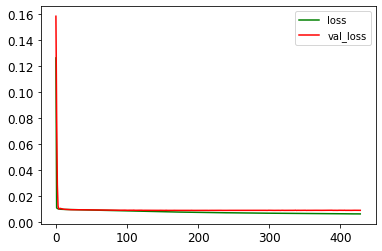

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 430/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0587

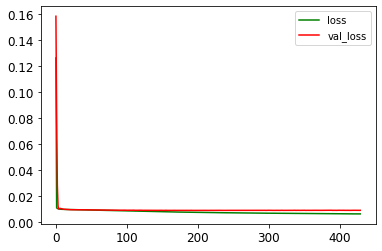

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0587 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 431/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0585

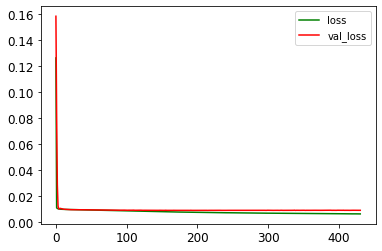

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 432/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0587

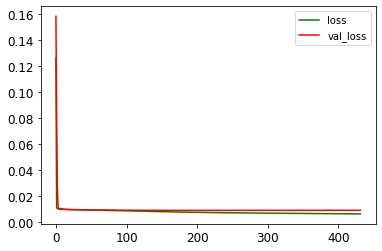

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 433/1500
75/75 [==============================] - ETA: 0s - loss: 0.0063 - mae: 0.0586

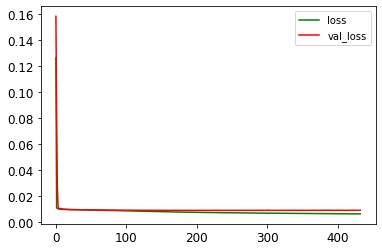

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 434/1500
75/75 [==============================] - ETA: 0s - loss: 0.0063 - mae: 0.0585

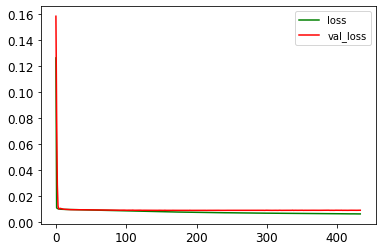

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0585 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 435/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0587

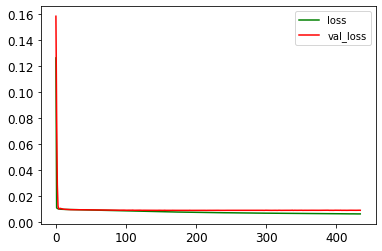

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 436/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0585

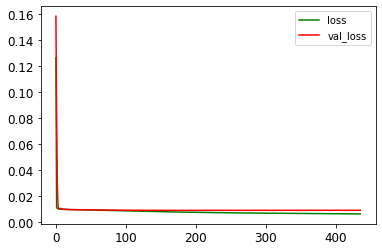

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 437/1500
75/75 [==============================] - ETA: 0s - loss: 0.0063 - mae: 0.0585

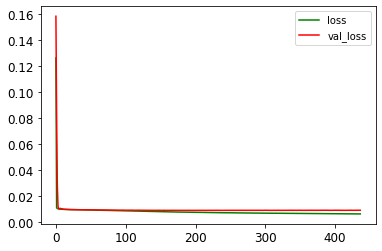

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0585 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 438/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0587

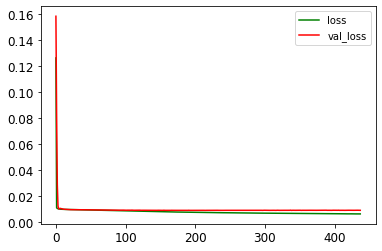

75/75 [==============================] - 1s 10ms/step - loss: 0.0063 - mae: 0.0585 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 439/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0586

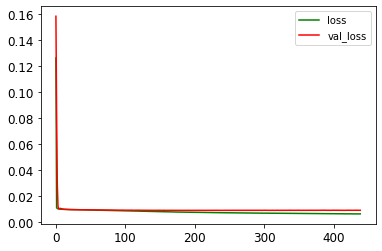

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 440/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0586

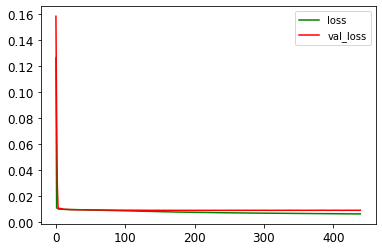

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0586 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 441/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0586

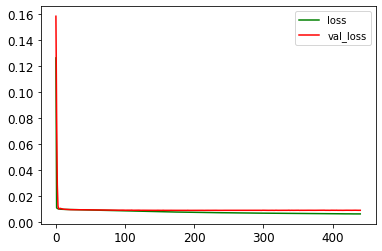

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0585 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 442/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0063 - mae: 0.0584

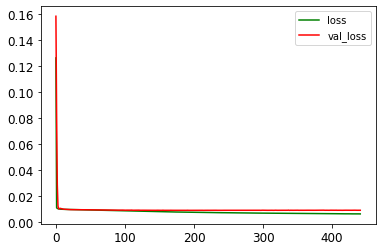

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 443/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0583

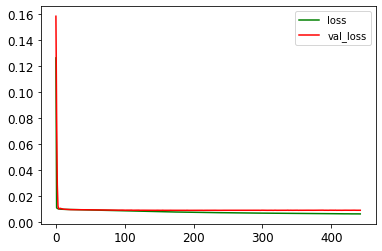

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 444/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0062 - mae: 0.0583

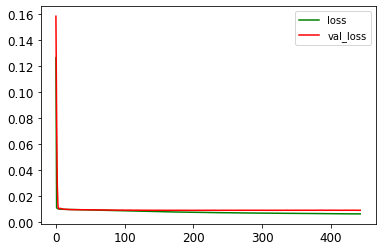

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 445/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0582

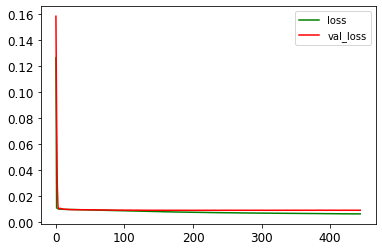

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 446/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0063 - mae: 0.0584

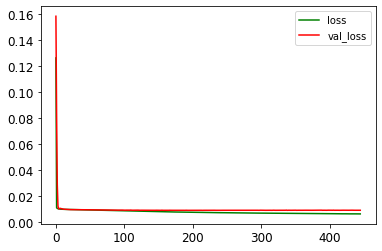

75/75 [==============================] - 1s 7ms/step - loss: 0.0063 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 447/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0063 - mae: 0.0584

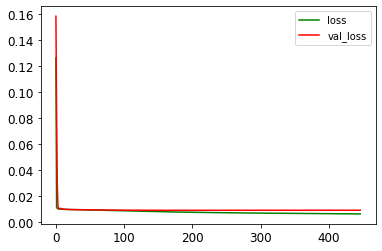

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 448/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0062 - mae: 0.0583

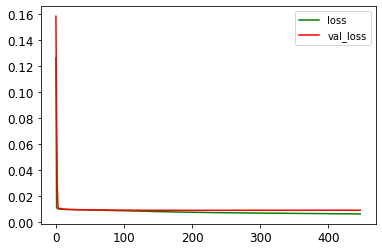

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 449/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0583

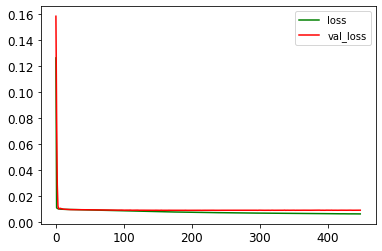

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0584 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 450/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0584

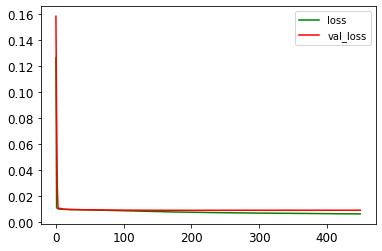

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 451/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0062 - mae: 0.0583

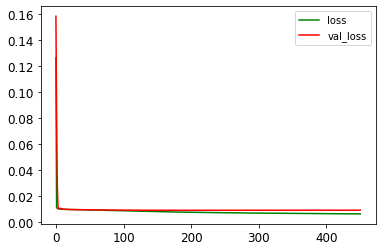

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 452/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0584

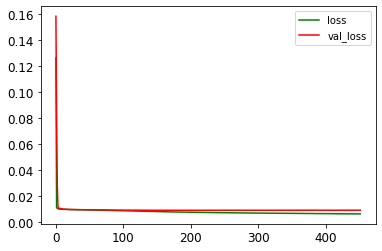

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 453/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0584

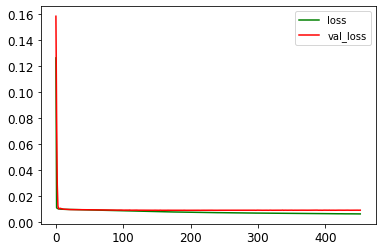

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 454/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0585

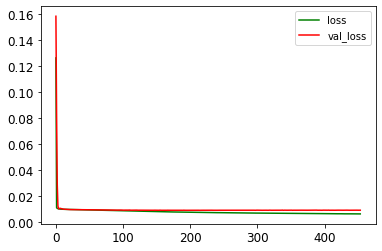

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 455/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0062 - mae: 0.0582

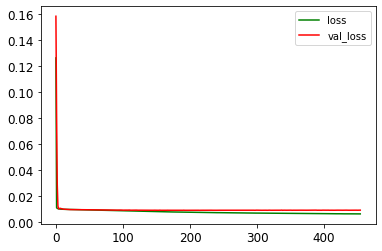

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 456/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0582

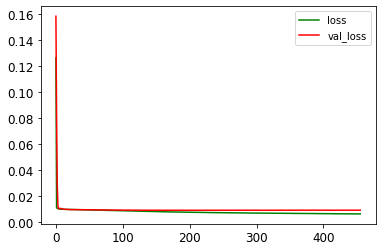

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 457/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0582

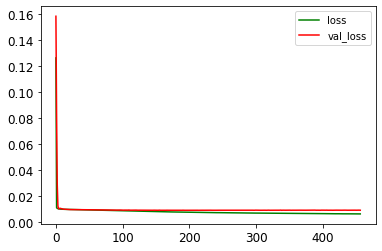

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 458/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0062 - mae: 0.0582

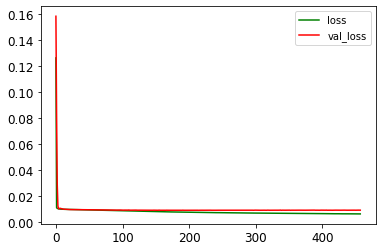

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 459/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0063 - mae: 0.0584

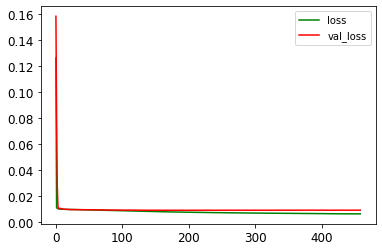

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 460/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

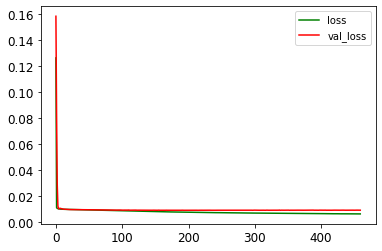

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 461/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0583

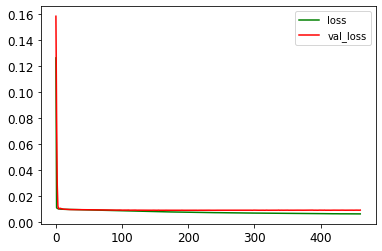

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 462/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0583

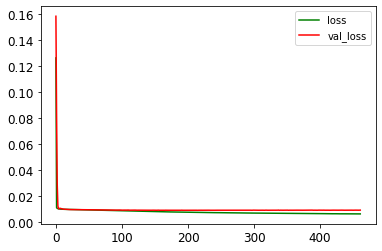

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 463/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0582

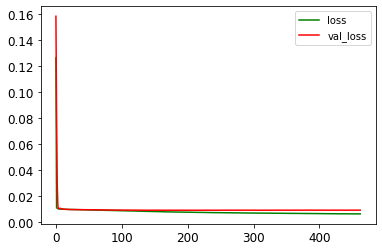

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 464/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0582

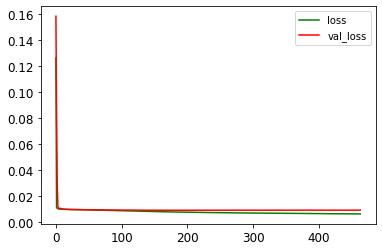

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 465/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0583

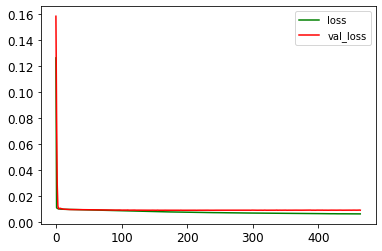

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0583 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 466/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

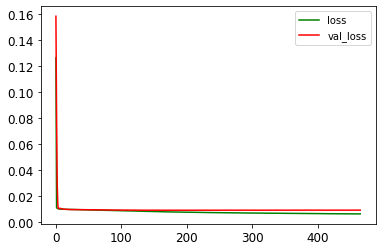

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 467/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

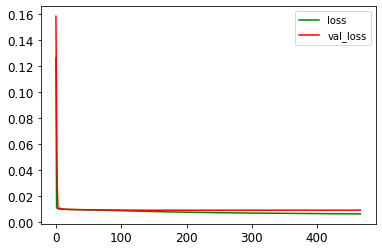

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0582 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 468/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

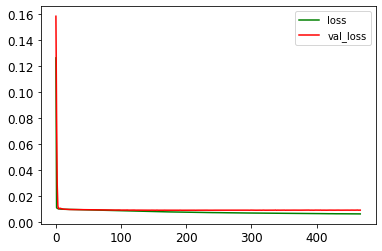

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 469/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

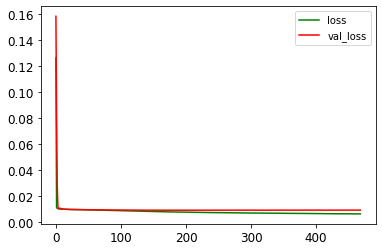

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 470/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

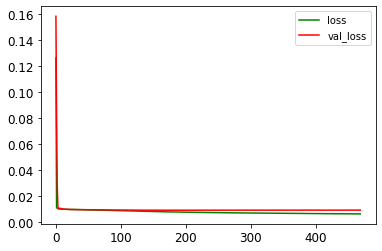

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 471/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

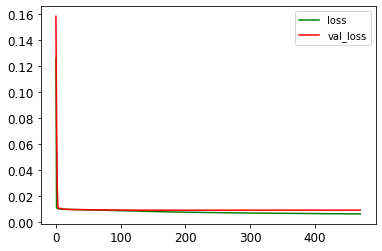

75/75 [==============================] - 0s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 472/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0580

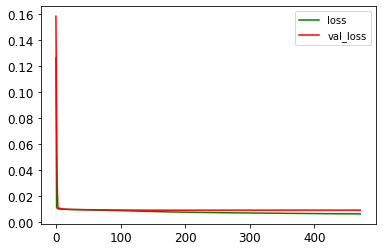

75/75 [==============================] - 1s 10ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 473/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

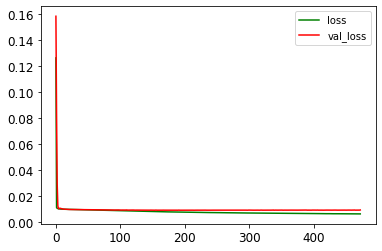

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 474/1500
75/75 [==============================] - ETA: 0s - loss: 0.0062 - mae: 0.0581

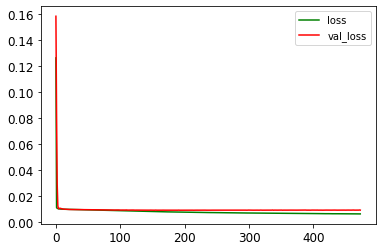

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 475/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0581

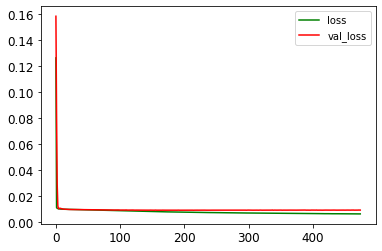

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0581 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 476/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

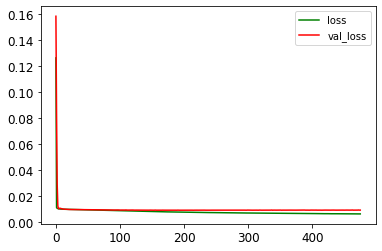

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 477/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0579

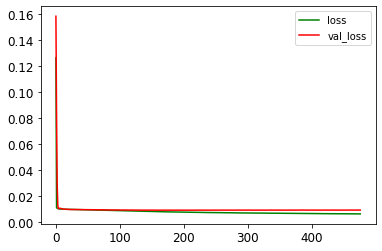

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 478/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

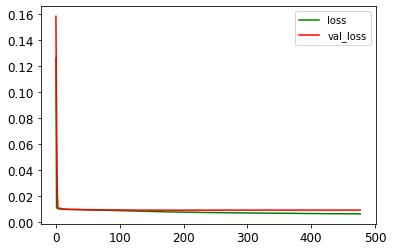

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 479/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

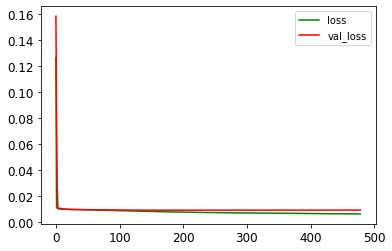

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 480/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0062 - mae: 0.0580

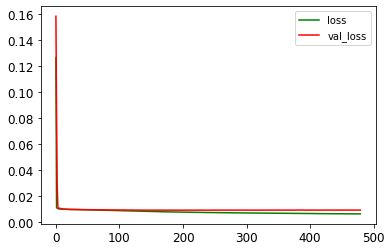

75/75 [==============================] - 1s 7ms/step - loss: 0.0062 - mae: 0.0580 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 481/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0061 - mae: 0.0579

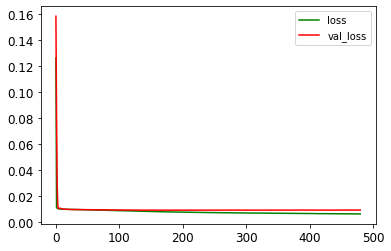

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 482/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

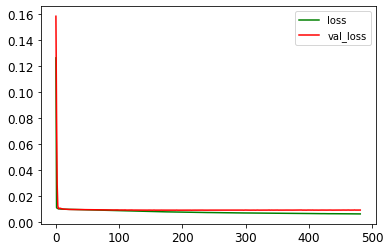

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 483/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

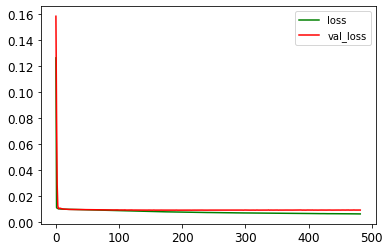

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 484/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0579

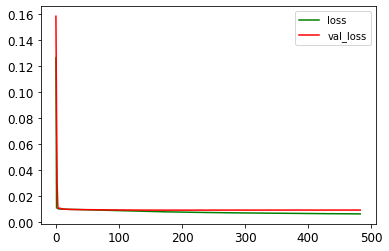

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 485/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0578

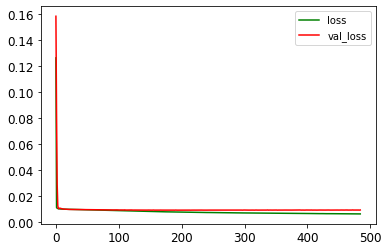

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 486/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0578

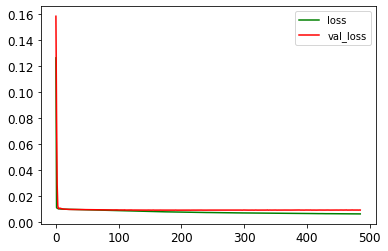

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 487/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0579

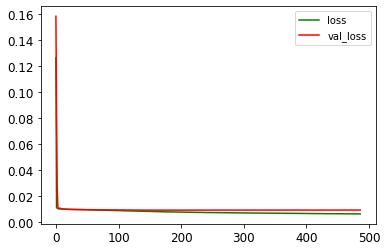

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 488/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0579

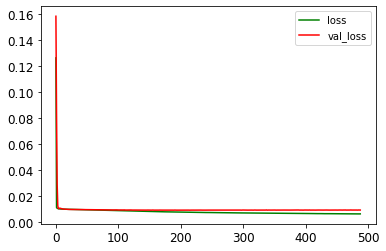

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 489/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0061 - mae: 0.0578

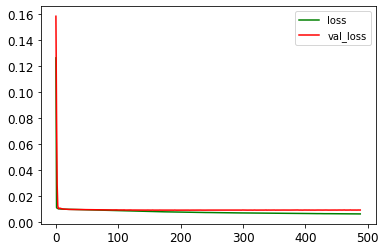

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 490/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

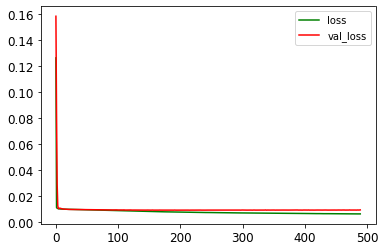

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0579 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 491/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

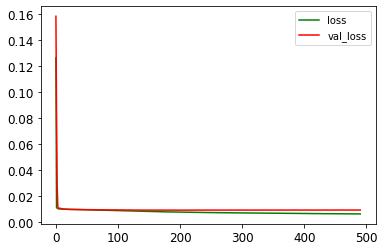

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 492/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0579

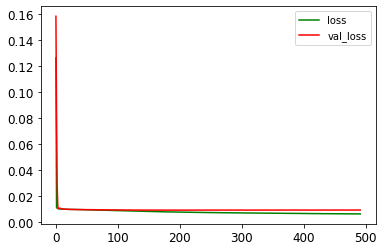

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 493/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

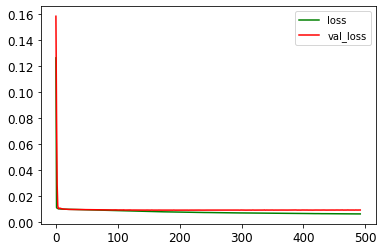

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 494/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

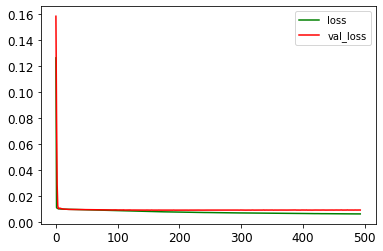

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0578 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 495/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0578

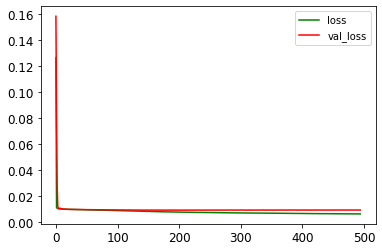

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 496/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0577

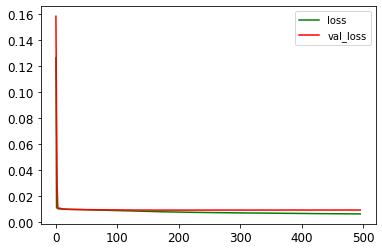

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 497/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0576

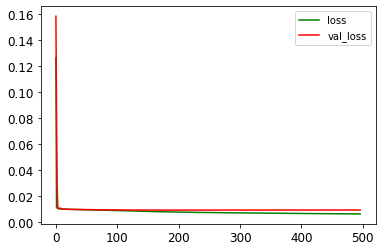

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0576 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 498/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0577

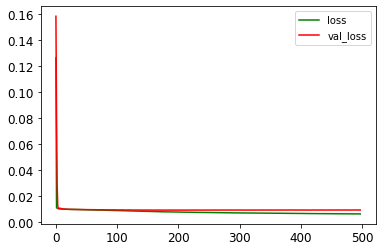

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 499/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0061 - mae: 0.0577

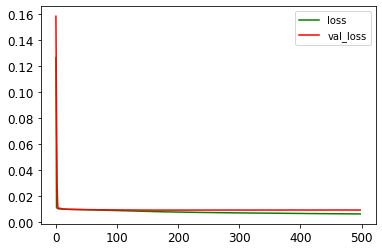

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 500/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0577

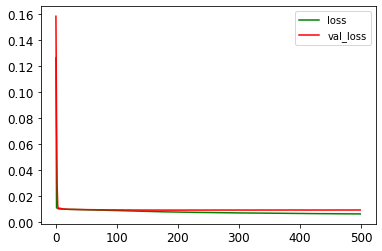

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 501/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0576

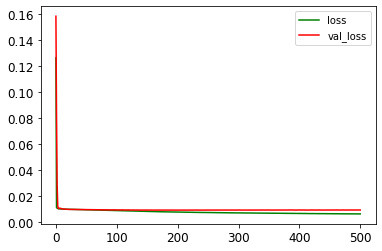

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 502/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0577

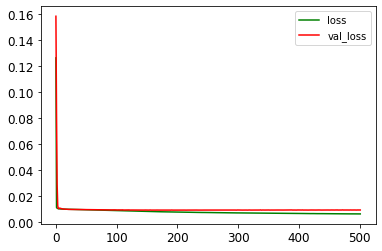

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 503/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0577

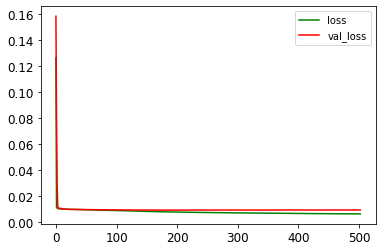

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0576 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 504/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0575

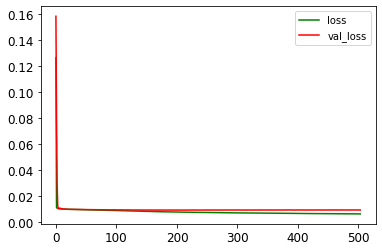

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 505/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0061 - mae: 0.0576

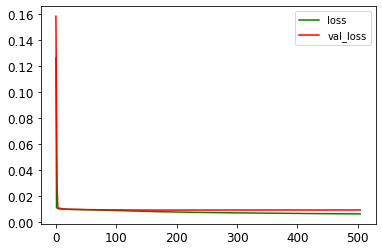

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 506/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0575

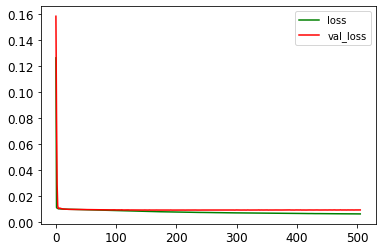

75/75 [==============================] - 1s 10ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 507/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0577

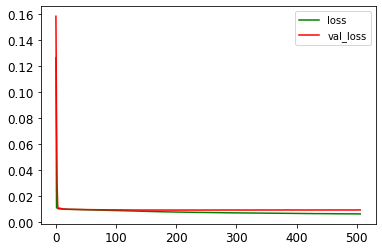

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0577 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 508/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0576

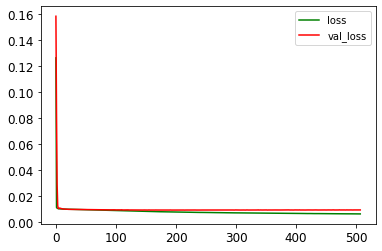

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 509/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0576

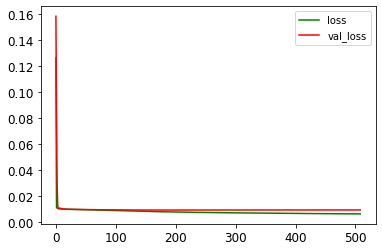

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0576 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 510/1500
75/75 [==============================] - ETA: 0s - loss: 0.0061 - mae: 0.0575

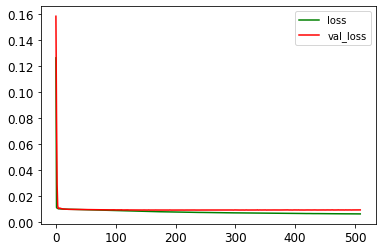

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 511/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0061 - mae: 0.0576

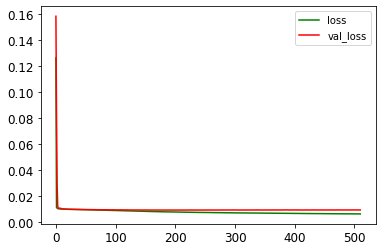

75/75 [==============================] - 1s 7ms/step - loss: 0.0061 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 512/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0574

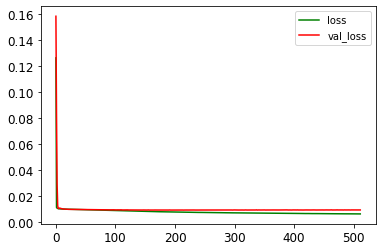

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 513/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0575

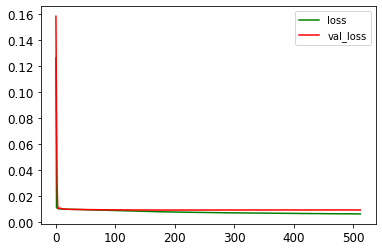

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 514/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

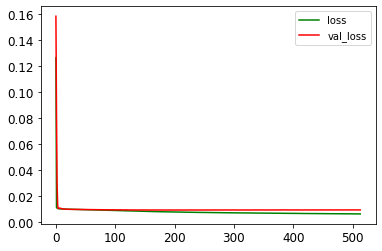

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 515/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0575

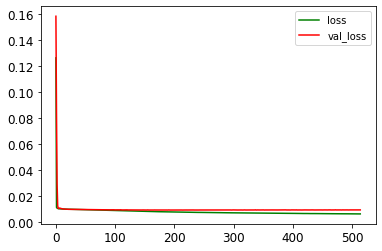

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0575 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 516/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0574

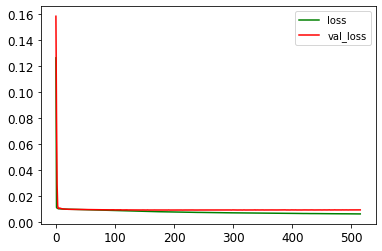

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 517/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0574

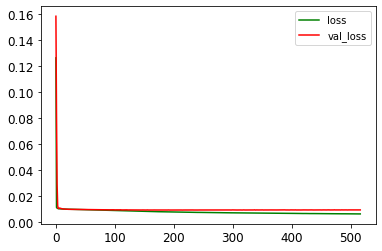

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 518/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0061 - mae: 0.0575

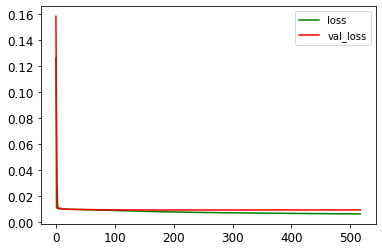

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 519/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0575

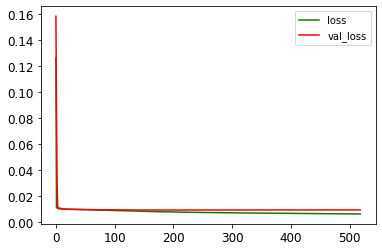

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 520/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0575

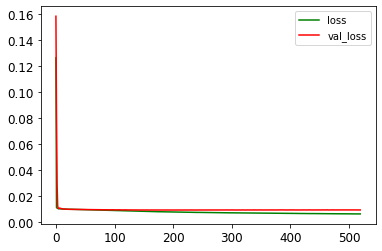

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 521/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

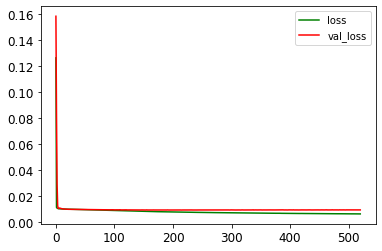

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 522/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0574

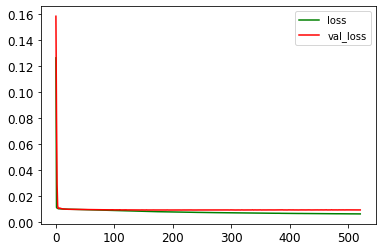

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 523/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0573

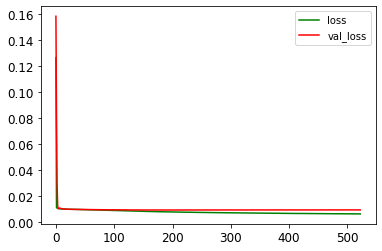

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 524/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0574

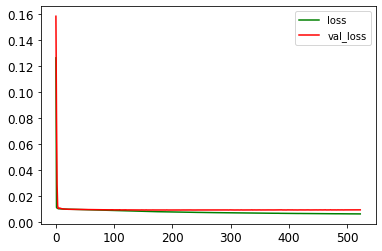

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 525/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

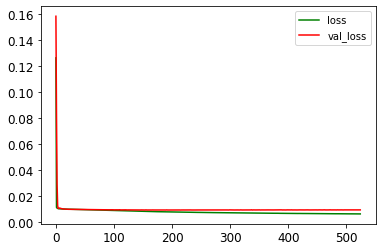

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 526/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0574

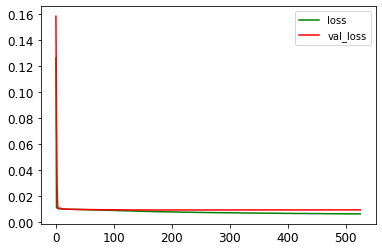

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0574 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 527/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

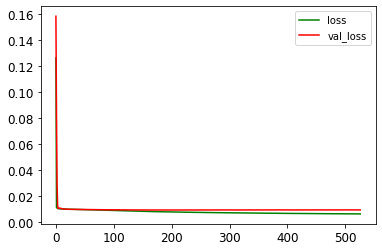

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 528/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

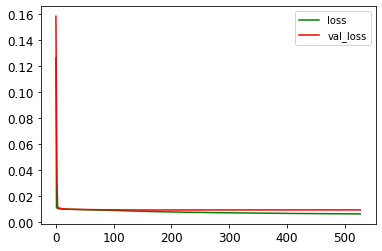

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 529/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0572

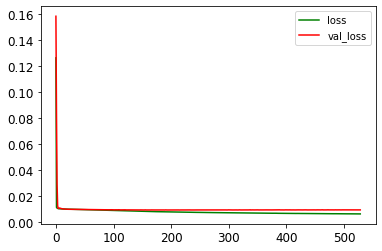

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 530/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

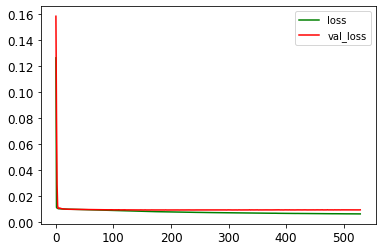

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 531/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0573

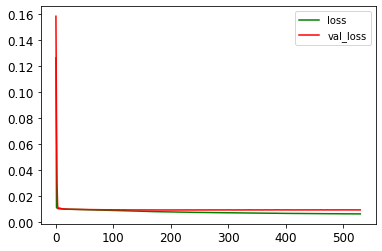

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 532/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

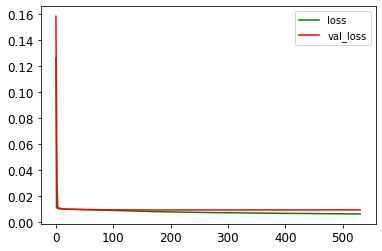

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 533/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0573

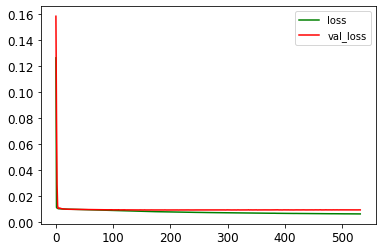

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 534/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

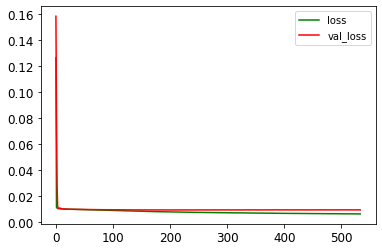

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 535/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0572

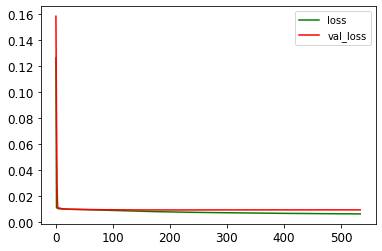

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 536/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

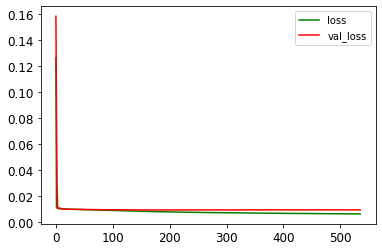

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 537/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0573

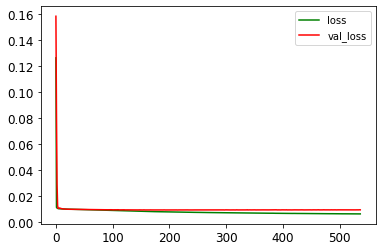

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 538/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

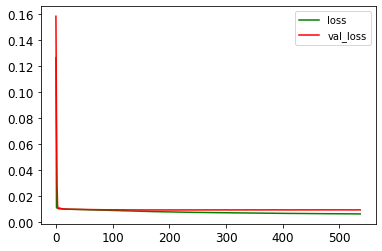

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 539/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0573

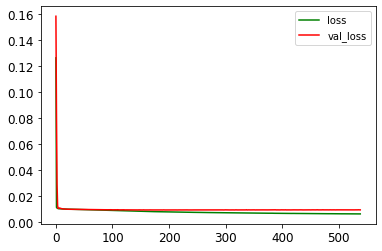

75/75 [==============================] - 1s 10ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 540/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0572

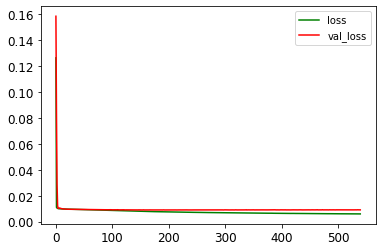

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 541/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

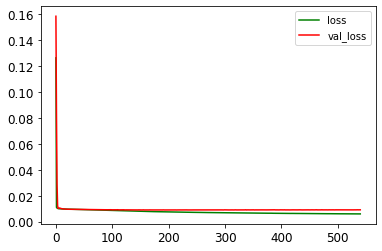

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0572 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 542/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0571

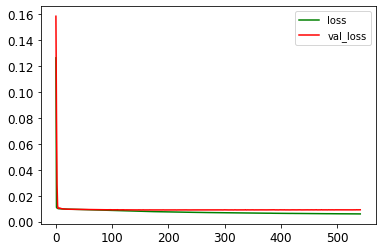

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 543/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0571

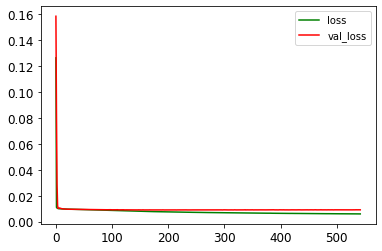

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 544/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0571

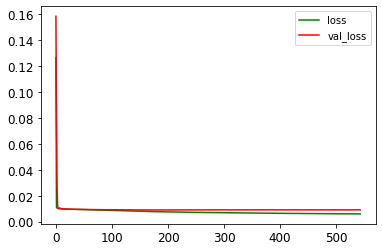

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 545/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0060 - mae: 0.0572

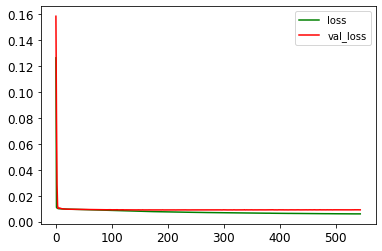

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0573 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 546/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0571

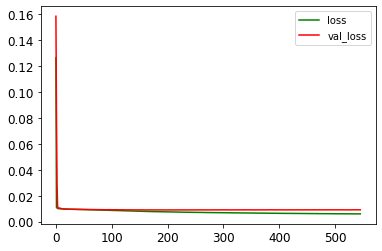

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 547/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0571

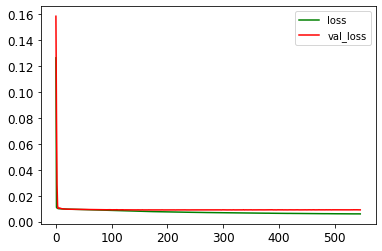

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 548/1500
75/75 [==============================] - ETA: 0s - loss: 0.0060 - mae: 0.0571

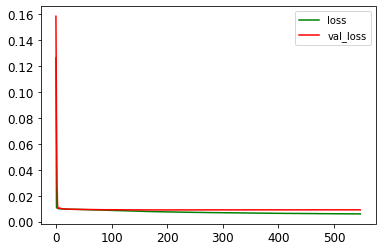

75/75 [==============================] - 1s 7ms/step - loss: 0.0060 - mae: 0.0571 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 549/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0570

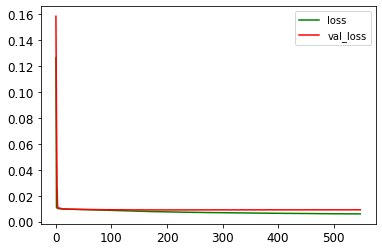

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 550/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0060 - mae: 0.0571

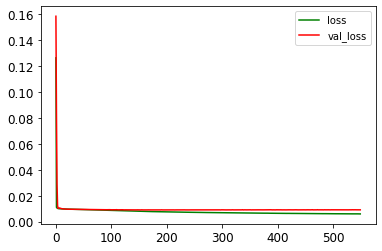

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 551/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0059 - mae: 0.0569

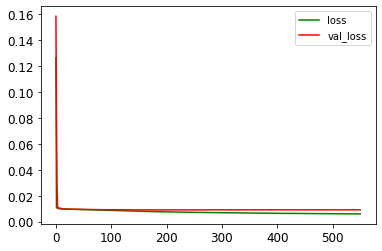

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 552/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0570

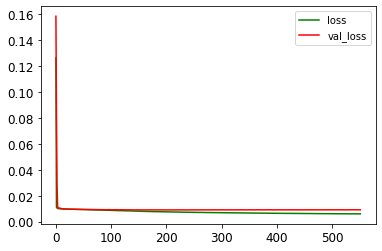

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 553/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0570

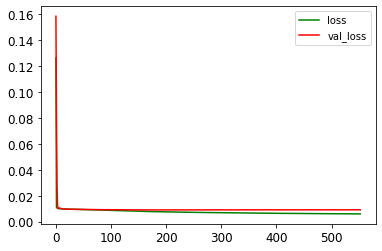

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 554/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0570

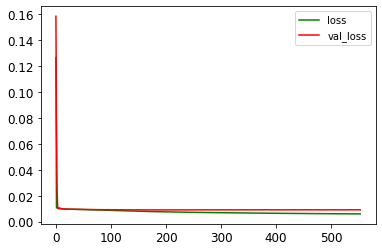

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 555/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0570

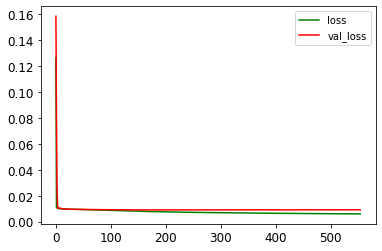

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 556/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0570

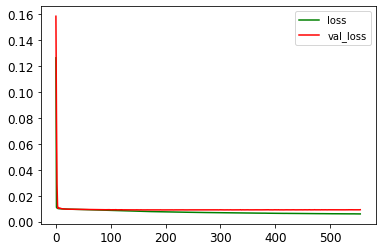

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 557/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0569

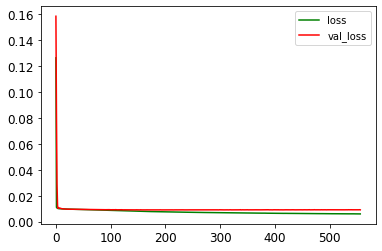

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 558/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0569

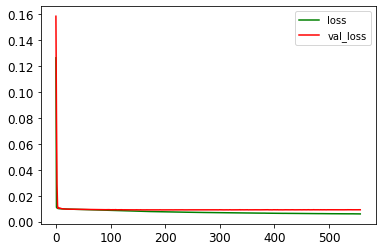

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 559/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0570

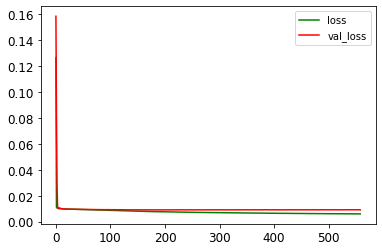

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 560/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0569

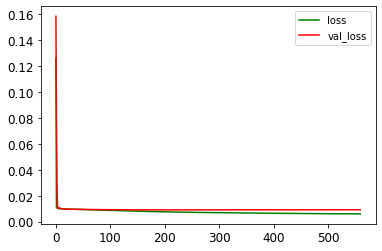

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 561/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0569

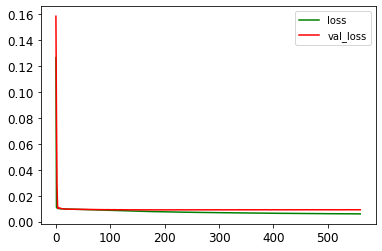

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 562/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0570

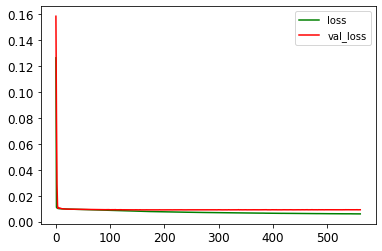

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 563/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0569

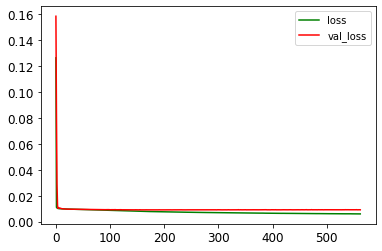

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 564/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0570

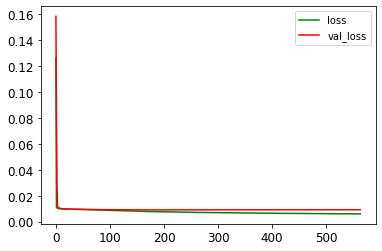

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0570 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 565/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

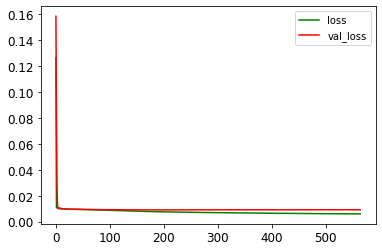

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 566/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0568

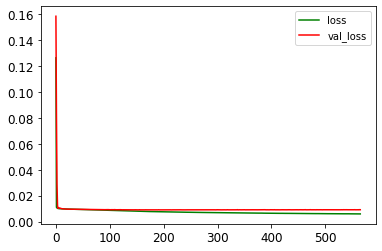

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 567/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

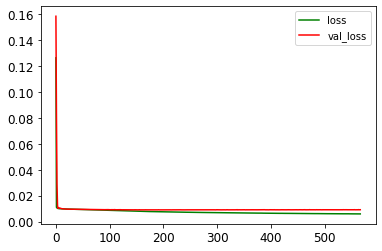

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0569 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 568/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

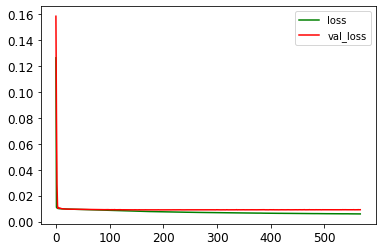

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 569/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0568

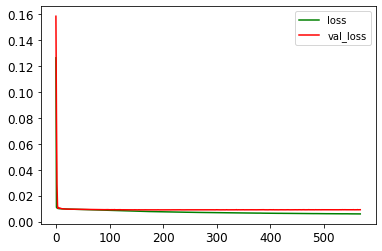

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 570/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0569

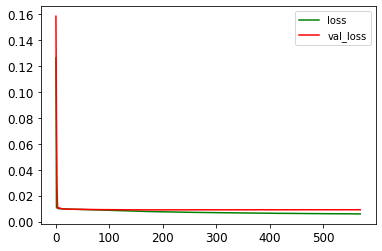

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 571/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

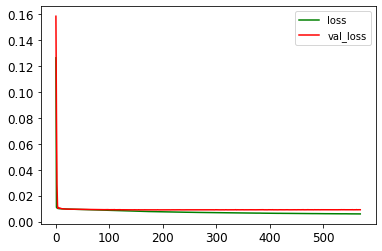

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 572/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0059 - mae: 0.0569

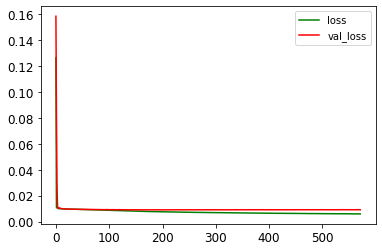

75/75 [==============================] - 1s 10ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 573/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0570

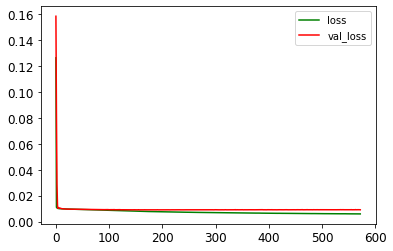

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 574/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0567

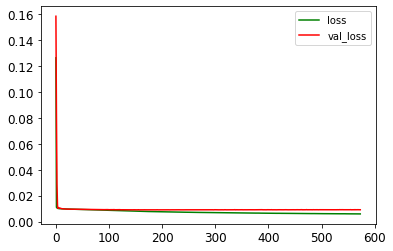

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 575/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0059 - mae: 0.0566

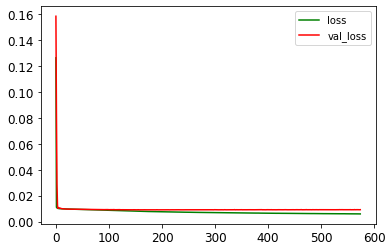

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 576/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0568

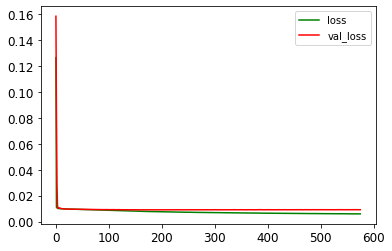

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 577/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0568

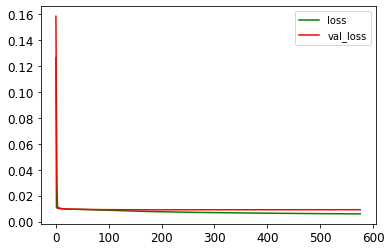

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 578/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

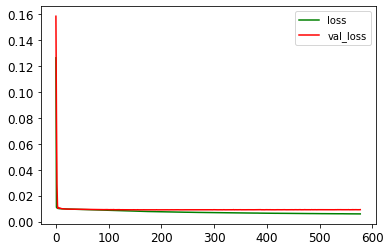

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 579/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0568

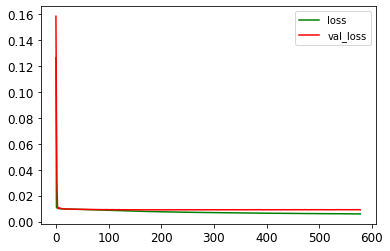

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 580/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0567

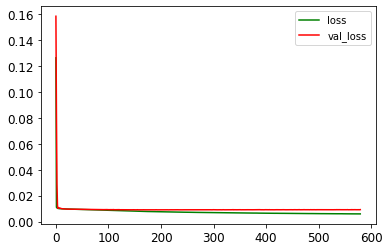

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0568 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 581/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0567

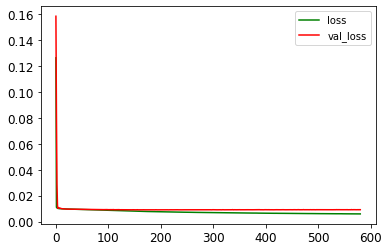

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 582/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0566

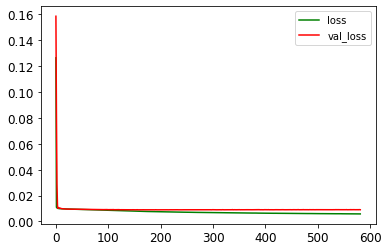

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 583/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0567

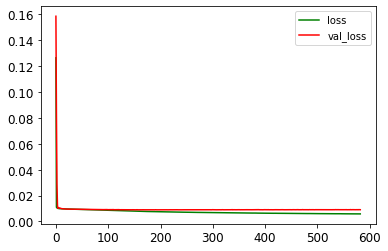

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 584/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0059 - mae: 0.0567

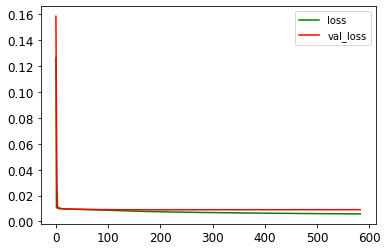

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 585/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0567

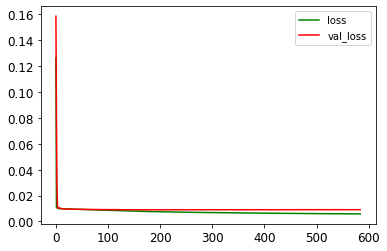

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0567 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 586/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

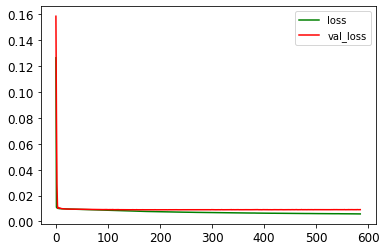

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 587/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0567

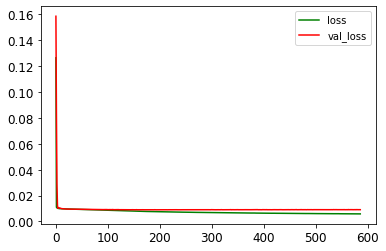

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 588/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0566

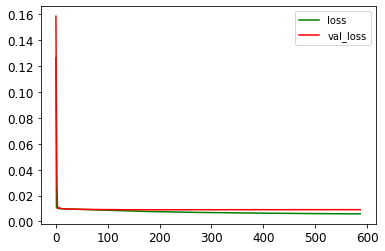

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 589/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0566

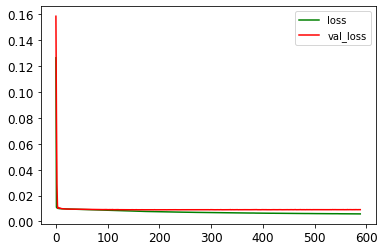

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 590/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

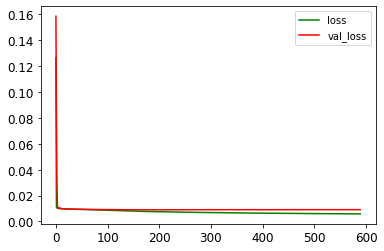

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 591/1500
75/75 [==============================] - ETA: 0s - loss: 0.0059 - mae: 0.0566

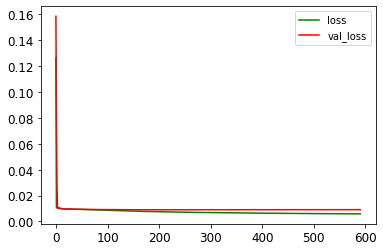

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 592/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

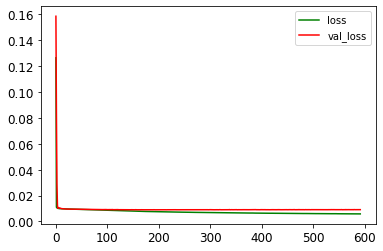

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 593/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0059 - mae: 0.0566

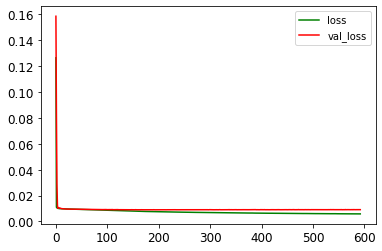

75/75 [==============================] - 1s 7ms/step - loss: 0.0059 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 594/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

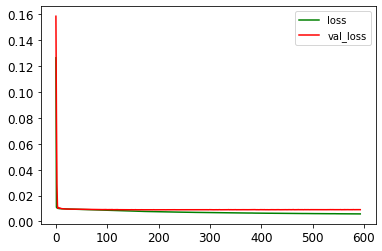

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 595/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0566

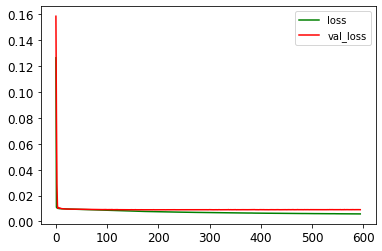

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 596/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0059 - mae: 0.0567

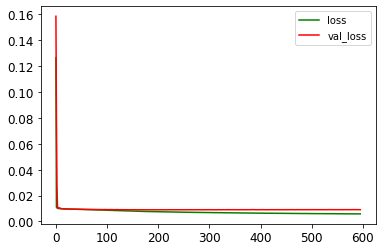

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 597/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

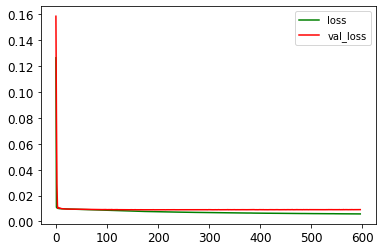

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 598/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

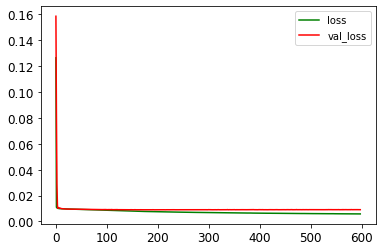

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 599/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0564

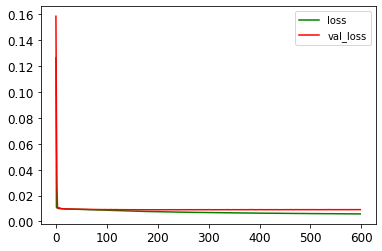

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 600/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0058 - mae: 0.0564

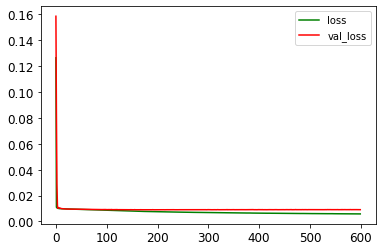

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 601/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

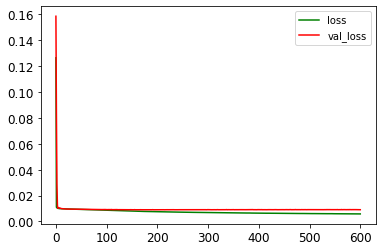

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 602/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0564

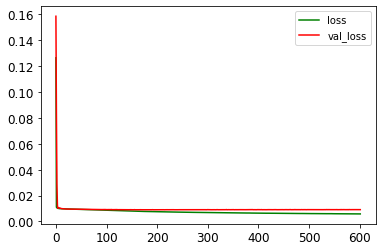

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 603/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0565

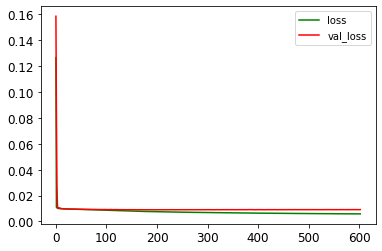

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 604/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0059 - mae: 0.0566

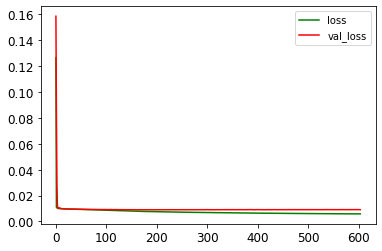

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0566 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 605/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0564

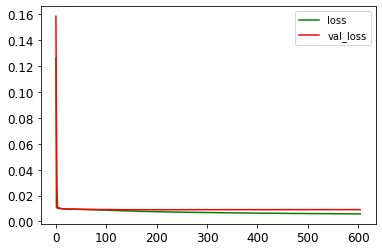

75/75 [==============================] - 1s 10ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 606/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

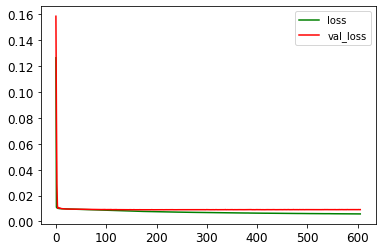

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 607/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

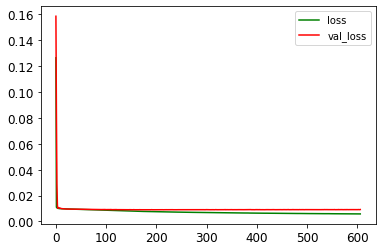

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 608/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0564

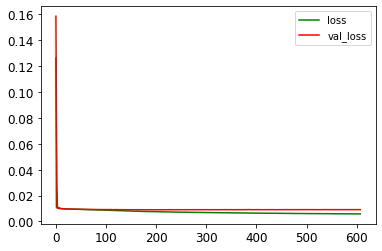

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0565 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 609/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0564

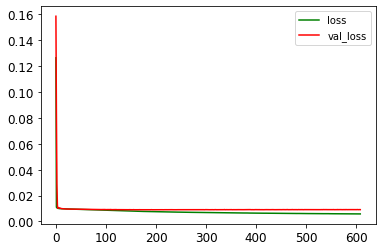

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 610/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

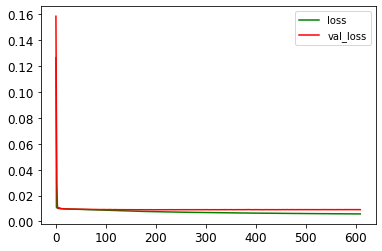

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 611/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0565

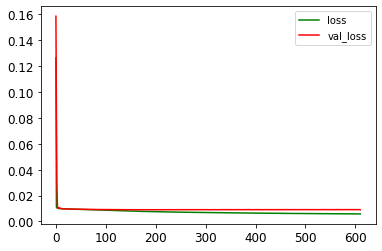

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 612/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0564

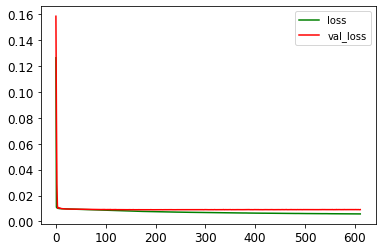

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 613/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0564

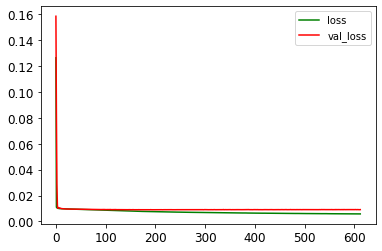

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 614/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0563

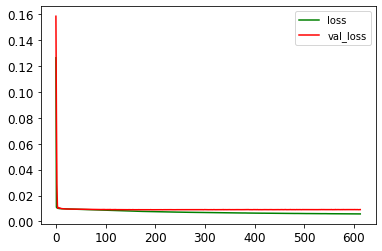

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 615/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0564

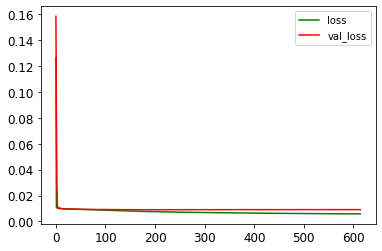

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0564 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 616/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0563

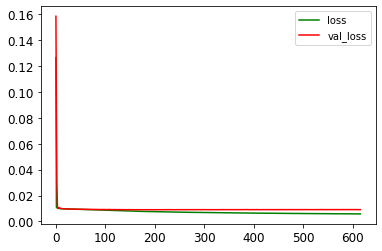

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 617/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0563

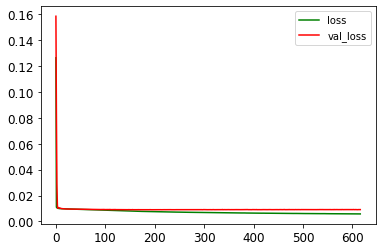

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 618/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

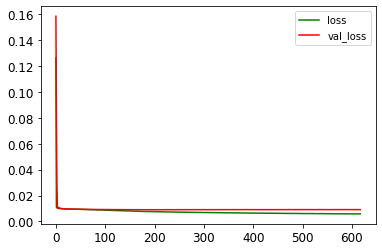

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 619/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0563

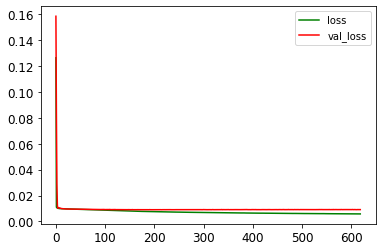

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 620/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

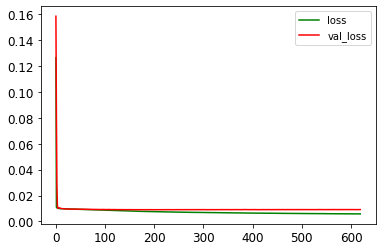

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 621/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0058 - mae: 0.0563

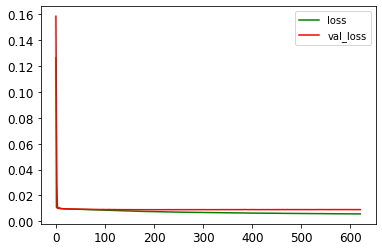

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 622/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

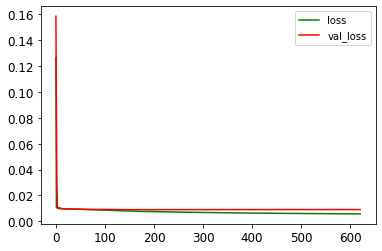

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 623/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0563

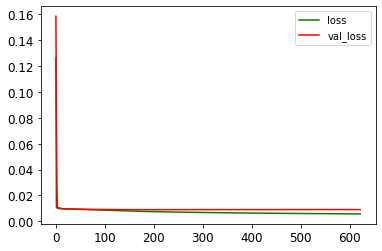

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 624/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0563

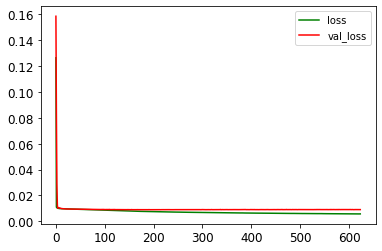

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 625/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0562

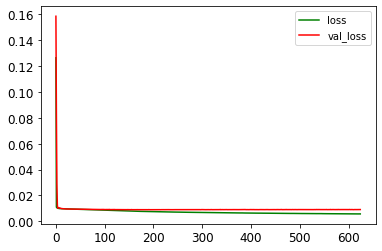

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 626/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0562

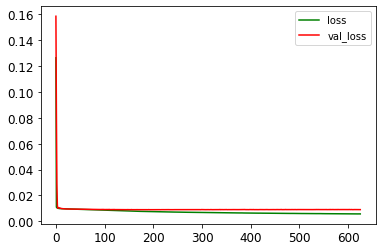

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 627/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0561

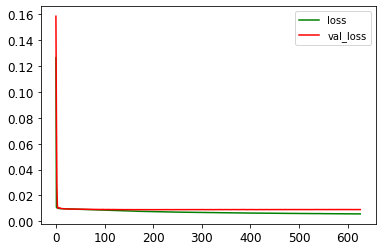

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 628/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0561

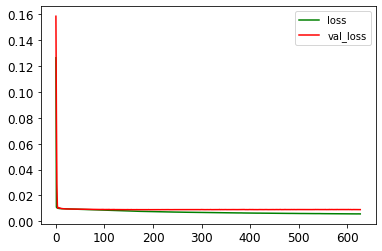

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 629/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0058 - mae: 0.0562

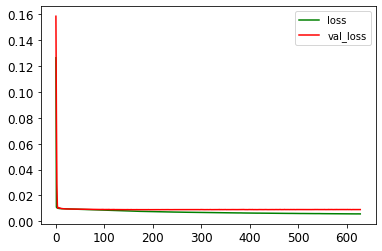

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 630/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0562

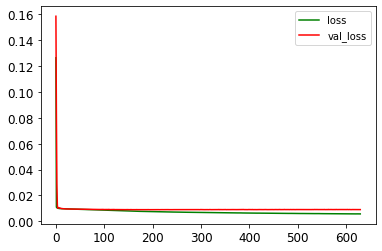

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 631/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0561

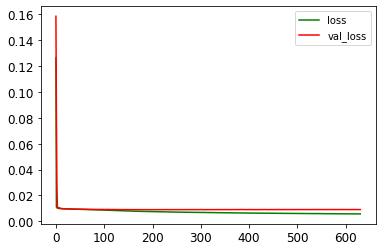

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 632/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

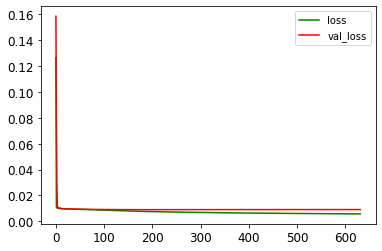

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 633/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0562

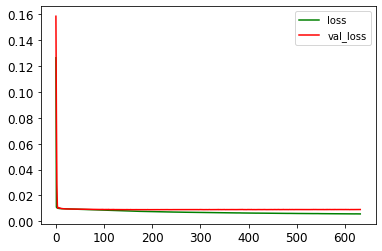

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 634/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0561

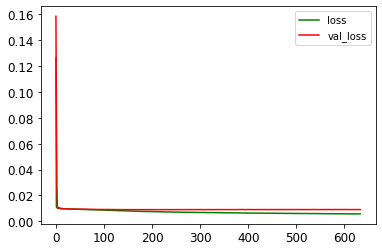

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 635/1500
75/75 [==============================] - ETA: 0s - loss: 0.0058 - mae: 0.0563

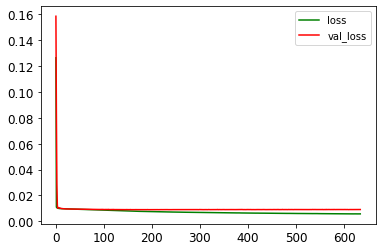

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0563 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 636/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0563

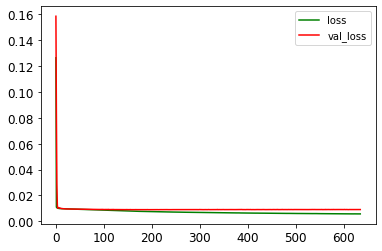

75/75 [==============================] - 1s 7ms/step - loss: 0.0058 - mae: 0.0562 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 637/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0562

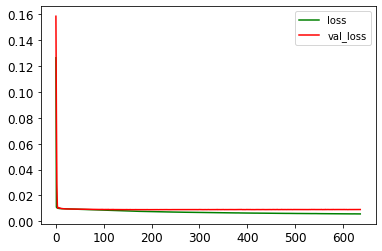

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 638/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0561

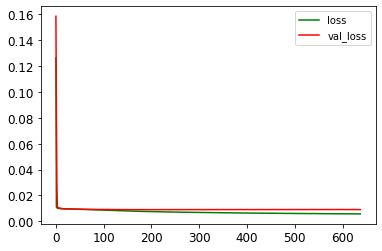

75/75 [==============================] - 1s 10ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 639/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0058 - mae: 0.0562

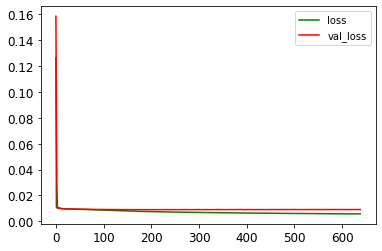

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 640/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0560

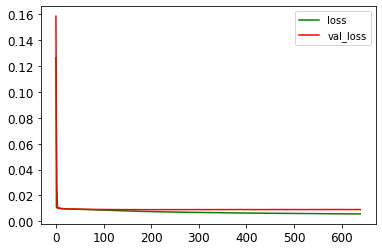

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 641/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0560

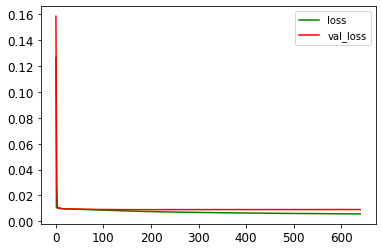

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 642/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0057 - mae: 0.0559

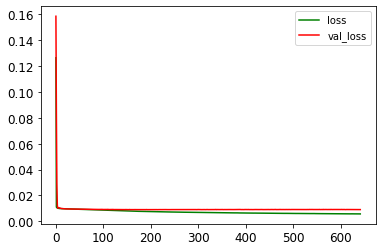

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 643/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0560

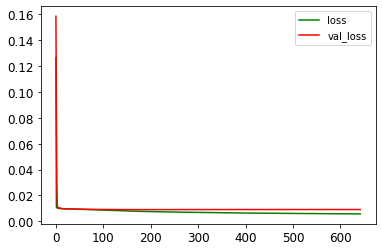

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 644/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

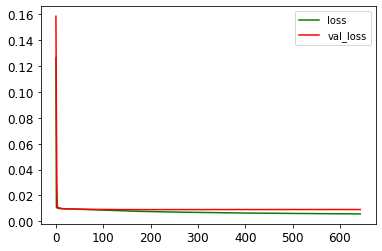

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 645/1500
62/75 [=======================>......] - ETA: 0s - loss: 0.0057 - mae: 0.0559

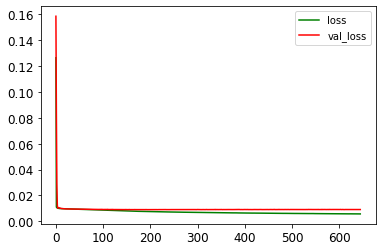

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 646/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0561

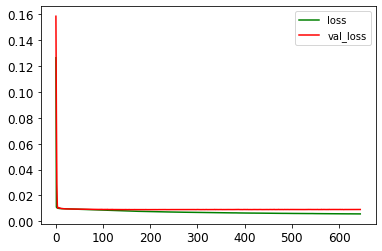

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 647/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0560

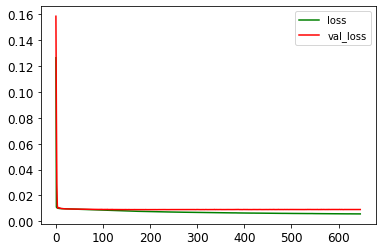

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 648/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0560

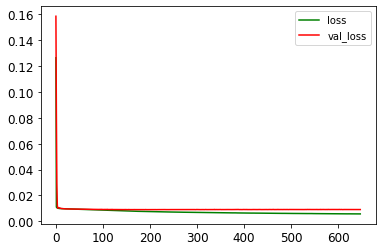

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0561 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 649/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0560

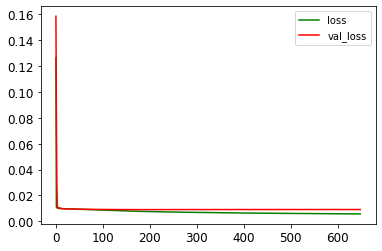

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 650/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

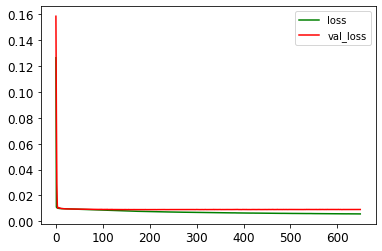

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 651/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0560

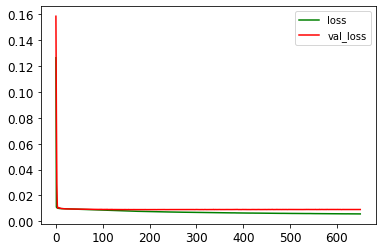

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 652/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0560

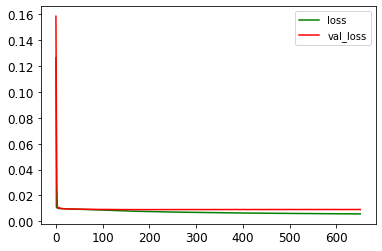

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 653/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

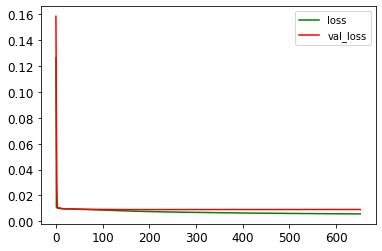

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 654/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0559

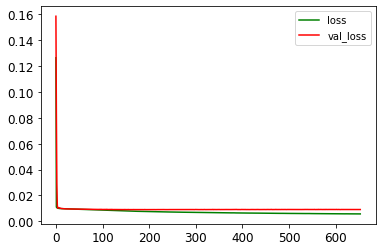

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 655/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

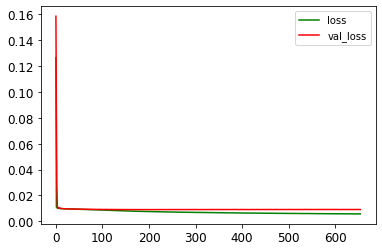

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 656/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0560

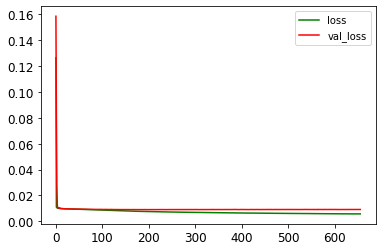

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 657/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

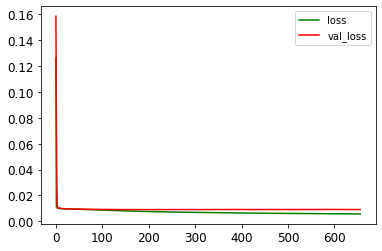

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 658/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

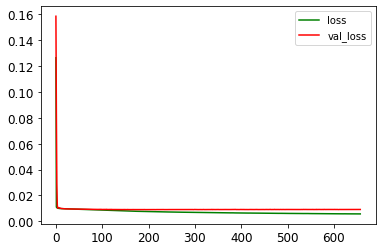

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0560 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 659/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

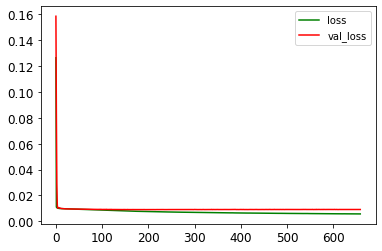

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 660/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0558

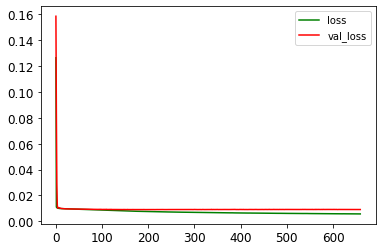

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 661/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

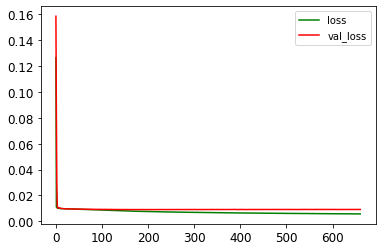

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 662/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

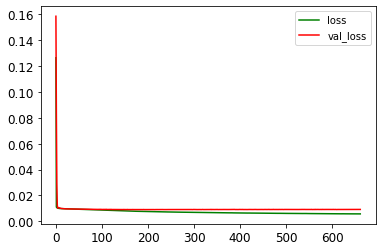

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 663/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

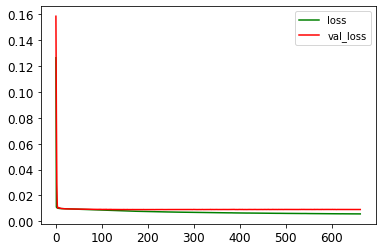

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 664/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0559

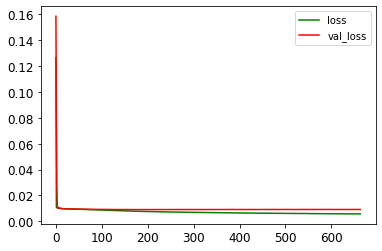

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 665/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0558

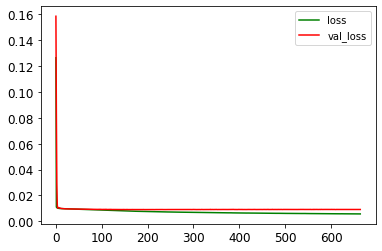

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 666/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

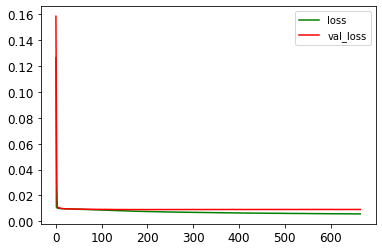

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 667/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

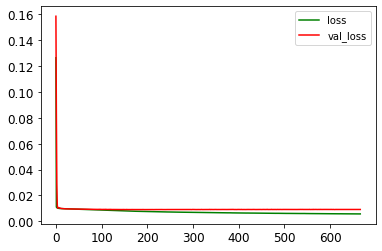

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 668/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0560

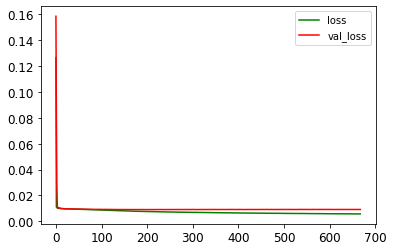

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 669/1500
75/75 [==============================] - ETA: 0s - loss: 0.0057 - mae: 0.0559

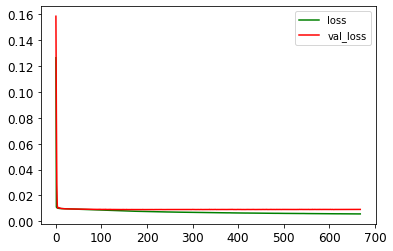

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 670/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

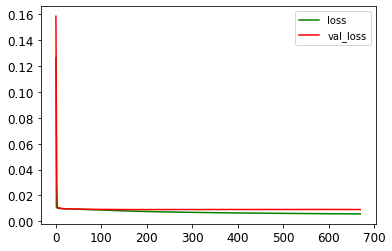

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 671/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0557

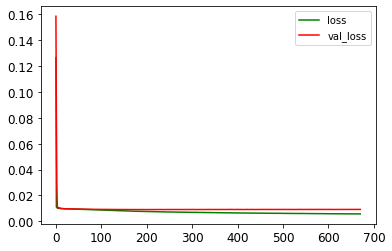

75/75 [==============================] - 1s 10ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 672/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0559

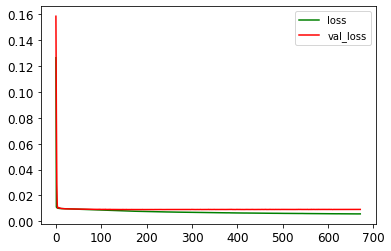

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0559 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 673/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0558

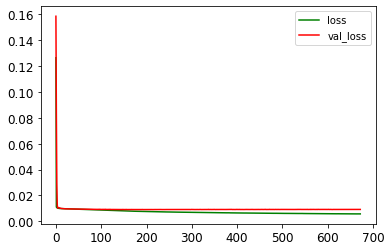

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 674/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

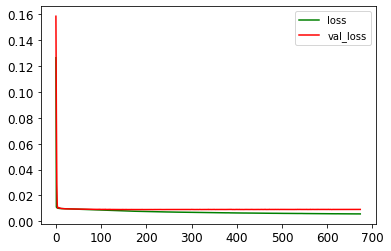

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 675/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0559

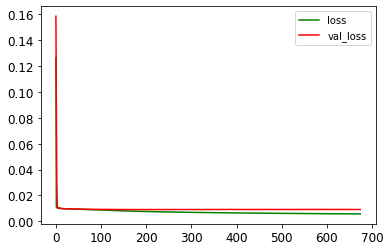

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 676/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

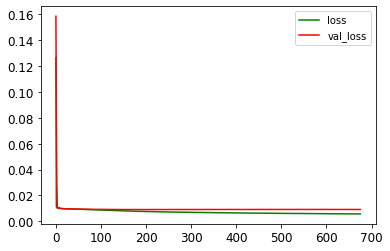

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 677/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0056 - mae: 0.0557

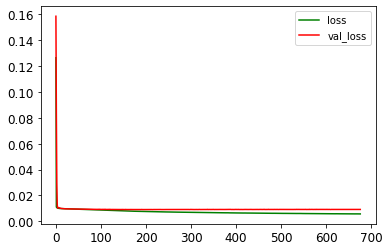

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 678/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0556

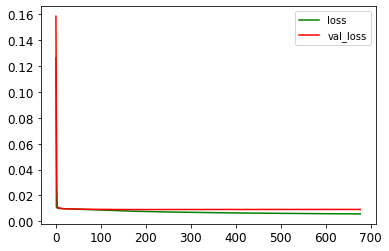

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 679/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

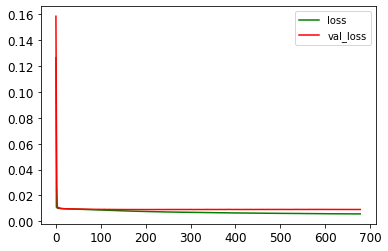

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 680/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0057 - mae: 0.0559

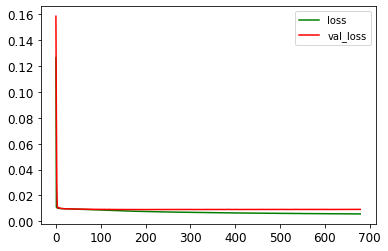

75/75 [==============================] - 1s 8ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 681/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

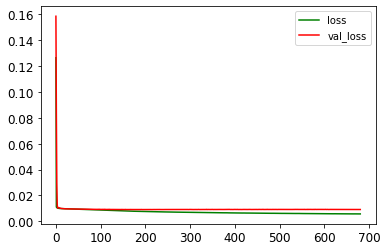

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 682/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0557

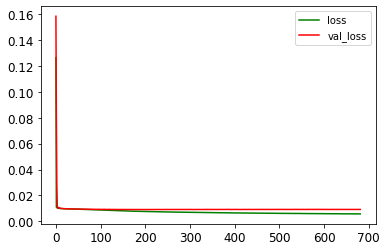

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 683/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

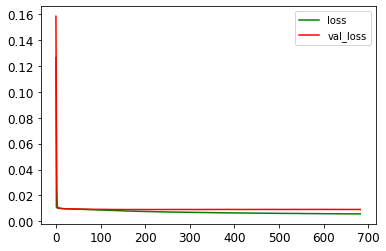

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0558 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 684/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0556

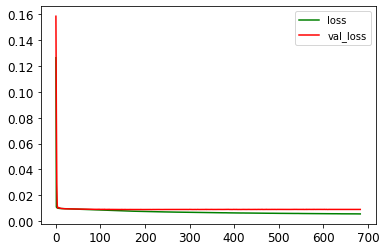

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 685/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0057 - mae: 0.0558

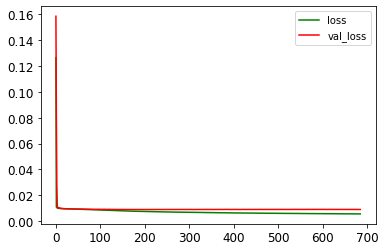

75/75 [==============================] - 1s 7ms/step - loss: 0.0057 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 686/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0557

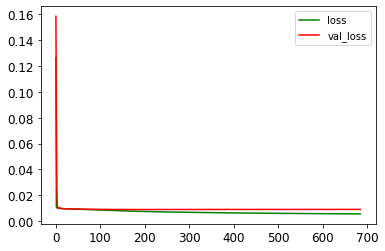

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 687/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

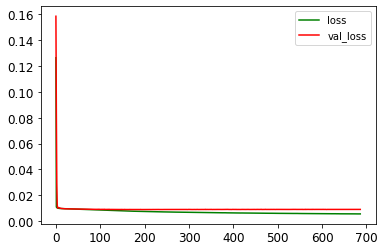

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 688/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0556

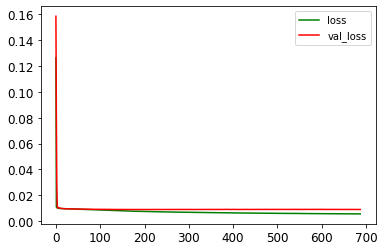

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 689/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

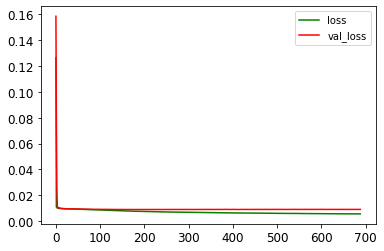

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 690/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0057 - mae: 0.0558

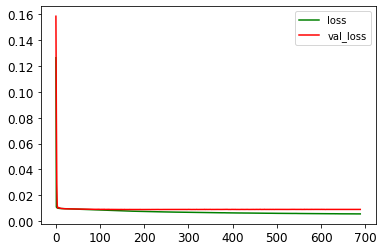

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 691/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0057 - mae: 0.0557

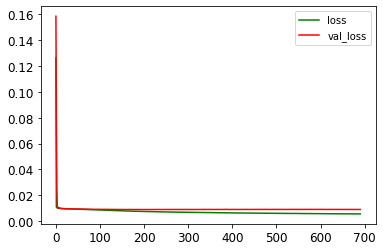

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 692/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

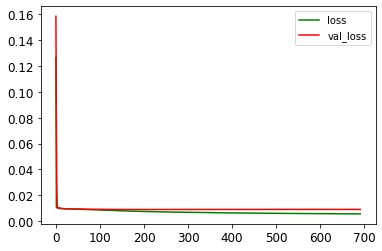

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0557 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 693/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0556

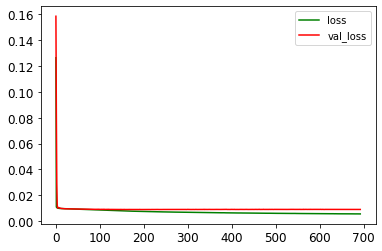

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 694/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0556

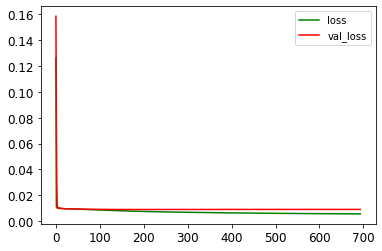

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 695/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

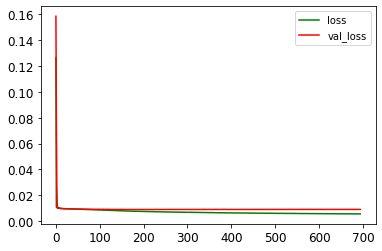

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 696/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

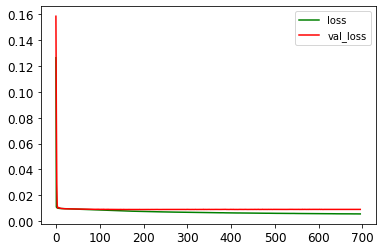

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 697/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0556

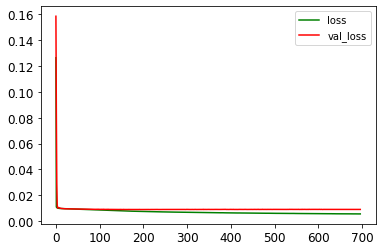

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 698/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

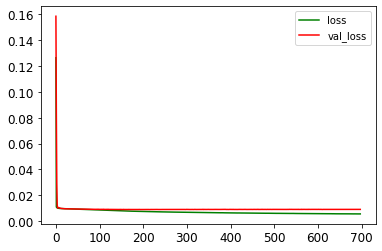

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 699/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

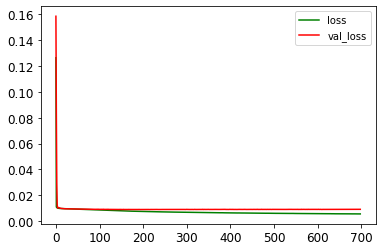

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 700/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0555

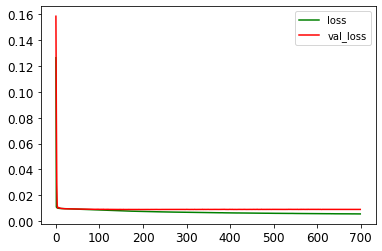

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 701/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0555

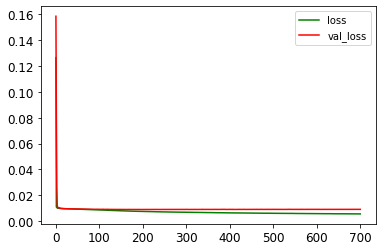

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 702/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

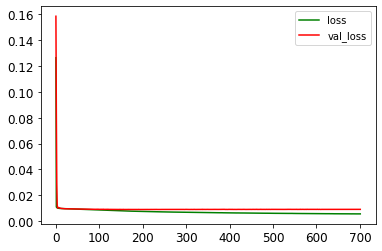

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 703/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0556

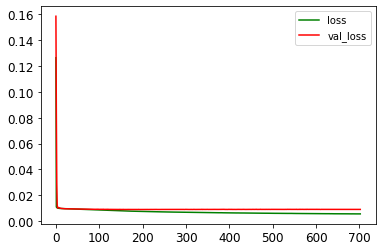

75/75 [==============================] - 1s 10ms/step - loss: 0.0056 - mae: 0.0556 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 704/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

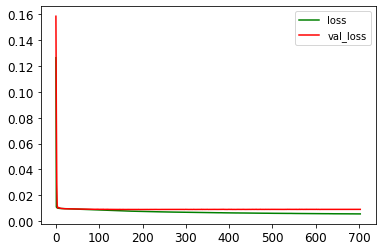

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 705/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

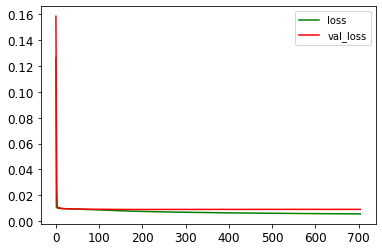

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 706/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

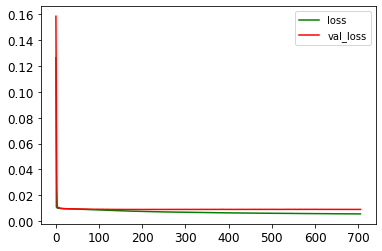

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 707/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0556

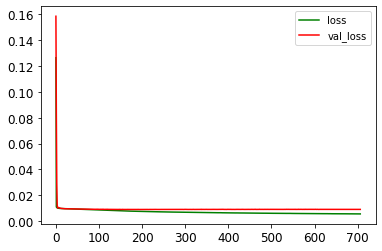

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 708/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0554

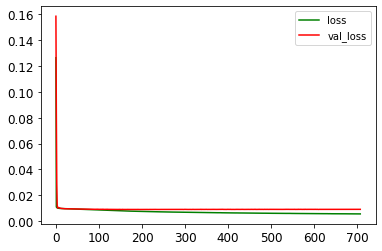

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 709/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0555

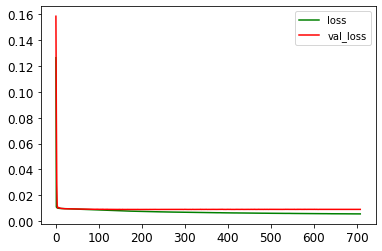

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 710/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0555

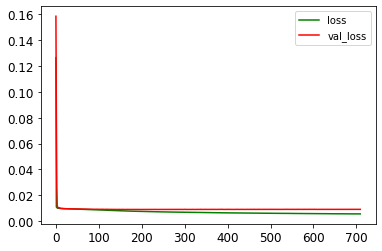

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 711/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0556

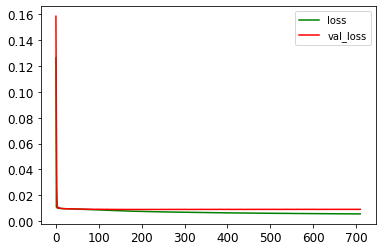

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 712/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0554

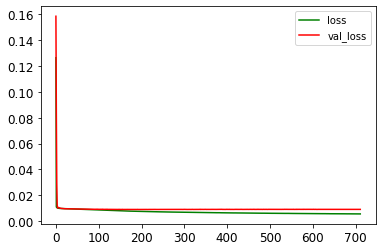

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 713/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

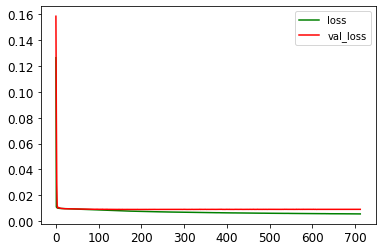

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 714/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

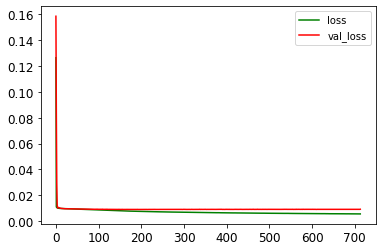

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 715/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0557

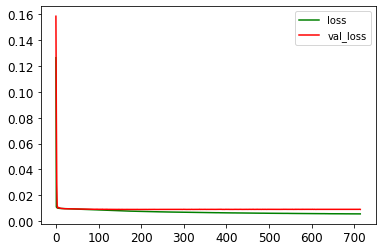

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 716/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

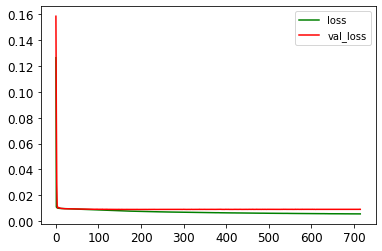

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 717/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

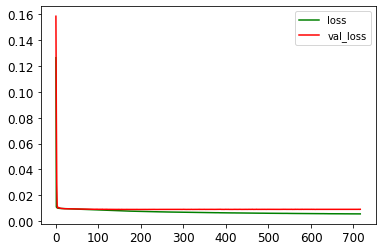

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 718/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0555

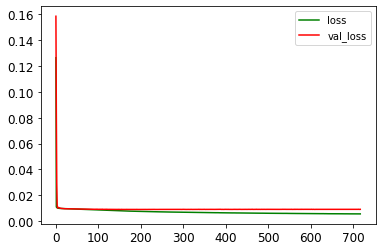

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0555 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 719/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

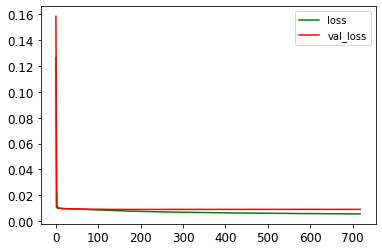

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 720/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0554

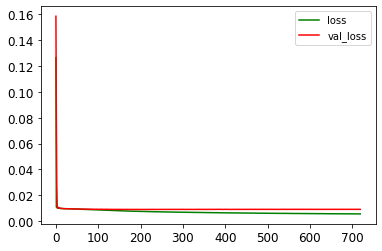

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 721/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

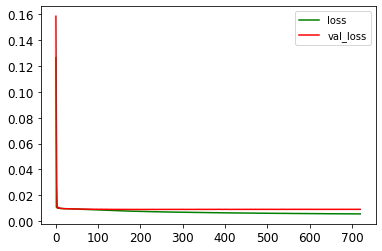

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 722/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

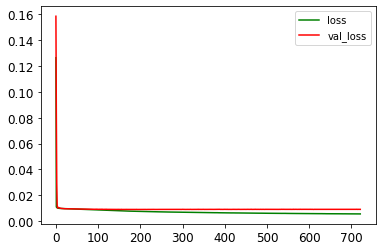

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 723/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0553

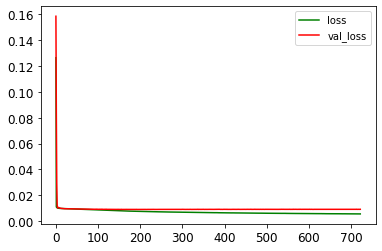

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 724/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

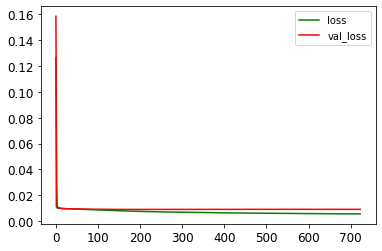

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 725/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

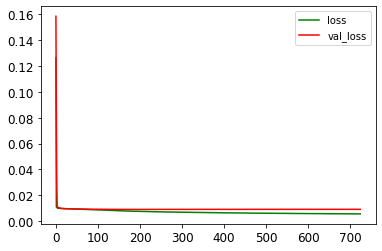

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 726/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0553

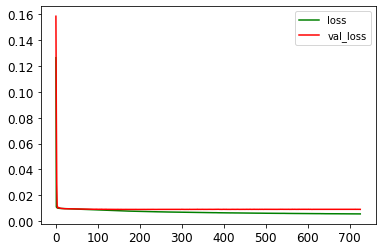

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 727/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

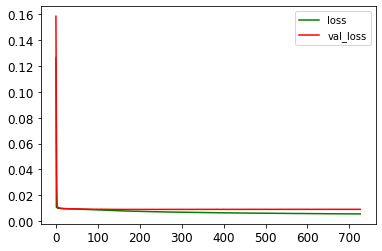

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 728/1500
75/75 [==============================] - ETA: 0s - loss: 0.0056 - mae: 0.0554

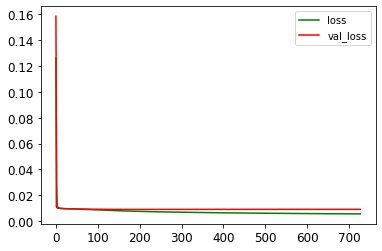

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 729/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0554

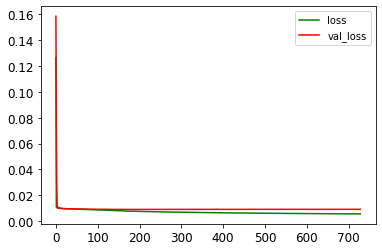

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 730/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

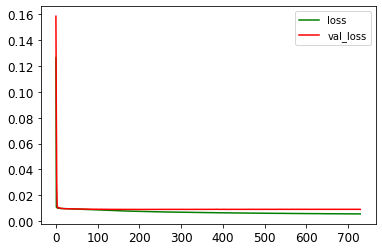

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 731/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

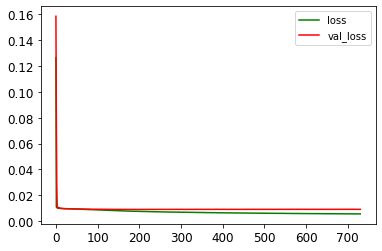

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 732/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0555

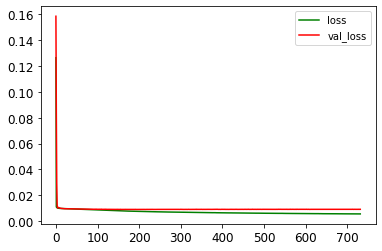

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 733/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

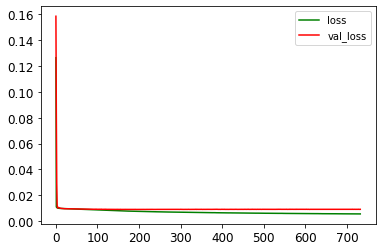

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 734/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

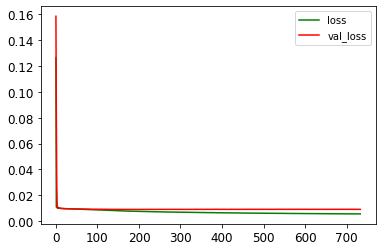

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 735/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

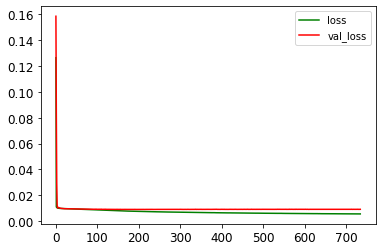

75/75 [==============================] - 1s 10ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 736/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0552

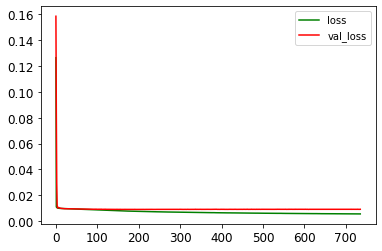

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 737/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0056 - mae: 0.0553

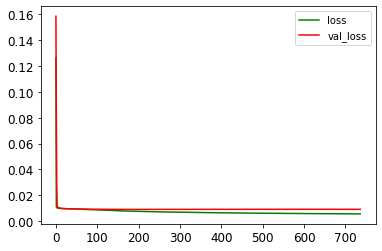

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 738/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0552

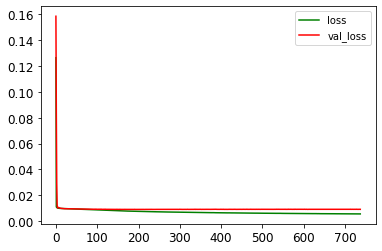

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 739/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0056 - mae: 0.0553

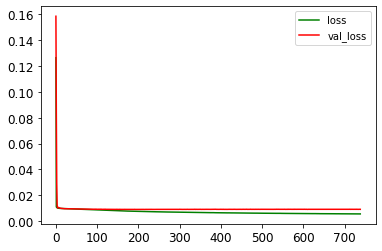

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 740/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0552

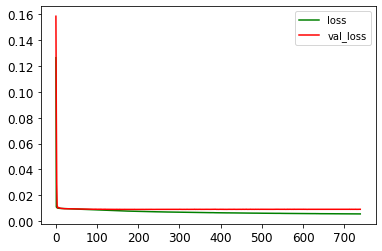

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 741/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0553

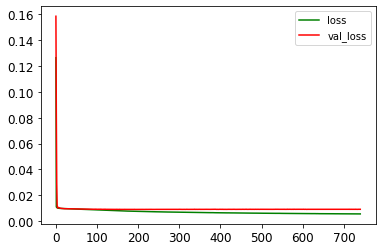

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 742/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0056 - mae: 0.0553

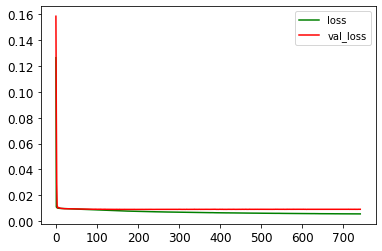

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 743/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0056 - mae: 0.0554

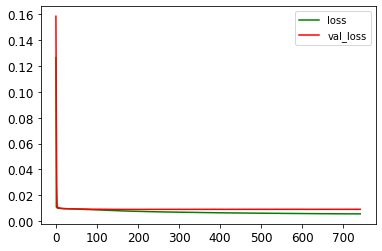

75/75 [==============================] - 1s 7ms/step - loss: 0.0056 - mae: 0.0554 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 744/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0055 - mae: 0.0552

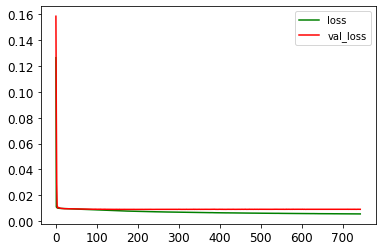

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 745/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0552

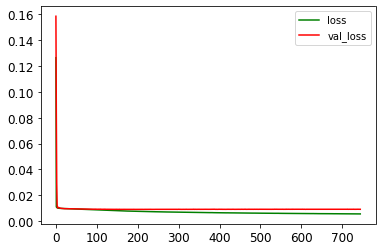

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 746/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0552

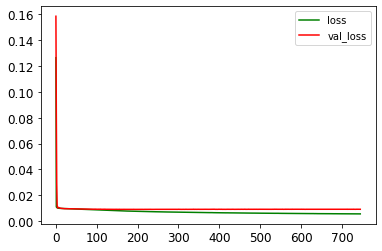

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 747/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

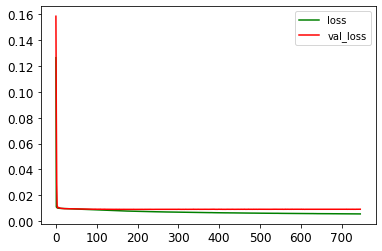

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 748/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

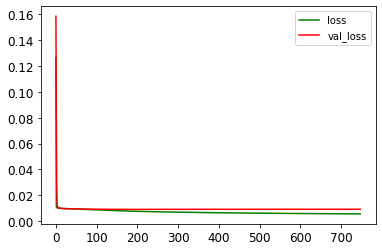

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 749/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

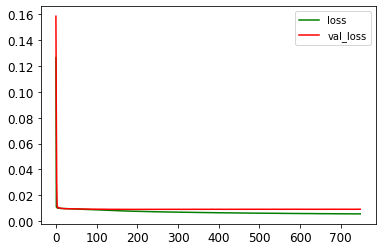

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 750/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

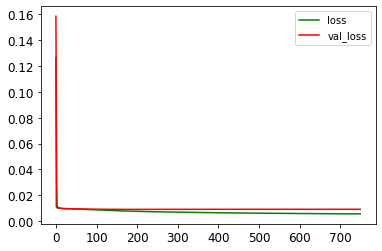

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 751/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

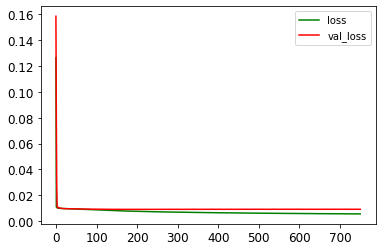

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 752/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

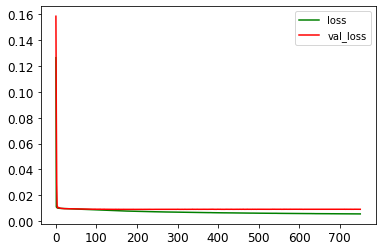

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 753/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0551

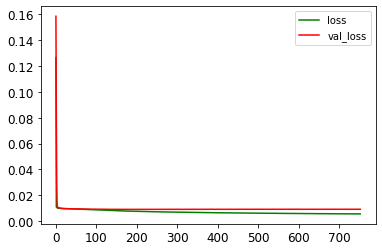

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 754/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0552

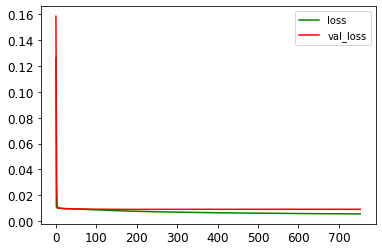

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0552 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 755/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

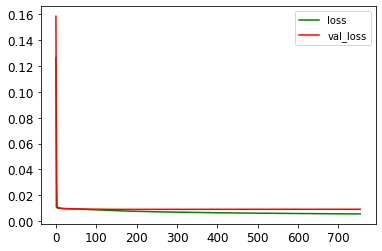

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 756/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0055 - mae: 0.0551

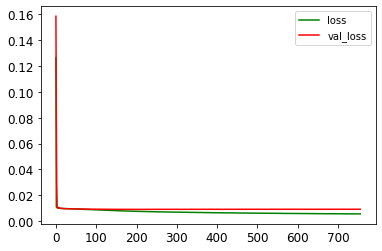

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 757/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0553

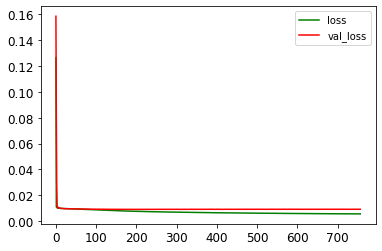

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0553 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 758/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

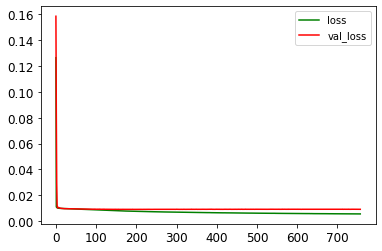

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 759/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0055 - mae: 0.0551

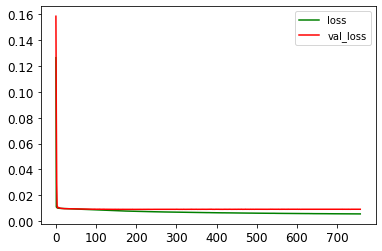

75/75 [==============================] - 1s 8ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 760/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0055 - mae: 0.0551

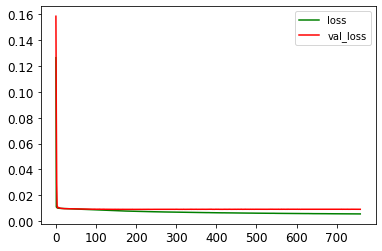

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 761/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

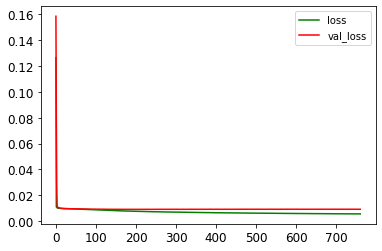

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 762/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

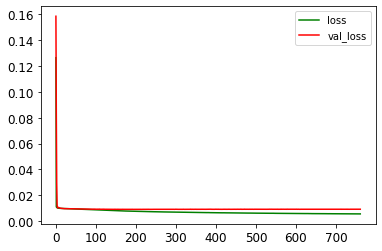

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 763/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

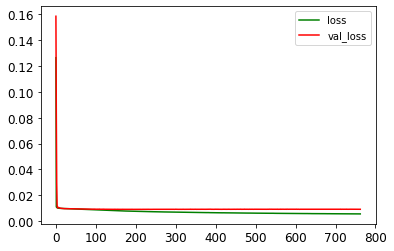

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 764/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0551

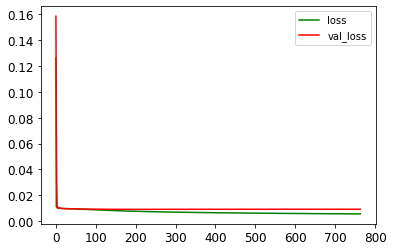

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 765/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0550

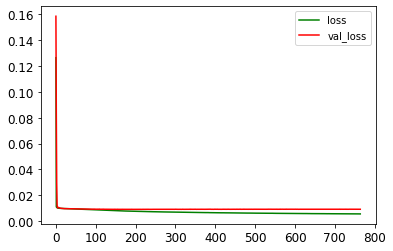

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 766/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

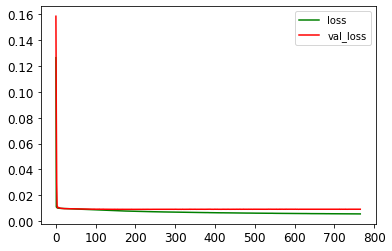

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 767/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

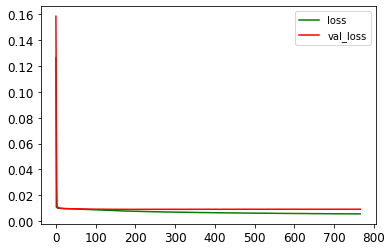

75/75 [==============================] - 1s 10ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 768/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0550

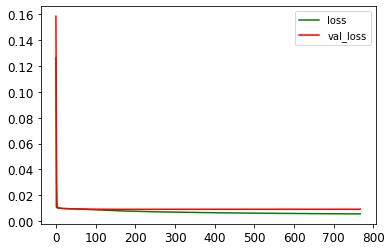

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 769/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

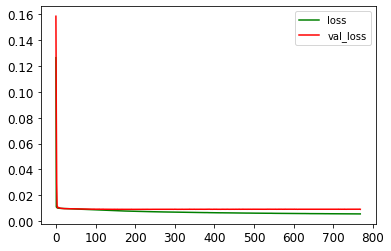

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 770/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

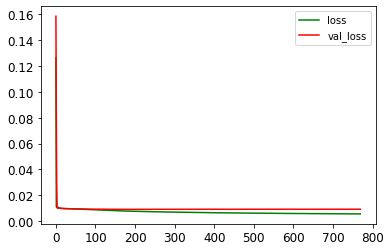

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 771/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

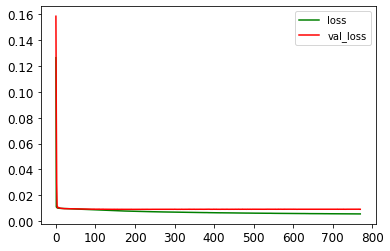

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 772/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

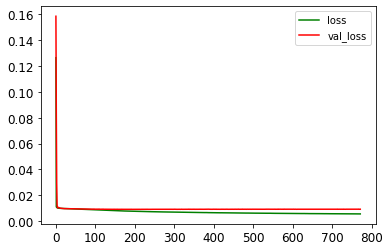

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 773/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

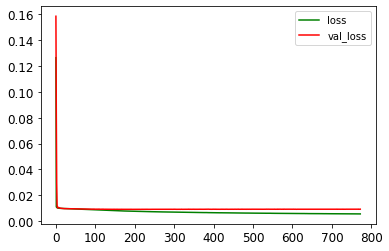

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0699
Epoch 774/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

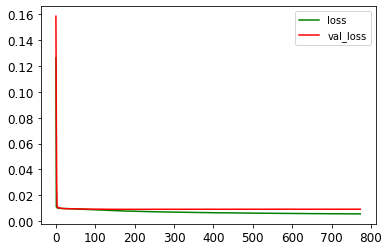

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 775/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

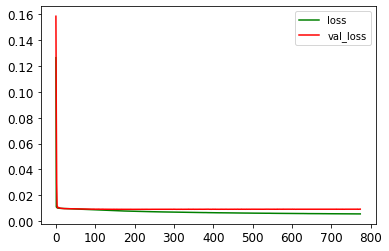

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 776/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

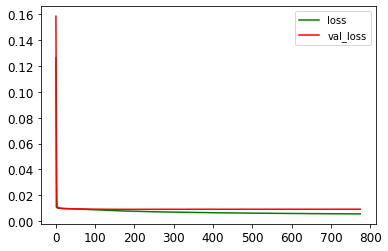

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0551 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 777/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

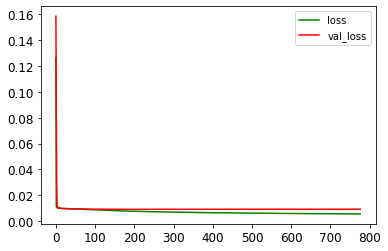

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 778/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0550

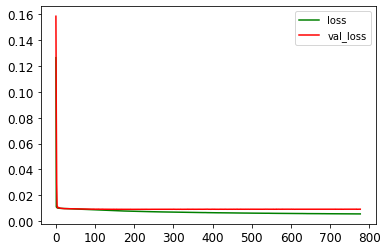

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 779/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

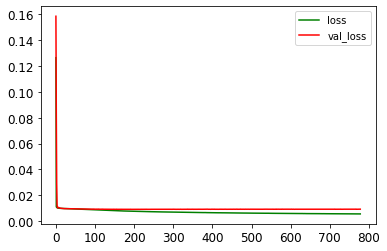

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 780/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0055 - mae: 0.0550

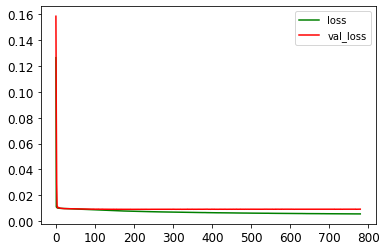

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 781/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0055 - mae: 0.0549

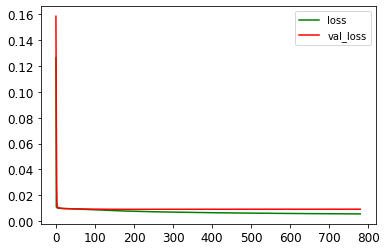

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 782/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

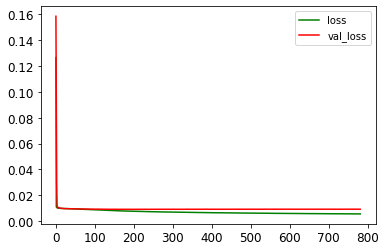

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 783/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

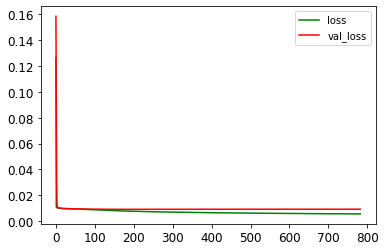

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 784/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0551

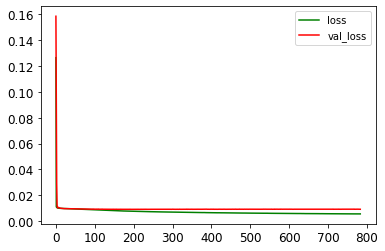

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 785/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0055 - mae: 0.0548

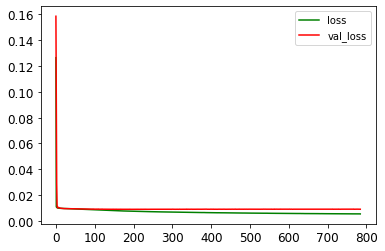

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 786/1500
75/75 [==============================] - ETA: 0s - loss: 0.0055 - mae: 0.0549

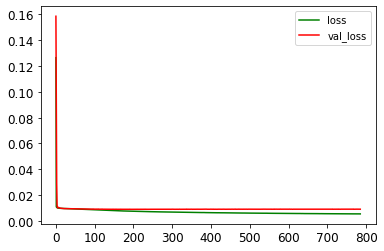

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 787/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

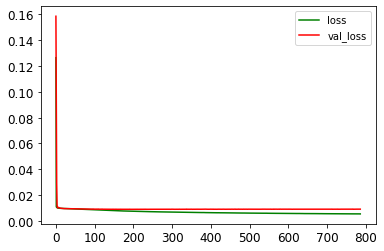

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 788/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

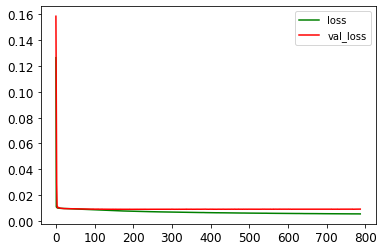

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 789/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

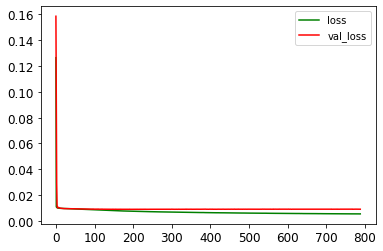

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0550 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 790/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0055 - mae: 0.0548

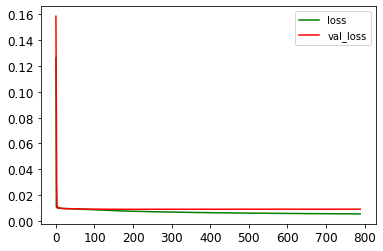

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 791/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

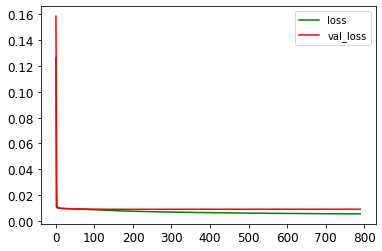

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 792/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

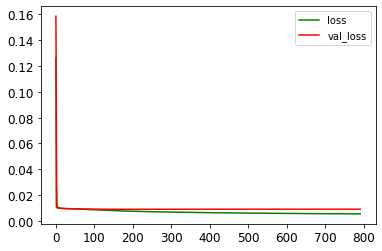

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 793/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0548

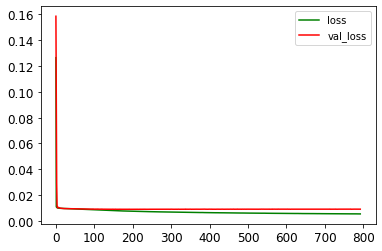

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 794/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

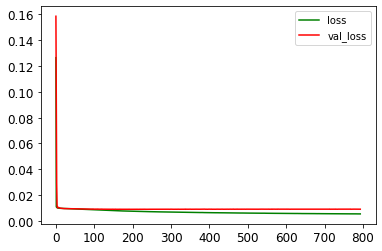

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 795/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0548

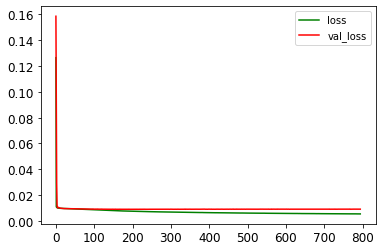

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 796/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

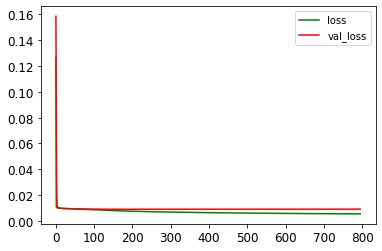

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 797/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

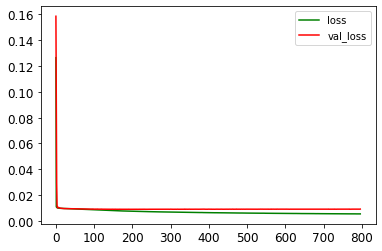

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0549 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 798/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0548

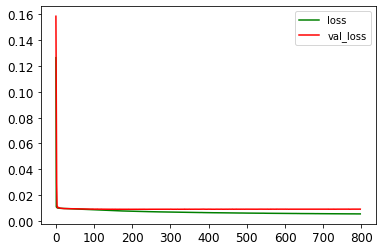

75/75 [==============================] - 1s 10ms/step - loss: 0.0055 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 799/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0547

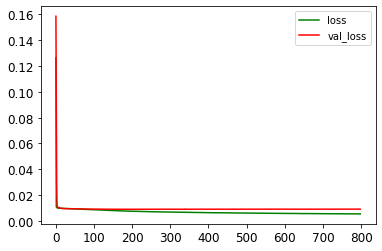

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 800/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0547

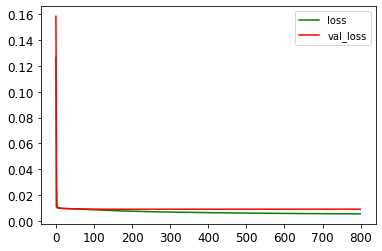

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 801/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

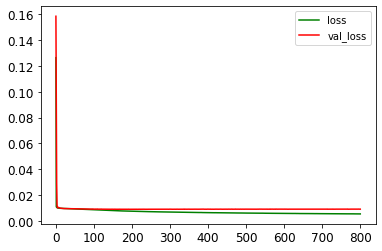

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 802/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

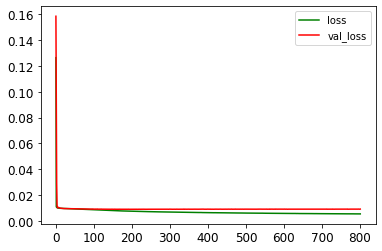

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 803/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

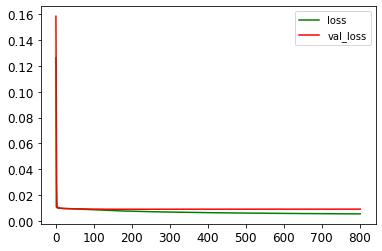

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 804/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0548

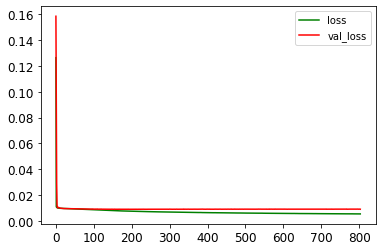

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 805/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0548

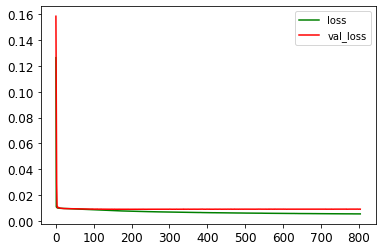

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 806/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0548

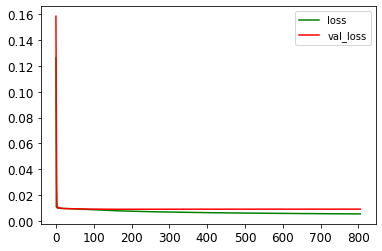

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 807/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0054 - mae: 0.0548

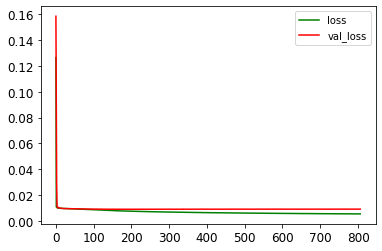

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 808/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0549

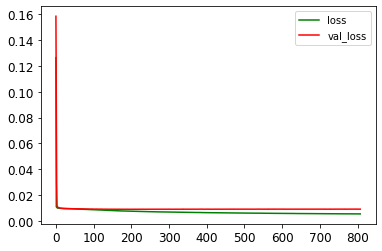

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 809/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

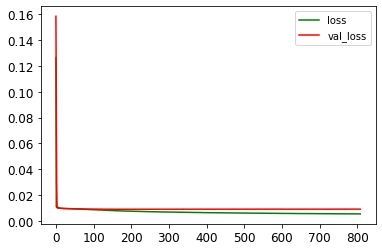

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 810/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0547

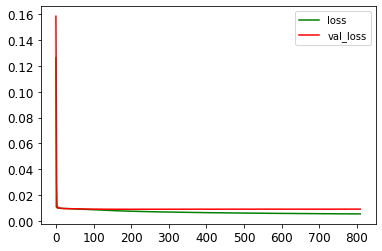

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 811/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0055 - mae: 0.0548

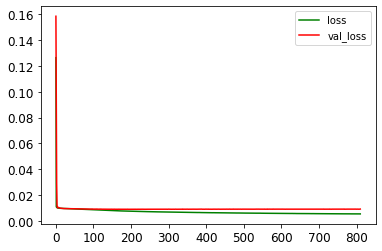

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 812/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

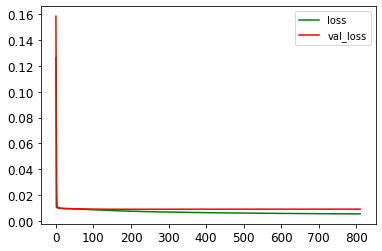

75/75 [==============================] - 1s 7ms/step - loss: 0.0055 - mae: 0.0548 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 813/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

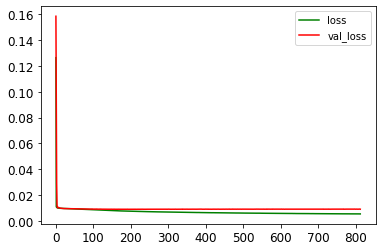

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 814/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

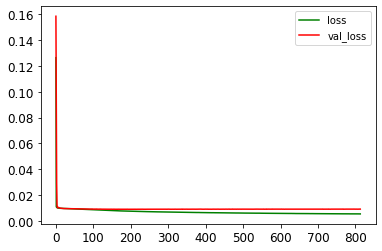

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 815/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

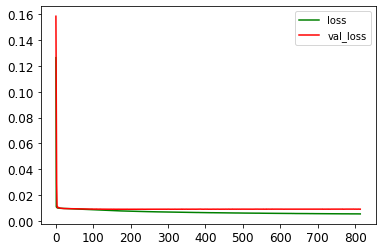

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 816/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

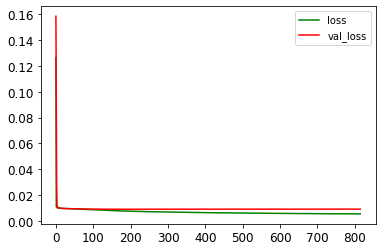

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 817/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

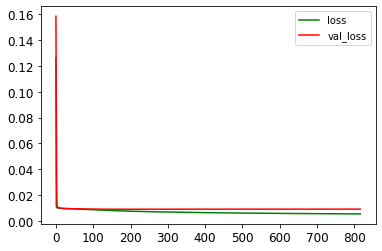

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 818/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

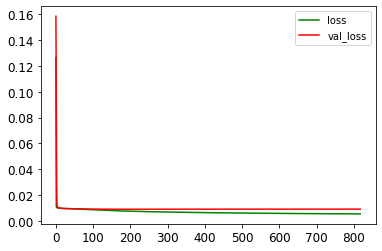

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 819/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0546

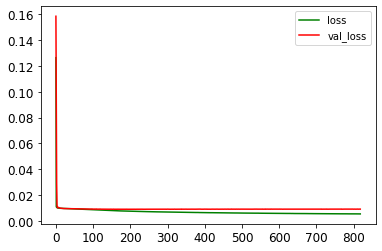

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 820/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

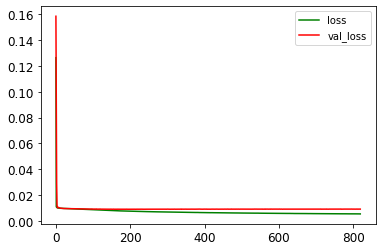

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 821/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

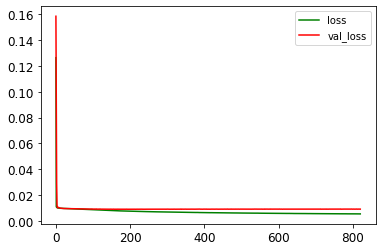

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 822/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0054 - mae: 0.0547

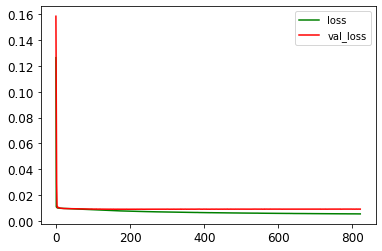

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 823/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0546

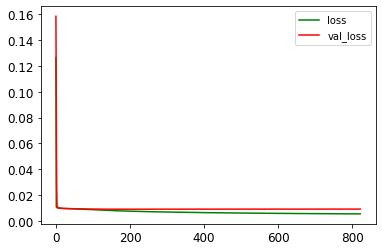

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 824/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0547

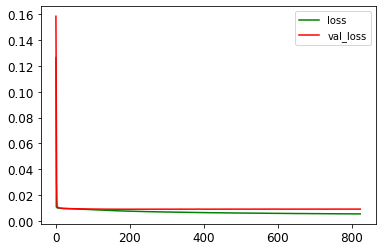

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 825/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

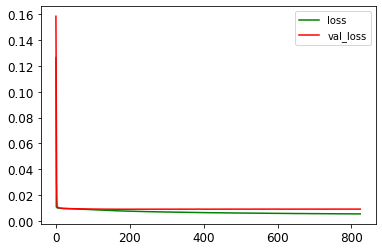

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 826/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

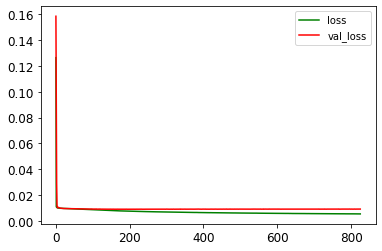

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 827/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

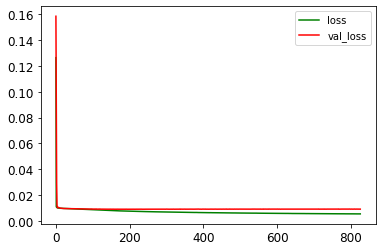

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 828/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0546

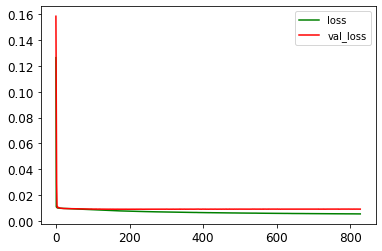

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 829/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

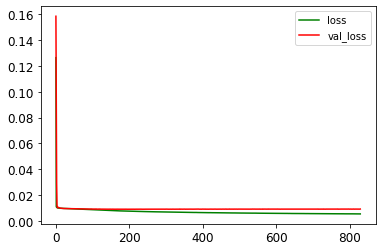

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 830/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

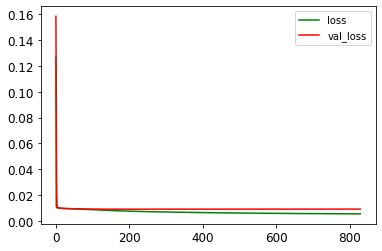

75/75 [==============================] - 1s 10ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 831/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0548

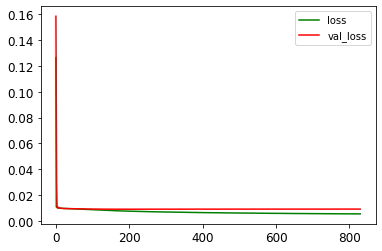

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 832/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

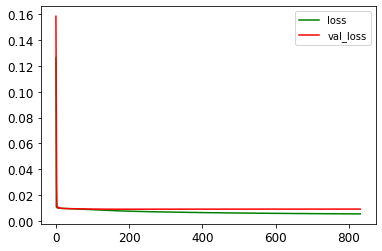

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 833/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

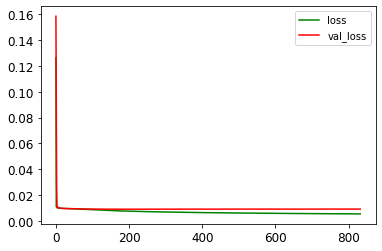

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 834/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

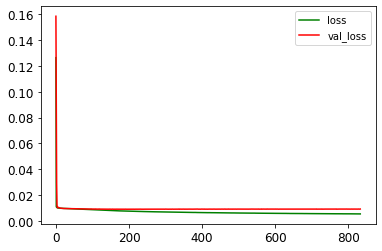

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 835/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

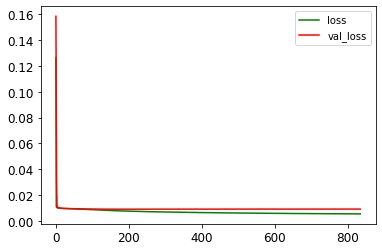

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 836/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

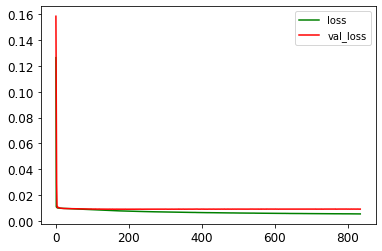

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 837/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

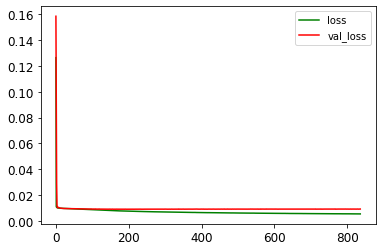

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 838/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

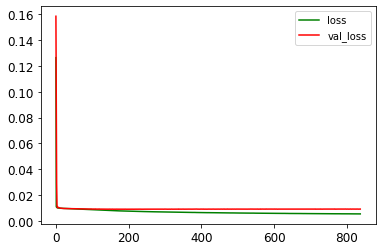

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 839/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

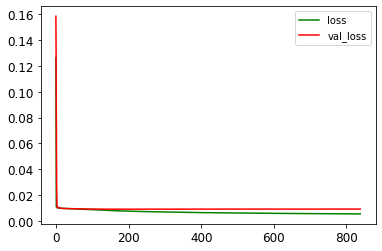

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 840/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

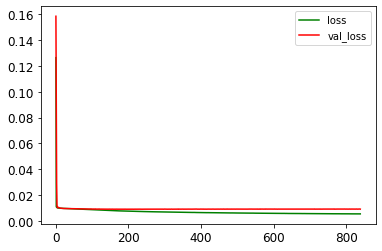

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 841/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0547

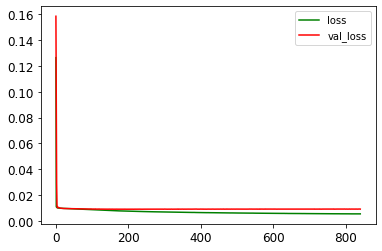

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0547 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 842/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

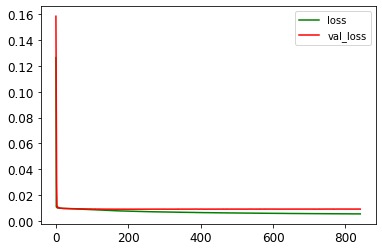

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 843/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

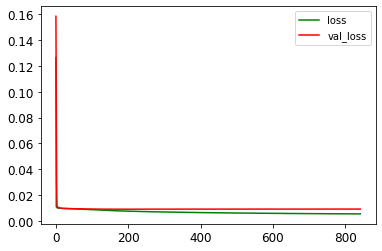

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 844/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

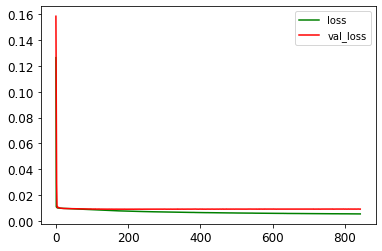

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 845/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

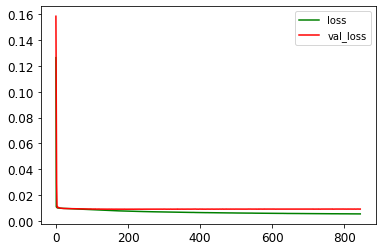

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 846/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

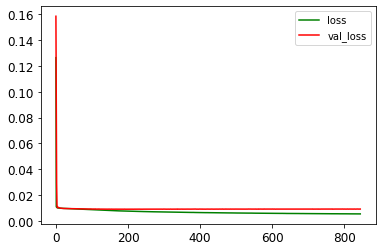

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 847/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

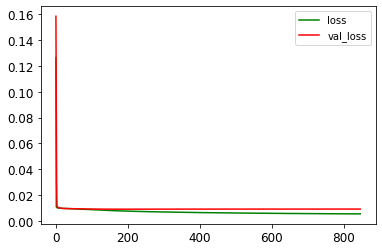

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 848/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

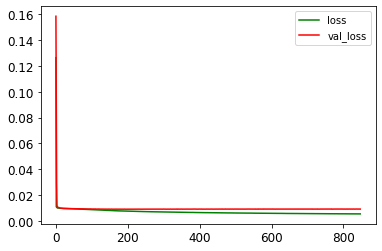

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 849/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

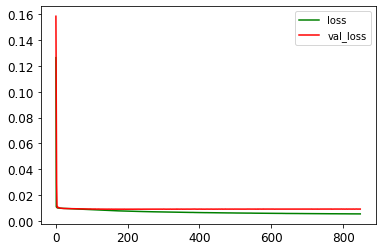

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 850/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

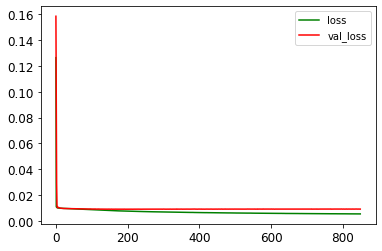

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 851/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

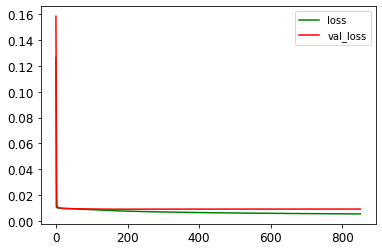

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 852/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0546

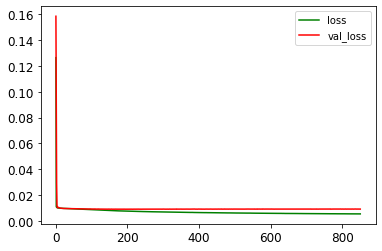

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 853/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

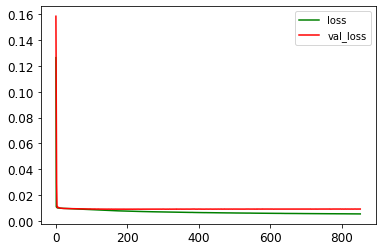

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 854/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0544

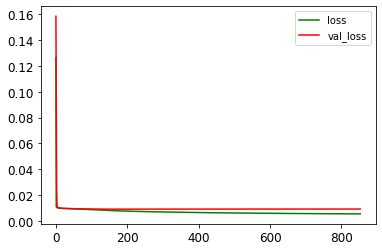

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 855/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

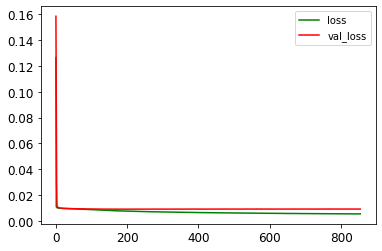

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 856/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0545

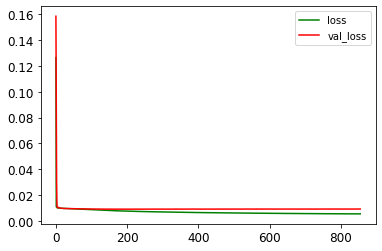

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 857/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0544

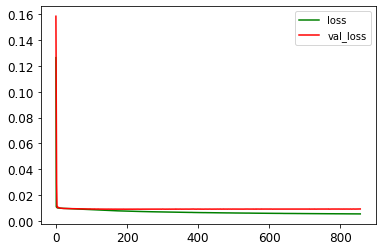

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 858/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

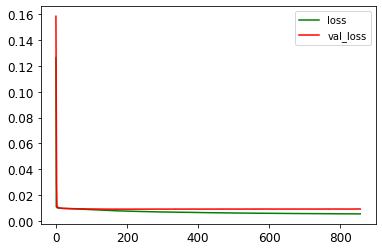

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 859/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0543

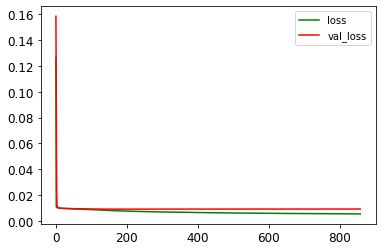

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 860/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

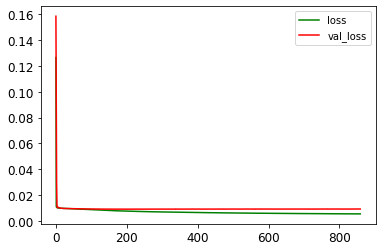

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 861/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0544

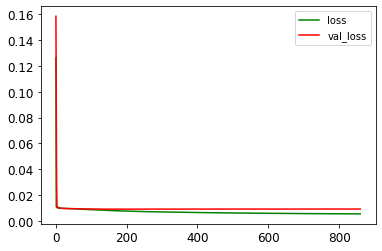

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 862/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

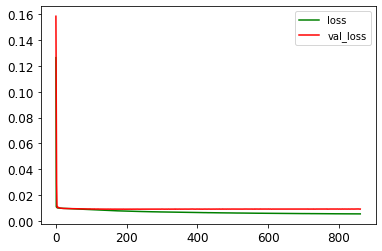

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0545 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 863/1500
75/75 [==============================] - ETA: 0s - loss: 0.0054 - mae: 0.0544

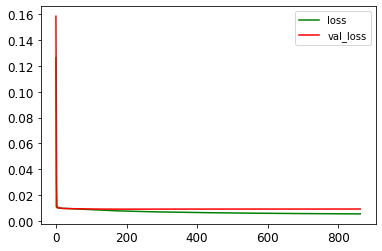

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 864/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0054 - mae: 0.0546

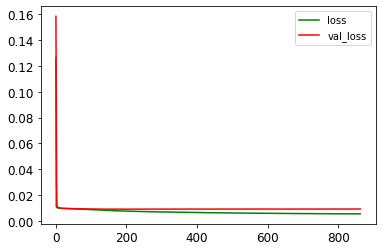

75/75 [==============================] - 1s 10ms/step - loss: 0.0054 - mae: 0.0546 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 865/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0543

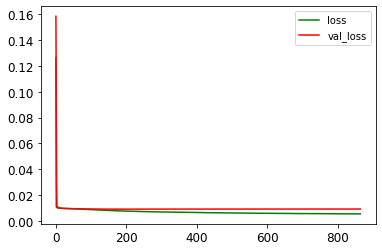

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 866/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0542

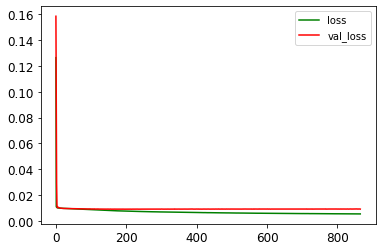

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 867/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

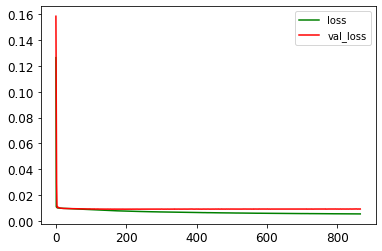

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 868/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0542

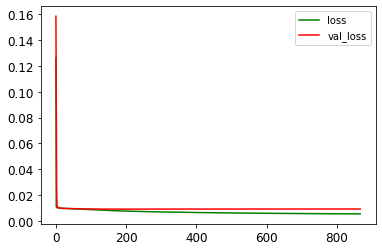

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 869/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

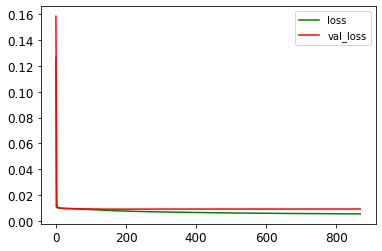

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 870/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

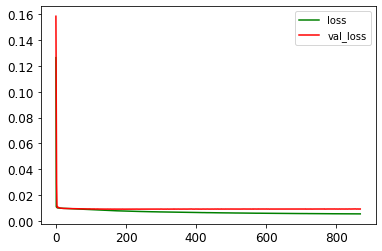

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 871/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0543

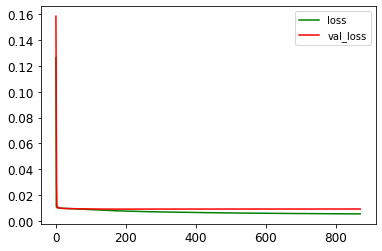

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 872/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

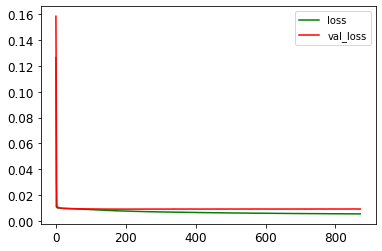

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 873/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

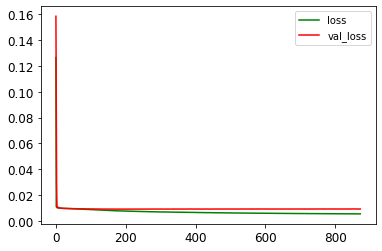

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 874/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

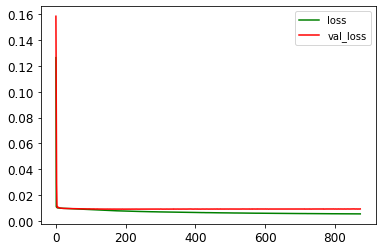

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 875/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

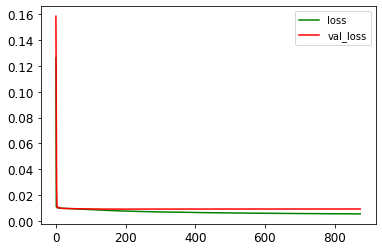

75/75 [==============================] - 1s 7ms/step - loss: 0.0054 - mae: 0.0544 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 876/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

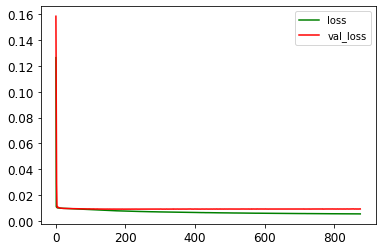

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 877/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0542

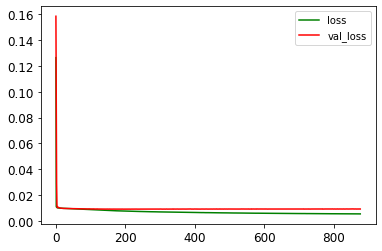

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 878/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0543

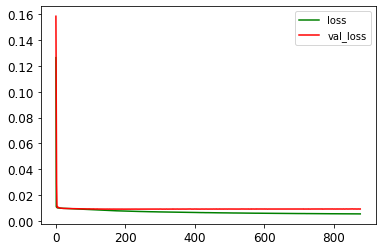

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 879/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0542

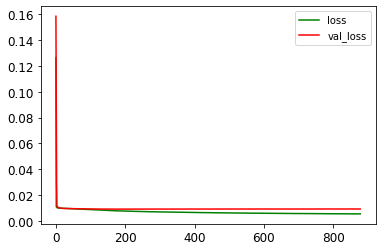

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 880/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

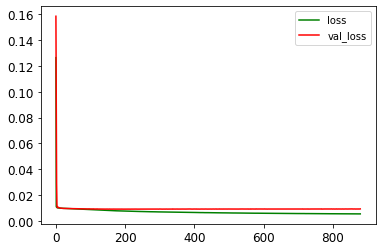

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 881/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0542

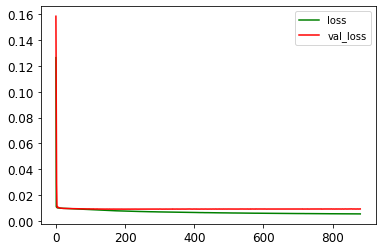

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 882/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

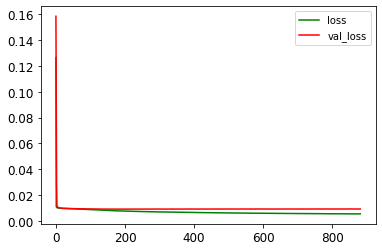

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 883/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

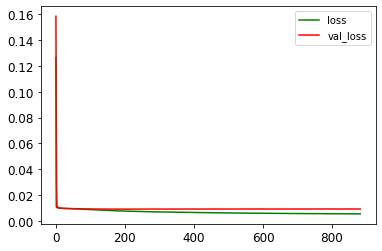

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 884/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

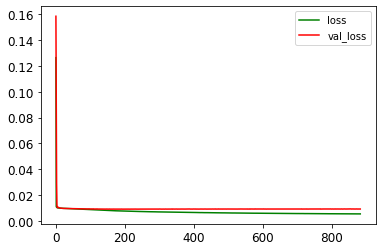

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 885/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0543

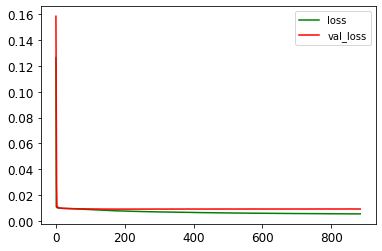

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 886/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

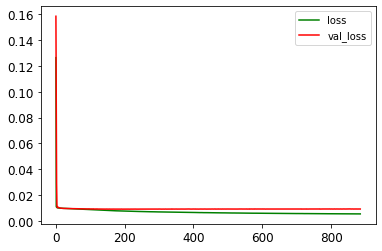

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 887/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

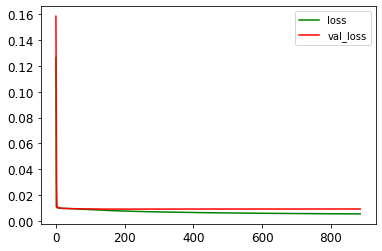

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 888/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

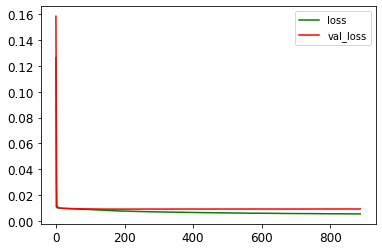

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0543 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 889/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0542

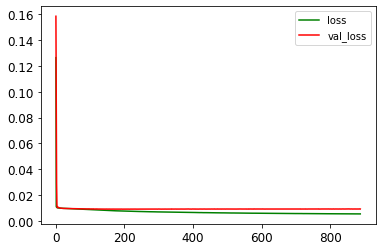

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 890/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0054 - mae: 0.0544

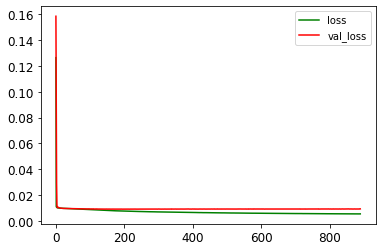

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0544 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 891/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0542

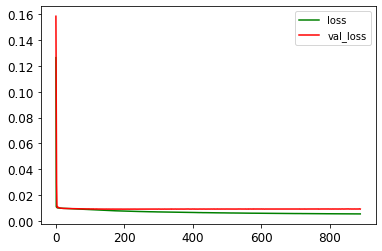

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 892/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0543

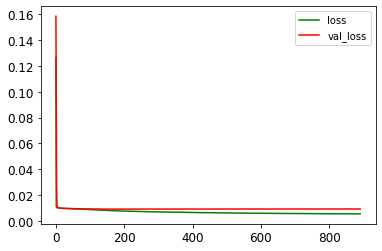

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 893/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

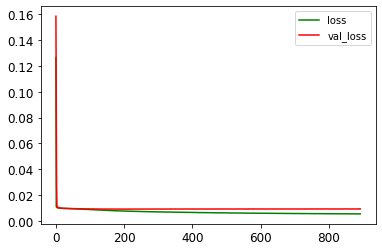

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 894/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

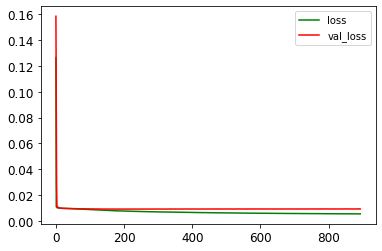

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 895/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

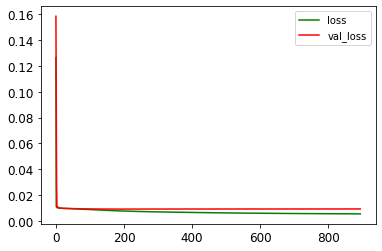

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 896/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0542

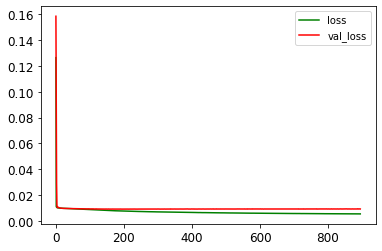

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 897/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

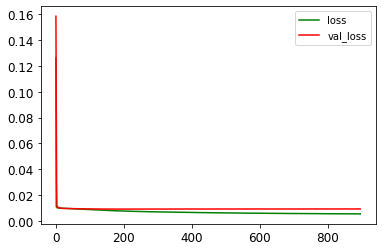

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 898/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

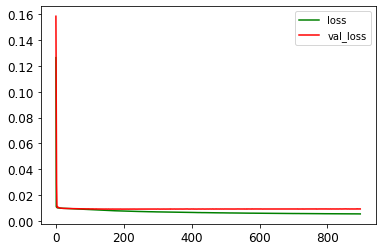

75/75 [==============================] - 1s 10ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 899/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0541

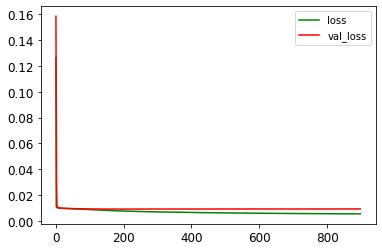

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 900/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

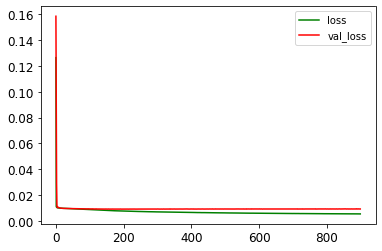

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 901/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

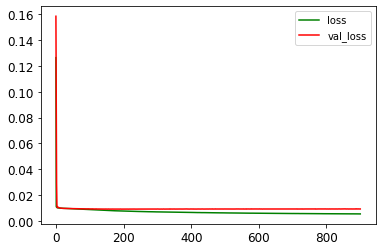

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 902/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

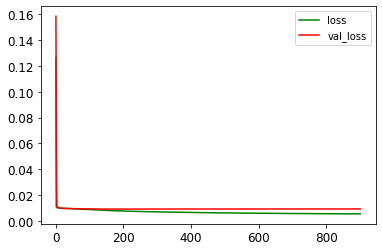

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 903/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

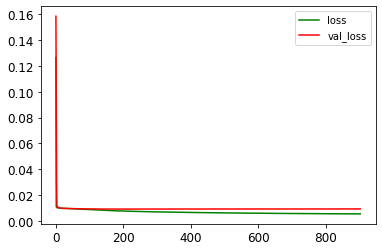

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 904/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

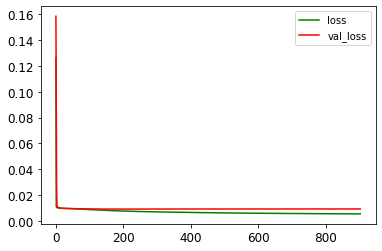

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 905/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

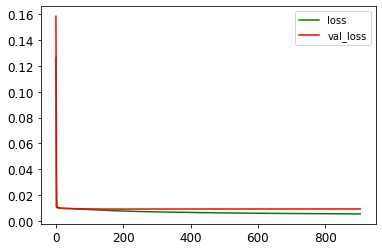

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 906/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

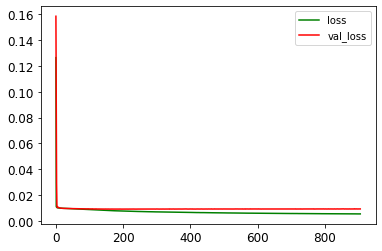

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 907/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

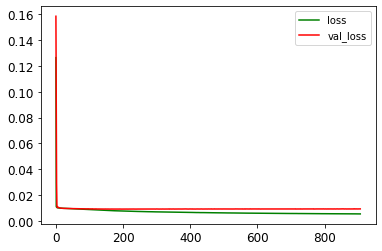

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 908/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

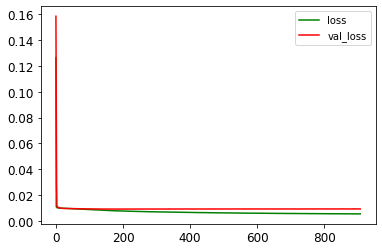

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0542 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 909/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

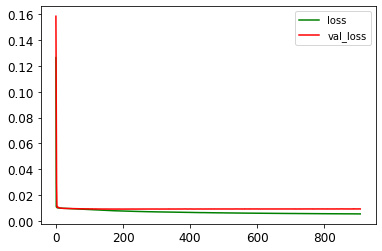

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 910/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

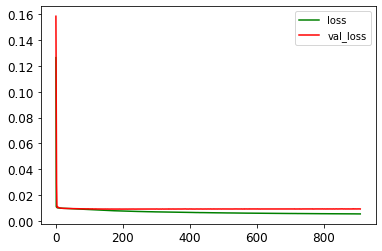

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 911/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

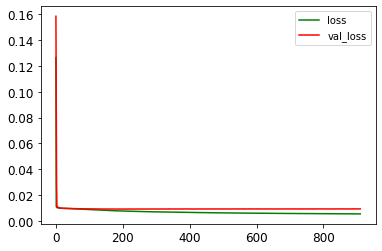

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 912/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

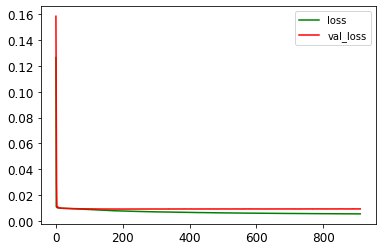

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 913/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

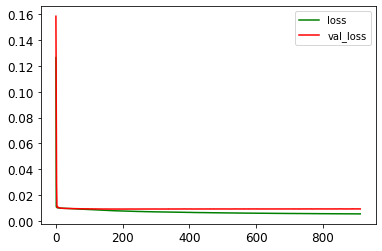

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 914/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0541

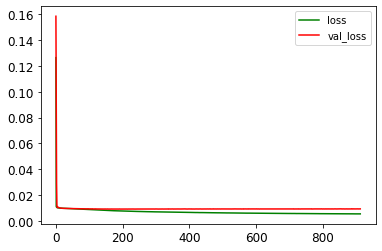

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 915/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0541

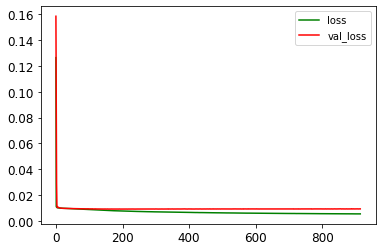

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 916/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

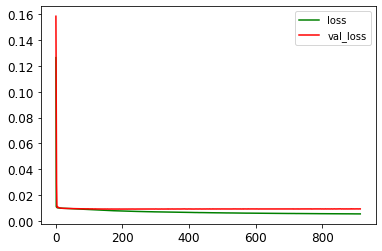

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 917/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0541

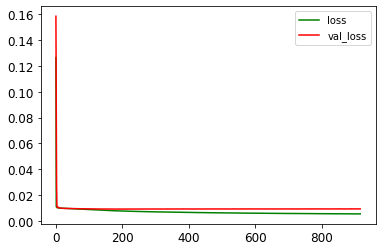

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 918/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0540

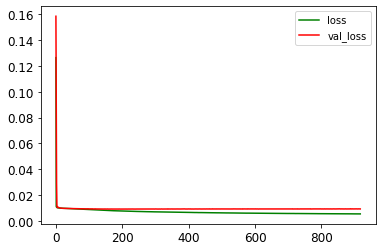

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 919/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0539

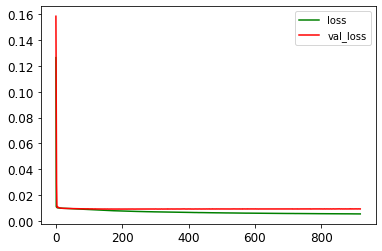

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 920/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0541

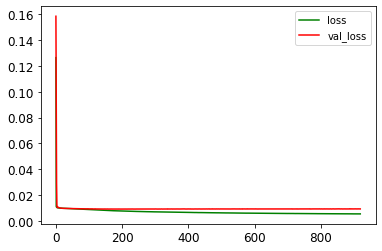

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 921/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

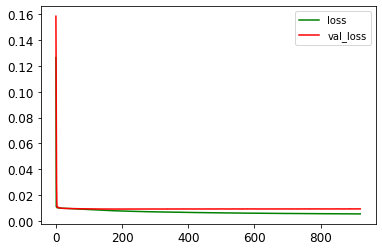

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 922/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

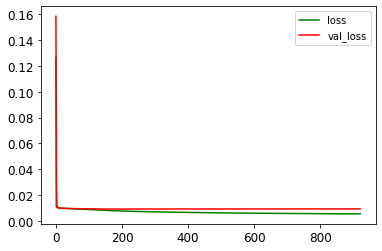

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 923/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

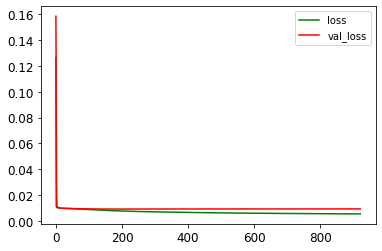

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 924/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0540

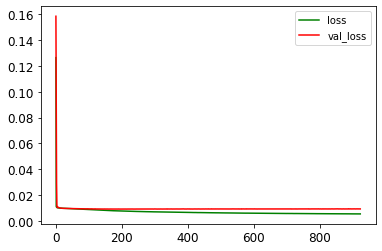

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 925/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

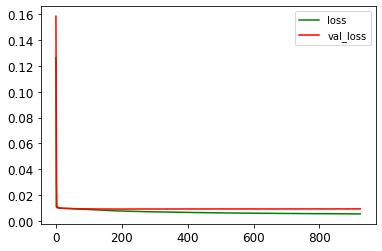

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 926/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0541

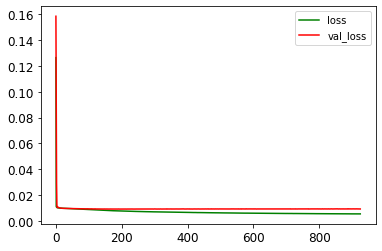

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0541 - val_loss: 0.0091 - val_mae: 0.0695
Epoch 927/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0539

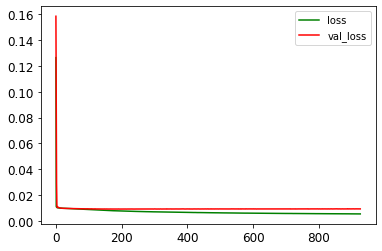

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 928/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

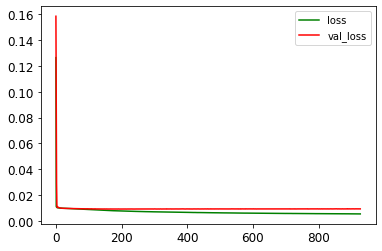

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 929/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0539

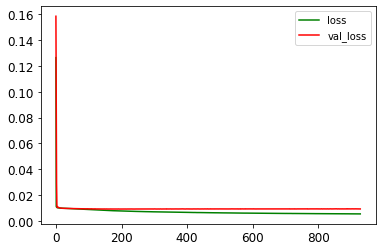

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 930/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0540

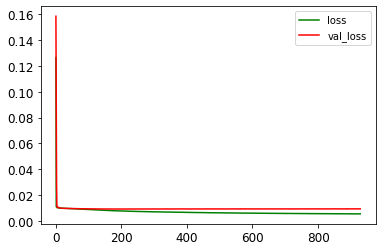

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 931/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0539

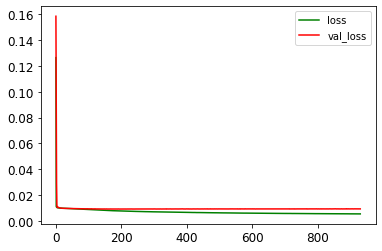

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 932/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0539

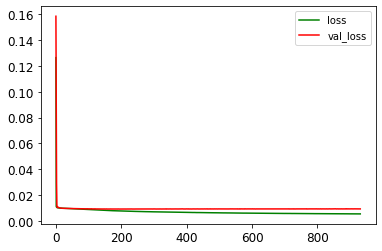

75/75 [==============================] - 1s 10ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 933/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

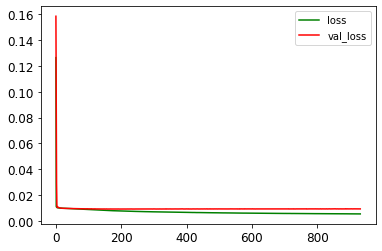

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 934/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0539

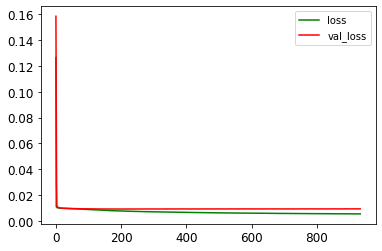

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 935/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

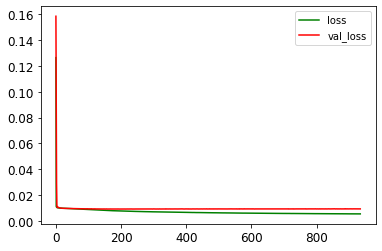

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 936/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

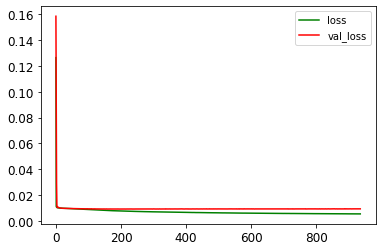

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 937/1500
75/75 [==============================] - ETA: 0s - loss: 0.0053 - mae: 0.0539

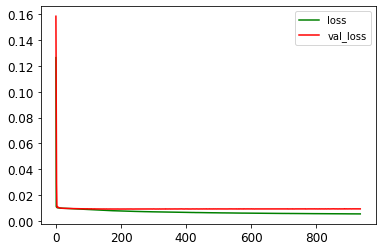

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 938/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

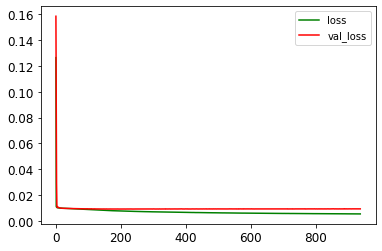

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 939/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

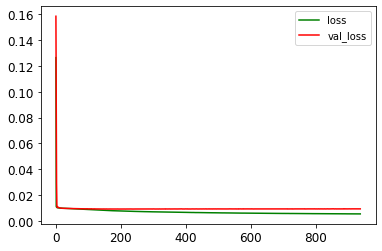

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 940/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0053 - mae: 0.0539

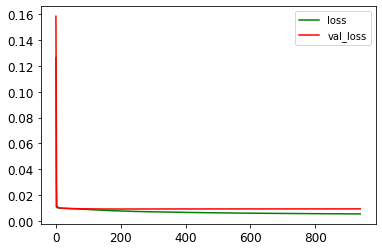

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 941/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

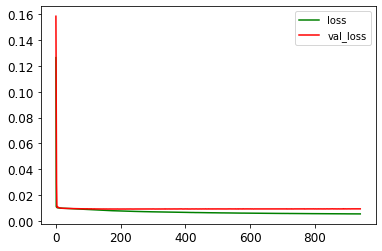

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 942/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

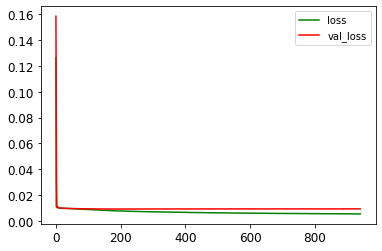

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 943/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

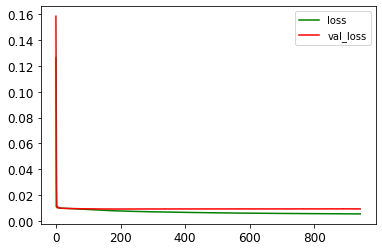

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 944/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

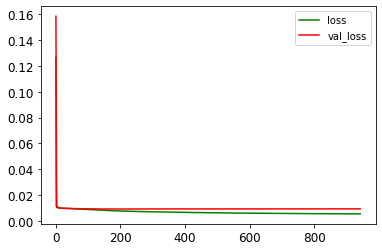

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 945/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

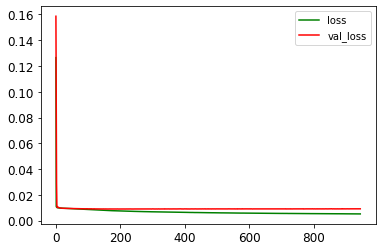

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 946/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

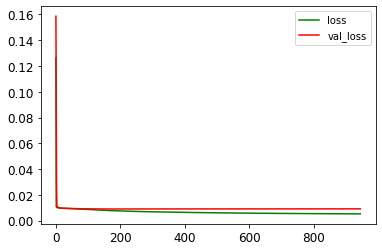

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 947/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

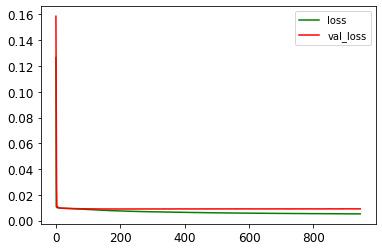

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0539 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 948/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0539

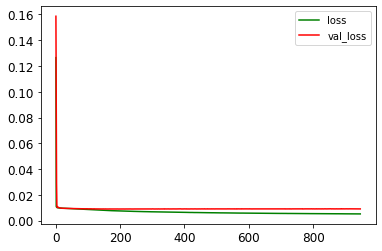

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 949/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0053 - mae: 0.0539

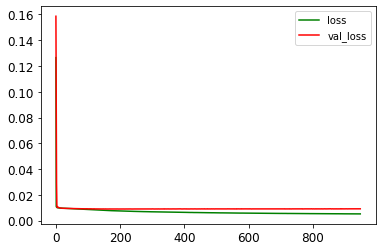

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0539 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 950/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0539

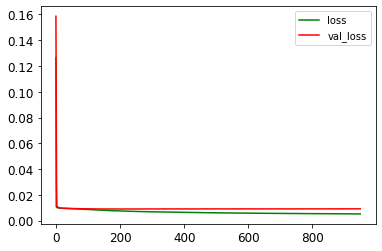

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 951/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

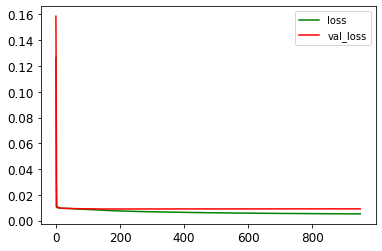

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 952/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

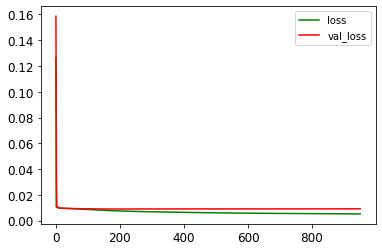

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 953/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

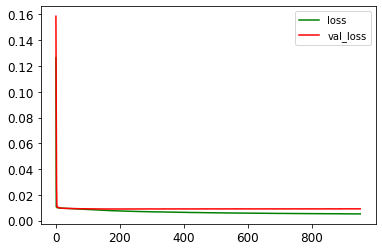

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 954/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0538

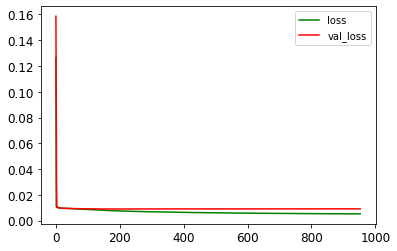

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 955/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

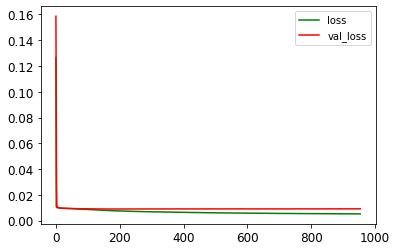

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 956/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0538

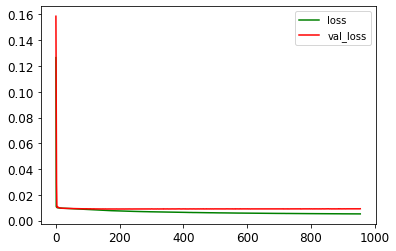

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 957/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

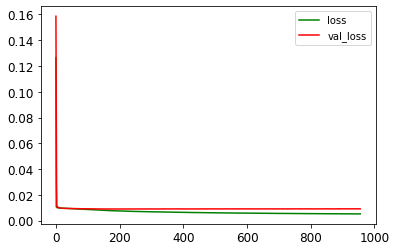

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 958/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0538

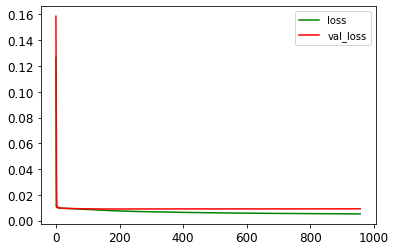

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 959/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0053 - mae: 0.0540

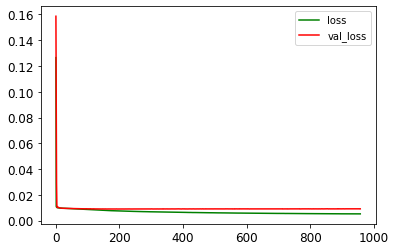

75/75 [==============================] - 1s 7ms/step - loss: 0.0053 - mae: 0.0540 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 960/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

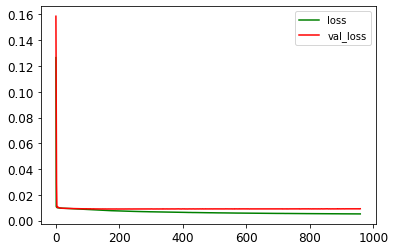

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 961/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

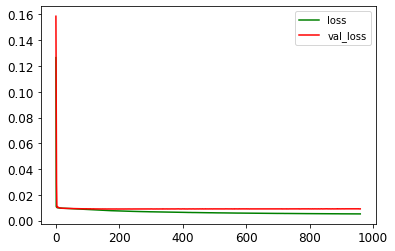

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 962/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

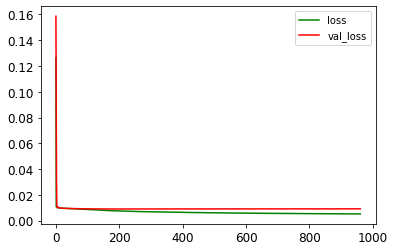

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 963/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0538

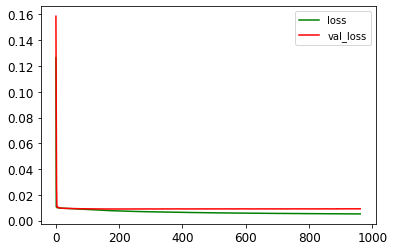

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 964/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

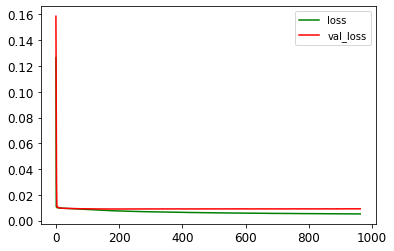

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 965/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

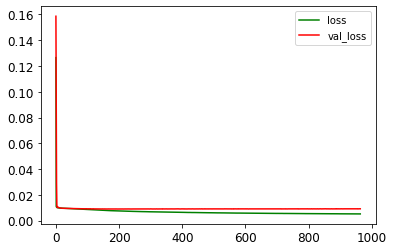

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 966/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

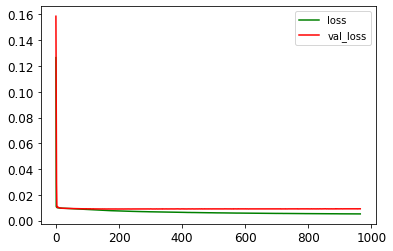

75/75 [==============================] - 1s 10ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 967/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0539

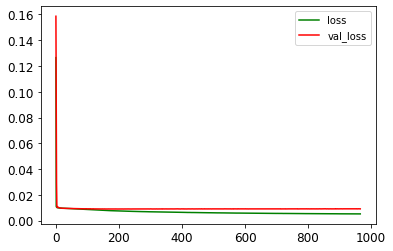

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 968/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

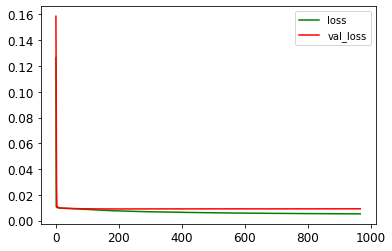

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 969/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

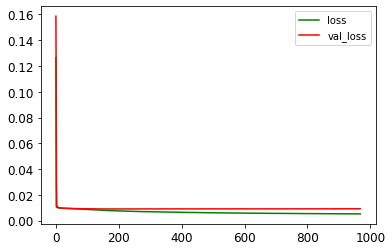

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 970/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

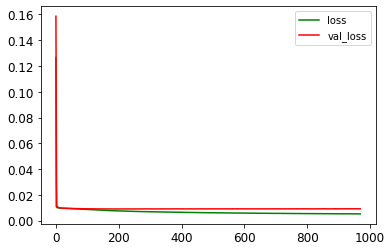

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 971/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

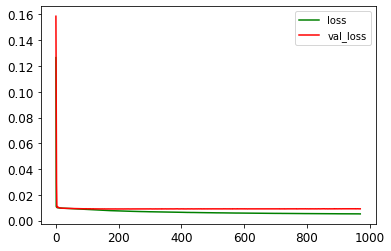

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 972/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

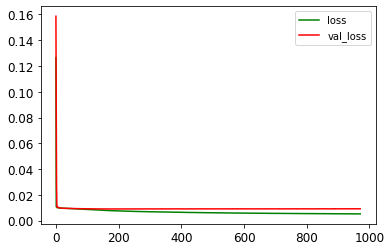

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 973/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0538

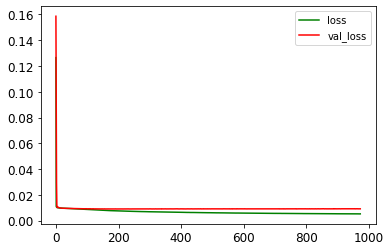

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0538 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 974/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

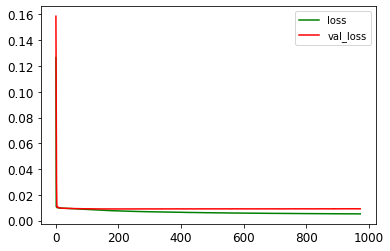

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 975/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

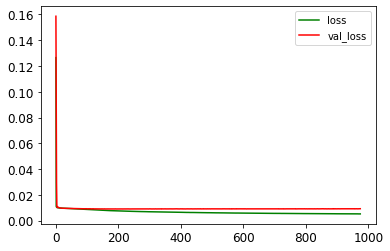

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 976/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

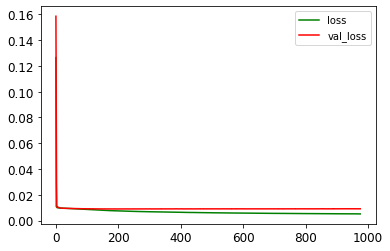

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 977/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

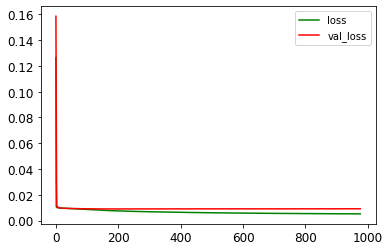

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 978/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0052 - mae: 0.0537

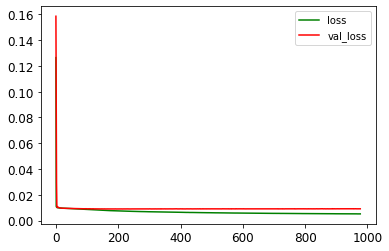

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 979/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0536

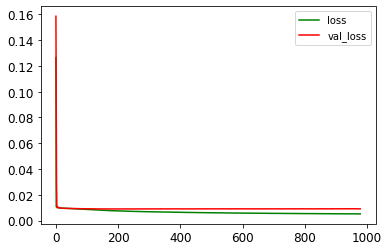

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 980/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

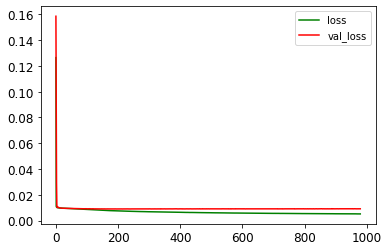

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 981/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0536

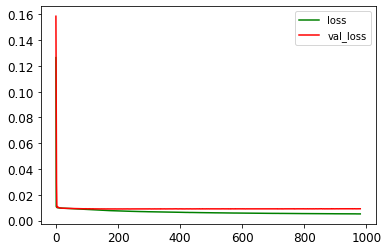

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 982/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0537

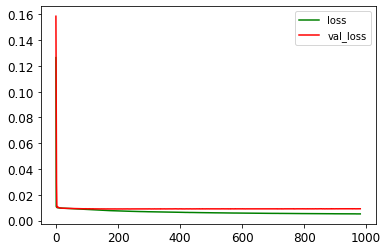

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 983/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0052 - mae: 0.0536

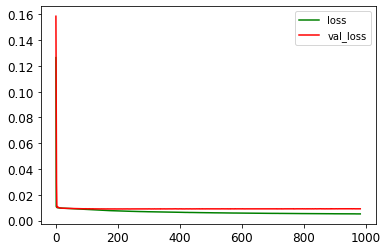

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 984/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0537

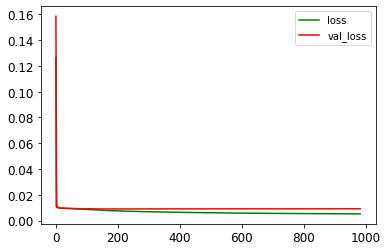

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 985/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

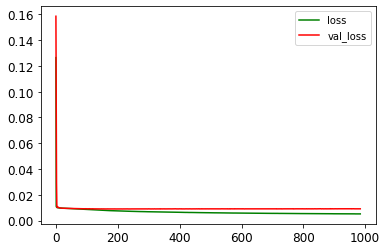

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 986/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

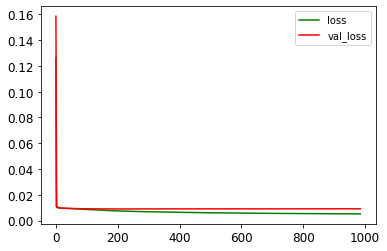

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 987/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0537

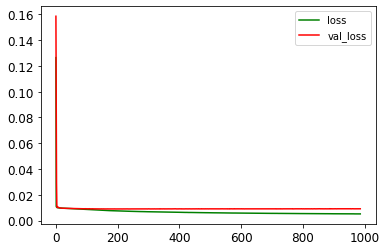

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 988/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

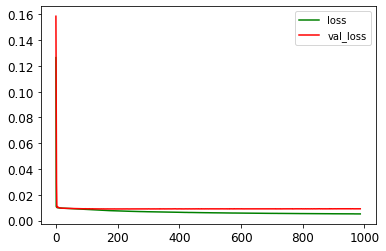

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 989/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

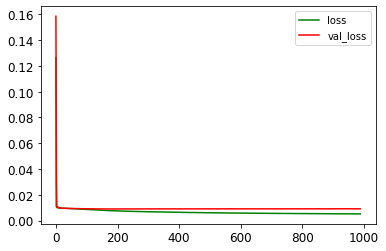

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 990/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0535

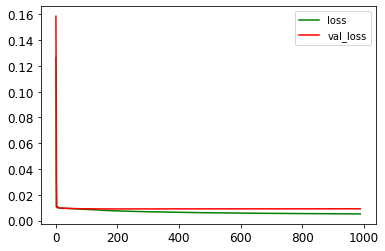

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 991/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0535

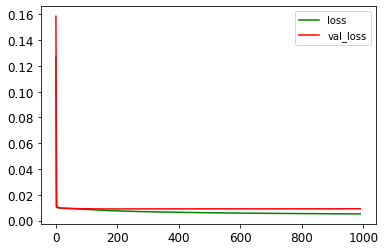

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 992/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0536

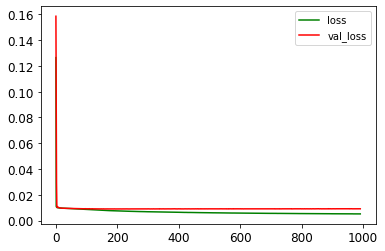

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 993/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0536

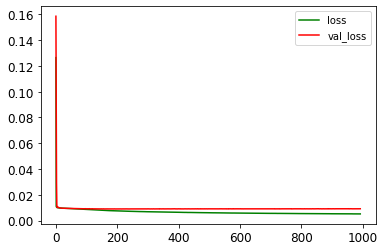

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 994/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

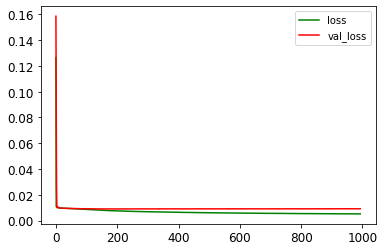

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 995/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

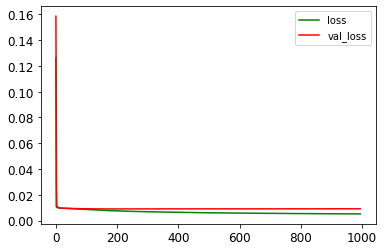

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0537 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 996/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

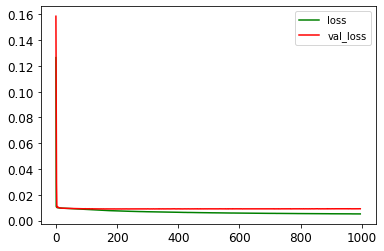

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 997/1500
70/75 [===========================>..] - ETA: 0s - loss: 0.0052 - mae: 0.0534

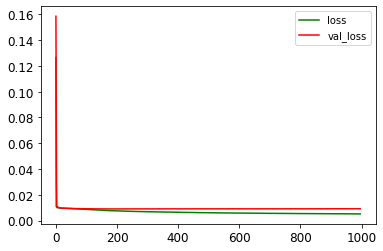

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 998/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0535

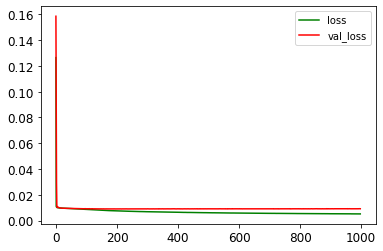

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 999/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

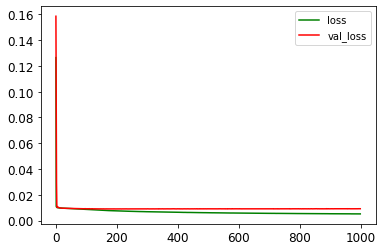

75/75 [==============================] - 1s 10ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1000/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

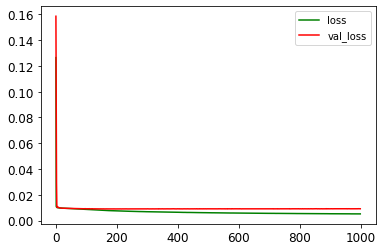

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1001/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

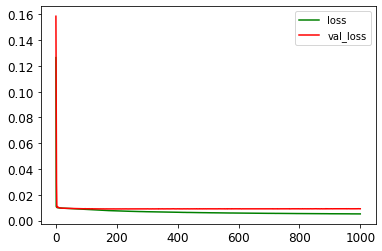

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1002/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0535

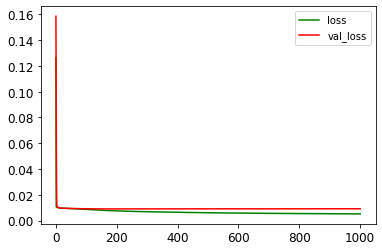

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1003/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0534

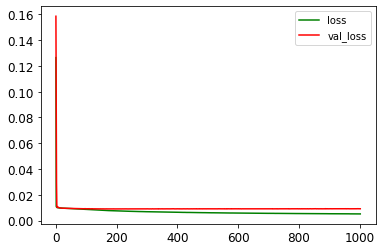

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 1004/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0537

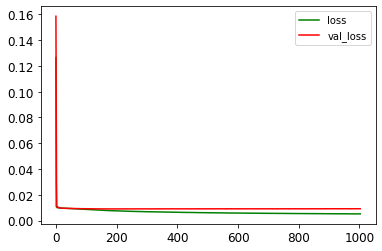

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1005/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

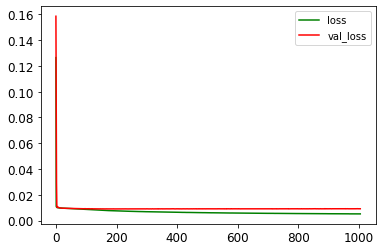

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1006/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0534

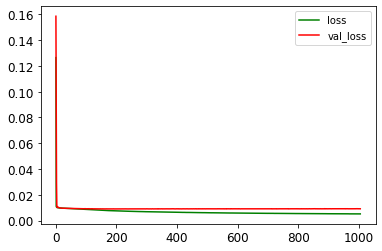

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1007/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

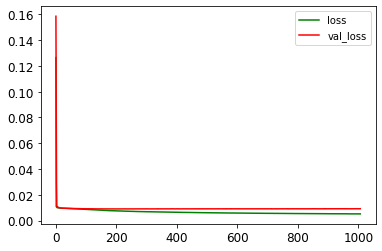

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1008/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0535

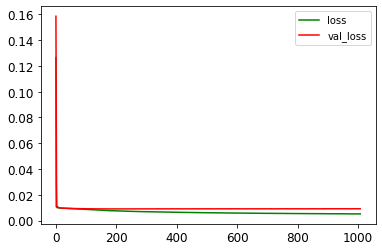

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1009/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

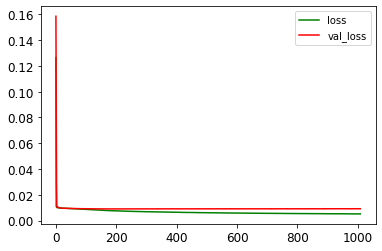

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1010/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

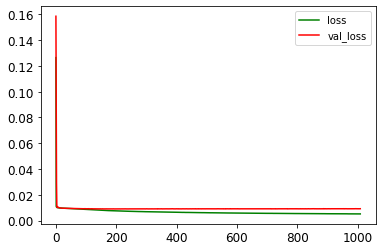

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1011/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

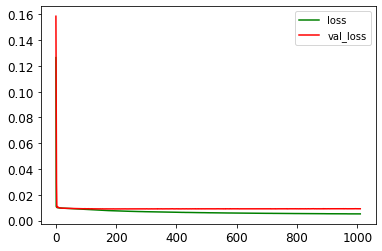

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 1012/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

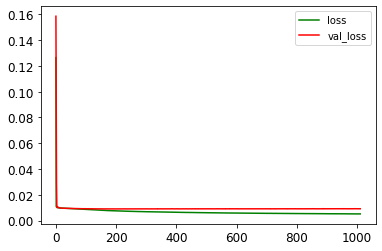

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1013/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0534

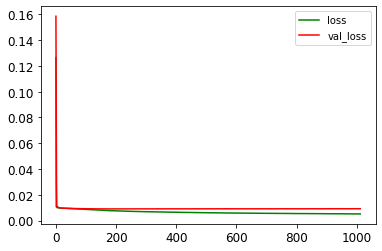

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1014/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0533

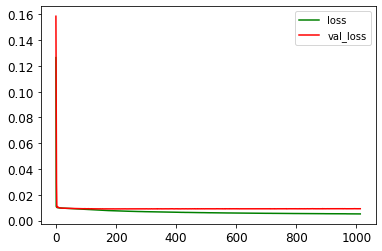

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1015/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

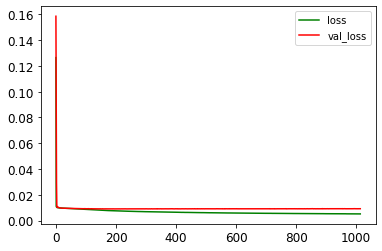

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1016/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0535

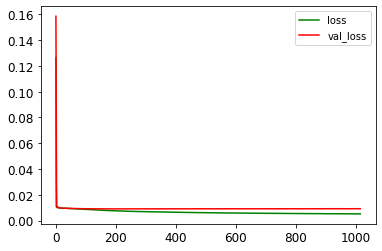

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1017/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

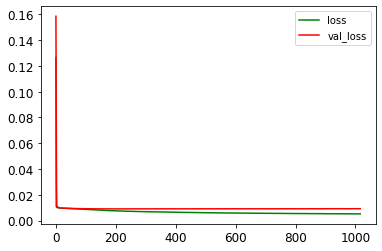

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1018/1500
75/75 [==============================] - ETA: 0s - loss: 0.0052 - mae: 0.0536

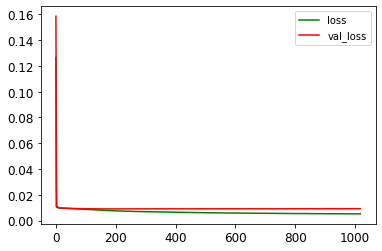

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1019/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0536

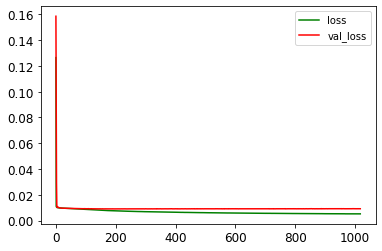

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0536 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1020/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

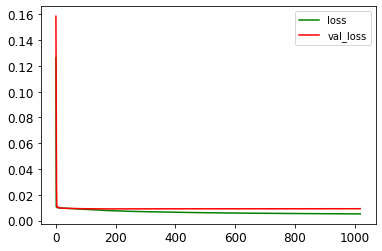

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1021/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

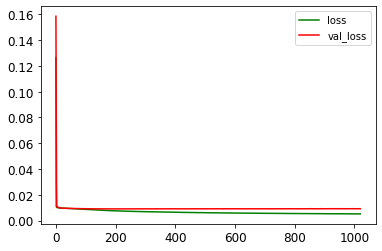

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1022/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0052 - mae: 0.0534

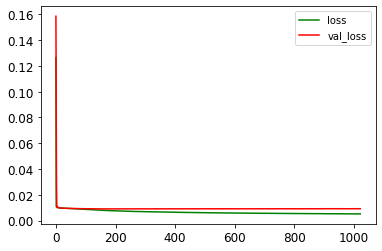

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 1023/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

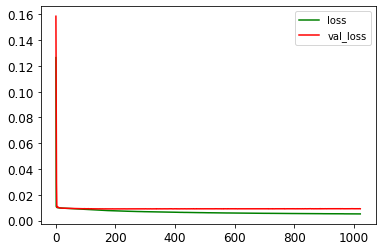

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 1024/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

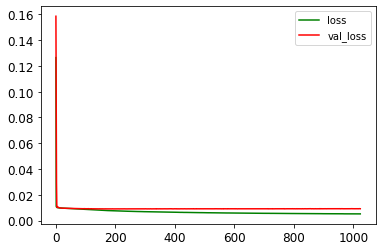

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0535 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1025/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

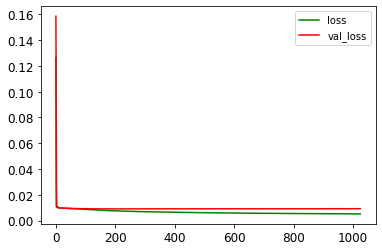

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1026/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

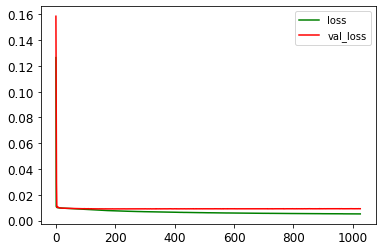

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1027/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

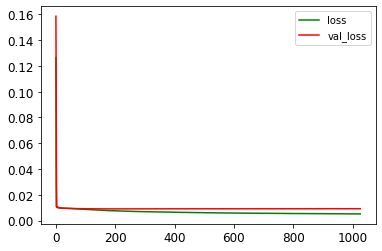

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1028/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0533

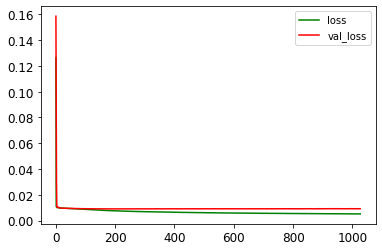

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0091 - val_mae: 0.0698
Epoch 1029/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0534

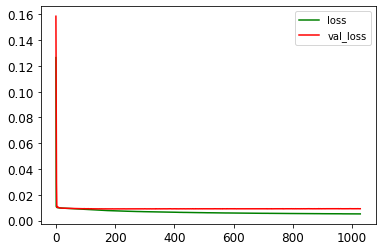

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1030/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

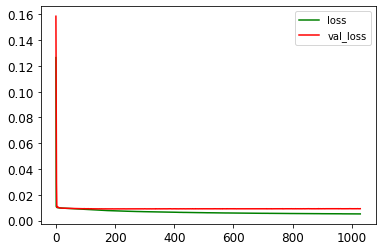

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1031/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0052 - mae: 0.0534

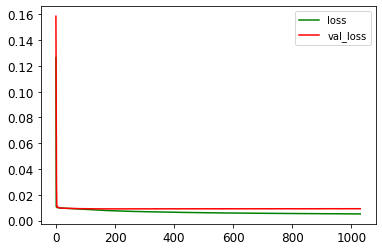

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1032/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

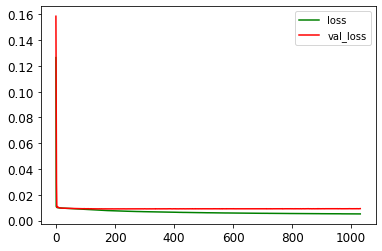

75/75 [==============================] - 1s 10ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1033/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0534

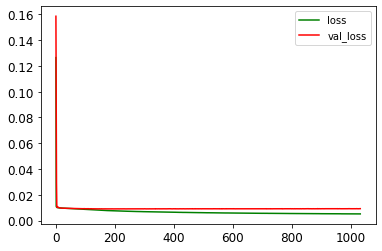

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1034/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

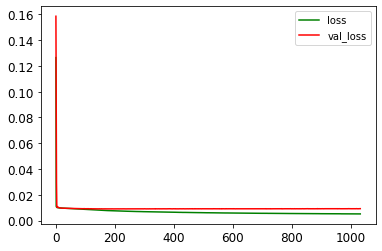

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1035/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0052 - mae: 0.0535

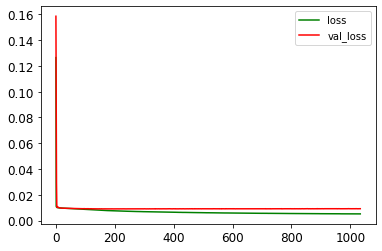

75/75 [==============================] - 1s 7ms/step - loss: 0.0052 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1036/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

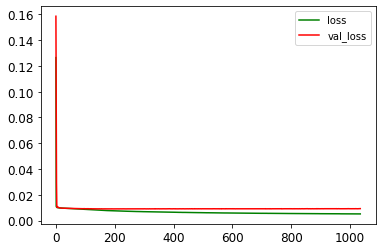

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1037/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

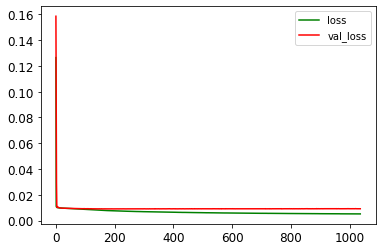

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1038/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

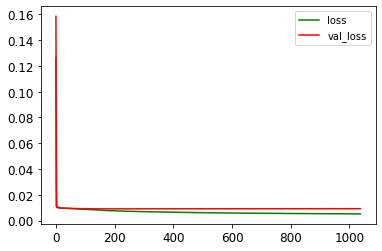

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1039/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0534

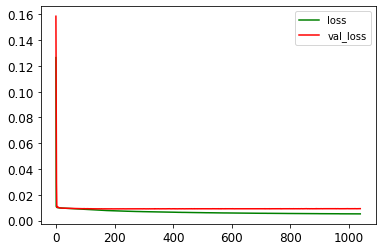

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1040/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0533

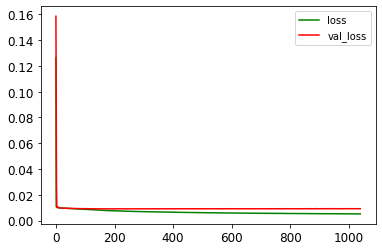

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1041/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0534

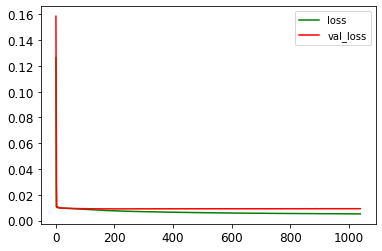

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1042/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

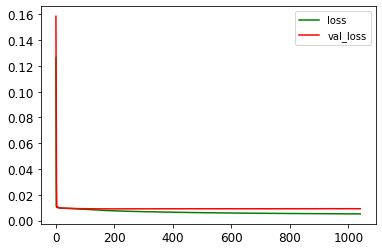

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0091 - val_mae: 0.0696
Epoch 1043/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

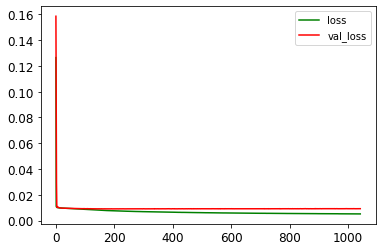

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1044/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

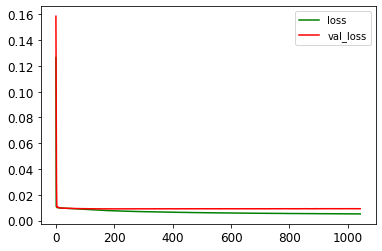

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1045/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0533

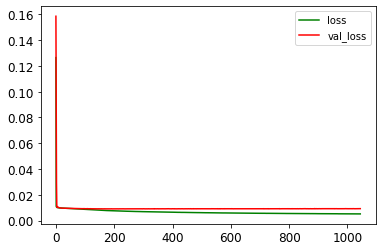

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1046/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

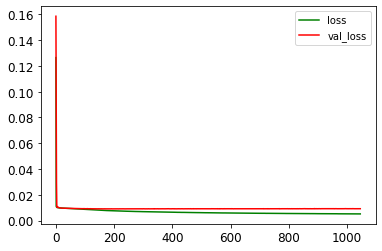

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1047/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

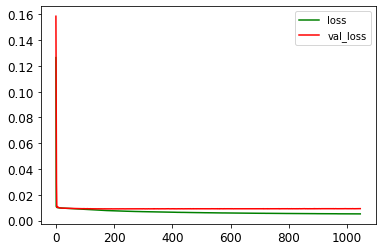

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0534 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1048/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

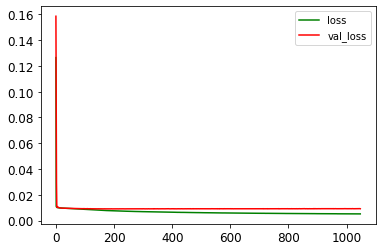

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1049/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0533

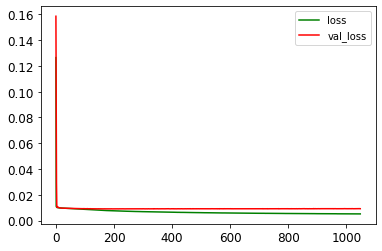

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1050/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

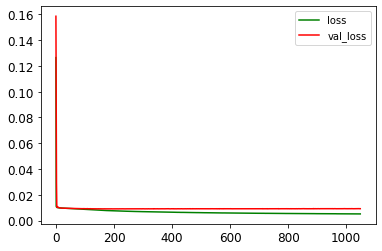

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1051/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

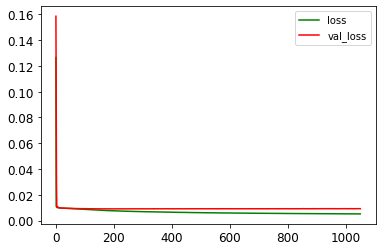

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1052/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

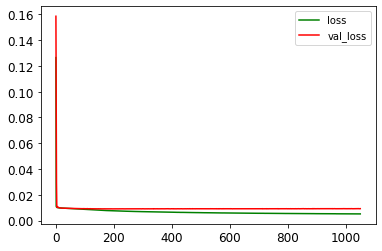

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1053/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

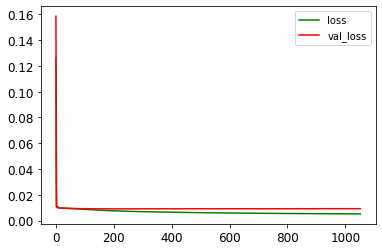

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1054/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

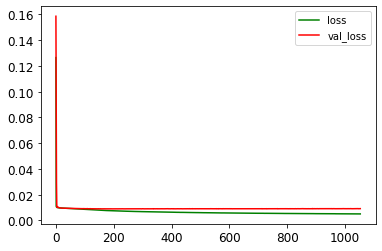

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1055/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

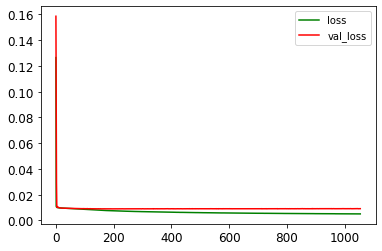

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1056/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0533

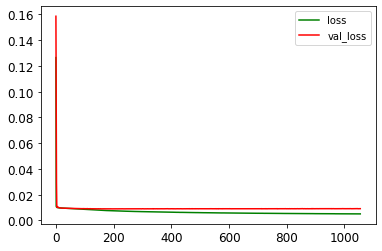

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1057/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0531

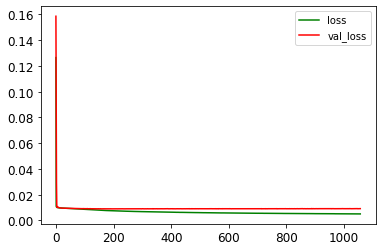

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1058/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

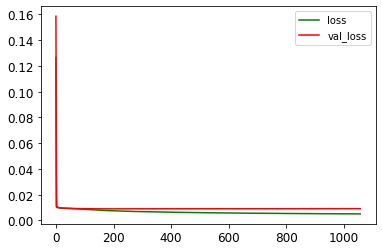

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1059/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

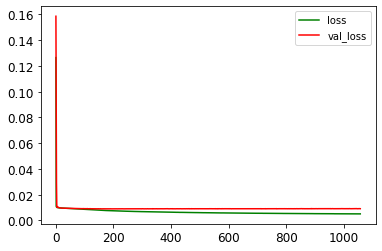

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1060/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

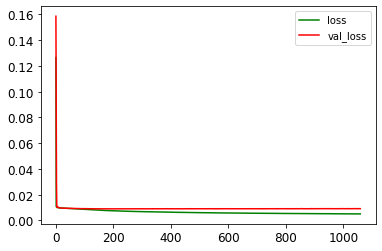

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1061/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

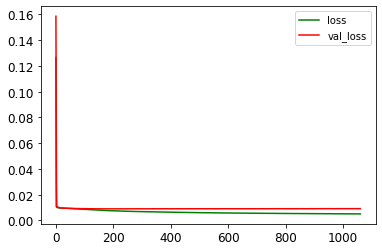

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1062/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

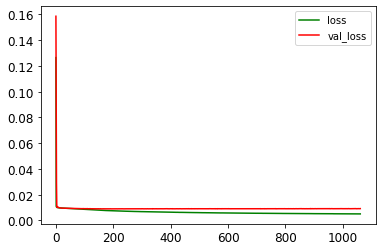

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1063/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0534

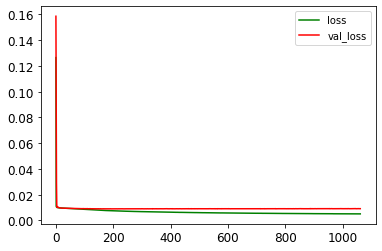

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1064/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

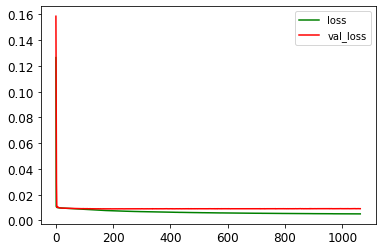

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 1065/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

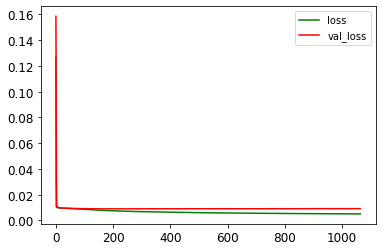

75/75 [==============================] - 1s 10ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1066/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

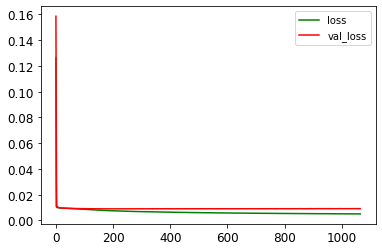

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1067/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

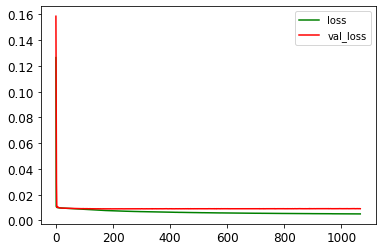

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1068/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

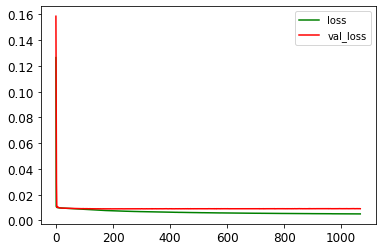

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1069/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

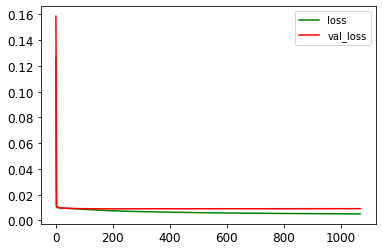

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1070/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0531

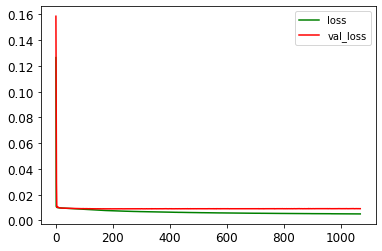

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1071/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

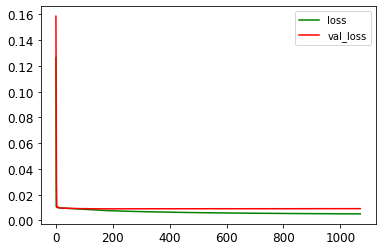

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1072/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

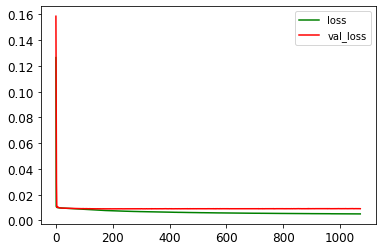

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1073/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0533

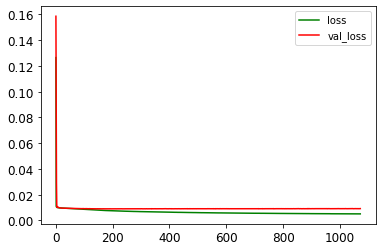

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0533 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1074/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

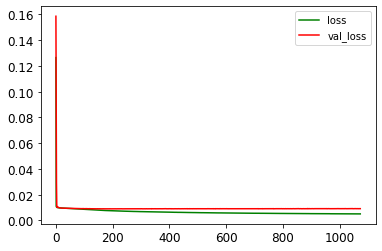

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1075/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

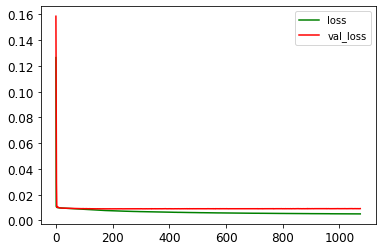

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1076/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

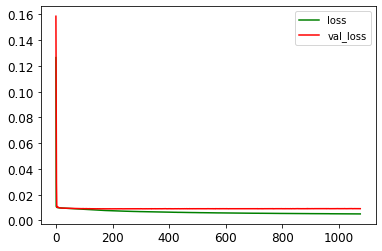

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1077/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

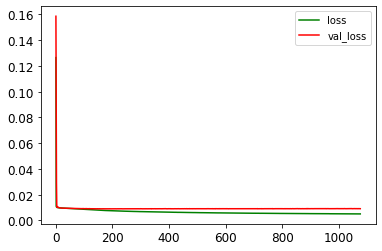

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1078/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

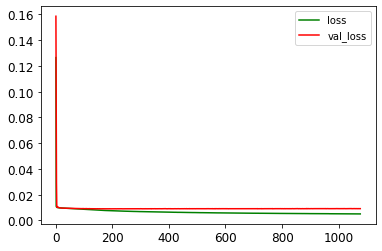

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1079/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

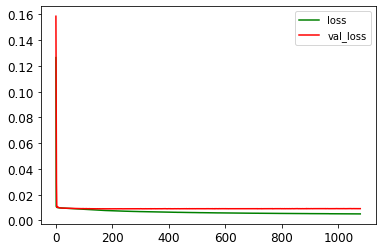

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1080/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

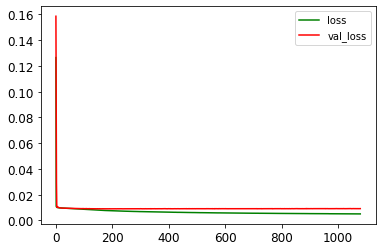

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1081/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

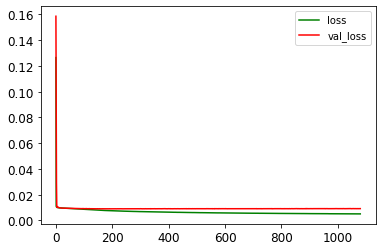

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1082/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0531

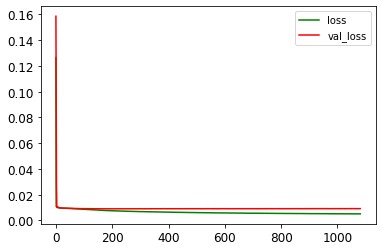

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1083/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

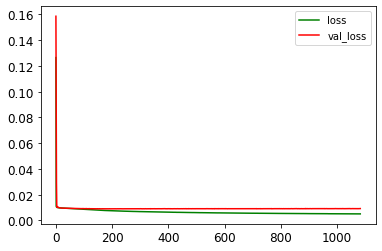

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1084/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

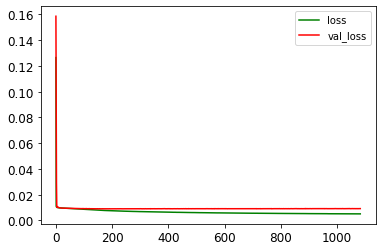

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0532 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1085/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

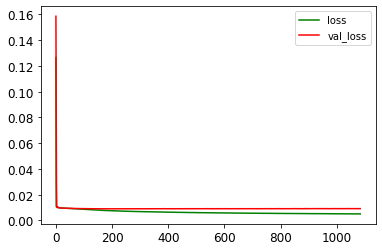

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1086/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0529

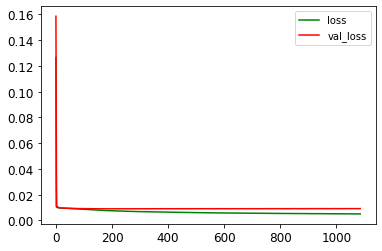

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1087/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0531

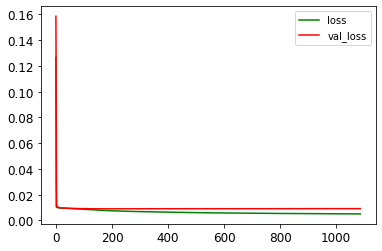

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1088/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0532

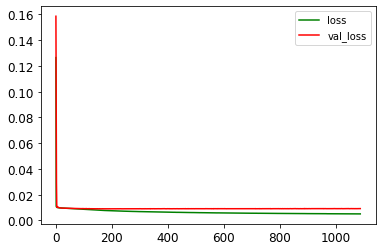

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1089/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

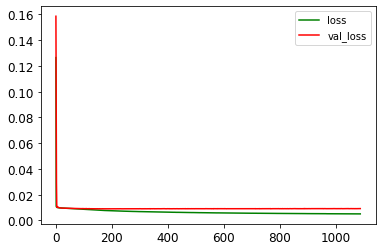

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1090/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

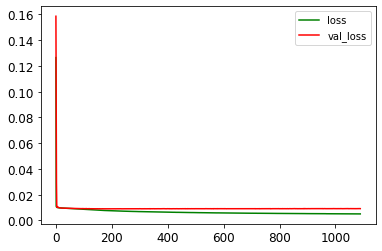

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1091/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

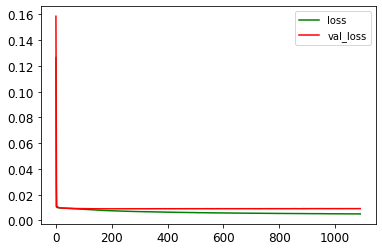

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1092/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

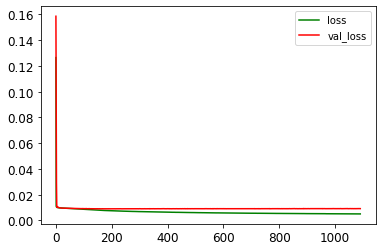

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1093/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

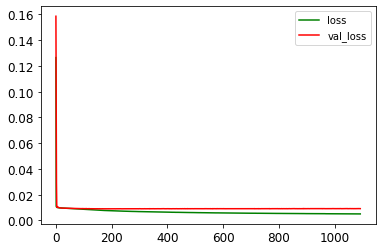

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1094/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0530

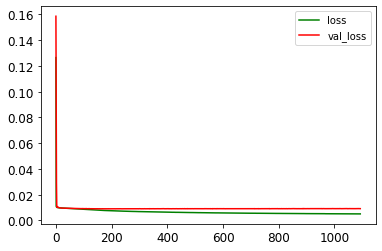

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1095/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0530

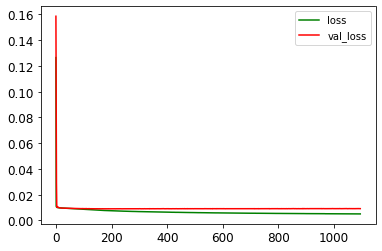

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1096/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0529

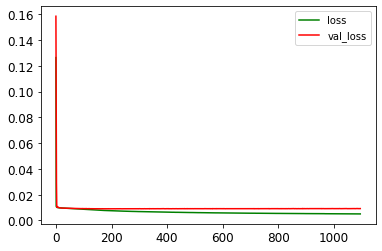

75/75 [==============================] - 0s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1097/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

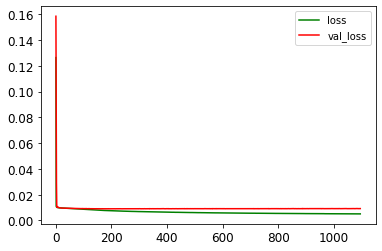

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1098/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

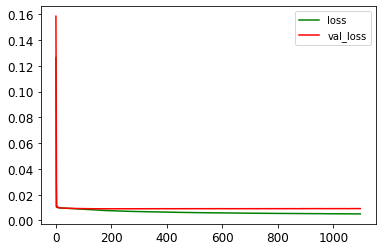

75/75 [==============================] - 1s 10ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1099/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

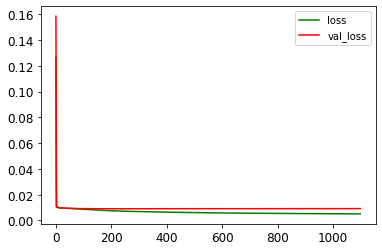

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1100/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0530

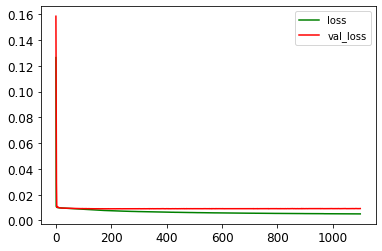

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1101/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

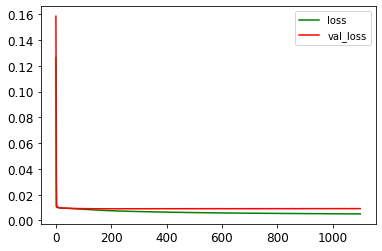

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1102/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0529

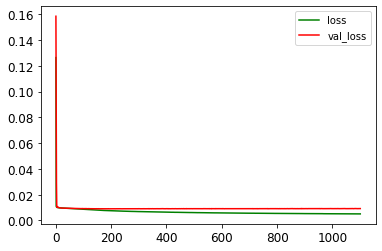

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1103/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0529

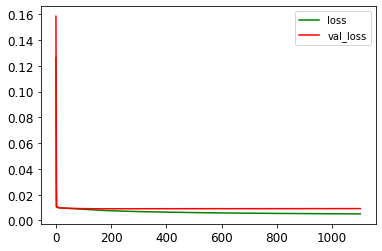

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1104/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

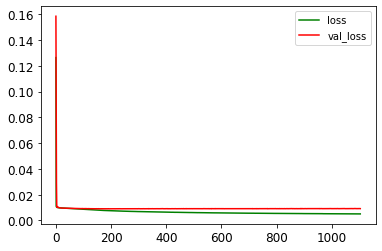

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1105/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0529

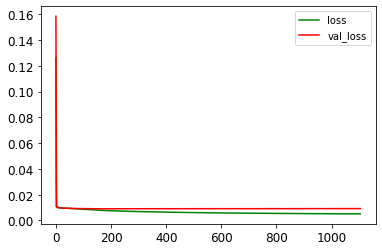

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1106/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

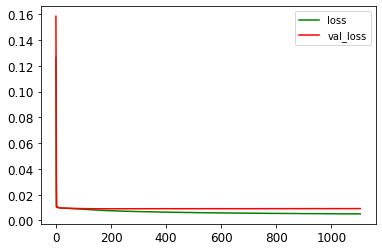

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1107/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

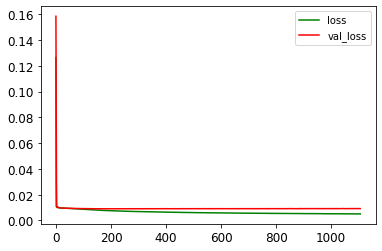

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1108/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

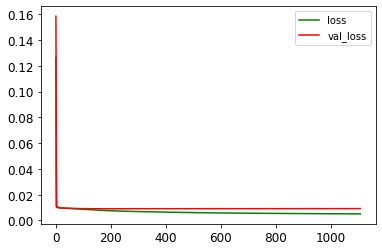

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1109/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0531

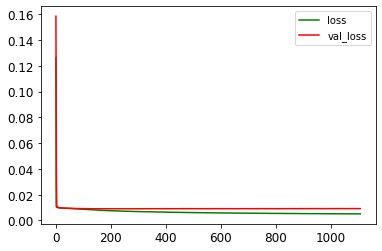

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1110/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0051 - mae: 0.0530

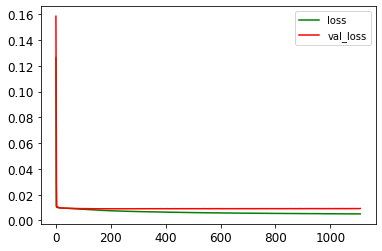

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1111/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0529

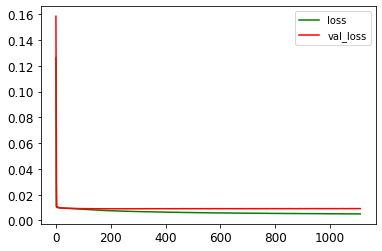

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 1112/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

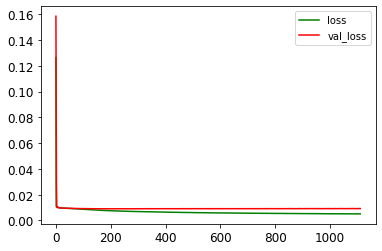

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0531 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1113/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

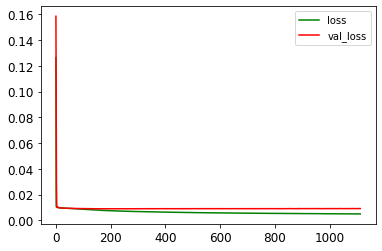

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1114/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

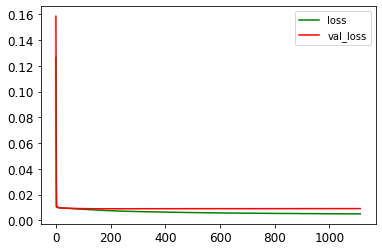

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1115/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0530

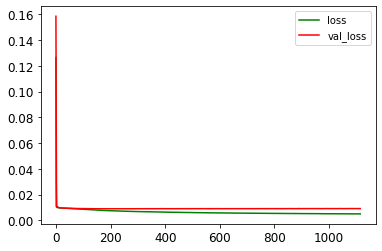

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1116/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0531

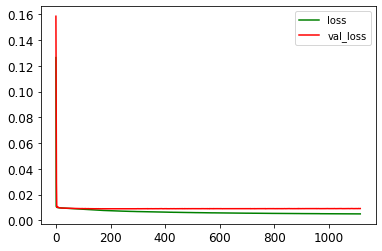

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1117/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0529

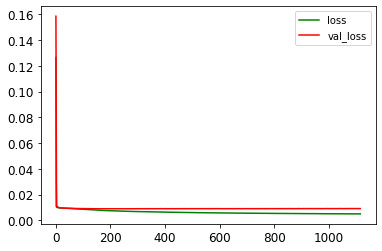

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1118/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

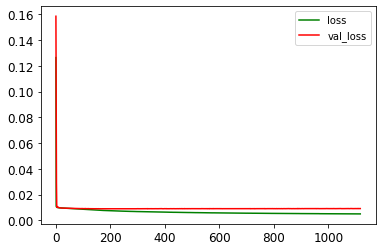

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1119/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

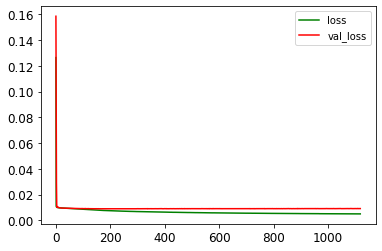

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1120/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

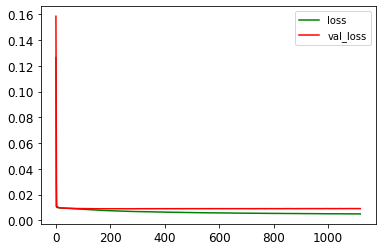

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1121/1500
75/75 [==============================] - ETA: 0s - loss: 0.0051 - mae: 0.0529

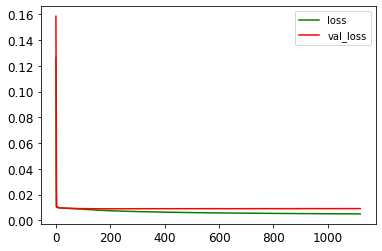

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1122/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0529

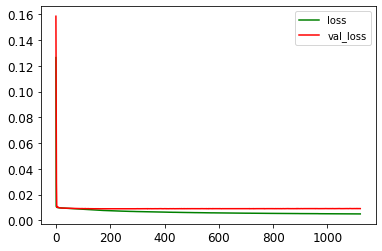

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1123/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

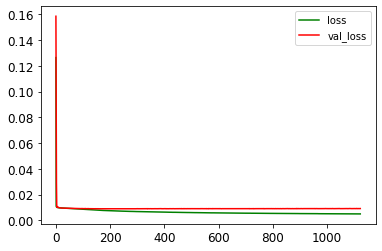

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1124/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

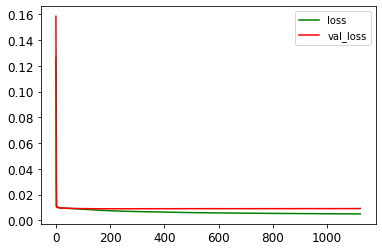

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1125/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

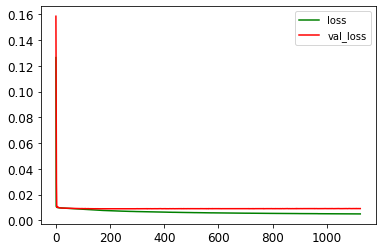

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1126/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

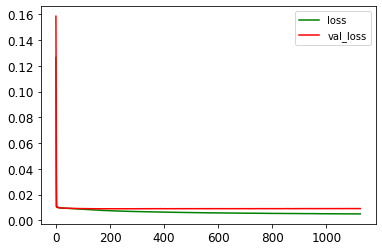

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1127/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0529

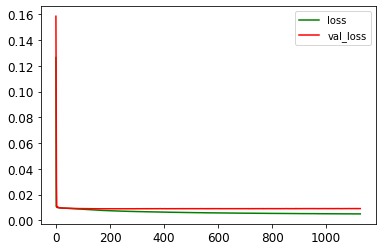

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1128/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

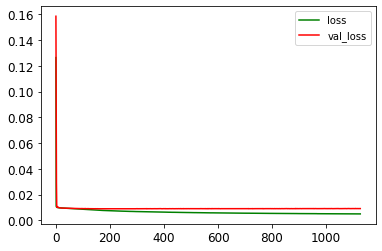

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1129/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

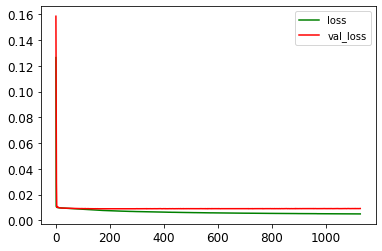

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1130/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

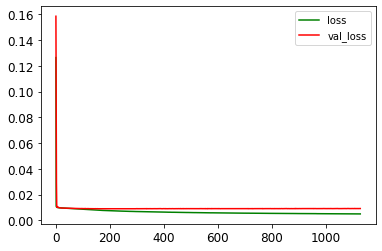

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1131/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

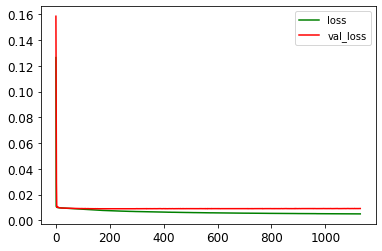

75/75 [==============================] - 1s 10ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1132/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0528

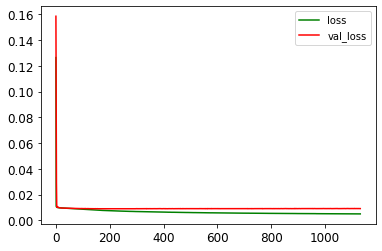

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0697
Epoch 1133/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

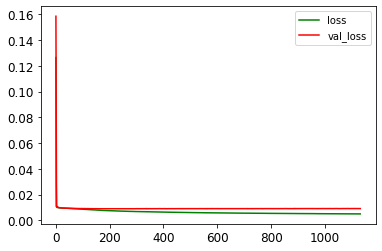

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1134/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

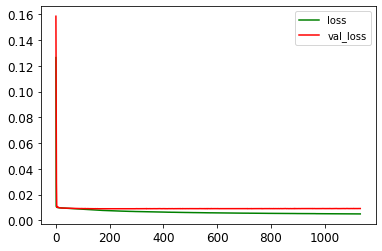

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1135/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

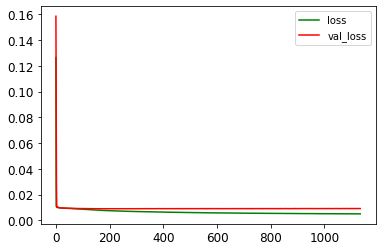

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0530 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1136/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

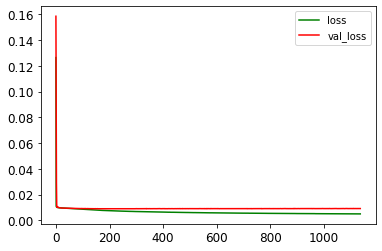

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1137/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

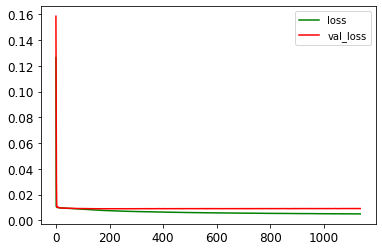

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1138/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0051 - mae: 0.0530

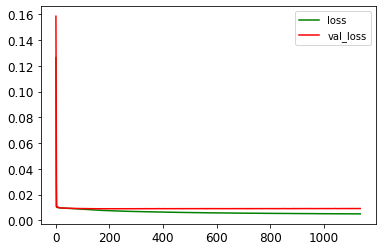

75/75 [==============================] - 1s 7ms/step - loss: 0.0051 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1139/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

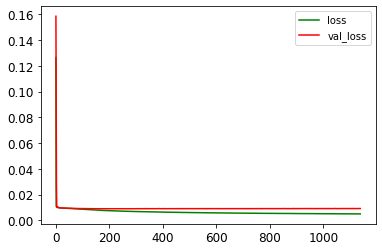

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1140/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

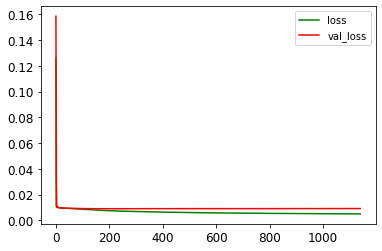

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0091 - val_mae: 0.0697
Epoch 1141/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

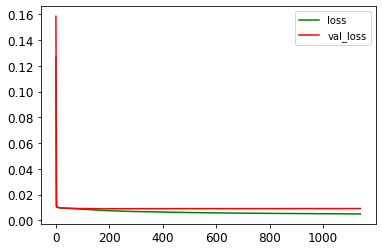

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1142/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

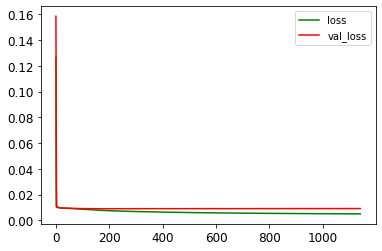

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1143/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0528

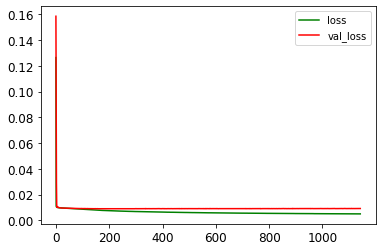

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1144/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

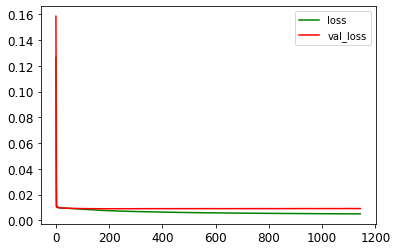

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0529 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1145/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0527

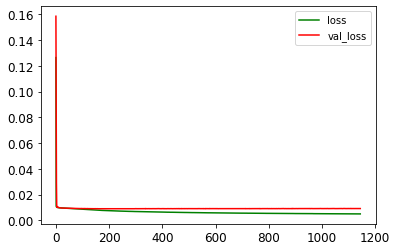

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1146/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

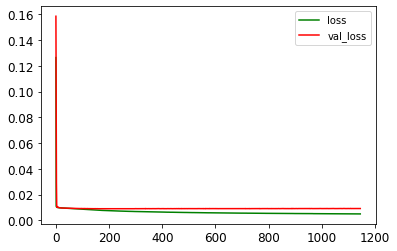

75/75 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1147/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0528

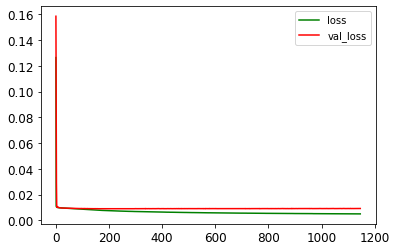

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1148/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

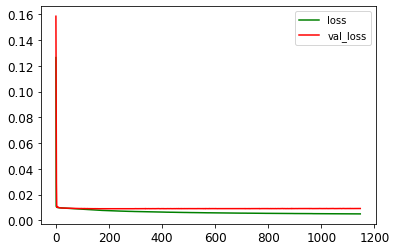

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1149/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

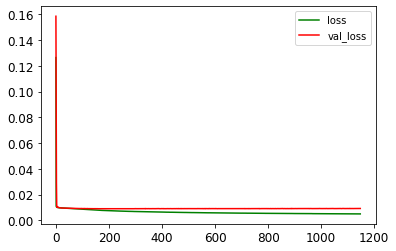

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1150/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

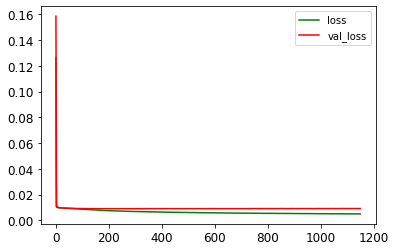

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1151/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0527

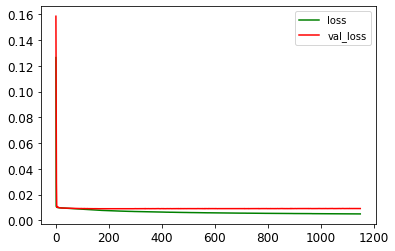

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1152/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

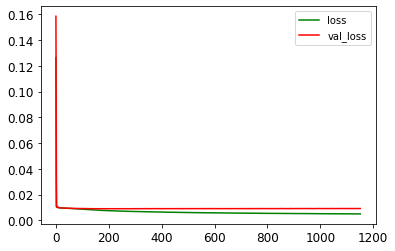

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1153/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0527

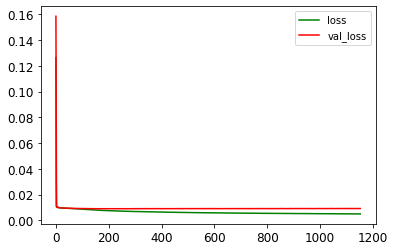

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1154/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

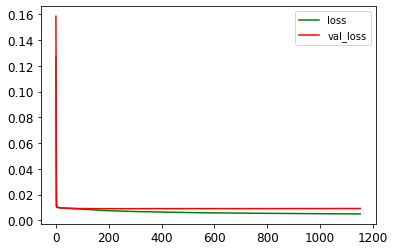

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1155/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

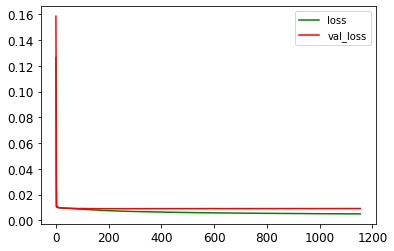

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1156/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0528

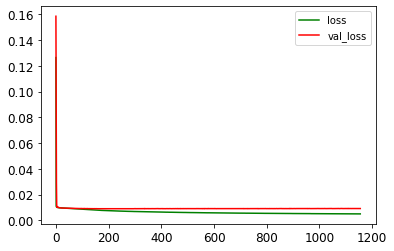

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1157/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

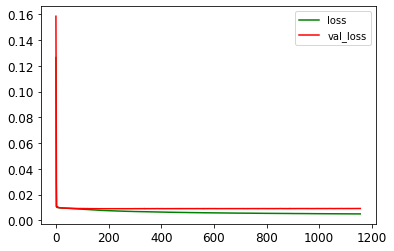

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1158/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

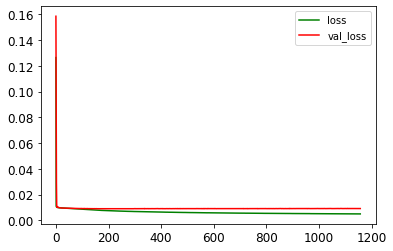

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1159/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0527

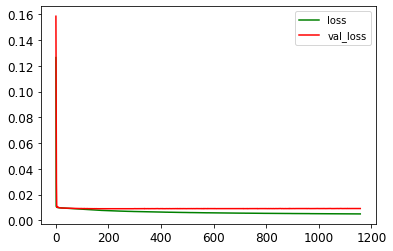

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1160/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0529

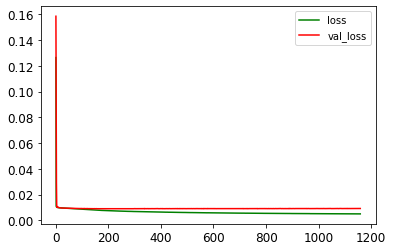

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1161/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0528

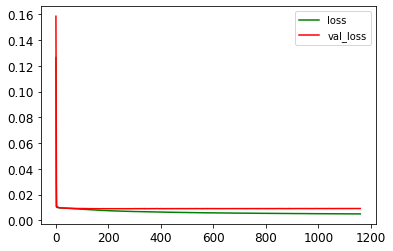

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1162/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

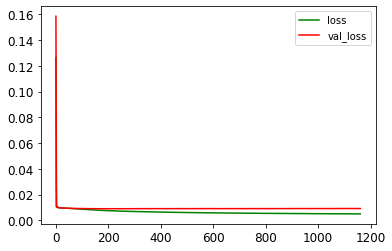

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1163/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

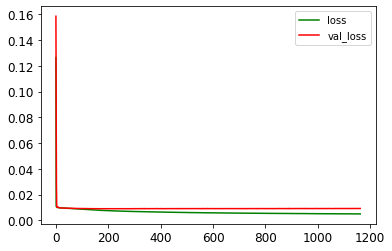

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1164/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0527

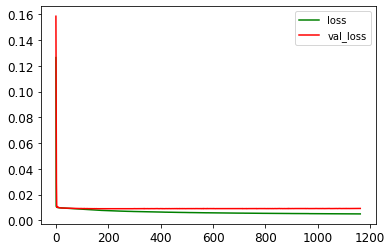

75/75 [==============================] - 1s 10ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1165/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0526

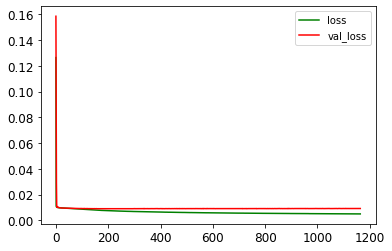

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1166/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

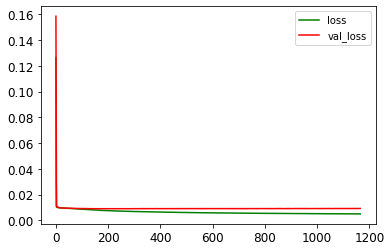

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1167/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

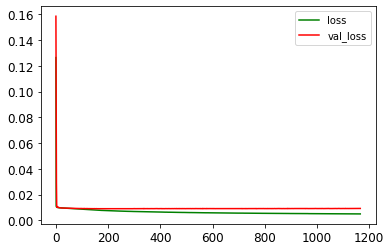

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1168/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

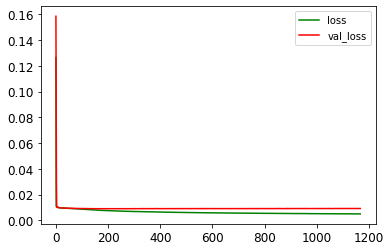

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1169/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

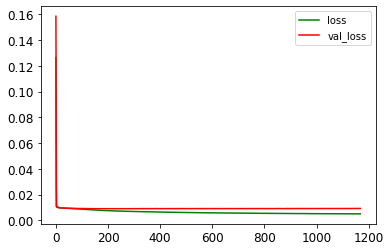

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0528 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1170/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

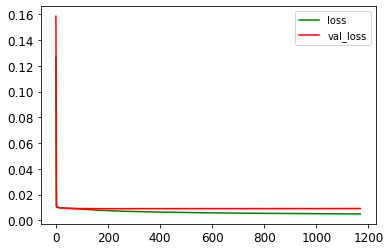

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1171/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

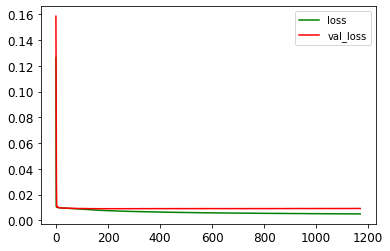

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1172/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

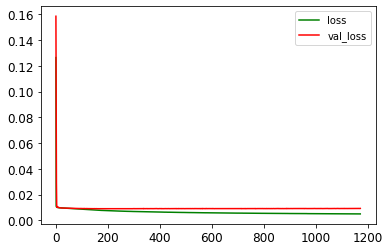

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1173/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0526

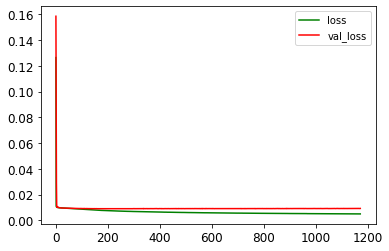

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1174/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0526

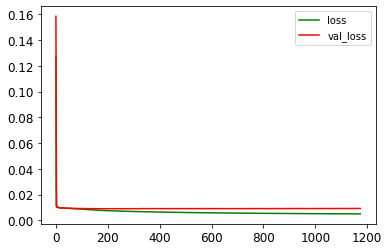

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1175/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

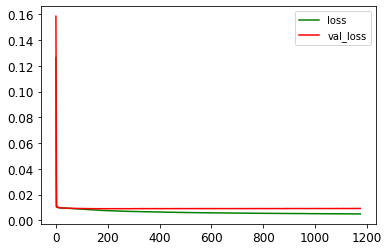

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1176/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

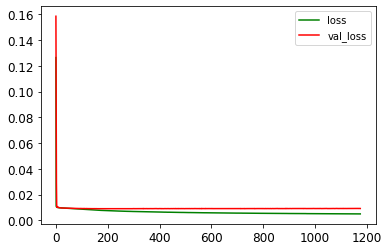

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1177/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

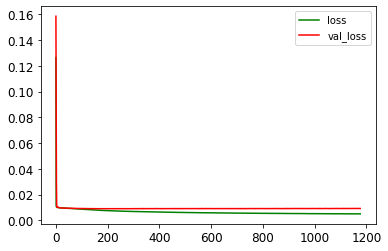

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1178/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

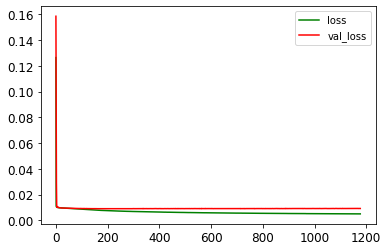

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1179/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

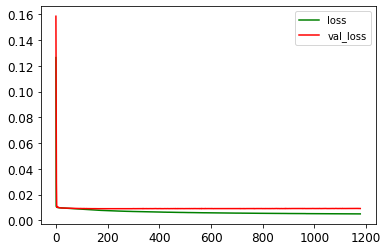

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1180/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0526

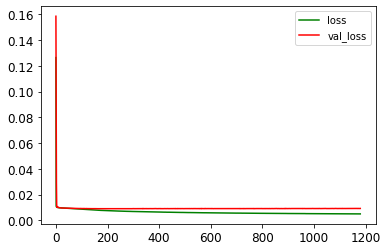

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1181/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

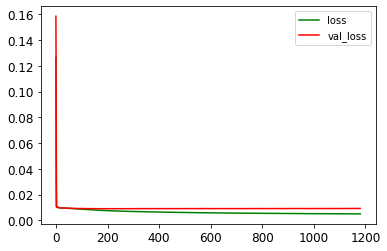

75/75 [==============================] - 0s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1182/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

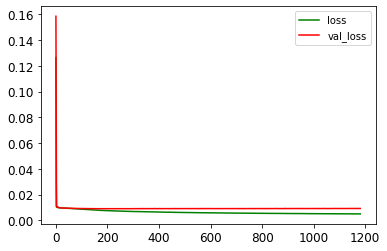

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1183/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

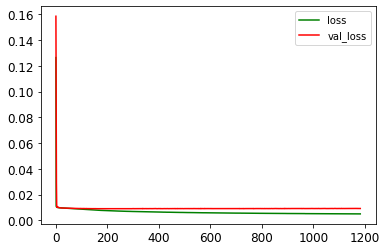

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1184/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

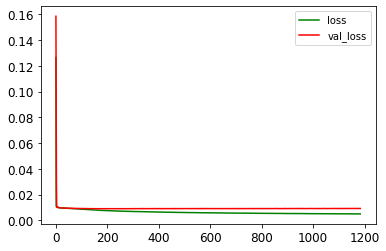

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1185/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

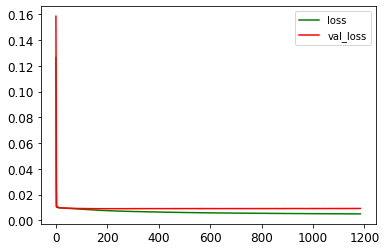

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1186/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

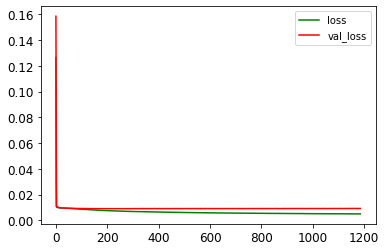

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1187/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

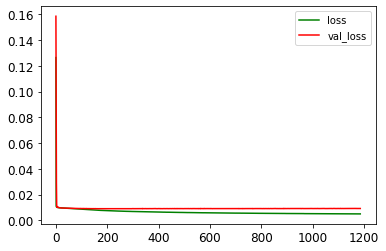

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1188/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0527

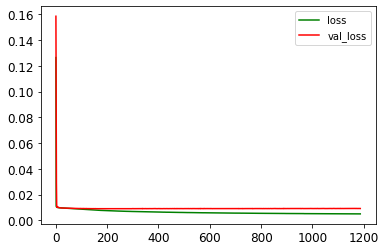

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1189/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

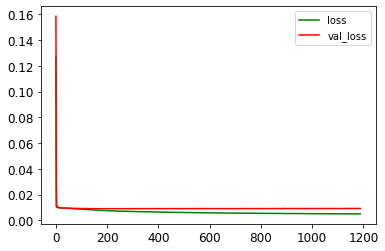

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0527 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1190/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0524

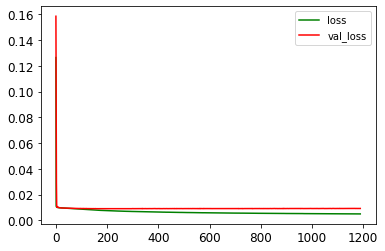

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1191/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

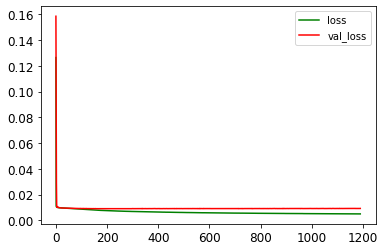

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1192/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

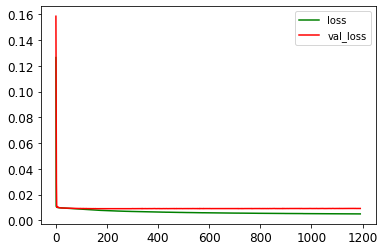

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1193/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0526

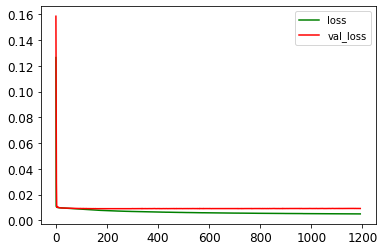

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1194/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

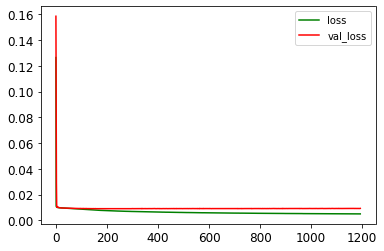

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1195/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

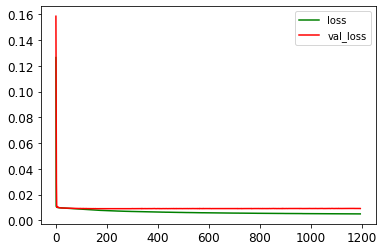

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1196/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0525

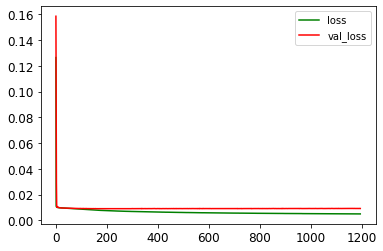

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1197/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

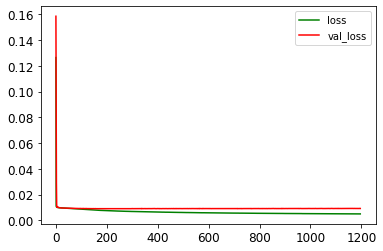

75/75 [==============================] - 1s 10ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1198/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

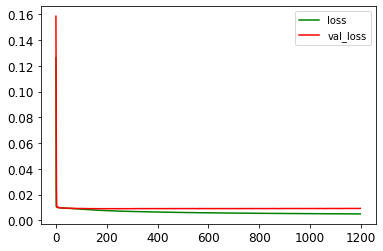

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1199/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

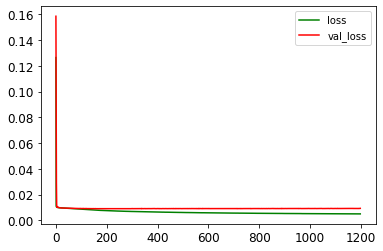

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1200/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

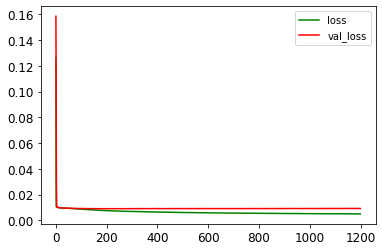

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1201/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

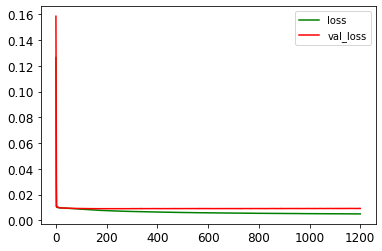

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1202/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

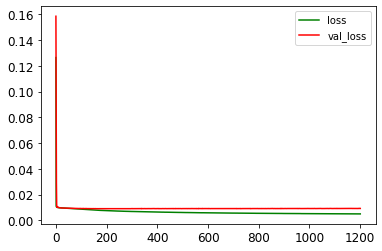

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1203/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

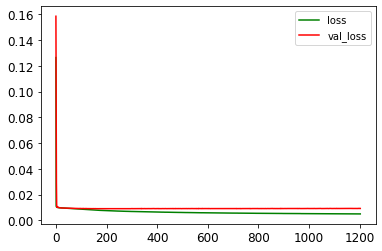

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1204/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

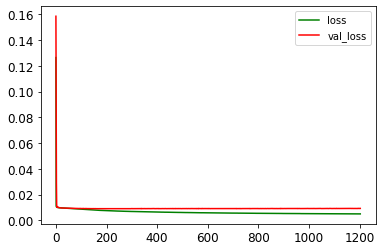

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1205/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0050 - mae: 0.0526

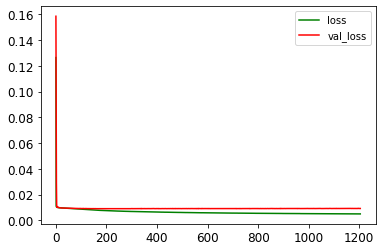

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1206/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

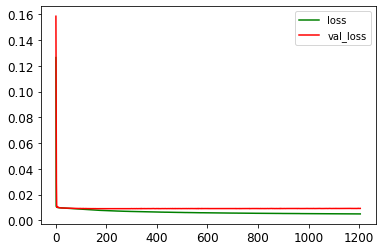

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1207/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0524

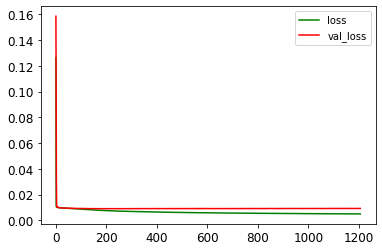

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1208/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

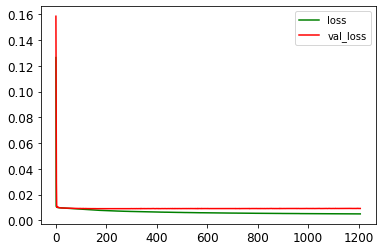

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1209/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

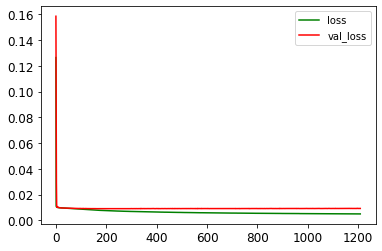

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1210/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

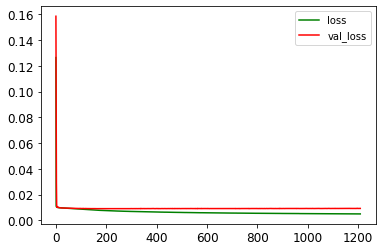

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1211/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0526

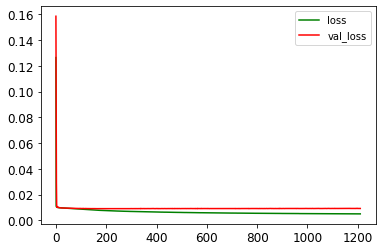

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1212/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0524

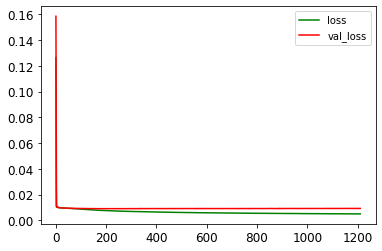

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1213/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0526

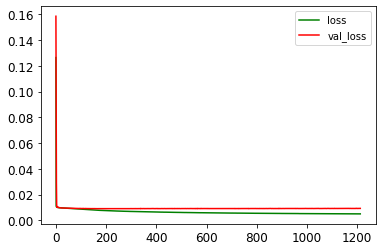

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1214/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

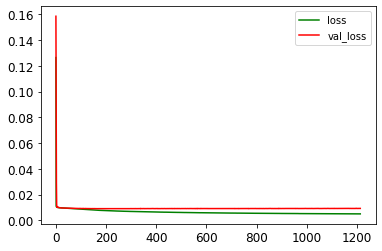

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1215/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

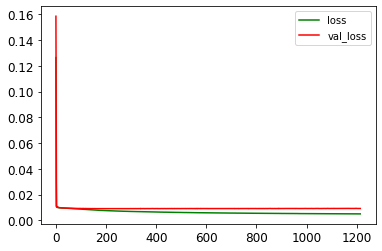

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1216/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

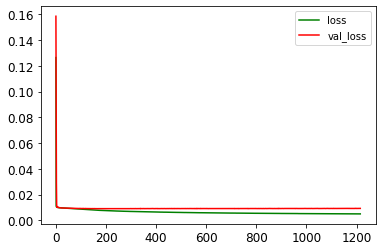

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1217/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0527

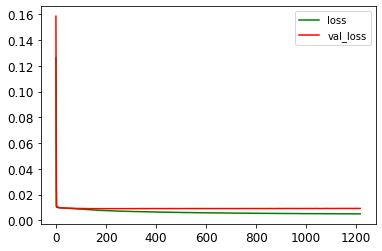

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0526 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1218/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

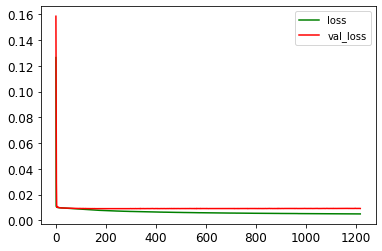

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1219/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0524

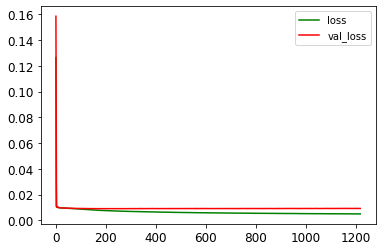

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1220/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

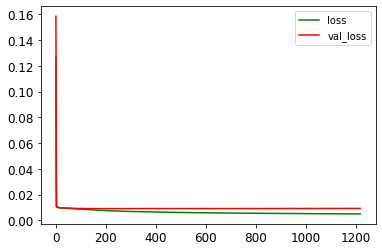

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1221/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0524

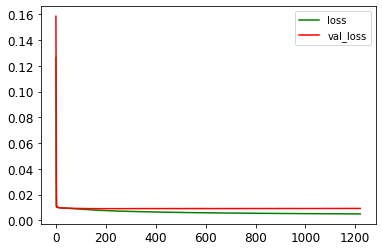

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1222/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0050 - mae: 0.0525

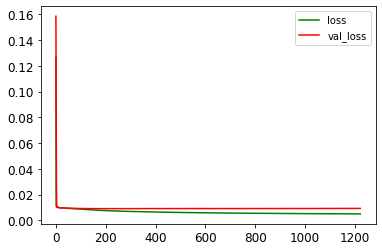

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1223/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

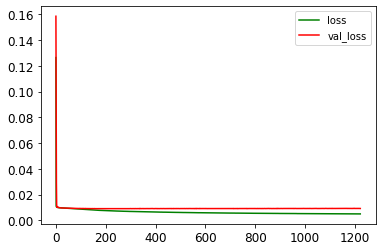

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1224/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0524

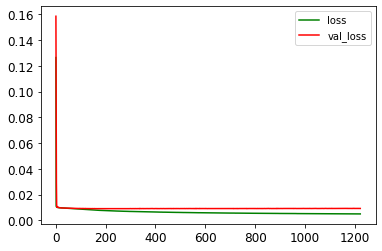

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1225/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

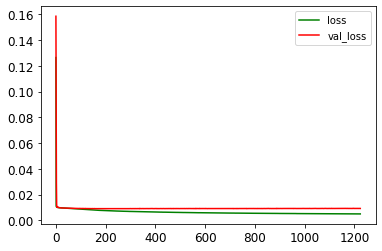

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1226/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

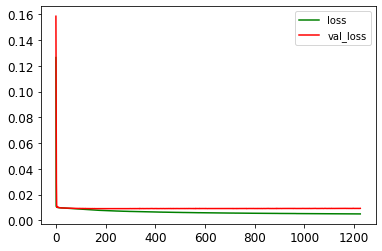

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1227/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

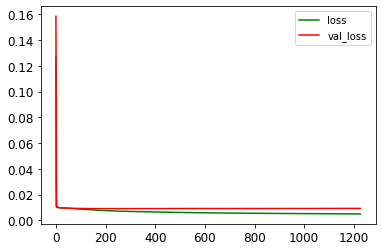

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1228/1500
69/75 [==========================>...] - ETA: 0s - loss: 0.0049 - mae: 0.0523

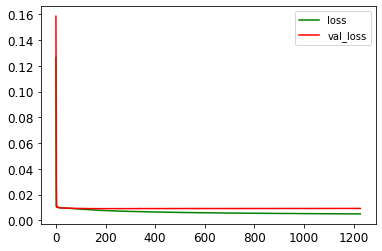

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1229/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

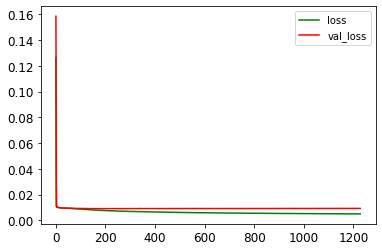

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1230/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

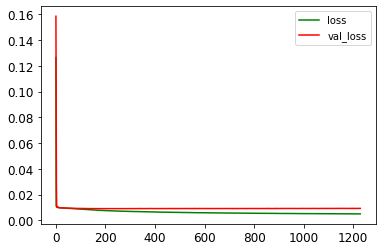

75/75 [==============================] - 1s 10ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1231/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

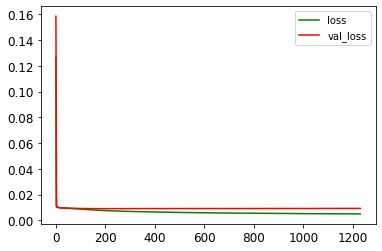

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1232/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0050 - mae: 0.0524

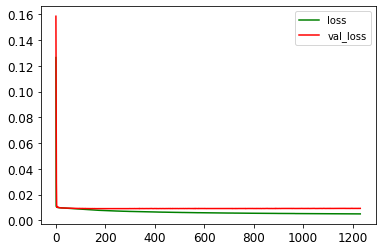

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1233/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

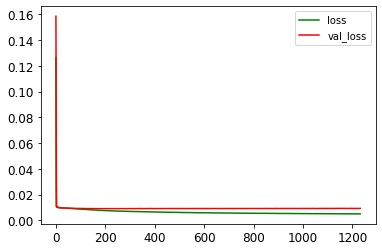

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1234/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

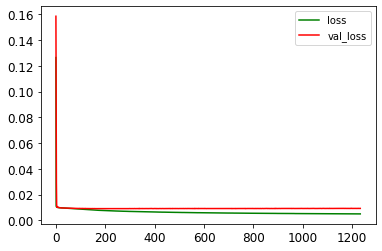

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1235/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0524

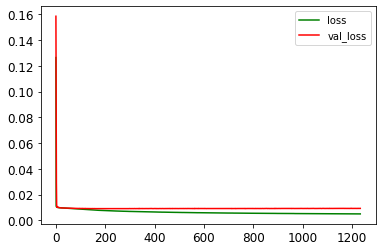

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1236/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

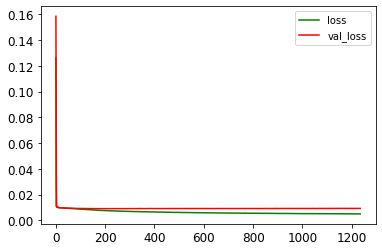

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1237/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

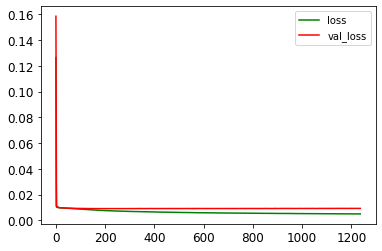

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1238/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

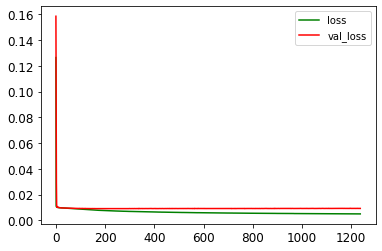

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1239/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

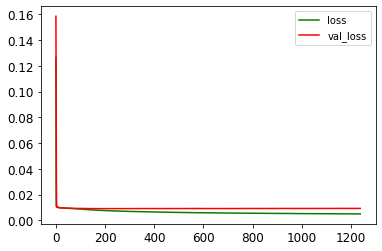

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1240/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

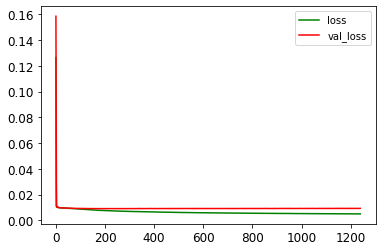

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1241/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0525

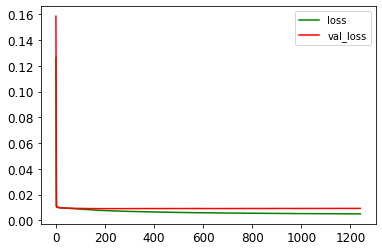

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1242/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0523

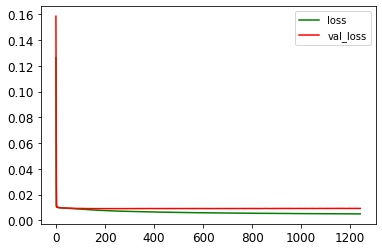

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1243/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0523

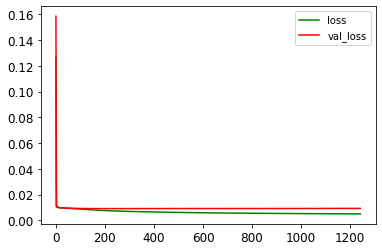

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1244/1500
75/75 [==============================] - ETA: 0s - loss: 0.0050 - mae: 0.0525

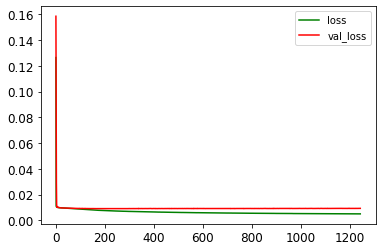

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1245/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

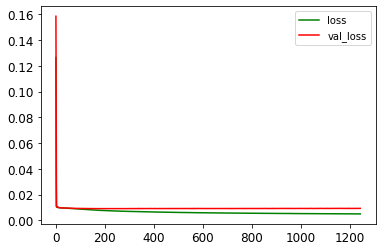

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1246/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0523

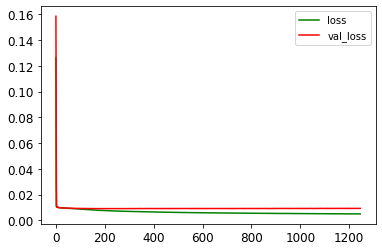

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1247/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0524

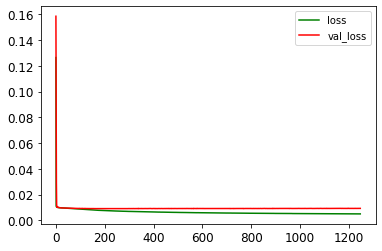

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1248/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0050 - mae: 0.0526

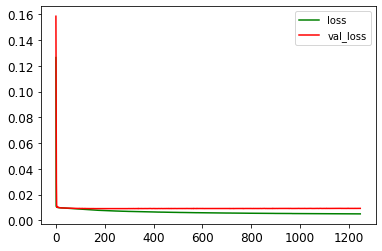

75/75 [==============================] - 1s 7ms/step - loss: 0.0050 - mae: 0.0525 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1249/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0525

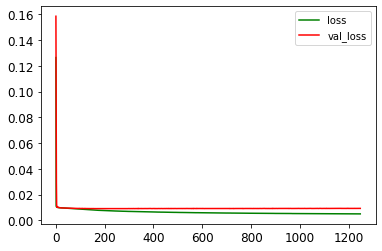

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1250/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

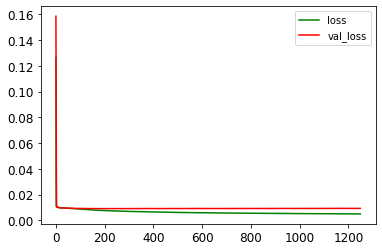

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1251/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0524

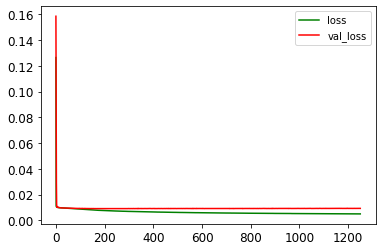

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1252/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

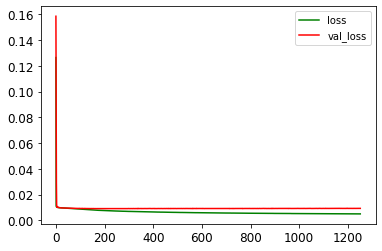

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1253/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

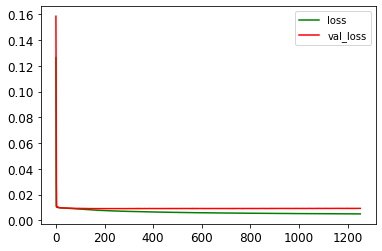

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1254/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

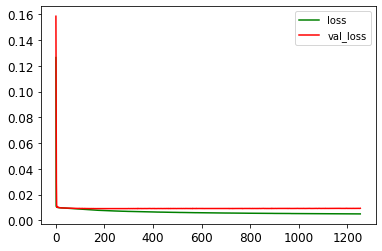

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1255/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

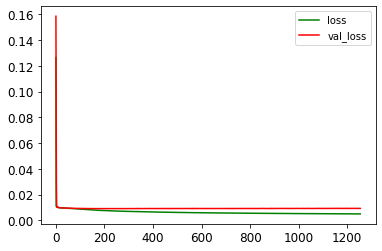

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1256/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0049 - mae: 0.0522

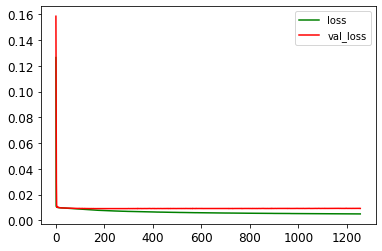

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1257/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0524

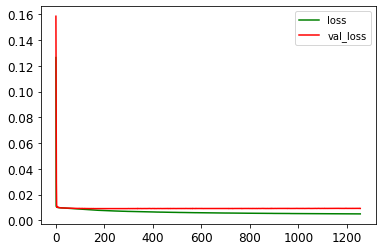

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1258/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

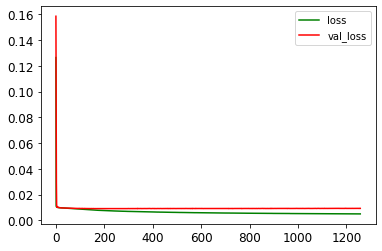

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1259/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

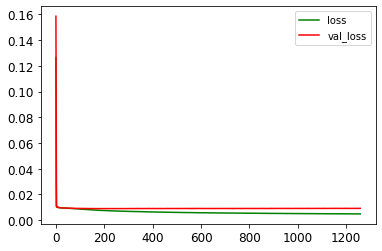

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1260/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

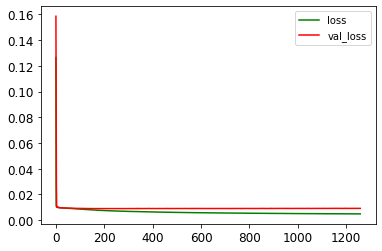

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1261/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

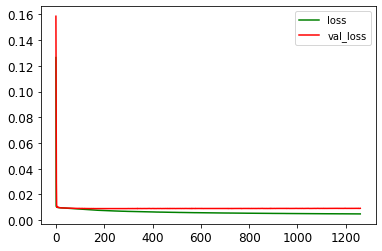

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1262/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0523

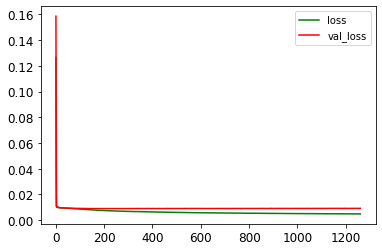

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1263/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0524

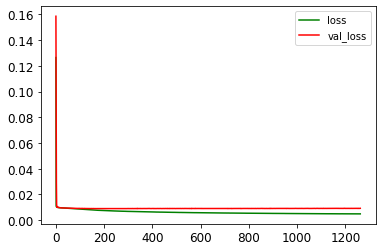

75/75 [==============================] - 1s 10ms/step - loss: 0.0049 - mae: 0.0524 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1264/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

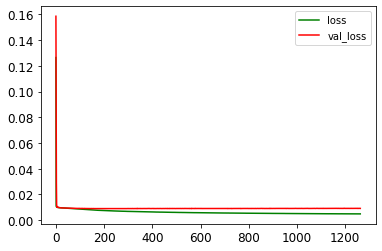

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1265/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

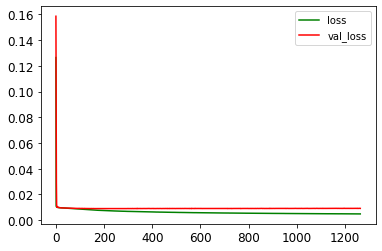

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1266/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

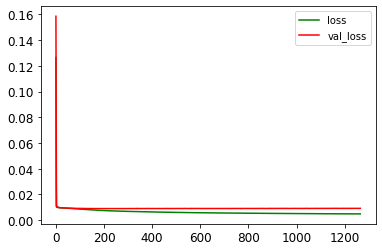

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1267/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

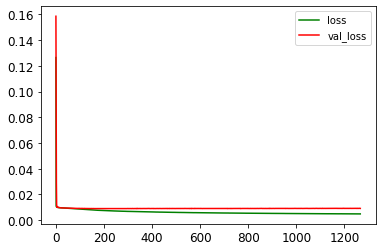

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1268/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

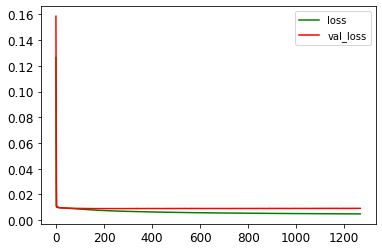

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1269/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

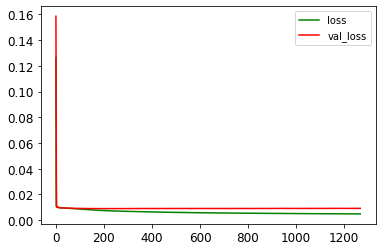

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1270/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0524

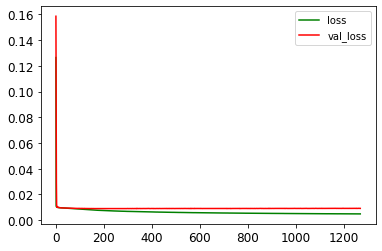

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1271/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0522

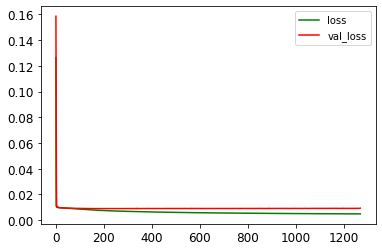

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0094 - val_mae: 0.0705
Epoch 1272/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

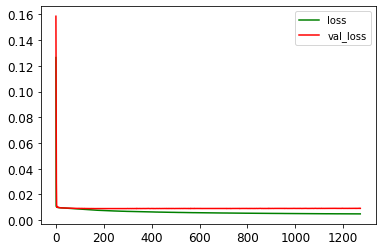

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1273/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

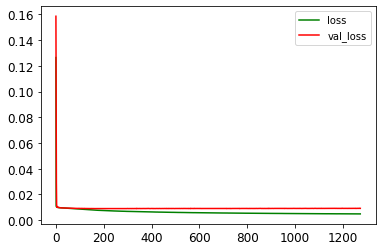

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1274/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

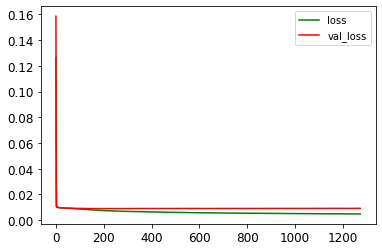

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1275/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

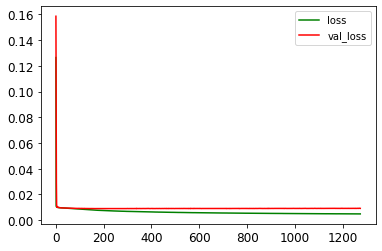

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1276/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0523

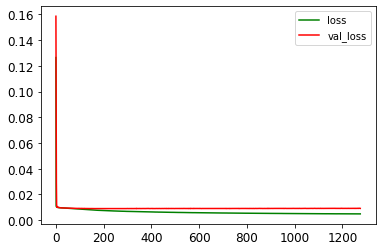

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1277/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

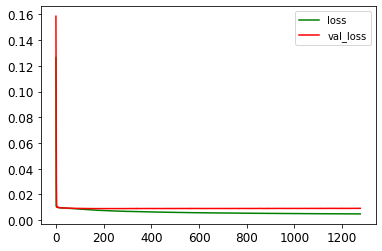

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1278/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

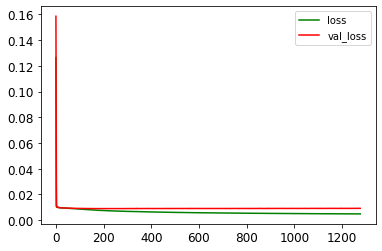

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1279/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

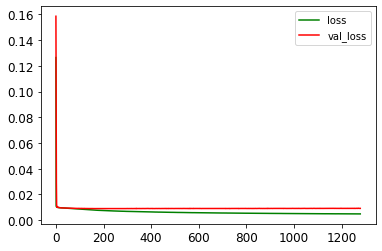

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1280/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

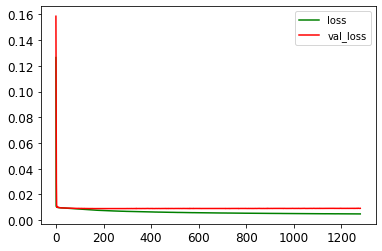

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1281/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

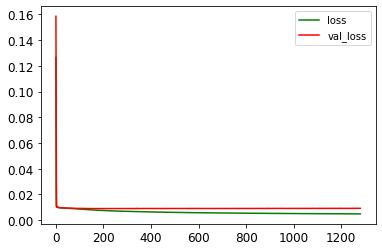

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1282/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

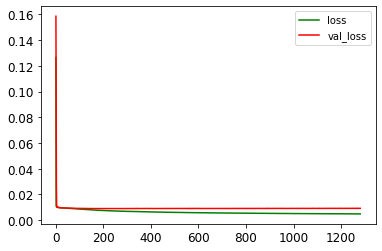

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1283/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

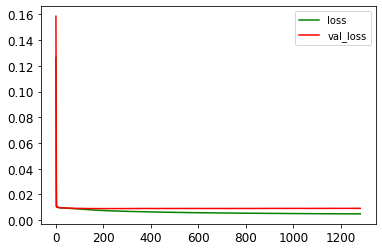

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0523 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1284/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

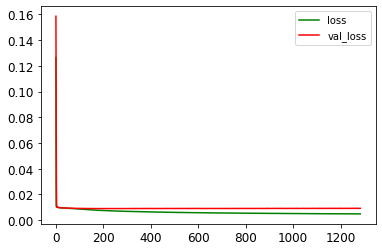

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1285/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

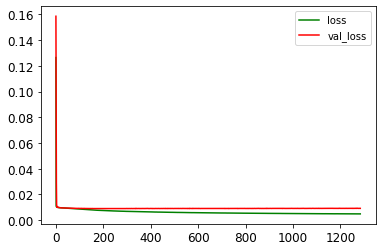

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1286/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

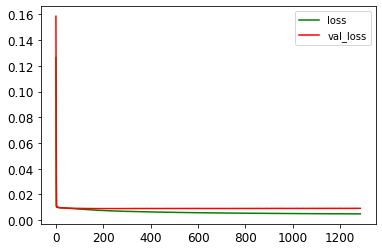

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1287/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

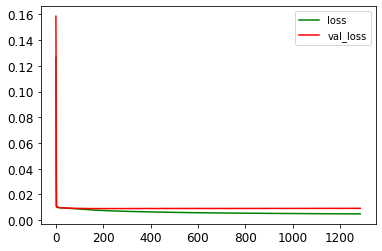

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1288/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

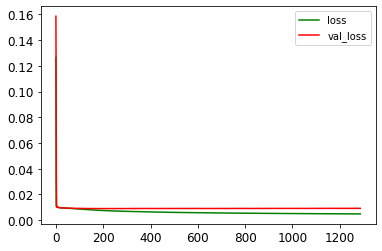

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1289/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

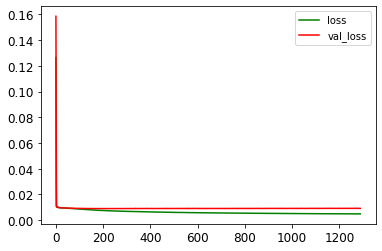

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1290/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0522

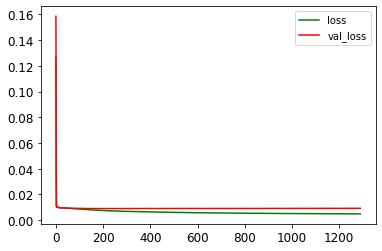

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1291/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

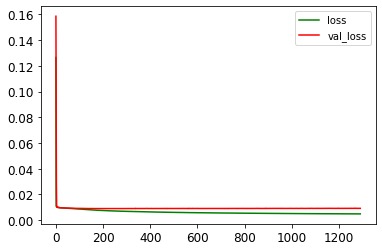

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1292/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0522

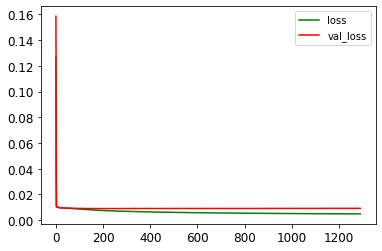

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1293/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0522

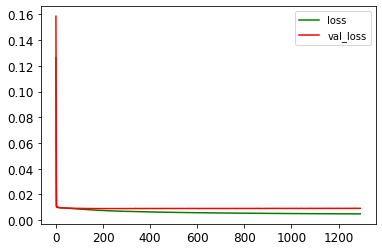

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1294/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

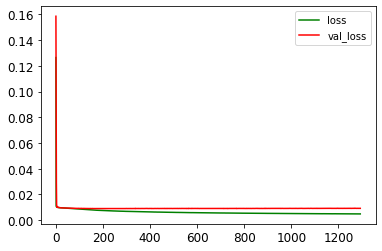

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1295/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

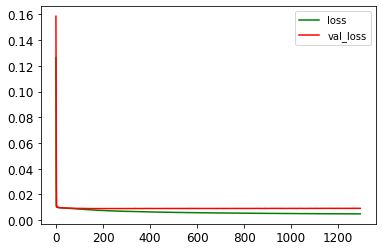

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1296/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

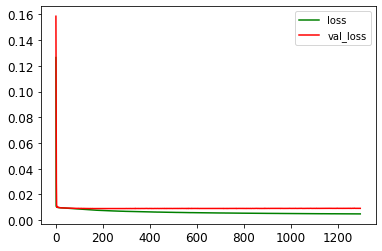

75/75 [==============================] - 1s 10ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1297/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

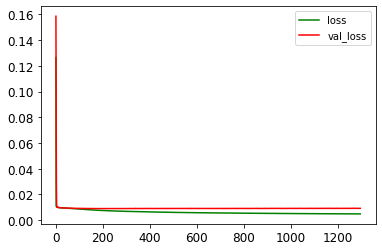

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1298/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

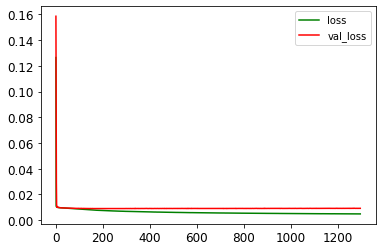

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1299/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

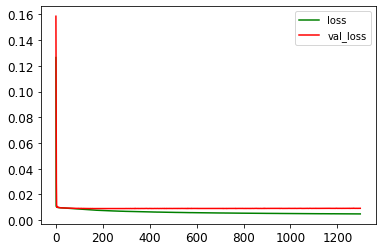

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1300/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

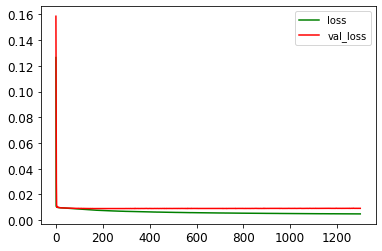

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1301/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

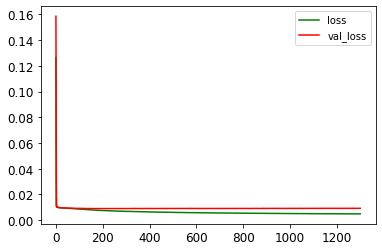

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1302/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0521

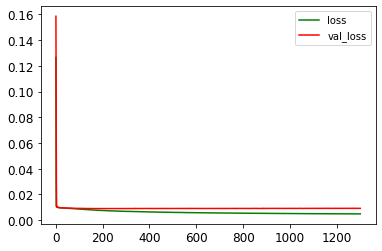

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1303/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

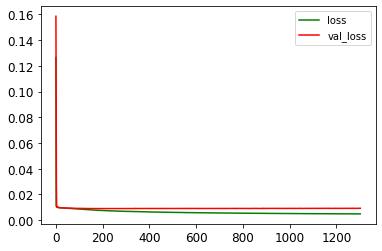

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1304/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0049 - mae: 0.0522

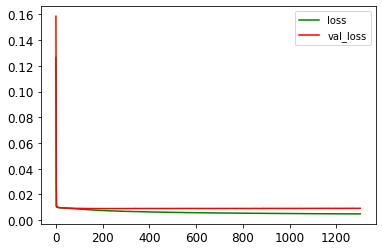

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1305/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

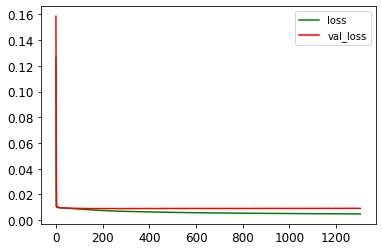

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1306/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0521

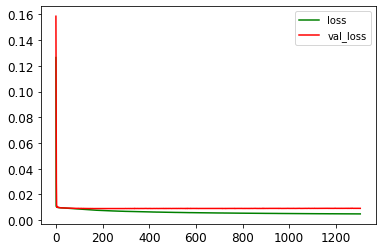

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1307/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

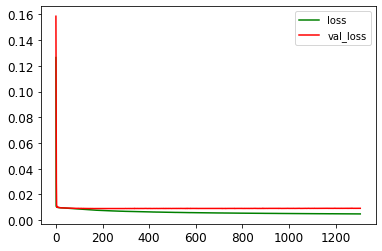

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1308/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

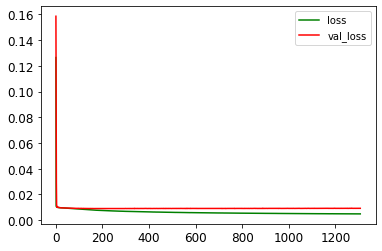

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1309/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

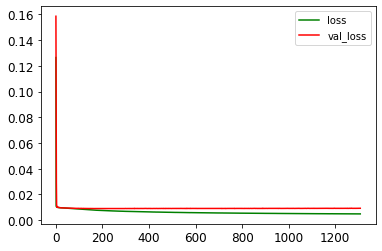

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1310/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

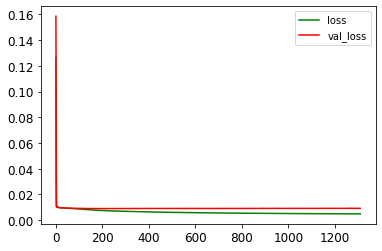

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1311/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

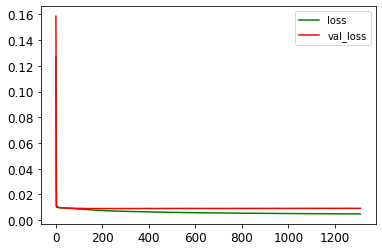

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1312/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

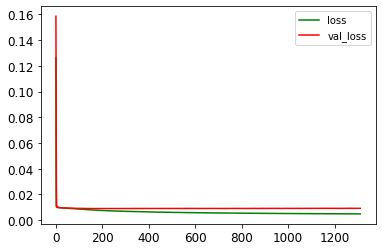

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1313/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0521

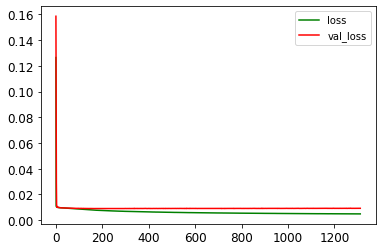

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1314/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

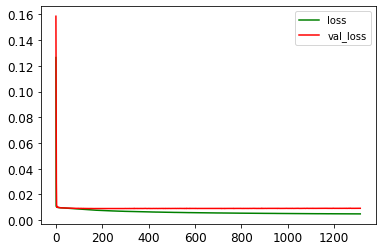

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1315/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0523

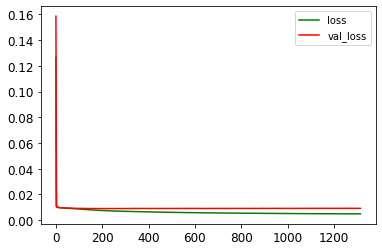

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0522 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1316/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

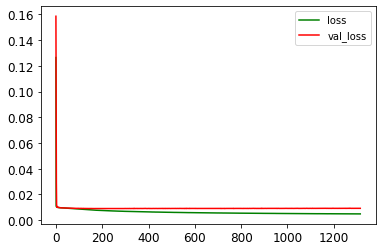

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1317/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0520

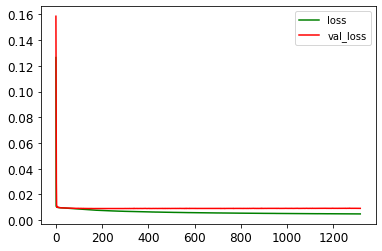

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1318/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0519

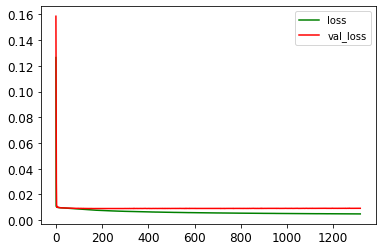

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1319/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

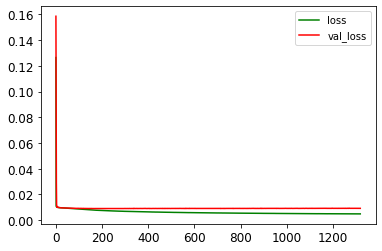

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1320/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

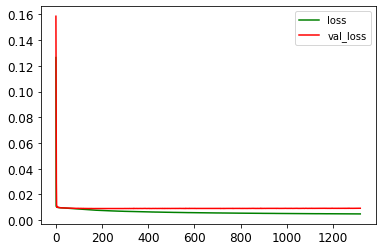

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1321/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

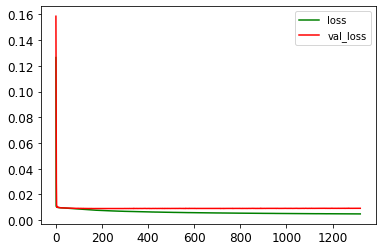

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1322/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

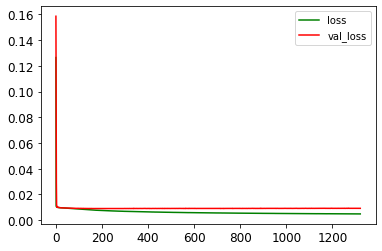

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1323/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

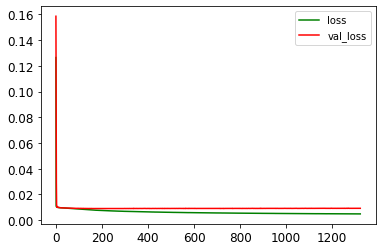

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1324/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

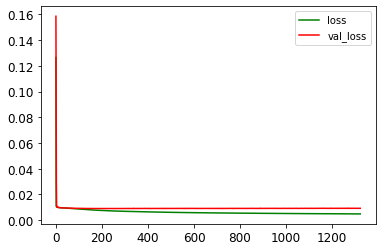

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1325/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

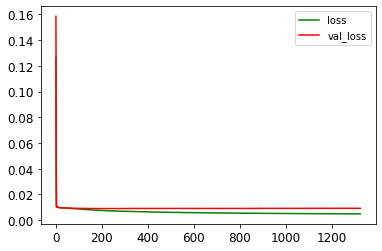

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1326/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0519

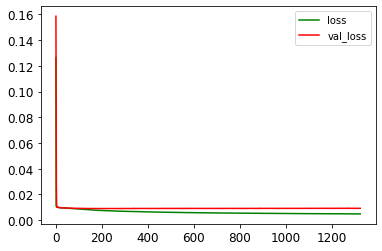

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1327/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

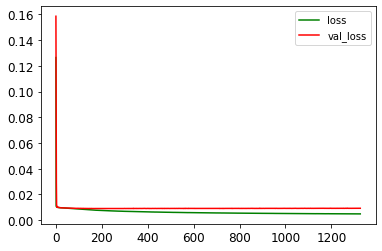

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1328/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0521

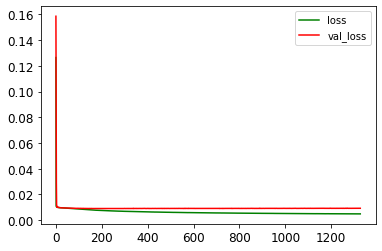

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1329/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

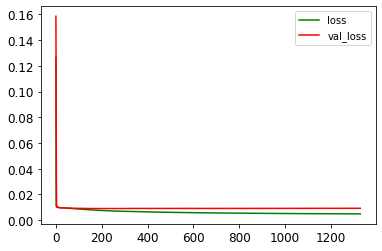

75/75 [==============================] - 1s 10ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1330/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0521

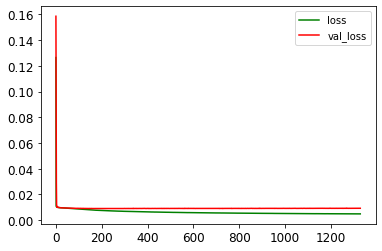

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1331/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

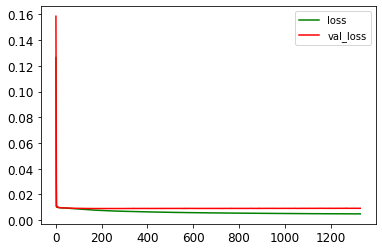

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0521 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1332/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

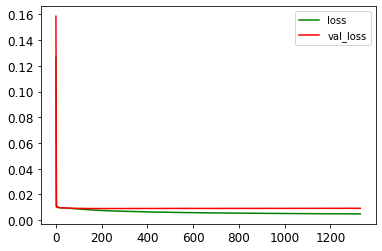

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1333/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

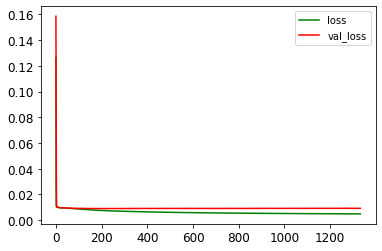

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1334/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

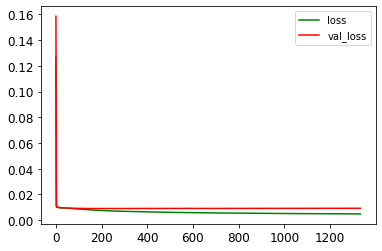

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1335/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

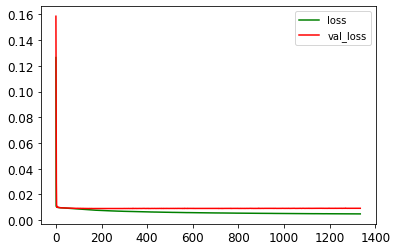

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1336/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

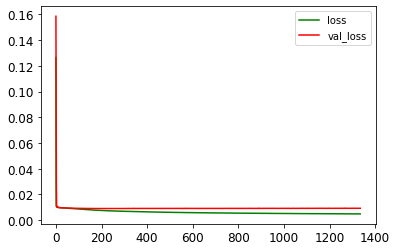

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1337/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0520

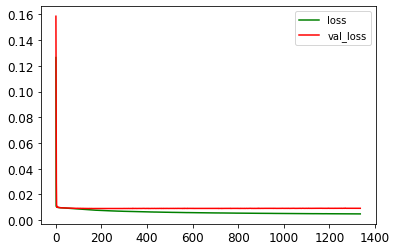

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1338/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

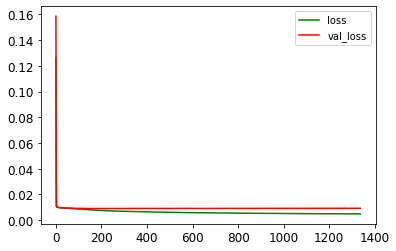

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1339/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

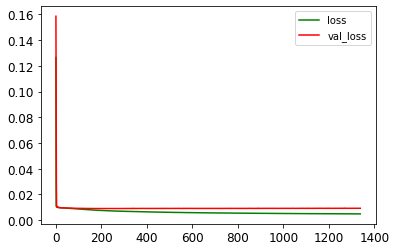

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1340/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0521

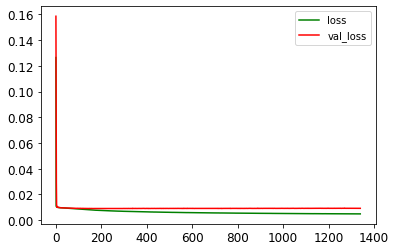

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1341/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

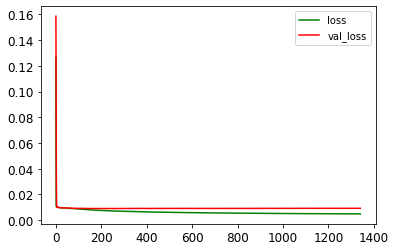

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1342/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

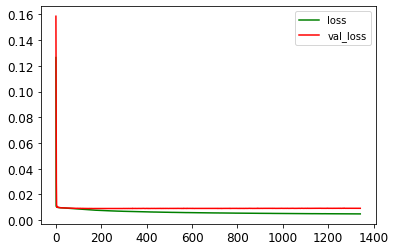

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1343/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

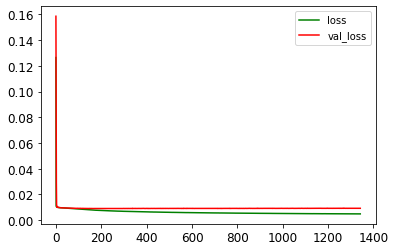

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1344/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

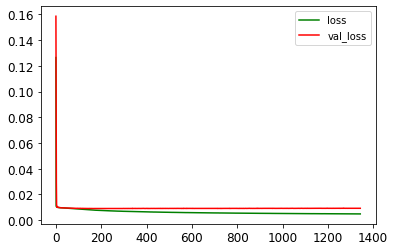

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1345/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

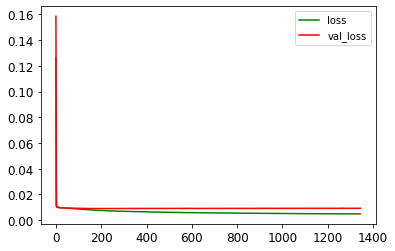

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1346/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0519

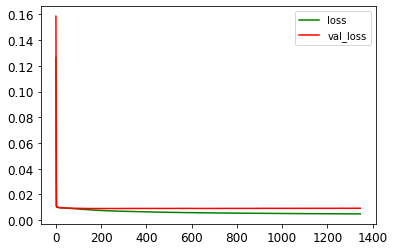

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1347/1500
75/75 [==============================] - ETA: 0s - loss: 0.0049 - mae: 0.0520

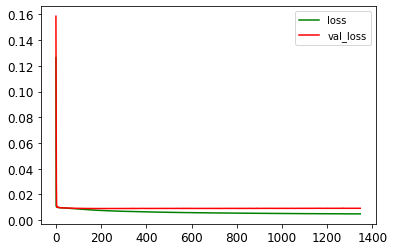

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1348/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0518

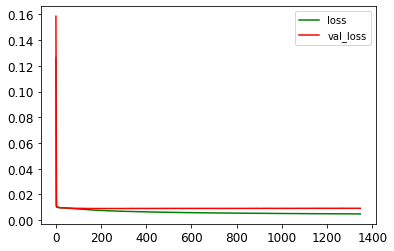

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1349/1500
70/75 [===========================>..] - ETA: 0s - loss: 0.0049 - mae: 0.0520

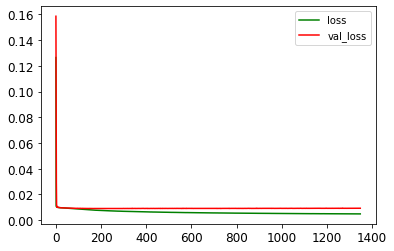

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0702
Epoch 1350/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0519

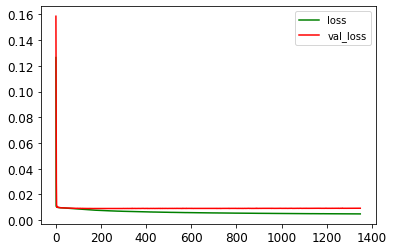

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1351/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0049 - mae: 0.0520

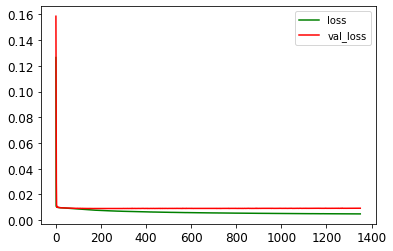

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1352/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0519

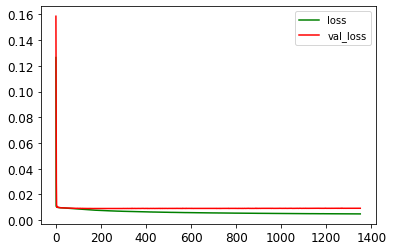

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1353/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0049 - mae: 0.0520

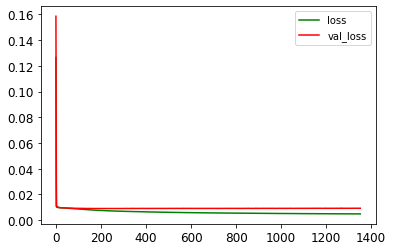

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1354/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

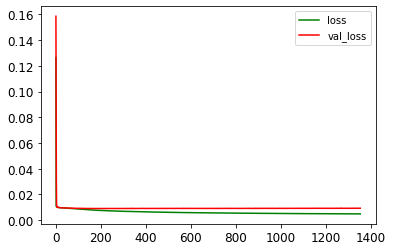

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1355/1500
67/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

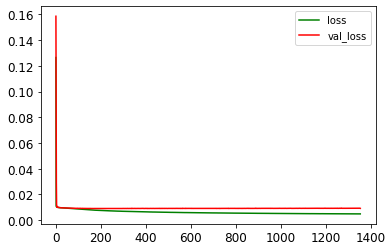

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0698
Epoch 1356/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0519

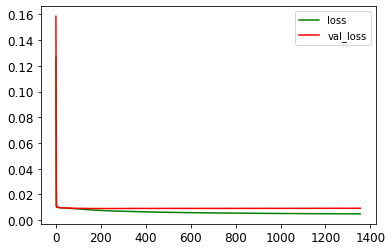

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1357/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

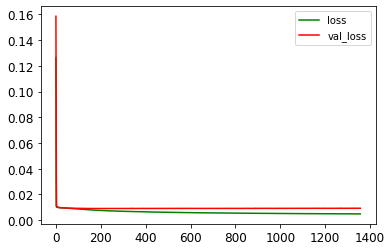

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1358/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

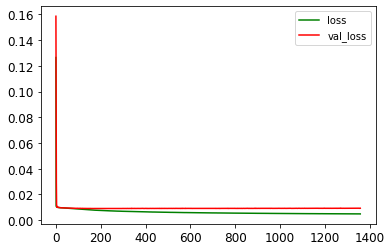

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1359/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0519

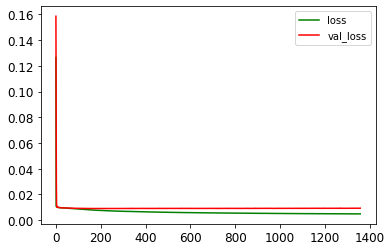

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1360/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

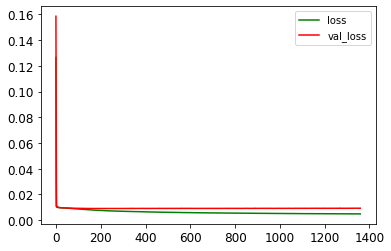

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1361/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

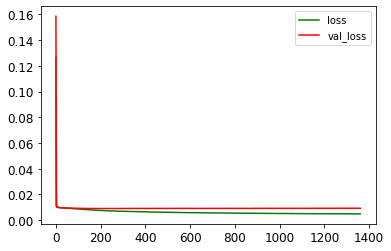

75/75 [==============================] - 1s 10ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1362/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

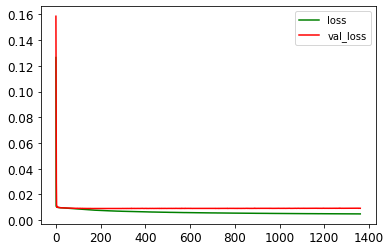

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1363/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

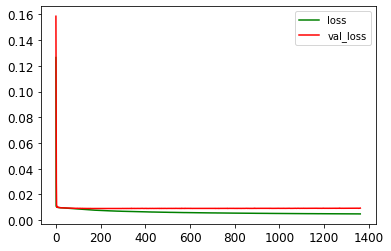

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0704
Epoch 1364/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

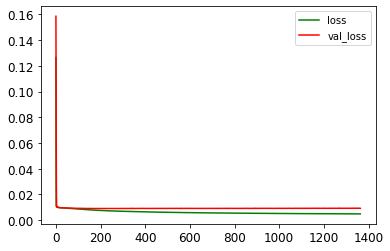

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1365/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

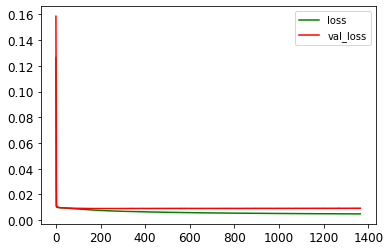

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1366/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0520

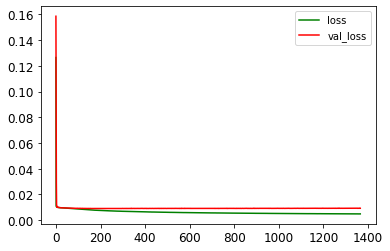

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1367/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

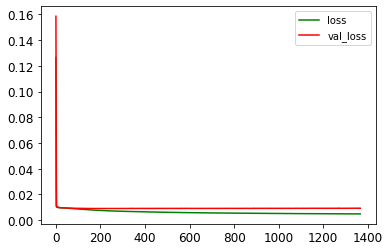

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1368/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

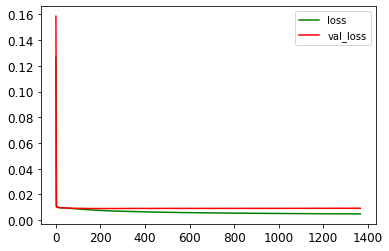

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1369/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

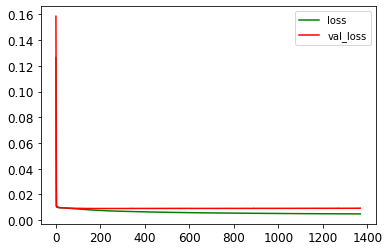

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0093 - val_mae: 0.0704
Epoch 1370/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0520

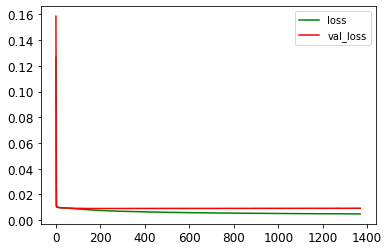

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1371/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

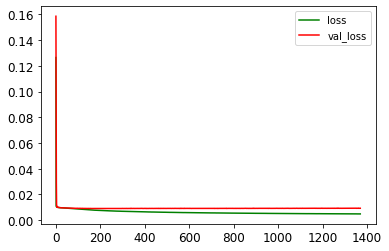

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1372/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

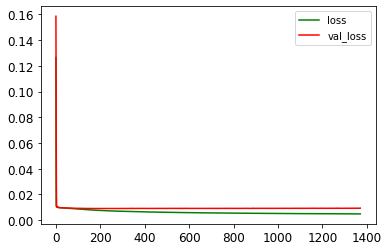

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1373/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0520

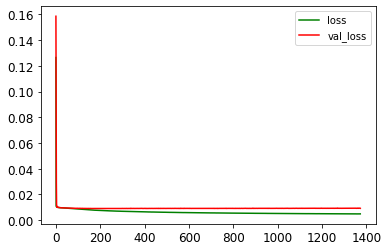

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1374/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

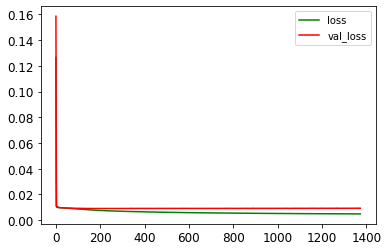

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1375/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

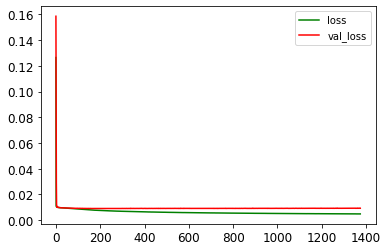

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1376/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

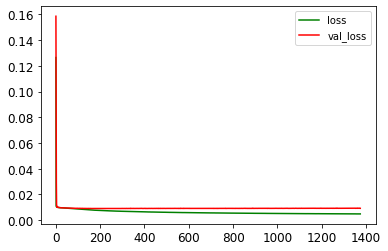

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1377/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

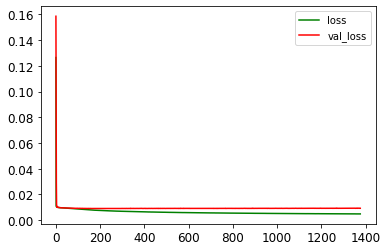

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1378/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

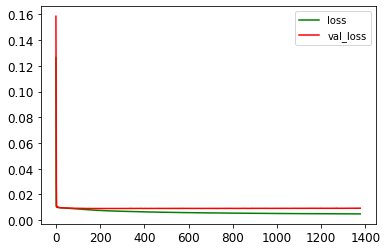

75/75 [==============================] - 1s 7ms/step - loss: 0.0049 - mae: 0.0520 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1379/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

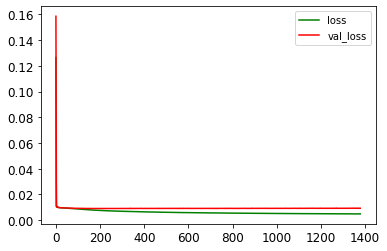

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1380/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

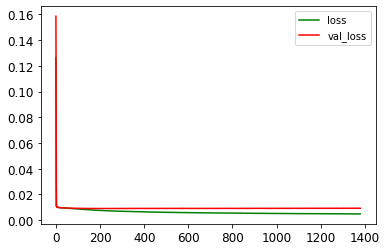

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1381/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

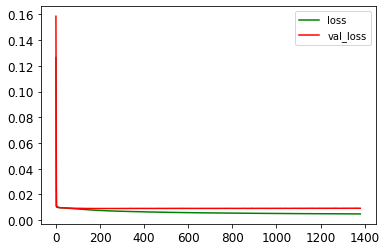

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1382/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

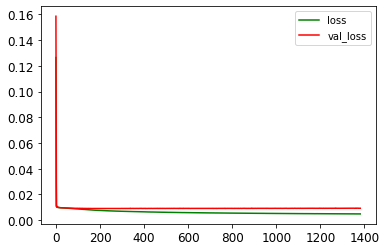

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1383/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

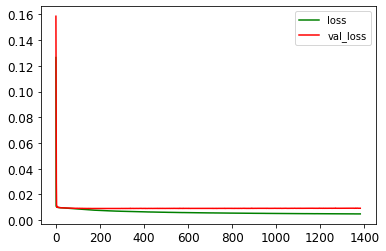

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1384/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

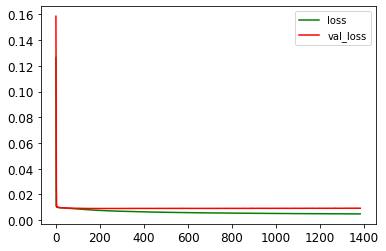

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1385/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

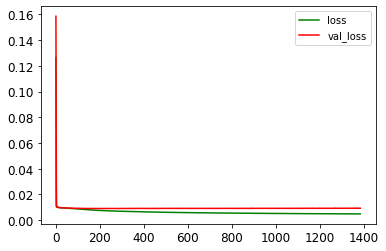

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1386/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0518

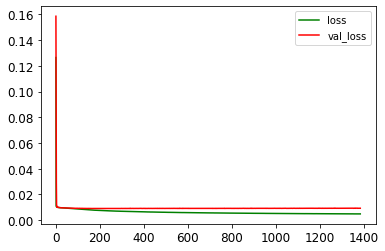

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1387/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

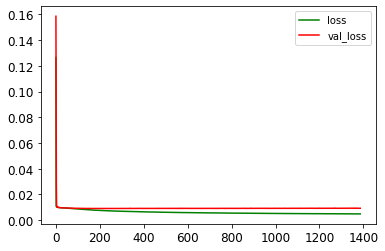

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1388/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

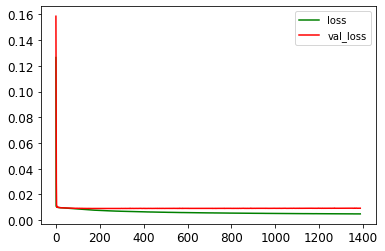

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1389/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

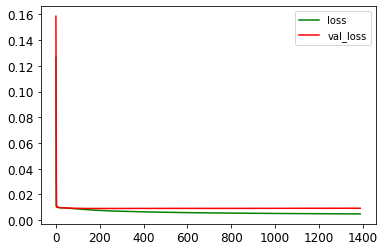

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1390/1500
71/75 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0517

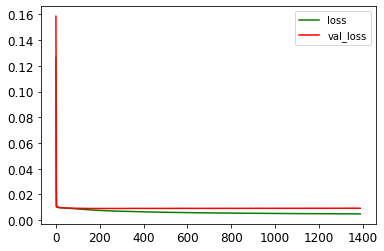

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1391/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0516

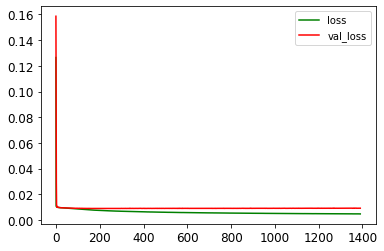

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1392/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

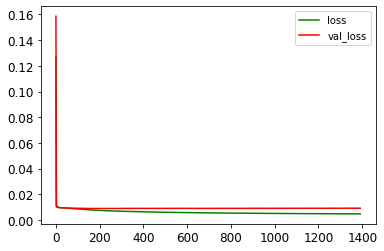

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1393/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0517

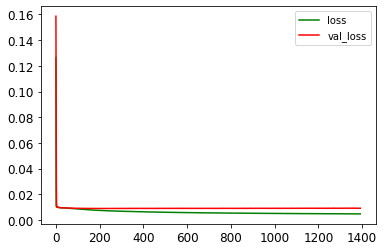

75/75 [==============================] - 1s 10ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1394/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

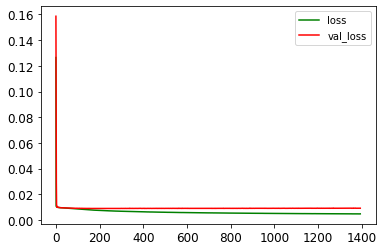

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1395/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0518

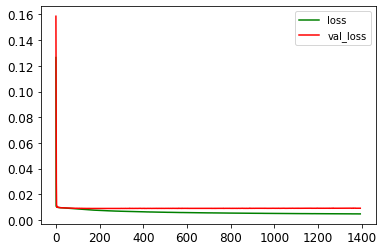

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1396/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

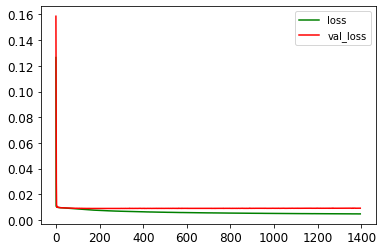

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1397/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

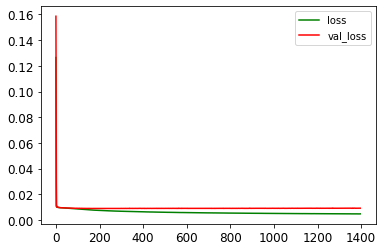

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1398/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

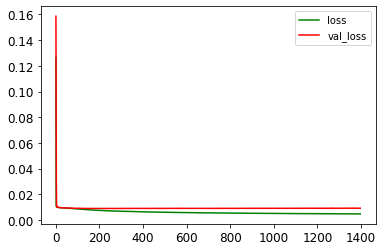

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1399/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0517

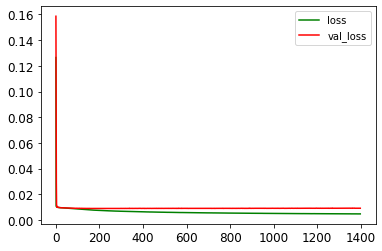

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1400/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

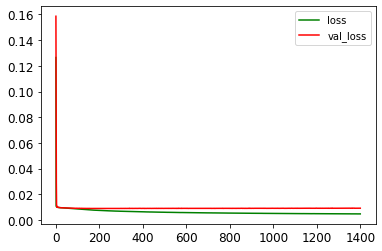

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1401/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

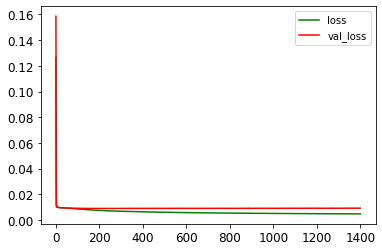

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1402/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

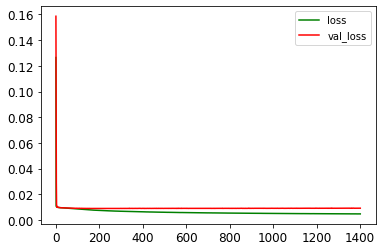

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1403/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

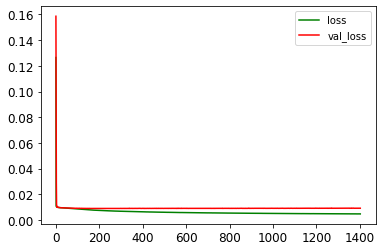

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1404/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

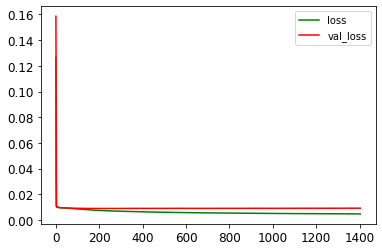

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1405/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

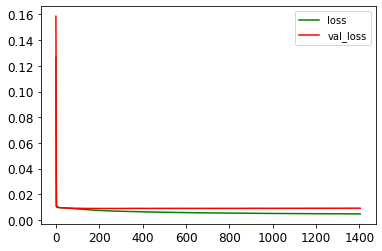

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1406/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

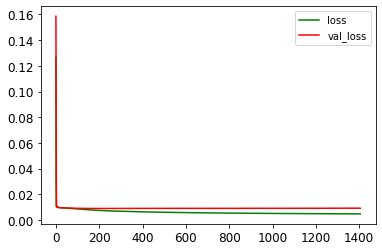

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1407/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

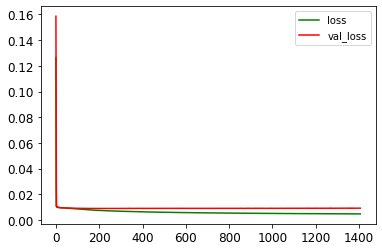

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1408/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0518

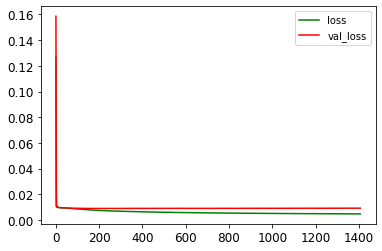

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1409/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0049 - mae: 0.0520

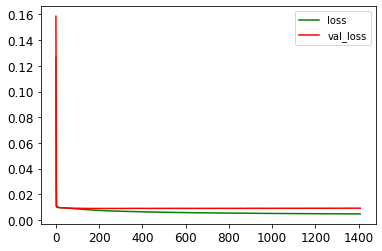

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0519 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1410/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

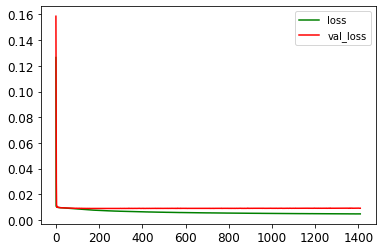

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1411/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

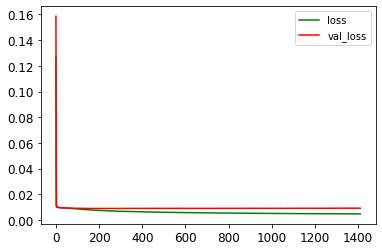

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1412/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

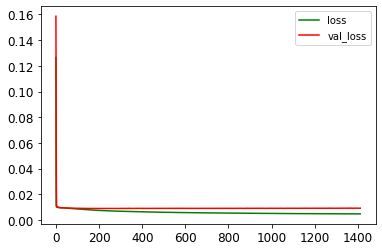

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1413/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

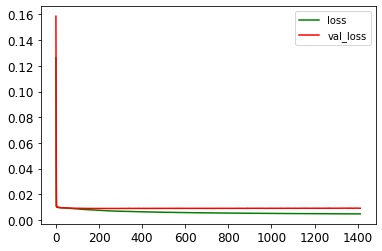

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1414/1500
70/75 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0517

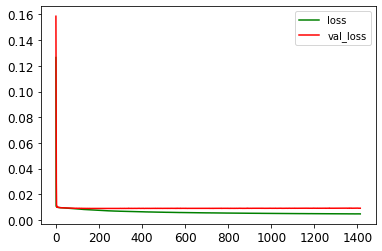

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1415/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

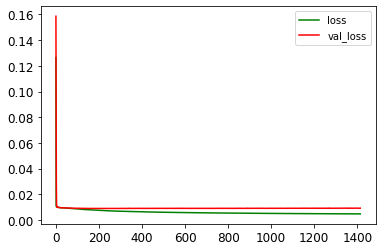

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1416/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0516

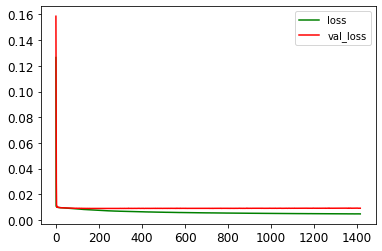

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1417/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

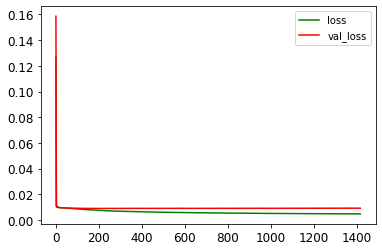

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1418/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

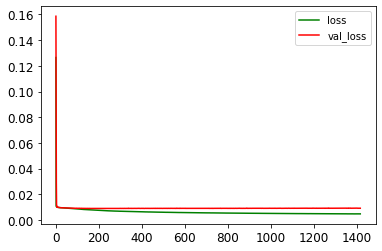

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1419/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

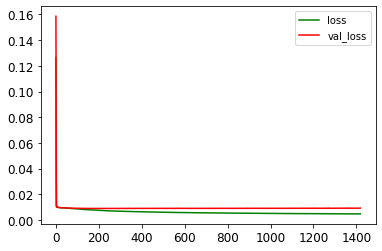

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1420/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

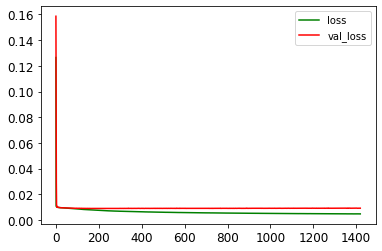

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1421/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

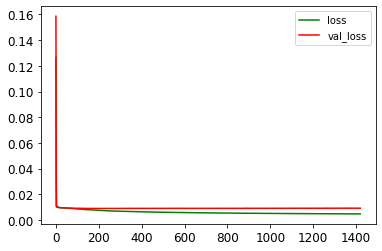

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1422/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0516

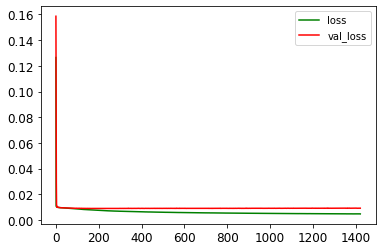

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1423/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

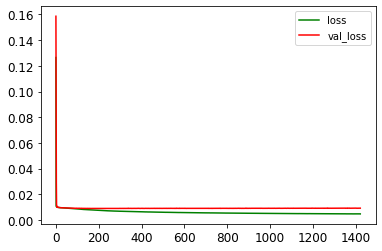

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1424/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0516

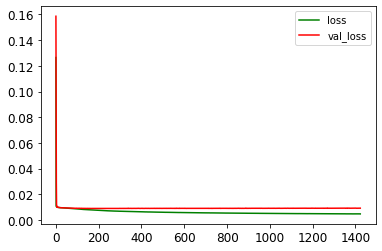

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1425/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0515

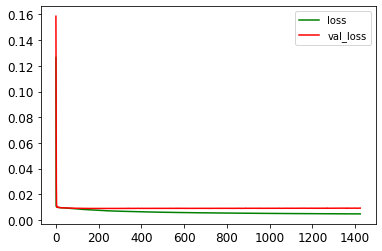

75/75 [==============================] - 1s 10ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1426/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

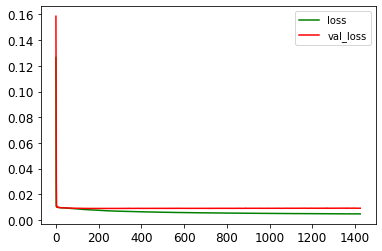

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1427/1500
72/75 [===========================>..] - ETA: 0s - loss: 0.0048 - mae: 0.0516

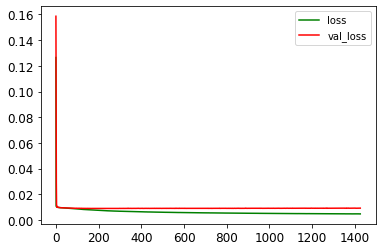

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1428/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0517

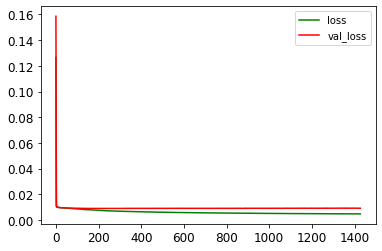

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1429/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0517

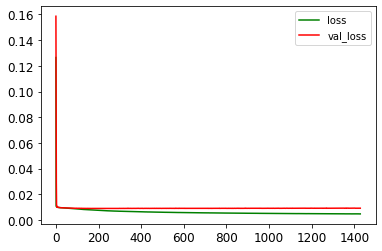

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1430/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0514

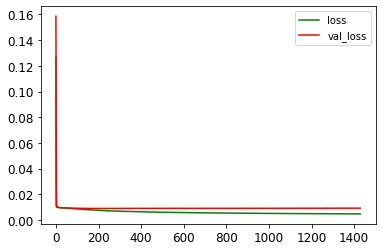

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1431/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

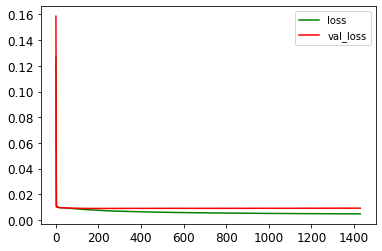

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1432/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0519

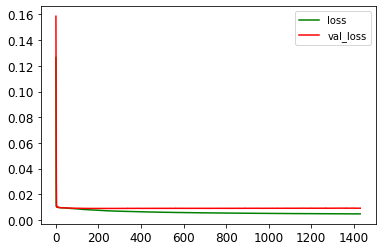

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0518 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1433/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

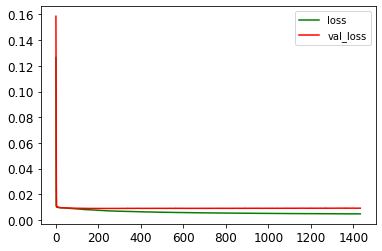

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1434/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

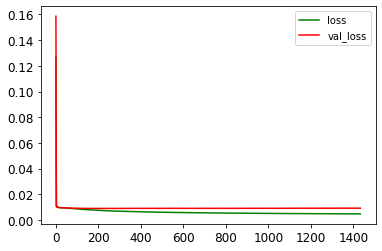

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1435/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

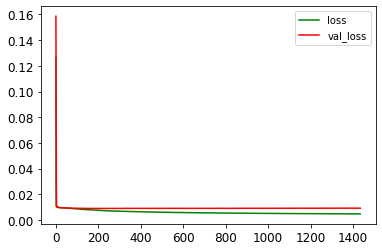

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1436/1500
67/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

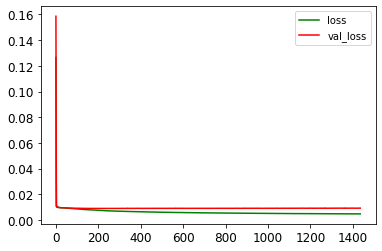

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1437/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0516

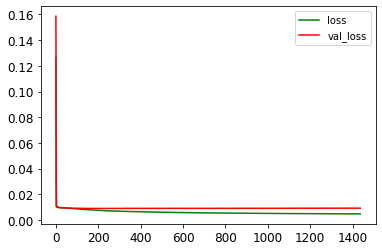

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1438/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

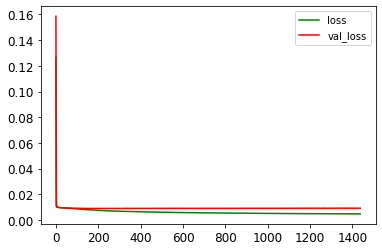

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1439/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0516

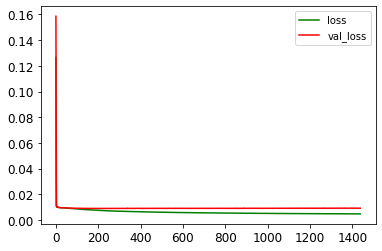

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1440/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

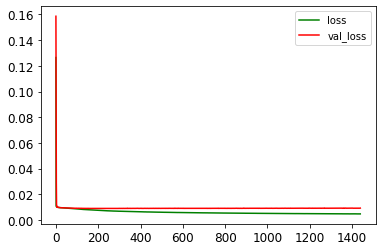

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1441/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

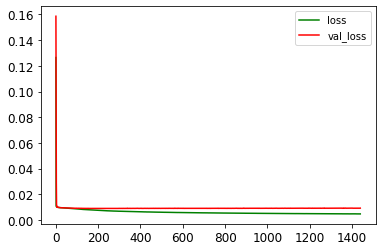

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1442/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0518

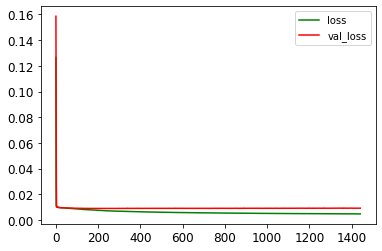

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1443/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0516

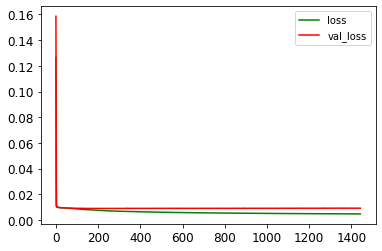

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1444/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

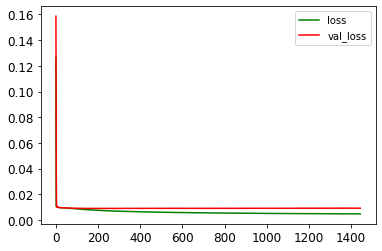

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1445/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

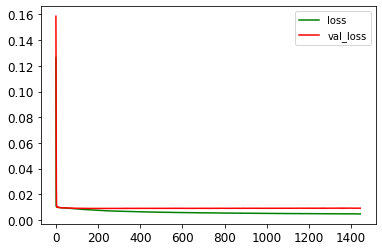

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1446/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

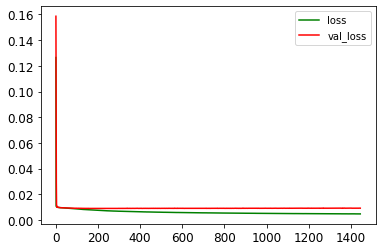

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1447/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

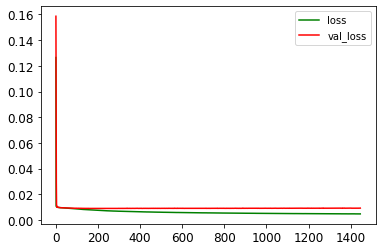

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1448/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

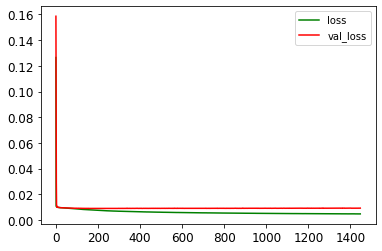

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1449/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0515

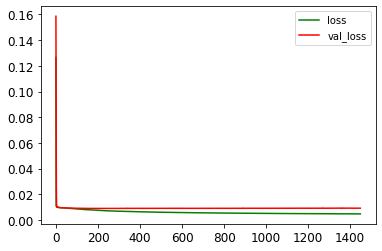

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1450/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

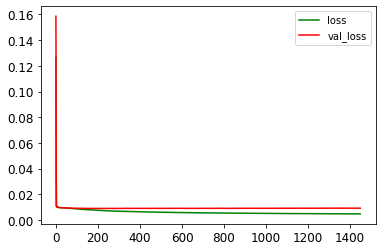

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0699
Epoch 1451/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

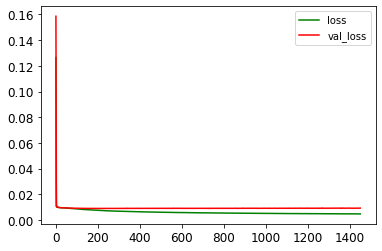

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1452/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

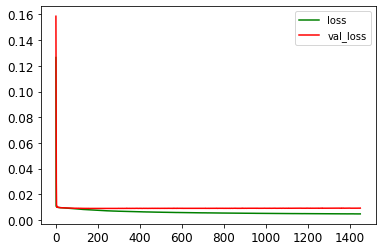

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1453/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

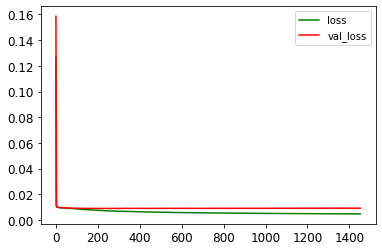

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0517 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1454/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

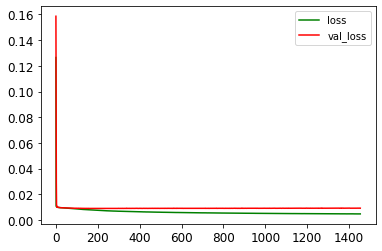

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1455/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

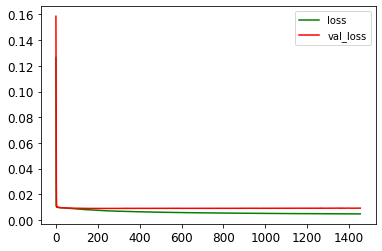

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1456/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0514

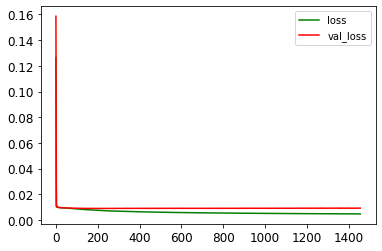

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1457/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

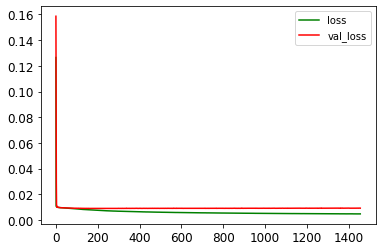

75/75 [==============================] - 1s 10ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1458/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

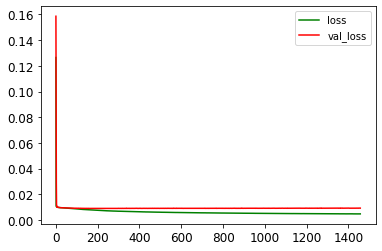

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1459/1500
67/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

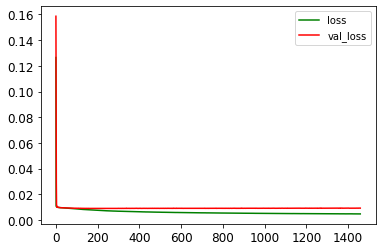

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1460/1500
67/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

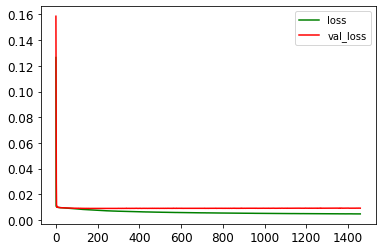

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1461/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0516

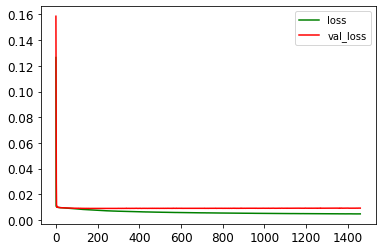

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1462/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

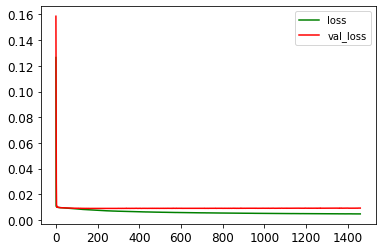

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0703
Epoch 1463/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

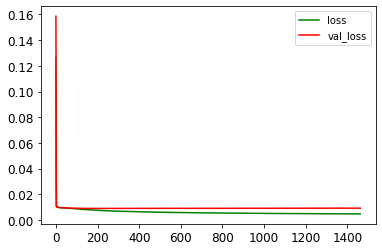

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1464/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0517

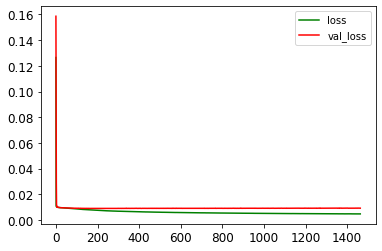

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1465/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0514

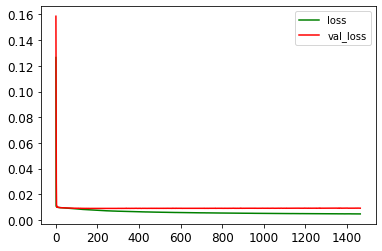

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1466/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

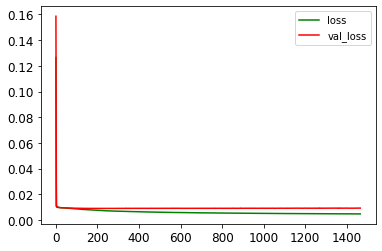

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1467/1500
67/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0514

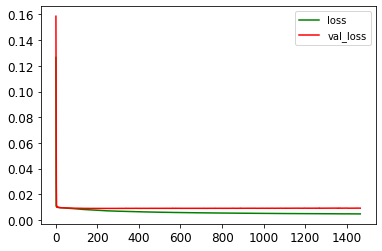

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1468/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0514

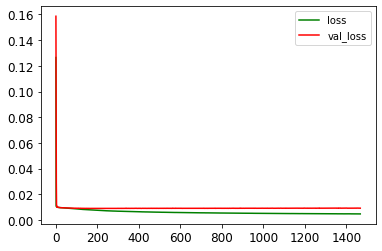

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1469/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

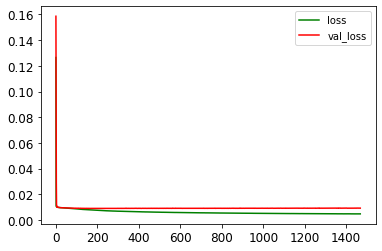

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1470/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

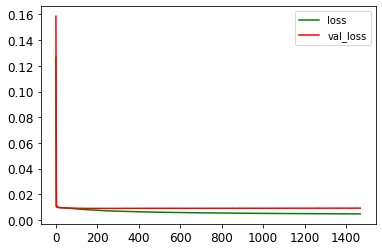

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1471/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

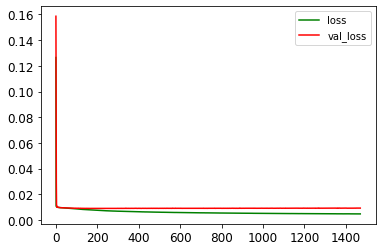

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1472/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

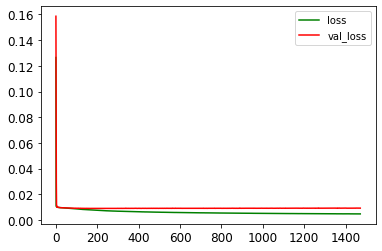

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1473/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0514

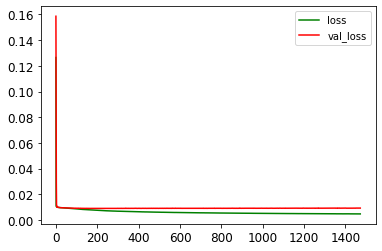

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1474/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

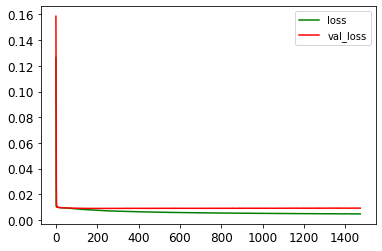

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1475/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0513

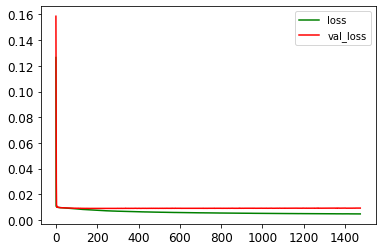

75/75 [==============================] - 0s 7ms/step - loss: 0.0048 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1476/1500
73/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0515

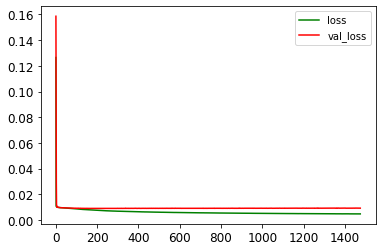

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1477/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0515

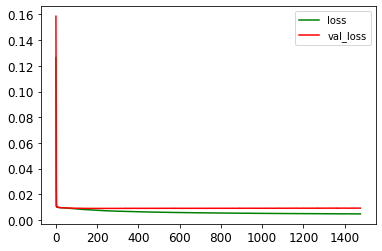

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1478/1500
75/75 [==============================] - ETA: 0s - loss: 0.0047 - mae: 0.0514

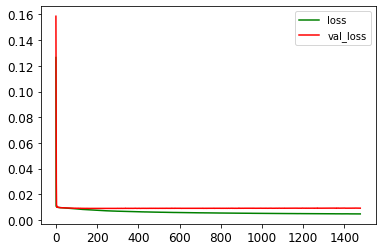

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1479/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

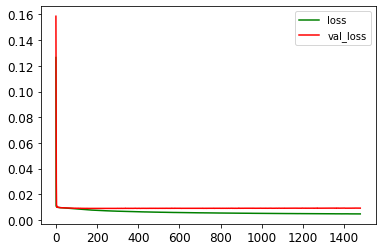

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1480/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

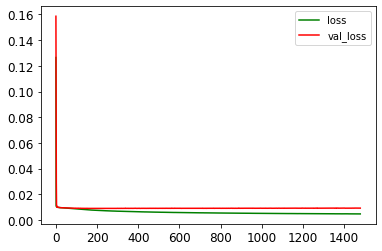

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1481/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

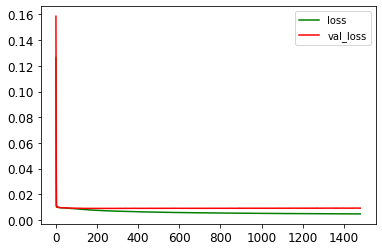

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1482/1500
75/75 [==============================] - ETA: 0s - loss: 0.0048 - mae: 0.0515

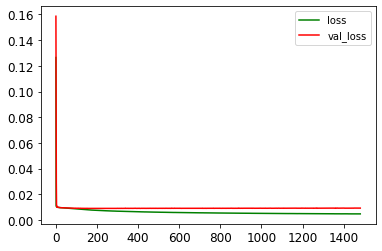

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1483/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

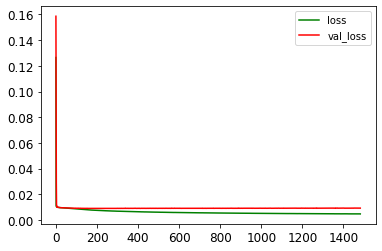

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1484/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0516

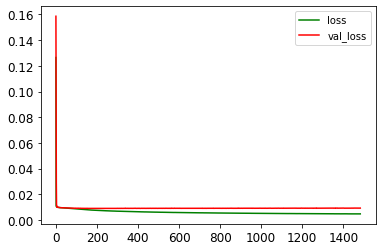

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1485/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

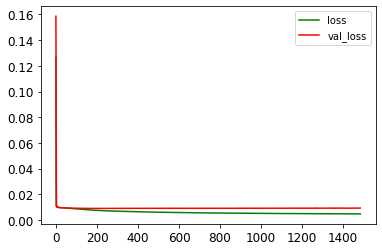

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0704
Epoch 1486/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0048 - mae: 0.0516

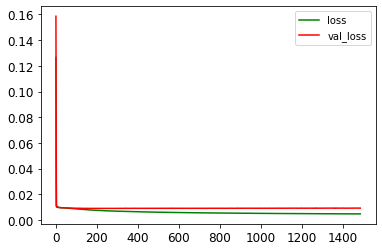

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0516 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1487/1500
75/75 [==============================] - ETA: 0s - loss: 0.0047 - mae: 0.0514

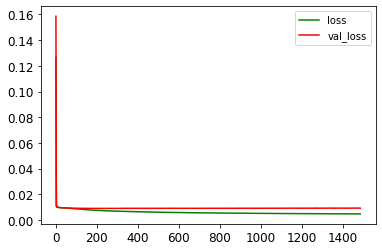

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1488/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

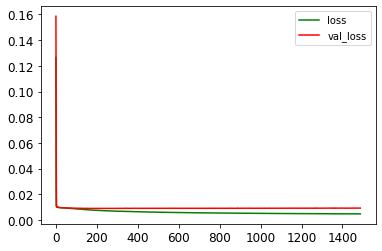

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1489/1500
74/75 [============================>.] - ETA: 0s - loss: 0.0047 - mae: 0.0513

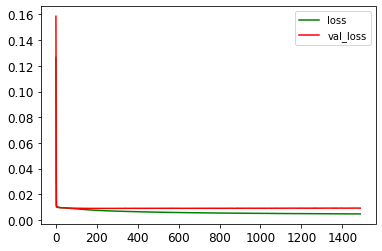

75/75 [==============================] - 1s 10ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1490/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0512

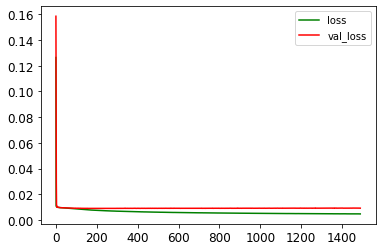

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0513 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1491/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

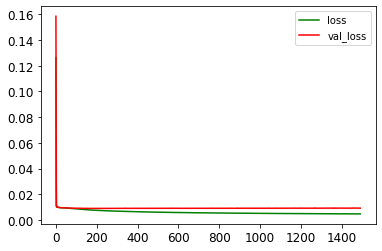

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1492/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

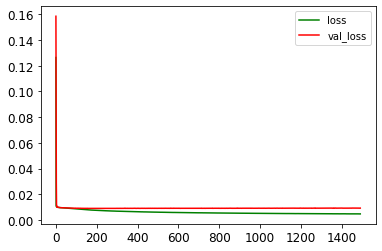

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1493/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0513

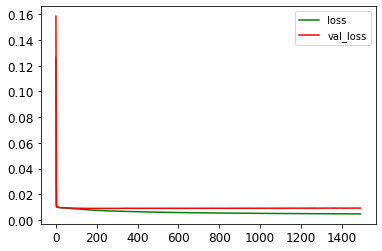

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0513 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1494/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

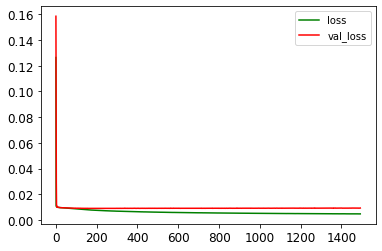

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0702
Epoch 1495/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

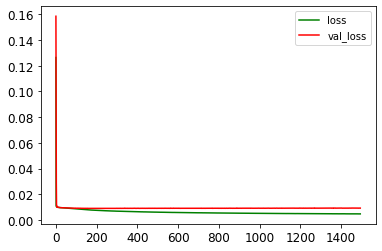

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1496/1500
65/75 [=========================>....] - ETA: 0s - loss: 0.0047 - mae: 0.0513

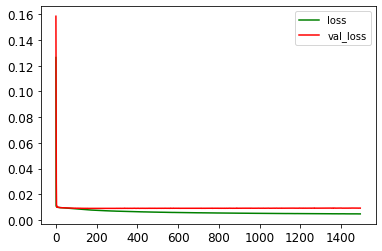

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0701
Epoch 1497/1500
63/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0513

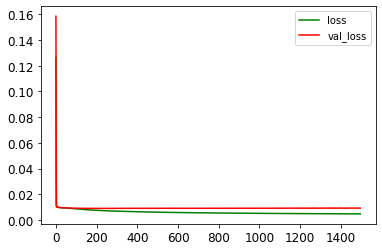

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1498/1500
66/75 [=========================>....] - ETA: 0s - loss: 0.0048 - mae: 0.0515

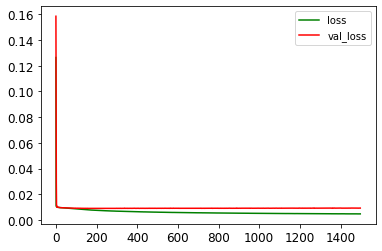

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0093 - val_mae: 0.0701
Epoch 1499/1500
75/75 [==============================] - ETA: 0s - loss: 0.0047 - mae: 0.0514

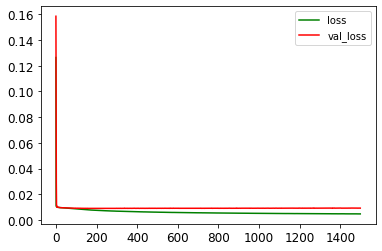

75/75 [==============================] - 1s 7ms/step - loss: 0.0047 - mae: 0.0514 - val_loss: 0.0092 - val_mae: 0.0700
Epoch 1500/1500
64/75 [========================>.....] - ETA: 0s - loss: 0.0047 - mae: 0.0514

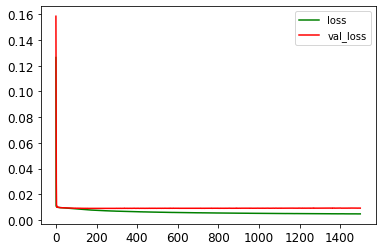

75/75 [==============================] - 1s 7ms/step - loss: 0.0048 - mae: 0.0515 - val_loss: 0.0092 - val_mae: 0.0700


In [ ]:
class PlotLosses(tf.keras.callbacks.Callback):
    def on_train_begin(self, logs={}):
        self.i = 0
        self.x = []
        self.losses = []
        self.val_losses = []
        self.fig = plt.figure()
        self.logs = []

    def on_epoch_end(self, epoch, logs={}):
        self.logs.append(logs)
        self.x.append(self.i)
        self.losses.append(logs.get('loss'))
        self.val_losses.append(logs.get('val_loss'))
        self.i += 1

        # if self.i % 100 == 0:
        plt.plot(self.x, self.losses, label="loss", c = 'green')
        plt.plot(self.x, self.val_losses, label="val_loss", c = 'red')
        plt.legend()
        plt.show()

def train_cae(dataset, epochs, log=False):
      encoded_img = cae_encoder(dataset)
      decoded_ing = cae_decoder(encoded_img)

      rom_autoencoder = tf.keras.models.Sequential([cae_encoder, cae_decoder])
      opt = tf.keras.optimizers.Adam(1e-4)
      rom_autoencoder.compile(optimizer=opt, 
                          loss=diff, 
                          metrics=['mae'])
      hist_loss = PlotLosses()
      rom_autoencoder.fit(dataset, dataset,
                          epochs = epochs,
                          batch_size = 128,
                          shuffle=True,
                          validation_split=0.2,
                          callbacks=[hist_loss])
      if log:
        rom_autoencoder.save('rom_autoencoder_with128bAnd1e-5lr.h5')
      return rom_autoencoder
print('Training Start ... ')
rom_autoencoder = train_cae(X_1d_pca_scaled[:12000], epochs=1500)

In [ ]:
recons_train = rom_autoencoder.predict(X_1d_pca_scaled)
# test_trajs = test_trajs.reshape(-1, x_sz, y_sz, 1)
# recons_test_trajs = rom_autoencoder.predict(test_trajs)

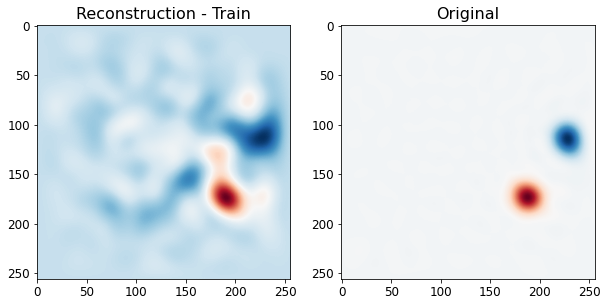

In [ ]:

traj_id = 36

real_trajs = invert_data(X_1d_pca_scaled[traj_id].reshape(1, -1), flag='3')
recon_trajs = invert_data(recons_train[traj_id].reshape(1, -1),flag='3')

fig, ax = plt.subplots(1, 2, figsize=[10, 10])
im = ax[0].imshow(recon_trajs.reshape(nx, ny), cmap='RdBu');
ax[0].set_title('Reconstruction - Train', fontsize=16);
# plt.colorbar(im, ax=ax[0])

ax[1].imshow(real_trajs.reshape(nx, ny), cmap='RdBu');
ax[1].set_title('Original', fontsize=16);

# print(diff(train_trajs[traj_id], recons_train[traj_id]))

### Train-Test Split

In [ ]:

from sklearn.model_selection import train_test_split
X_train1d_pca_scaled, X_test1d_pca_scaled = train_test_split(X_1d_pca_scaled.reshape(-1, timestep, num_of_coeff), test_size=0.1, random_state=1)
print('Train data: ',X_train1d_pca_scaled.shape)
print('Test data: ', X_test1d_pca_scaled.shape)
X_train1d_pca_scaled = np.reshape(X_train1d_pca_scaled, (-1, num_of_coeff))
X_test1d_pca_scaled = np.reshape(X_test1d_pca_scaled, (-1, num_of_coeff))

Train data:  (270, 50, 292)
Test data:  (30, 50, 292)


### Time series Concatenation

In [ ]:
# Time series Concantenation
X_train1d_pca_scaled = X_train1d_pca_scaled.reshape(-1, num_of_coeff)
sample_size = int(X_train1d_pca_scaled.shape[0]/timestep) 
window_start = [(sample*timestep)for sample in range(sample_size)]
window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]
X_train_concat = concat_timesteps(X_train1d_pca_scaled, ntimes, step, window_start, window_end)
X_train_concat_flatten = X_train_concat.reshape(X_train_concat.shape[0], (num_of_coeff )*ntimes)



print('Number of concatenated time series for training: ', X_train_concat.shape[0])
print('---------------')
print('Validation output:')
print(X_train_concat.shape)
print(X_train_concat_flatten.shape)

Number of concatenated time series for training:  5400
---------------
Validation output:
(5400, 7, 292)
(5400, 2044)


In [ ]:
# # Version 300. No train test split
# X_train1d_pca_scaled3 = X_1d_pca_scaled3.reshape(-1, num_of_coeff)
# sample_size = int(X_train1d_pca_scaled3.shape[0]/timestep) 
# window_start = [(sample*timestep)for sample in range(sample_size)]
# window_end = [(sample*timestep) - (ntimes*step) for sample in range(1, sample_size + 1)]


# X_train_concat3 = concat_timesteps(X_train1d_pca_scaled3, ntimes, step, window_start, window_end)
# X_train_concat_flatten3 = X_train_concat3.reshape(X_train_concat3.shape[0], num_of_coeff*ntimes)
# print(' Number of concatenated time series for training: ', X_train_concat3.shape[0])
# print('---------------')
# print('Test output:')
# print(X_train_concat3.shape)
# print(X_train_concat_flatten3.shape)

 Number of concatenated time series for training:  6000
---------------
Test output:
(6000, 7, 292)
(6000, 2044)


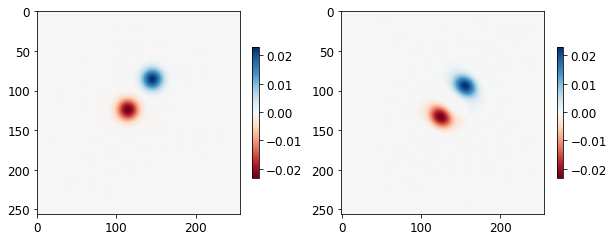

(7, 65536)


In [ ]:
# Reverse transform concatenated series to check correctness
fig, ax = plt.subplots(1, 2, figsize=[10,10])
X_ = invert_data(X_train_concat[0, :, :], flag='3')
im = ax[0].imshow(X_[0,:].reshape(nx, nx), cmap='RdBu')
im = ax[1].imshow(X_[1, :].reshape(nx, nx), cmap='RdBu')
fig.colorbar(im, ax=ax.flatten()[0], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
fig.colorbar(im, ax=ax.flatten()[1], shrink=0.24, pad=0.05, panchor=(0.0, 0.0))
plt.show()
print(X_.shape)


GAN Hyperparameters

In [ ]:
g_lr = 1e-4
d_lr = 1e-4
num_examples_to_generate = 15

BATCH_SIZE = 64
latent_space = 300

generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)

# Seed and intitialization
seed = tf.random.normal([num_examples_to_generate, latent_space])

Dataset Creation

In [ ]:
# Create a tensorflow dataset and split it into batches
train_dataset = X_train_concat.reshape(X_train_concat.shape[0], ntimes, num_of_coeff, 1).astype('float32')
train_dataset = tf.data.Dataset.from_tensor_slices(train_dataset)
train_dataset = train_dataset.shuffle(len(X_train_concat)).batch(BATCH_SIZE, drop_remainder=True)

### DCGAN 

1. (original architecture with diff LR: disc=1e-4, gen=5e-5) **still collapses**
2. More latent space, 64 batch size, equal LR. **still collapses**
3. 3000 latent space, 7 consecutive times for the GAN, 5 step gap between times

Generator Model

In [ ]:
def make_generator_model():
    # model = tf.keras.Sequential()
    # model.add(keras.layers.Dense(5*73*256, use_bias=False, input_shape=(latent_space,)))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Reshape((5, 73, 256)))

    # model.add(keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 1), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(64, (3, 3), strides=(2, 2), padding='same', use_bias=False))
    # model.add(keras.layers.BatchNormalization())
    # model.add(keras.layers.LeakyReLU())

    # model.add(keras.layers.Conv2DTranspose(1, (3, 3), strides=(2, 2), padding='same', use_bias=False, activation='tanh'))
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(5*12*512, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Reshape((5, 12, 512)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (3, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU()) 

    model.add(tf.keras.layers.Conv2DTranspose(128, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(64, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(32, (3, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU())

    model.add(tf.keras.layers.Conv2DTranspose(1, (3, 7), strides=(1, 3), padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))

    return model
generator = make_generator_model()
generator.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
dense (Dense)                (None, 30720)             92160000  
_________________________________________________________________
batch_normalization (BatchNo (None, 30720)             122880    
_________________________________________________________________
leaky_re_lu (LeakyReLU)      (None, 30720)             0         
_________________________________________________________________
reshape (Reshape)            (None, 5, 12, 512)        0         
_________________________________________________________________
conv2d_transpose (Conv2DTran (None, 5, 12, 256)        2752512   
_________________________________________________________________
batch_normalization_1 (Batch (None, 5, 12, 256)        1024      
_________________________________________________________________
leaky_re_lu_1 (LeakyReLU)    (None, 5, 12, 256)        0

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


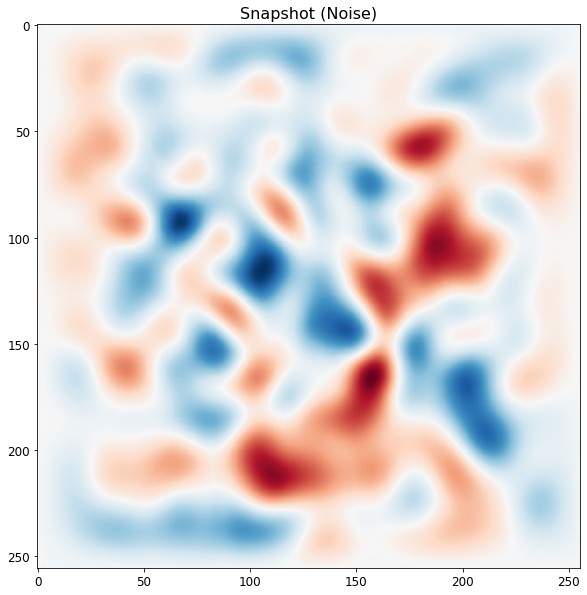

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0])
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Discriminator

In [ ]:
def make_discriminator_model():
    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(64, (3, 3), strides=(2, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    # model.add(tf.keras.layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.LeakyReLU())
    # model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    # model.add(tf.keras.layers.Conv2D(256, (5, 5), strides=(2, 2), padding='same'))
    # model.add(tf.keras.layers.LeakyReLU())
    # model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))

    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_4"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d_10 (Conv2D)           (None, 4, 146, 64)        640       
_________________________________________________________________
leaky_re_lu_20 (LeakyReLU)   (None, 4, 146, 64)        0         
_________________________________________________________________
dropout_10 (Dropout)         (None, 4, 146, 64)        0         
_________________________________________________________________
conv2d_11 (Conv2D)           (None, 2, 73, 64)         102464    
_________________________________________________________________
leaky_re_lu_21 (LeakyReLU)   (None, 2, 73, 64)         0         
_________________________________________________________________
dropout_11 (Dropout)         (None, 2, 73, 64)         0         
_________________________________________________________________
conv2d_12 (Conv2D)           (None, 1, 37, 128)       

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-9.7441734e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

Cost Function and Optimization

In [ ]:
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def discriminator_loss(real_output, fake_output):
  real_loss = cross_entropy(tf.ones_like(real_output), real_output)
  fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
  total_loss = real_loss + fake_loss
  return total_loss

def generator_loss(fake_output):
  fake_loss = cross_entropy(tf.ones_like(fake_output), fake_output)
  return fake_loss

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)

# Optimizers for generator and optimizer models

generator_optimizer = tf.keras.optimizers.Adam(g_lr)
discriminator_optimizer = tf.keras.optimizers.Adam(d_lr)


In [ ]:
# logs to document losses
version_num = 'E3000_125b'
# generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(num_of_coeff)
# discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(num_of_coeff)
# gen_summary = tf.summary.create_file_writer(generator_log_dir)
# disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: gen-', g_lr, ', disc-', d_lr)
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  E3000_125b
POD coeffiecients:  292
Batch size:  125
Learning Rate: gen- 0.0001 , disc- 0.0001
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        real_output = discriminator(batch, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
    
    generator_mean_loss(gen_loss)
    discriminator_mean_loss(disc_loss)

Train GAN - Training loop

In [ ]:
def train(dataset, epochs):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1, epochs))   

        for batch in dataset:
            train_step(batch)
            
        # with gen_summary.as_default():
        #     tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

        # with disc_summary.as_default():
        #     tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        print("discriminator loss: ", "{:.6f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.6f}".format(hist[-1][0]), end=' - ')    
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%100 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated)
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            ax.set_yscale('log')
            ax.grid()
            plt.show()
        if epoch%1000 == 0:
          # Save model once greater that 10,000 iterations 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                        str(num_of_coeff)+'_'+str(epoch)+'.h5')  
            
    return hist


In [ ]:
import time
hist = train(train_dataset, epochs=50000)

### W-GAN with GP

#### Load Models

In [ ]:
from tensorflow.keras.models import load_model
generator, discriminator = load_model(SAVE_DIR+'ganmodels/model_vE3000_64b_wgan_01_4500.h5').layers
np.random.seed(0)
tf.random.set_seed(0)

In [ ]:
discriminator.get_config()


In [ ]:

generator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)
discriminator_mean_loss = tf.keras.metrics.Mean(dtype=tf.float32)


# Optimizers for generator and optimizer models
generator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)
discriminator_optimizer = tf.keras.optimizers.Adam(learning_rate=1e-4, beta_1=0.5, beta_2=0.9)

def discriminator_loss(fake_output, real_output):
  return tf.reduce_mean(fake_output) - tf.reduce_mean(real_output)

def generator_loss(fake_output, real_output):
  return -tf.reduce_mean(fake_output)


Gradient Penalty

In [ ]:
def gradient_penalty(f, real, fake):
    
    def _interpolate(a, b):
        shape = [BATCH_SIZE, 1, 1, 1]
        alpha = tf.random.uniform(shape=shape, minval=0., maxval=1.)
        inter = a + alpha * (b - a)
        return inter

    x = _interpolate(real, fake)
    with tf.GradientTape() as t:
        t.watch(x)
        pred = f(x)
    grad = t.gradient(pred, x)
    norm = tf.norm(tf.reshape(grad, [tf.shape(grad)[0], -1]), axis=1)
    gp = tf.reduce_mean((norm - 1.)**2)

    return gp

#### Build Models

Generator Model

In [ ]:
def make_generator_model():
  
    # model = tf.keras.Sequential()
    # model.add(tf.keras.layers.Dense(5*18*128, use_bias=False, input_shape=(latent_space,)))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))
  

    # model.add(tf.keras.layers.Reshape((5, 18, 128)))

    # model.add(tf.keras.layers.Conv2DTranspose(256, (3, 3), strides=(1, 2), padding ='same', use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(128, (3, 3), strides=(1, 2), padding ='valid', output_padding=[0,0], use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(64, (3, 3), strides=(1, 2), padding ='same', use_bias=False))
    # model.add(tf.keras.layers.LayerNormalization())
    # model.add(tf.keras.layers.LeakyReLU(0.3))

    # model.add(tf.keras.layers.Conv2DTranspose(1, (3, 3), strides=(1, 2),padding ='same', use_bias=False, activation='tanh'))

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Dense(7*12*256, use_bias=False, input_shape=(latent_space,)))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
    model.add(tf.keras.layers.Dropout(0.3))
  

    model.add(tf.keras.layers.Reshape((7, 12, 256)))

    model.add(tf.keras.layers.Conv2DTranspose(256, (7, 7), strides=(1, 1), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3)) 
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(128, (7, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(64, (7, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(32, (7, 7), strides=(1, 2), padding='same', use_bias=False))
    model.add(tf.keras.layers.BatchNormalization())
    model.add(tf.keras.layers.LeakyReLU(0.3))
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2DTranspose(1, (1, 7), strides=(1, 3),padding ='valid', output_padding=[0,0], use_bias=False, activation='tanh'))
    model.add(tf.keras.layers.Dense(1))

    return model
generator = make_generator_model()
generator.summary()



Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 21504)             6451200   
                                                                 
 batch_normalization (BatchN  (None, 21504)            86016     
 ormalization)                                                   
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 21504)             0         
                                                                 
 dropout (Dropout)           (None, 21504)             0         
                                                                 
 reshape (Reshape)           (None, 7, 12, 256)        0         
                                                                 
 conv2d_transpose (Conv2DTra  (None, 7, 12, 256)       3211264   
 nspose)                                                

Discriminator / Critic

In [ ]:
def make_discriminator_model():

    model = tf.keras.Sequential()
    model.add(tf.keras.layers.Conv2D(32, (7, 7), strides=(1, 2), padding='same',
                                     input_shape=[ntimes, num_of_coeff, 1]))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(64, (7, 7), strides=(1, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(128, (7, 7), strides=(1, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (7, 7), strides=(1, 2), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    model.add(tf.keras.layers.Conv2D(256, (7, 7), strides=(1, 3), padding='same'))
    model.add(tf.keras.layers.LeakyReLU())
    model.add(tf.keras.layers.Dropout(0.3))

    
    model.add(tf.keras.layers.Flatten())
    model.add(tf.keras.layers.Dense(1))


    return model
discriminator = make_discriminator_model()
discriminator.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 7, 146, 32)        1600      
                                                                 
 leaky_re_lu_5 (LeakyReLU)   (None, 7, 146, 32)        0         
                                                                 
 dropout_5 (Dropout)         (None, 7, 146, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 7, 73, 64)         100416    
                                                                 
 leaky_re_lu_6 (LeakyReLU)   (None, 7, 73, 64)         0         
                                                                 
 dropout_6 (Dropout)         (None, 7, 73, 64)         0         
                                                                 
 conv2d_2 (Conv2D)           (None, 7, 37, 128)       

## Test and Train

#### WGAN-GP

Testing the model generator

(1, 7, 292, 1)
(7, 65536)


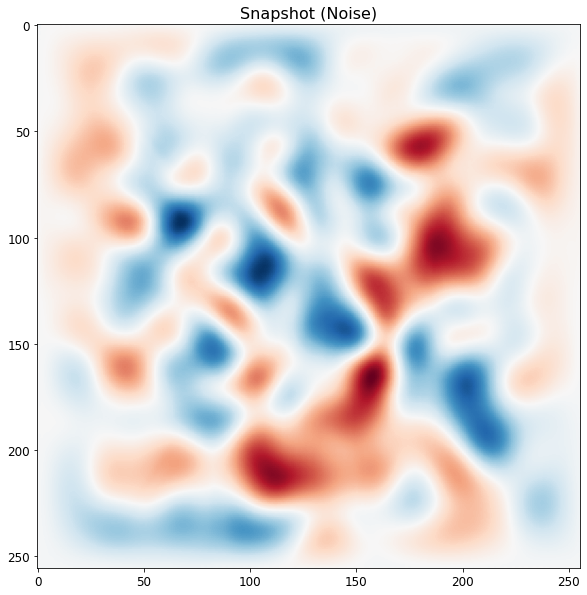

In [ ]:
noise = tf.random.normal([1, latent_space])
generated_image = generator(noise, training=False)
print(generated_image.shape)

fig, ax = plt.subplots(figsize=[10,10])
inv_generated_image = invert_data(generated_image[0, :, :, 0], flag='3')
print(inv_generated_image.shape)
ax.imshow(inv_generated_image[0, :].reshape(nx, nx), cmap='RdBu');
ax.set_title('Snapshot (Noise)', fontsize=16);

Test disciriminator model

In [ ]:
decision = discriminator(generated_image)
print(decision)

tf.Tensor([[-2.3694794e-05]], shape=(1, 1), dtype=float32)


Generative Model


In [ ]:
gan = tf.keras.models.Sequential ([generator, discriminator])

In [ ]:
# logs to document losses
#version_num = 'E3000_FT'
version_num = 'journal'

generator_log_dir = SAVE_DIR + 'logs/generator_v' + str(version_num) + '_'+ str(BATCH_SIZE)
discriminator_log_dir = SAVE_DIR + 'logs/discriminator_v' + str(version_num) + '_'+ str(BATCH_SIZE)
gen_summary = tf.summary.create_file_writer(generator_log_dir)
disc_summary = tf.summary.create_file_writer(discriminator_log_dir)


print('Version no.: ', version_num)
print('POD coeffiecients: ', num_of_coeff)
print('Batch size: ', BATCH_SIZE)
print('Learning Rate: ', g_lr, '(gen),', d_lr, '(disc)')
print('Instances: ', ntimes)
print('Time steps: ', step)

Version no.:  journal
POD coeffiecients:  292
Batch size:  64
Learning Rate:  0.0001 (gen), 0.0001 (disc)
Instances:  7
Time steps:  5


Training step

In [ ]:
@tf.function
def train_step(batch, n_critic):
    noise = tf.random.normal([BATCH_SIZE, latent_space])

    # Discriminator training 
    for i in range(n_critic):
      losses_d = [] 
      with tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)
        
        fake_output = discriminator(generated_images, training=True)
        real_output = discriminator(batch, training=True)
        
        # Wasserstein Loss
        disc_wloss_noGP = discriminator_loss(fake_output, real_output)
        gp = gradient_penalty(functools.partial(discriminator, training=True), batch, generated_images)
        disc_wloss = disc_wloss_noGP + gp*10.0
       
      gradients_of_discriminator = disc_tape.gradient(disc_wloss, discriminator.trainable_variables)
      discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))
      losses_d.append(disc_wloss_noGP)
    discriminator_mean_loss(losses_d)

    # Generator training 
    with tf.GradientTape() as gen_tape:
        generated_images = generator(noise, training=True)
        fake_output = discriminator(generated_images, training=True)

        # Wasserstein Loss
        gen_wloss = generator_loss(fake_output, real_output)
    
    gradients_of_generator = gen_tape.gradient(gen_wloss, generator.trainable_variables)
    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
   
   
    generator_mean_loss(gen_wloss)
    return gp

#### Training GAN

In [ ]:
def train(dataset, epochs, n_critic, cont=0, log=True):
    hist = []
    for epoch in range(epochs+1):
        start = time.time()
        print("Epoch {}/{}".format(epoch + 1+cont, epochs+cont))   

        for batch in dataset:
           gp = train_step(batch, n_critic)

        if log:
          with gen_summary.as_default():
              tf.summary.scalar('loss', generator_mean_loss.result(), step=epoch)

          with disc_summary.as_default():
              tf.summary.scalar('loss', discriminator_mean_loss.result(), step=epoch)
        
        hist.append([generator_mean_loss.result().numpy(), discriminator_mean_loss.result().numpy()])

        generator_mean_loss.reset_states()
        discriminator_mean_loss.reset_states()
        

        print("discriminator loss: ", "{:.7f}".format(hist[-1][1]), end=' - ')
        print("generator loss: ", "{:.7f}".format(hist[-1][0]), end=' - ')
        # print("gradient penalty: ", "{:.7f}".format(gp), end=' - ')
        # print("lr: ", "{:.2e}".format(generator_optimizer.learning_rate(epoch)), end= ' - ')  
        print ('{:.0f}s'.format( time.time()-start))

        pred_time_len = 4
        # Global variables are used below
        if epoch%500 == 0: 
            # Plot generated data
            X_generated = generator.predict(seed).reshape(-1, num_of_coeff)
            X_generated = invert_data(X_generated, flag='3')
            print(X_generated.shape)
            X_generated = X_generated.reshape(num_examples_to_generate, ntimes, nx, nx)
            fig, ax = plt.subplots(5, pred_time_len, figsize=[20, 25], constrained_layout=True)
            for j in range(5):
              for i in range(pred_time_len):
                im = ax.flatten()[i + (pred_time_len*j)].imshow(X_generated[j][i,:,:], cmap='RdBu')
                ax[j,i].set_xticklabels([]), ax[j,i].set_yticklabels([])
              fig.colorbar(im, ax=ax[j,:], location='right', shrink=0.8, pad=0.05)
            plt.show() 
                    
            
            # plot loss
            print('Loss: ')
            fig, ax = plt.subplots(1,1, figsize=[20,10])
            ax.plot(hist)
            ax.legend(['loss_gen', 'loss_disc'])
            #ax.set_yscale('log')
            ax.grid()
            plt.show()          
              # Save model once 
            gan.save(SAVE_DIR + 'ganmodels/model_v'+ str(version_num) + '_'+ 
                                            str(num_of_coeff)+'_'+str(epoch+cont) + '.h5')  
    return hist

In [ ]:
import time
hist = train(train_dataset, epochs=10000, cont=0, n_critic=5, log=False) 

#**Prediction with WGAN-GP**

In [ ]:
import warnings
warnings.filterwarnings('ignore')

In [ ]:
 from tensorflow.keras.models import load_model
 # arbitrary sample trajectories to predict

model_dir_arr = ['ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5',
                  'ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5',
                 'ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5',
                 'ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5', 
                 'ganmodels/E3000/model_vE3000_125b_wganRMS_292_10500.h5',
                  'ganmodels/E3000/model_vE3000_125b_wganB_292_5500.h5',
                 
             ]
#                  'ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5',
#                 'ganmodels/E3000/model_vE3000_64b_wgan_01_292_7500.h5',
models_generator={}

models_pred={}  
models_pred_time={}
models_pred_mse_err={}
models_pred_mae_err={}
models_opt_latent={}

### Sample generation

In [ ]:
def generate_samples(model_dir, model_idx, flag=None):
  generator, discriminator = load_model(SAVE_DIR+model_dir).layers;
  models_generator[model_idx] = generator
  print()
  print('------------------------------')
  print(model_dir)
  print('------------------------------')
  np.random.seed(0)
  tf.random.set_seed(0)
  npredict = 10
  latent_size = 3000
  pred_time_len = 7
  noise = tf.random.normal(shape=[npredict, latent_size])
  X_generated = generator.predict(noise).reshape(-1, num_of_coeff)
  X_generated = invert_data(X_generated, flag)
  X_generated = X_generated.reshape(npredict, ntimes, nx, ny)

  for j in range(npredict):
    fig, ax = plt.subplots(1, pred_time_len, figsize=[20, 16], constrained_layout=True)
    for i in range(pred_time_len):
      im = ax.flatten()[i].imshow(X_generated[j][i,:,:], cmap='RdBu')
      ax[i].set_xticklabels([]), ax[i].set_yticklabels([])
    fig.colorbar(im, ax=ax[:], location='right', shrink=0.18, pad=0.05)
    plt.show() 


In [ ]:
generate_samples(model_dir_arr[0], 0, flag='3')


In [ ]:
generate_samples(model_dir_arr[1], 1, flag='3')

In [ ]:
generate_samples(model_dir_arr[2], 2, flag='3')

In [ ]:
generate_samples(model_dir_arr[3], 3, flag='3')

In [ ]:
generate_samples(model_dir_arr[4], 4, flag='3')

In [ ]:
generate_samples(model_dir_arr[5], 5, flag='3')

In [ ]:
generate_samples(model_dir_arr[6], 6, flag='3')

IndexError: ignored

### Predict a point in time

In [ ]:
class Pred_optimizer():
  def __init__(self, generator, real_coding, weights, latent_values,
               loss_metric=tf.keras.losses.MeanSquaredError(), 
               optimizer=tf.keras.optimizers.Adam(1e-2), ntimes=7):
      self.generator = generator
      self.real_coding = real_coding
      self.weights = weights
      self.loss_metric = loss_metric
      self.optimizer = optimizer
      self.latent_values = latent_values
      self.ntimes = ntimes

  @tf.function
  def opt_step(self):
      with tf.GradientTape() as tape:
        tape.watch(self.latent_values)
        gen_output = self.generator(self.latent_values, training=False)  #results from generato
        
        codings_size = self.weights.shape[0]
        true_val = tf.reshape(self.real_coding, [-1, codings_size]) 
        gen_val = tf.reshape(gen_output[:,:(self.ntimes - 1),:,:], [-1, codings_size]) 

        loss = self.loss_metric(true_val, gen_val)   

      gradient = tape.gradient(loss, self.latent_values)   #gradient of the loss ws to the input
      self.optimizer.apply_gradients(zip([gradient], [self.latent_values]))   #applies gradients to the input
      return loss
  
  def __call__(self, opt_epochs, num_call=1):
      
      loss = []
      step_loss = 1
      for epoch in range(opt_epochs):
        step_loss = self.opt_step().numpy()
        loss.append(step_loss)
      plt.plot(loss, label='Loss_'+str(num_call))
      plt.grid()
      plt.legend()
      plt.show
        
      return self.latent_values, loss[-1]

#### Sample run  with train data 1

In [ ]:
latent_size=3000
codings_size = 292
ns = [3450,  5000,  4280, 3000, 2520, 2900, 1400]
n = 4560
opt_epochs = 10000
weight = tf.constant(pca3.singular_values_, dtype=tf.float32)

real_coding = X_train_concat_flatten3[n].reshape(1,-1)
real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
real_coding = tf.cast(real_coding, dtype=tf.float32)

mse = tf.keras.losses.MeanSquaredError()
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))


def mse_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size]) *tf.math.sqrt(weight)
    outp = tf.reshape(outp, [-1, codings_size]) *tf.math.sqrt(weight)
    return mse(inp, outp)

def mae_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size])*weight
    outp = tf.reshape(outp, [-1, codings_size])*weight
    return mae(inp, outp)

def predict_timelvl(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    opt_latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err[model_idx] = l_mse
    models_pred_mae_err[model_idx] = l_mae
    models_pred_time[model_idx] = time_to_pred
    models_opt_latent[model_idx] = opt_latent_values

**Original trajectory**

In [ ]:

X_all = np.zeros((10, nx*nx))
times = [i for i in range(10)]
X_real = X_train_concat_flatten3[n].reshape(ntimes,codings_size)
X_real = invert_data(X_real, flag='3')
X_real = X_real.reshape(ntimes, nx*nx)
# first three snapshots
X_all[:3] = X_real[:3].copy()

# Last seven snapshots 
X_real_cont = X_train_concat_flatten3[n+15].reshape(ntimes,codings_size)

X_real_cont = invert_data(X_real_cont, flag='3')
X_real_cont = X_real_cont.reshape(ntimes, nx*nx)
X_all[-7:] = X_real_cont.copy()
plot_vortex(X_all.reshape(10, nx, nx), times, cols=5,rows=2, skips=5, c_bar=False)

In [ ]:
import vtk
from vtk.util import numpy_support
for i in range(ntimes):
  fig, ax = plt.subplots()
  NumPy_data = X_all[i].reshape(nx, nx)
  im = ax.imshow(NumPy_data)
  plt.imsave("vorticity_orig_" + str(i*5)+".png", NumPy_data)
  plt.show()
  # im.show()
  # NumPy_data_shape = NumPy_data.shape
  # vort_grid = vtk.vtkImageData()
  # VTK_data = vtk.vtkFloatArray()
  # # numpy_support.numpy_to_vtk(num_array=NumPy_data, deep=True, array_type=vtk.VTK_FLOAT)
  # VTK_data.SetNumberOfComponents(nx)
  # VTK_data.SetNumberOfValues(nx*nx)

  # VTK_data.SetName('vort-data')
  # for j in range(nx*nx):
  #   VTK_data.SetValue(i, NumPy_data.reshape(nx*nx)[j])
  # point_data = vort_grid.GetPointData()
  # point_data.AddArray(VTK_data)
  # point_data.SetActiveVectors('vort-data')
  # writer = vtk.ImageDataWriter()
  # writer.SetFileName("vorticity_orig_" + str(i)+".vti")
  # writer.SetInputData(vort_grid)
  # writer.Write()

**Prediction Algorithm**

In [ ]:
predict_timelvl(models_generator[0], n, 0)

In [ ]:
predict_timelvl(models_generator[1], n, 1)

In [ ]:
predict_timelvl(models_generator[2], n, 2)

In [ ]:
predict_timelvl(models_generator[3], n, 3)

In [ ]:
predict_timelvl(models_generator[4], n, 4)

In [ ]:
predict_timelvl(models_generator[5], n, 5)

In [ ]:
predict_timelvl(models_generator[6], n, 6)

**Generated Data**

In [ ]:
gen_times = times[:ntimes]
def gen_pred_timelvl(generator, opt_lat_val, model_idx, flag=None):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred[model_idx] = X_gen
  X_gen = invert_data(X_gen, flag)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), gen_times, 7, c_bar=False, skips=5)

In [ ]:
gen_pred_timelvl(models_generator[0], models_opt_latent[0], 0, flag='3')

In [ ]:
X_gen = invert_data(models_pred[0], flag='3')
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, gen_times, len(gen_times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[1], models_opt_latent[1], 1, flag='3')

In [ ]:
X_gen = invert_data(models_pred[1], flag='3')
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, gen_times, len(gen_times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[2], models_opt_latent[2], 2, flag='3')

In [ ]:
X_gen = invert_data(models_pred[2], flag='3')
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, gen_times, len(gen_times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[3], models_opt_latent[3], 3, flag='3')

In [ ]:
X_gen = invert_data(models_pred[3], flag='3')
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, gen_times, len(gen_times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[4], models_opt_latent[4], 4)

In [ ]:
X_gen = invert_data3(models_pred[4])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[5], models_opt_latent[5], 5)

In [ ]:
X_gen = invert_data3(models_pred[5])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
gen_pred_timelvl(models_generator[6], models_opt_latent[6], 6)

In [ ]:
X_gen = invert_data3(models_pred[6])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
print(np.max(X_gen[-1]))

0.013330745368535289


**Comparing Predicted and Real Data**

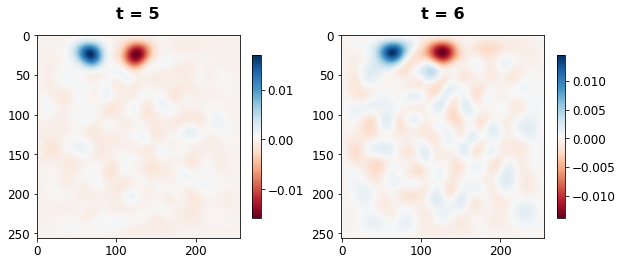

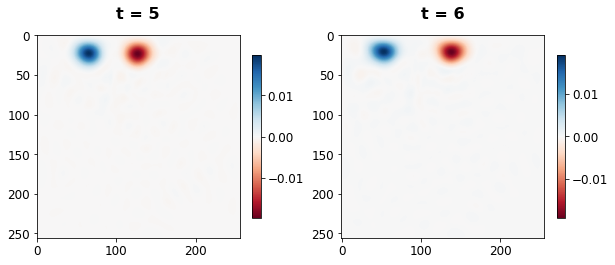

In [ ]:
plot_vortex(X_gen.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1], 2)
plot_vortex(X_real.reshape(ntimes, nx, nx), [ntimes-2, ntimes-1],2)

In [ ]:
real = X_real.reshape(ntimes, nx, nx)
generated = X_gen.reshape(ntimes, nx, nx)
X_diff = real - generated
print('Mean Error: ', np.mean(X_diff))
print('Max. Error: ', np.max(X_diff))
# plot_vortex(X_diff, times, 4, 2)

Mean Error:  -4.4248697425984146e-07
Max. Error:  0.009921253653360607


#### Sample run with test data 

In [ ]:
models_pred2={}  
models_pred_time2={}
models_pred_mse_err2={}
models_pred_mae_err2={}
models_opt_latent2={}

In [ ]:
latent_size=3000
codings_size = 292
n = 16000
opt_epochs = 10000
weight = tf.constant(pca.singular_values_, dtype=tf.float32)

real_coding = X_train_concat_flatten[n].reshape(1,-1)
real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
real_coding = tf.cast(real_coding, dtype=tf.float32)

mse = tf.keras.losses.MeanSquaredError()
codings_size = num_of_coeff
mse = tf.keras.losses.MeanSquaredError()
mae = tf.keras.losses.MeanAbsoluteError()
optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))


def mse_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size]) *tf.math.sqrt(weight)
    outp = tf.reshape(outp, [-1, codings_size]) *tf.math.sqrt(weight)
    return mse(inp, outp)

def mae_loss(inp, outp):
    inp = tf.reshape(inp, [-1, codings_size])*weight
    outp = tf.reshape(outp, [-1, codings_size])*weight
    return mae(inp, outp)

def predict_timelvl2(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    print(model_dir_arr[model_idx])
    print("------------------------")
    print()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    opt_latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err2[model_idx] = l_mse
    models_pred_mae_err2[model_idx] = l_mae
    models_pred_time2[model_idx] = time_to_pred
    models_opt_latent2[model_idx] = opt_latent_values

**Original Trajectory**

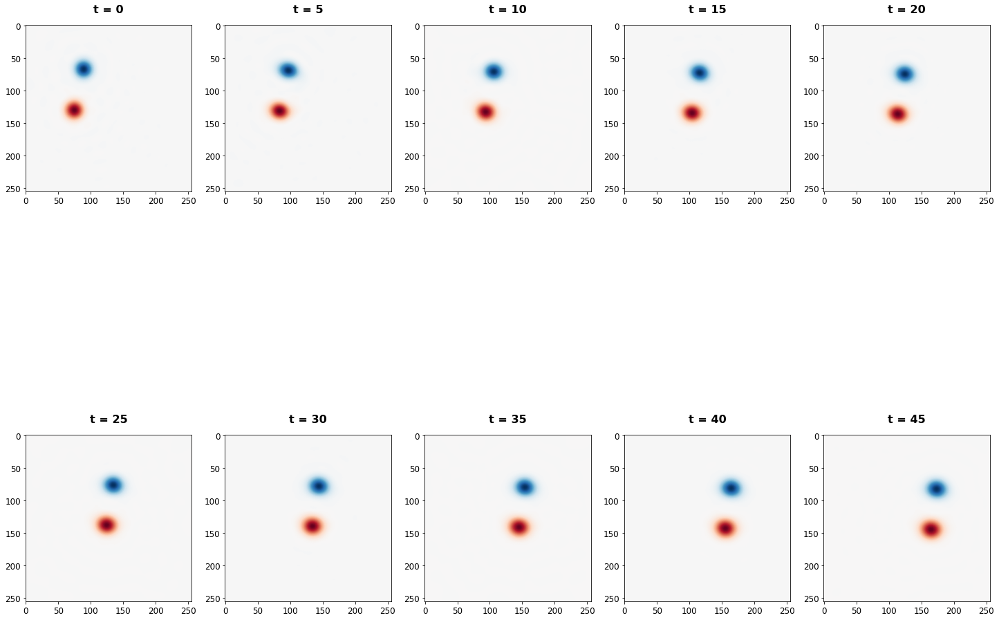

In [ ]:
X_all = np.zeros((10, nx*nx))
times = [i for i in range(10)]
X_real = X_train_concat_flatten[n].reshape(ntimes,codings_size)
X_real = invert_data(X_real, )
X_real = X_real.reshape(ntimes, nx*nx)
X_all[:3] = X_real[:3].copy()

X_real_cont = X_train_concat_flatten[n + 15].reshape(ntimes,codings_size)

X_real_cont = invert_data(X_real_cont,)
X_real_cont = X_real_cont.reshape(ntimes, nx*nx)
X_all[-7:] = X_real_cont.copy()
plot_vortex(X_all.reshape(10, nx, nx), times, cols=5,rows=2, skips=5, c_bar=False)

**Prediction Algorithm**

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
------------------------

371s
MSE Loss:  0.04665226
MAE Loss:  0.38541365


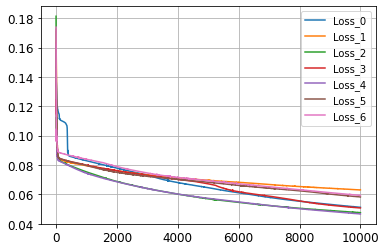

In [ ]:
predict_timelvl2(models_generator[0], n, 0)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
------------------------

372s
MSE Loss:  0.042033996
MAE Loss:  0.3603623


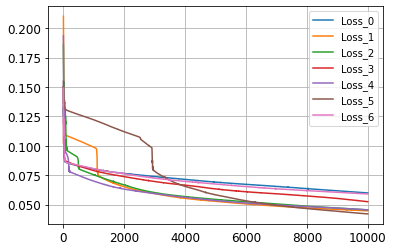

In [ ]:
predict_timelvl2(models_generator[1], n, 1)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
------------------------

373s
MSE Loss:  0.044145
MAE Loss:  0.36971784


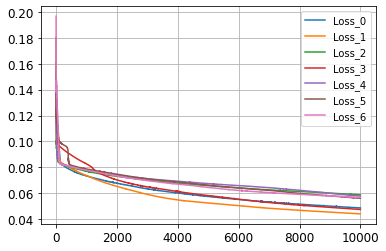

In [ ]:
predict_timelvl2(models_generator[2], n, 2)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
------------------------

346s
MSE Loss:  0.0088778585
MAE Loss:  0.16056992


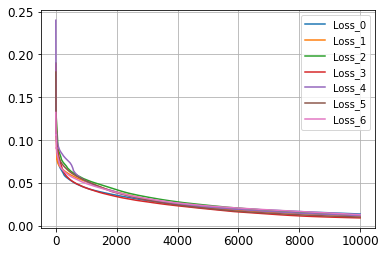

In [ ]:
predict_timelvl2(models_generator[3], n, 3)

ganmodels/E3000/model_vE3000_125b_wganRMS_292_10500.h5
------------------------

458s
MSE Loss:  0.047692847
MAE Loss:  0.37746942


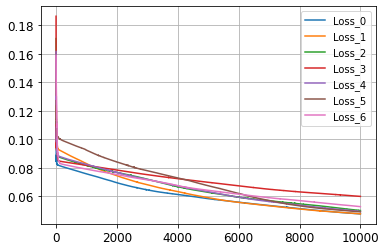

In [ ]:
predict_timelvl2(models_generator[4], n, 4)

ganmodels/E3000/model_vE3000_125b_wganB_292_5500.h5
------------------------

372s
MSE Loss:  0.02620476
MAE Loss:  0.28773504


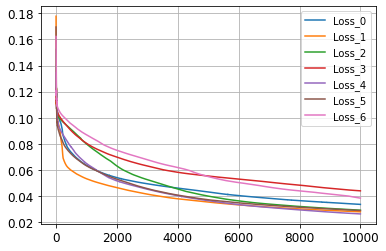

In [ ]:
predict_timelvl2(models_generator[5], n, 5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
------------------------

286s
MSE Loss:  0.0056677125
MAE Loss:  0.085646056


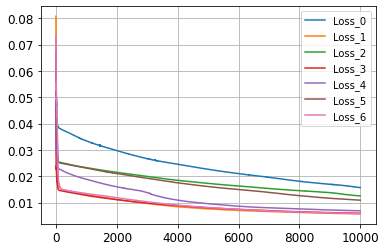

In [ ]:
predict_timelvl2(models_generator[6], n, 6)

**Generated Data**

In [ ]:
def gen_pred_timelvl2(generator, opt_lat_val, model_idx, flag=None):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred2[model_idx] = X_gen
  X_gen = invert_data(X_gen, flag)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), times[:7], 7, c_bar=False, skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
--------------------------



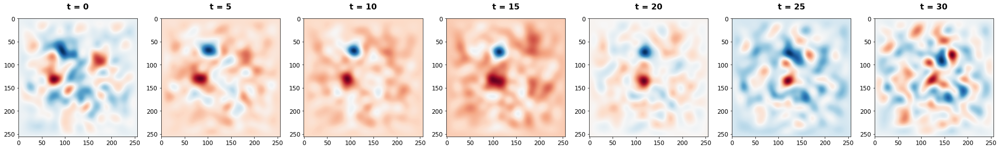

In [ ]:
gen_pred_timelvl2(models_generator[0], models_opt_latent2[0], 0)

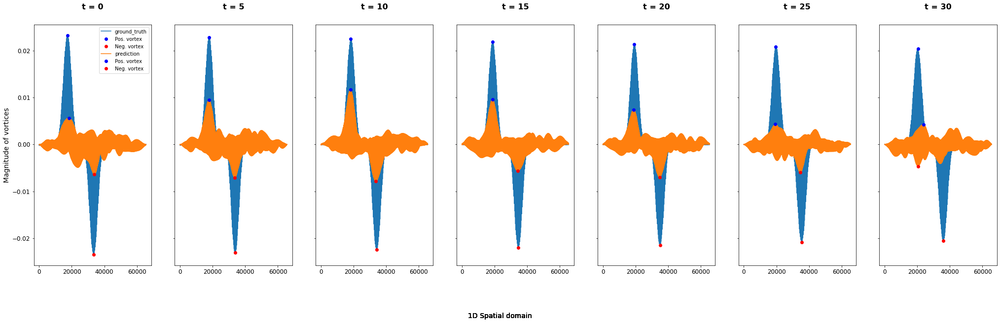

In [ ]:
X_gen = invert_data(models_pred2[0])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
--------------------------



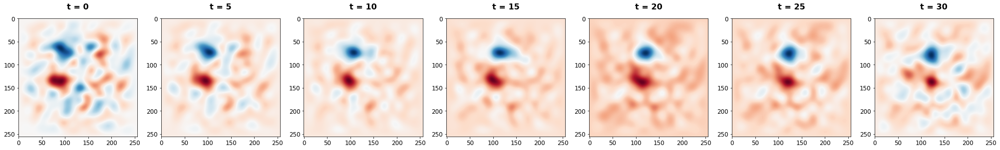

In [ ]:
gen_pred_timelvl2(models_generator[1], models_opt_latent2[1], 1)

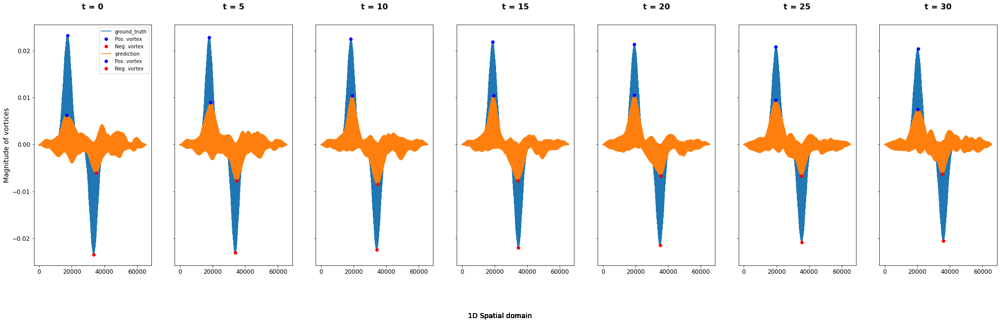

In [ ]:
X_gen = invert_data(models_pred2[1])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
--------------------------



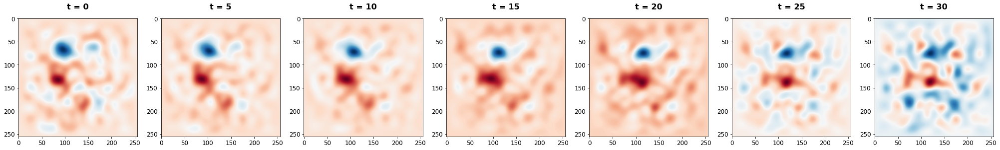

In [ ]:
gen_pred_timelvl2(models_generator[2], models_opt_latent2[2], 2)

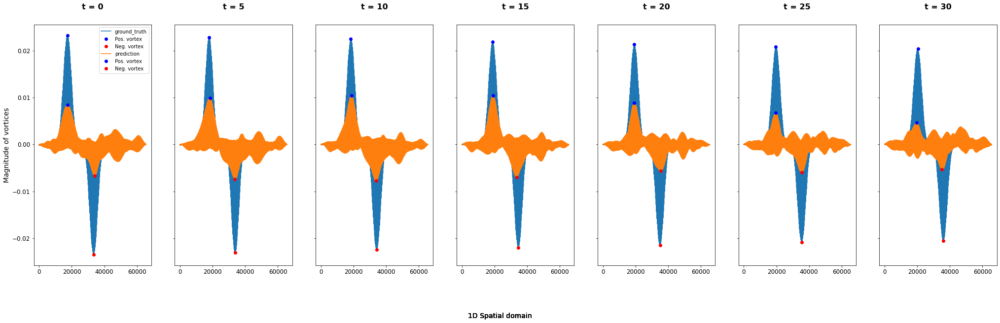

In [ ]:
X_gen = invert_data(models_pred2[2])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------



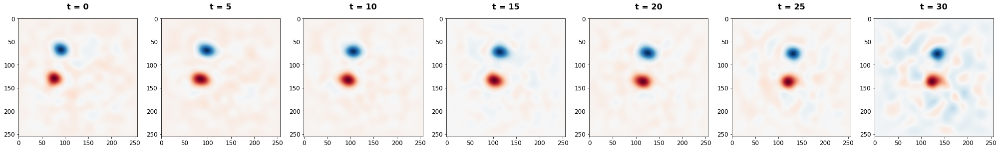

In [ ]:
gen_pred_timelvl2(models_generator[3], models_opt_latent2[3], 3)

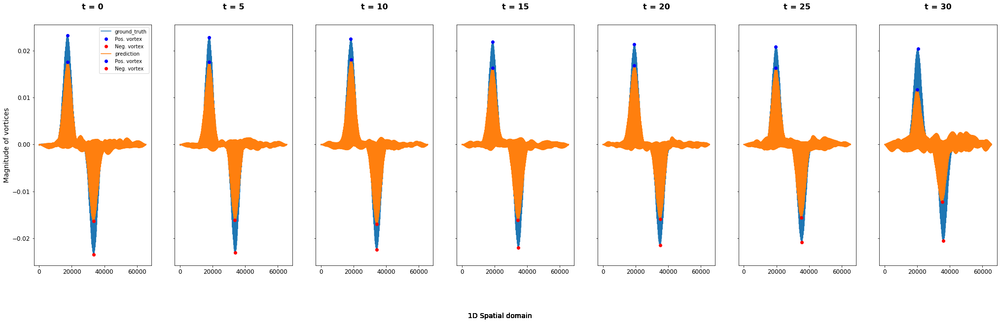

In [ ]:
X_gen = invert_data(models_pred2[3])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_125b_wganRMS_292_10500.h5
--------------------------



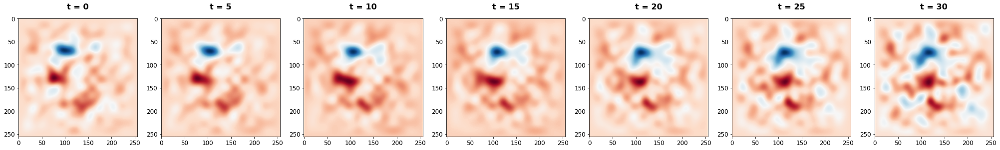

In [ ]:
gen_pred_timelvl2(models_generator[4], models_opt_latent2[4], 4)

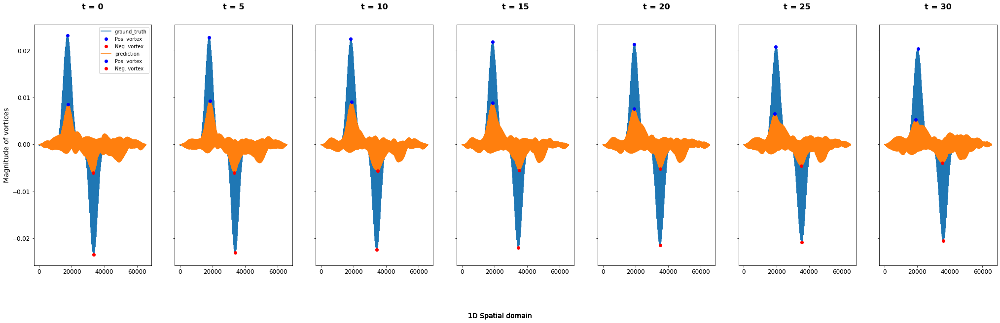

In [ ]:
X_gen = invert_data(models_pred2[4])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_125b_wganB_292_5500.h5
--------------------------



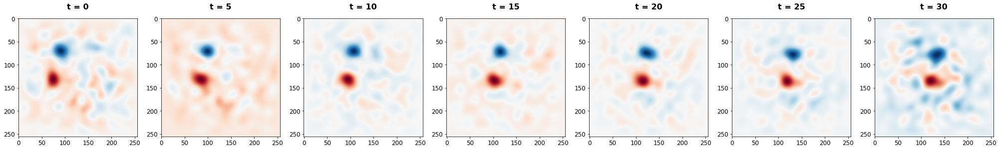

In [ ]:
gen_pred_timelvl2(models_generator[5], models_opt_latent2[5], 5)

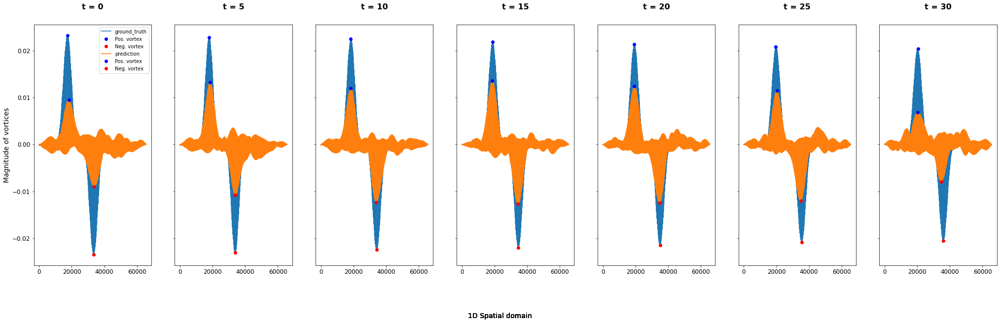

In [ ]:
X_gen = invert_data(models_pred2[5])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_all, 'prediction': X_gen}
plot_linevortex(plot_dict, times[:7], len(times[:7]), skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
--------------------------



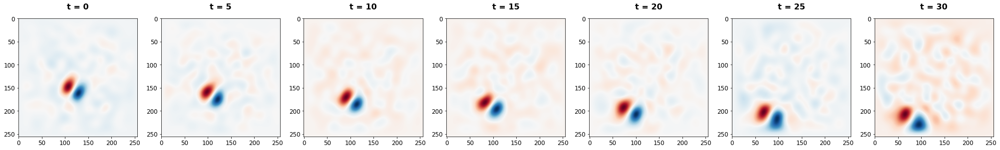

In [ ]:
gen_pred_timelvl2(models_generator[6], models_opt_latent2[6], 6)

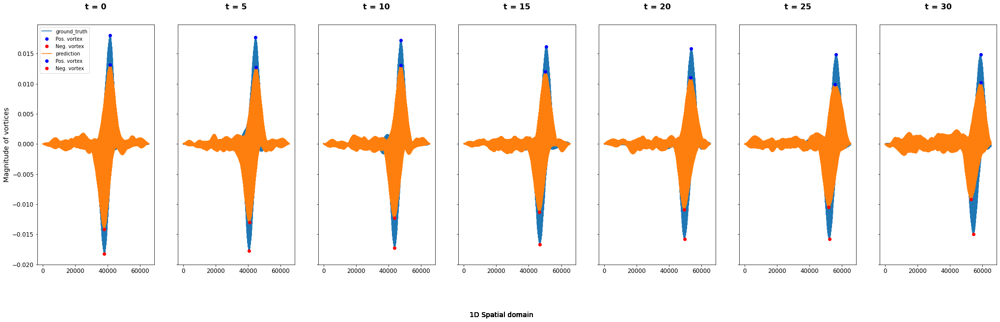

In [ ]:
X_gen = invert_data3(models_pred2[6])
X_gen = X_gen.reshape(ntimes, nx*nx)
plot_dict = { 'ground_truth': X_real2, 'prediction': X_gen}
plot_linevortex(plot_dict, times, len(times), skips=5)

In [ ]:
print(np.max(X_gen[-1]))

0.013330745368535289


### Predict Multiple Points

#### Sample 1

In [ ]:
models_pred_mse_err3 = {}
models_pred_mae_err3 = {}
models_pred_time3 = {}
models_opt_latent3 = {}
model_pred_multiple = {}
model_loss_multiple = {}

In [ ]:
np.random.seed(0)
tf.random.set_seed(0)
latent_size=3000
codings_size = 292

opt_epochs = 10000
weight = tf.constant(pca.singular_values_, dtype=tf.float32)




codings_size = num_of_coeff

optimizer = tf.keras.optimizers.Adam(learning_rate=0.001)
latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))

def predict_timelvl3(generator, n, model_idx):
    list_latent_values = []
    list_loss = []
    start = time.time()
    for i in range(7):

        latent_values = tf.Variable(tf.random.normal([len(real_coding), latent_size]))
        # instantiating prediction optimizer
        pred_optim = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
        opt_latent_values, loss = pred_optim(opt_epochs=opt_epochs, num_call=i)
        list_latent_values.append(opt_latent_values)
        list_loss.append(loss)

    opt_latent_values = list_latent_values[np.argmin(list_loss)]
    # print('Initial point losses: ', end=' - ')
    # print(list_loss)
    time_to_pred = time.time()-start
    print('{:.0f}s'.format( time_to_pred))
  
    l_mse = mse_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    l_mae = mae_loss(generator(opt_latent_values)[:,:(ntimes - 1),:,:], real_coding).numpy()
    print('MSE Loss: ', l_mse)
    print('MAE Loss: ', l_mae)

    models_pred_mse_err3[model_idx] = l_mse
    models_pred_mae_err3[model_idx] = l_mae
    models_pred_time3[model_idx] = time_to_pred
    models_opt_latent3[model_idx] = opt_latent_values



In [ ]:

def predict_multi_timelvl (generator, n, model_idx, pred_for):
    # predict first time level  using existing method.
    print(model_dir_arr[model_idx])
    print('--------------------------')
    print()
    real_coding = X_train_concat_flatten[n].reshape(1,-1)
    real_coding = tf.constant(real_coding[:,:codings_size*(ntimes - 1)])
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    predict_timelvl3(generator, n, model_idx)

    # Generate from the optimized latent value
    latent_values = models_opt_latent3[model_idx]
    X_predict = list(generator(latent_values).numpy().reshape(-1,codings_size))
    gen_predict = X_predict[-1]

    real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,codings_size:]
    real_coding = tf.constant(real_coding)
    real_coding = tf.cast(real_coding, dtype=tf.float32)
    plt.show()

    # continue prediction with opt latent values. create new instance with the optimized latent
    pred_losses = []
    pred_optimMult = Pred_optimizer(generator, real_coding, weight, latent_values, mse_loss, optimizer)
    for i in range(pred_for): 
        start = time.time()
        latent_values, loss = pred_optimMult(opt_epochs=opt_epochs, num_call=i)
        print('Loss iteration '+str(i+1)+': '+str(loss), end=' - ')
        pred_losses.append(loss)    
        gen_predict = generator(latent_values)[:,(ntimes - 1):,:,:].numpy().flatten()
        X_predict.append(gen_predict)
        
        real_coding = np.concatenate((real_coding, gen_predict.reshape(1,-1)), axis=1)[:,codings_size:]
        real_coding = tf.constant(real_coding)
        real_coding = tf.cast(real_coding, dtype=tf.float32)
        print ('{:.0f}s'.format( time.time()-start))
        
    X_predict = np.array(X_predict)
    model_pred_multiple[model_idx] = np.array(X_predict)
    model_loss_multiple[model_idx] = pred_losses

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_39500.h5
--------------------------



KeyboardInterrupt: ignored

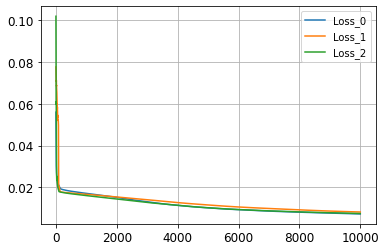

In [ ]:
 predict_multi_timelvl (models_generator[0], n, 0, 3)

In [ ]:
 predict_multi_timelvl (models_generator[1], n, 1, 3)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------

723s
MSE Loss:  0.013916033
MAE Loss:  0.2083946


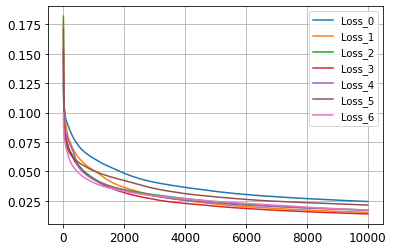

Loss iteration 1: 0.009154252 - 103s
Loss iteration 2: 0.0068761916 - 103s
Loss iteration 3: 0.005778195 - 103s


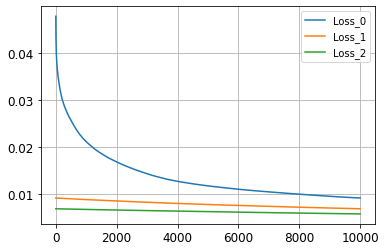

In [ ]:
 predict_multi_timelvl (models_generator[2], n, 2, 3)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
--------------------------

343s
MSE Loss:  0.00996122
MAE Loss:  0.17172523


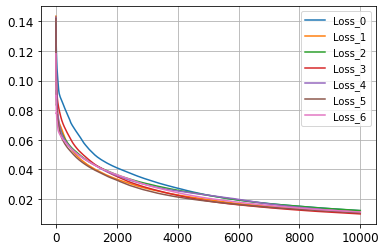

Loss iteration 1: 0.004198652 - 49s
Loss iteration 2: 0.0029271692 - 49s
Loss iteration 3: 0.002337407 - 49s


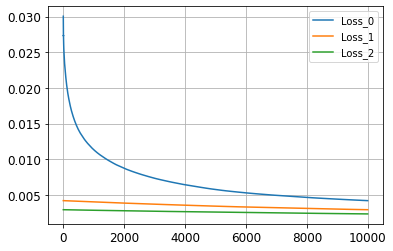

In [ ]:
 predict_multi_timelvl (models_generator[3], n, 3, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
--------------------------

286s
MSE Loss:  0.004362806
MAE Loss:  0.07373511


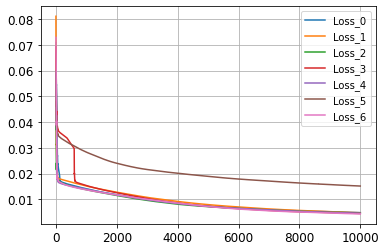

Loss iteration 1: 0.002417316 - 41s
Loss iteration 2: 0.0017883856 - 40s
Loss iteration 3: 0.0014603147 - 40s


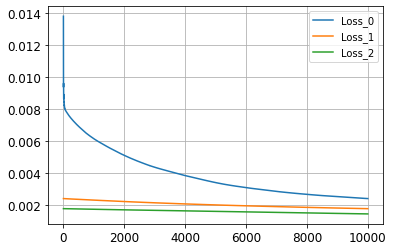

In [ ]:
 predict_multi_timelvl (models_generator[4], n, 4, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
--------------------------

286s
MSE Loss:  0.004426498
MAE Loss:  0.07521378


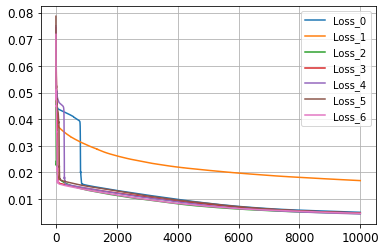

Loss iteration 1: 0.0025822818 - 41s
Loss iteration 2: 0.0019074796 - 40s
Loss iteration 3: 0.0015484573 - 40s


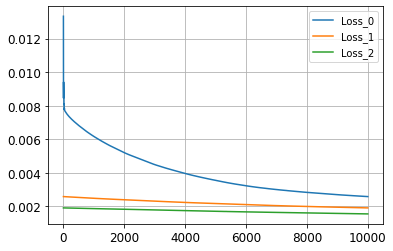

In [ ]:
 predict_multi_timelvl (models_generator[5], n, 5, 3)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_18000.h5
--------------------------

286s
MSE Loss:  0.004031336
MAE Loss:  0.07142349


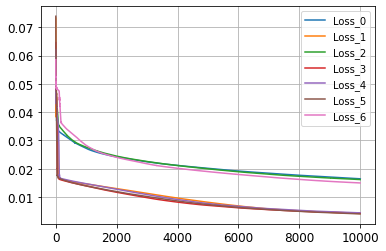

Loss iteration 1: 0.0022345542 - 41s
Loss iteration 2: 0.0015328961 - 40s
Loss iteration 3: 0.0012143792 - 40s


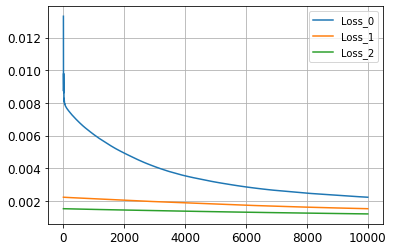

In [ ]:
 predict_multi_timelvl (models_generator[6], n, 6, 3)

**Original Snapshots**

(10, 256, 256)


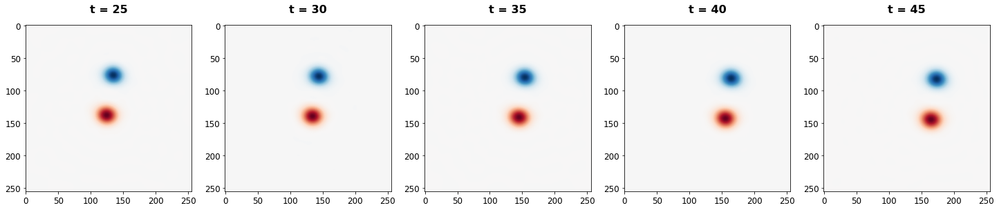

In [ ]:
orig_start = int(n*2.5) # spacing in concatenation is 50/20. Mismatch only for this case
orig_end = orig_start+ 50
X_original = X_train1d_pca_scaled[orig_start:orig_end:5]
X_real_all = invert_data(X_original)
X_real_all = X_real_all.reshape(-1, nx,nx)
print(X_real_all.shape)
plot_vortex(X_real_all, times[-5:],5, 1, skips=5, c_bar=False)

**Generated snapshots**

In [ ]:
def gen_pred_timelvl3(generator, opt_lat_val, model_idx, flag=None):
  print(model_dir_arr[model_idx])
  print('--------------------------')
  print()
  X_gen = generator.predict(np.asarray(opt_lat_val)).reshape(ntimes,codings_size)
  models_pred2[model_idx] = X_gen
  X_gen = invert_data(X_gen, flag)
  X_gen = X_gen.reshape(ntimes, nx*nx)
  plot_vortex(X_gen.reshape(ntimes, nx, nx), times, 7, c_bar=False, skips=5)

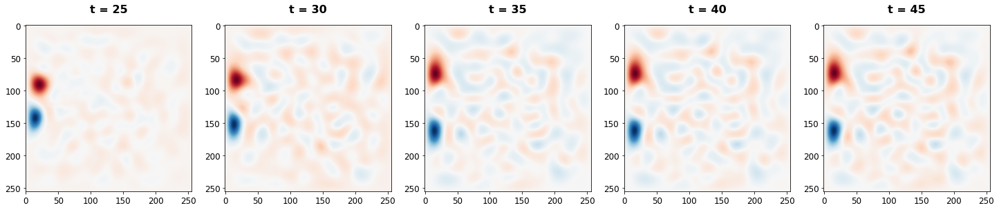

In [ ]:
times = [i for i in range(10)]
X_gen_mult = invert_data3(model_pred_multiple[0]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

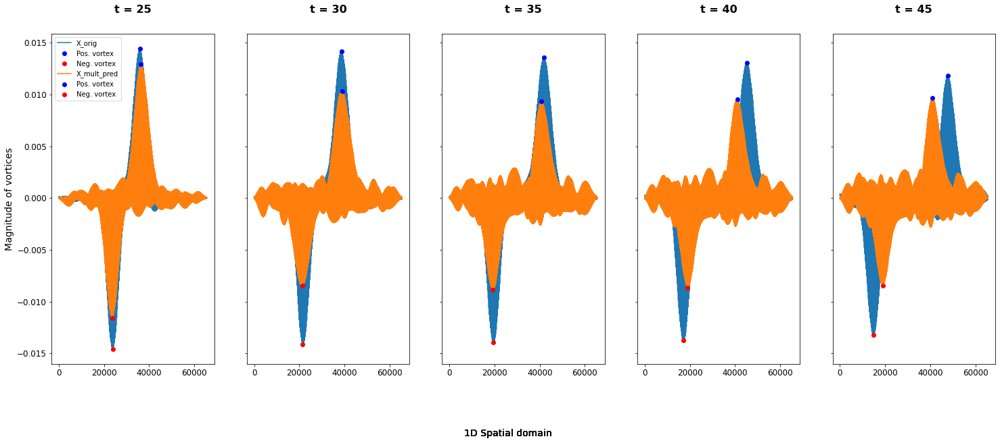

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wganHalfLR_292_second_33500.h5
 --------------------------


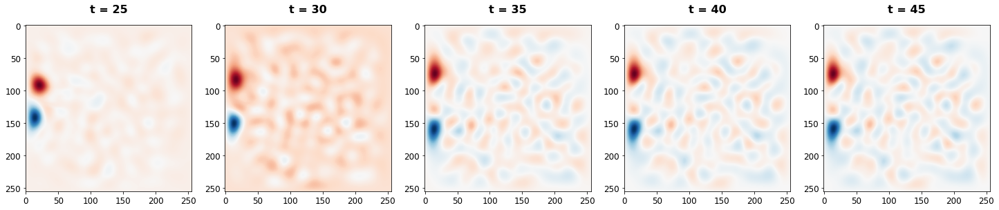

In [ ]:
print (model_dir_arr[1])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[1]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

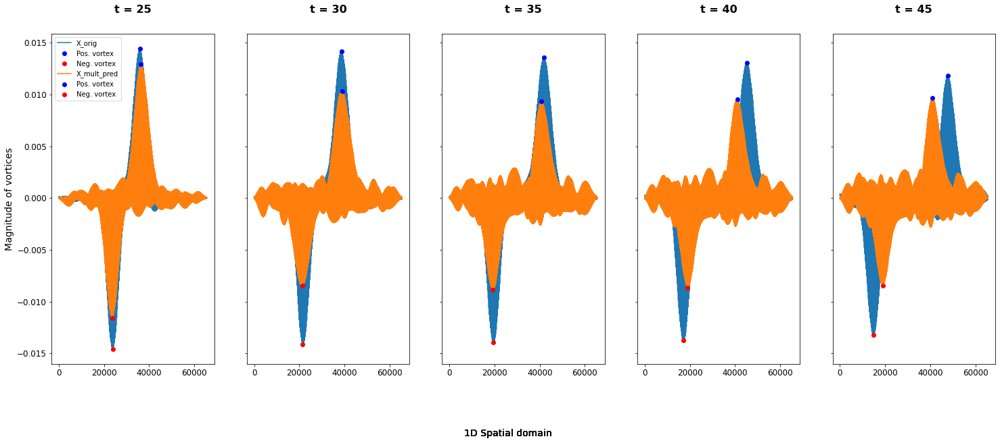

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
 --------------------------


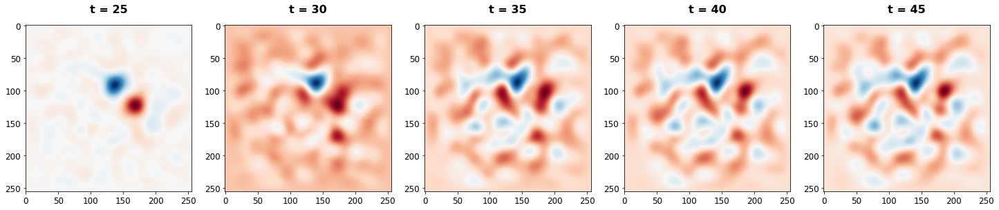

In [ ]:
print (model_dir_arr[2])
print(' --------------------------')
X_gen_mult = invert_data(model_pred_multiple[2]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

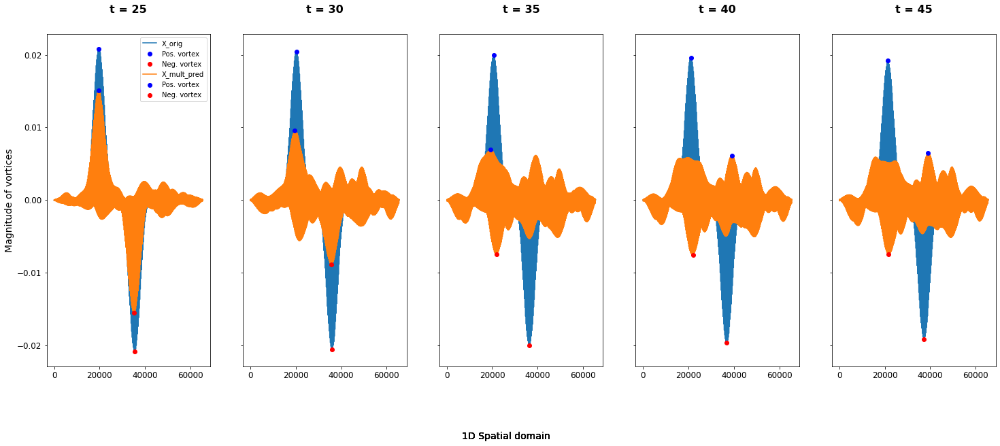

In [ ]:
data_dict = {'X_orig':X_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_64b_wgan_01_292_4500.h5
 --------------------------


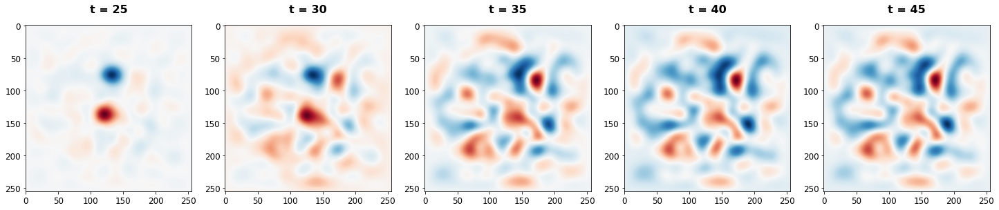

In [ ]:
print (model_dir_arr[3])
print(' --------------------------')
X_gen_mult = invert_data(model_pred_multiple[3]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False)

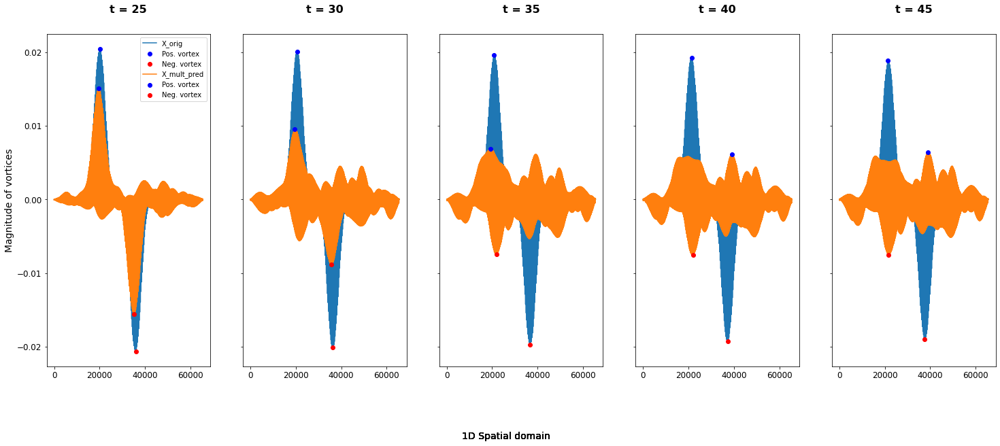

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_11000.h5
 --------------------------


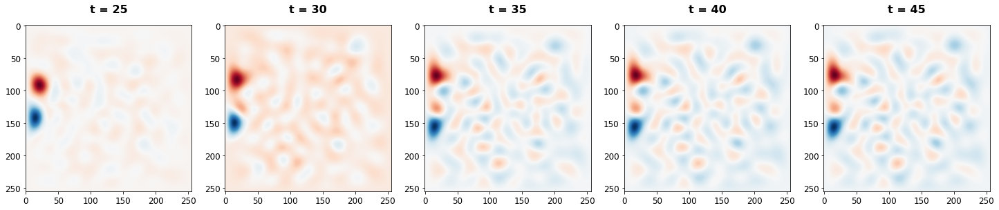

In [ ]:
print (model_dir_arr[4])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[4]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

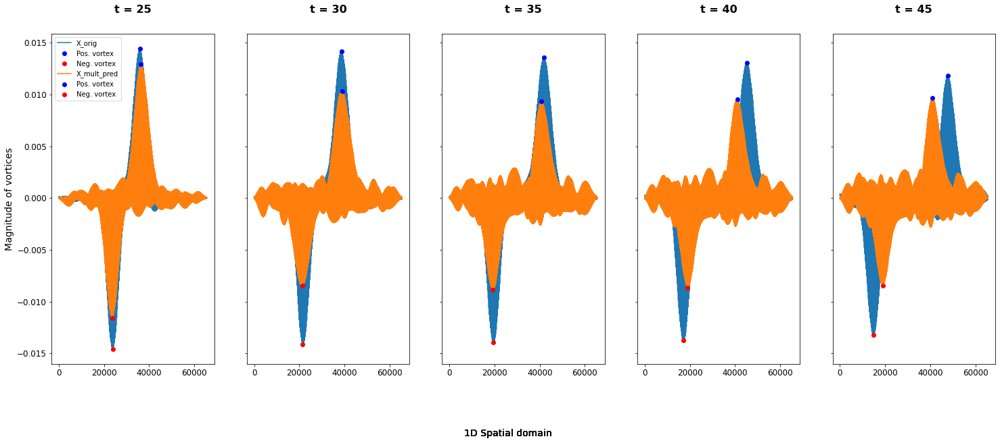

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)

ganmodels/E3000/model_vE3000_125b_wgan_292_second_17000.h5
 --------------------------


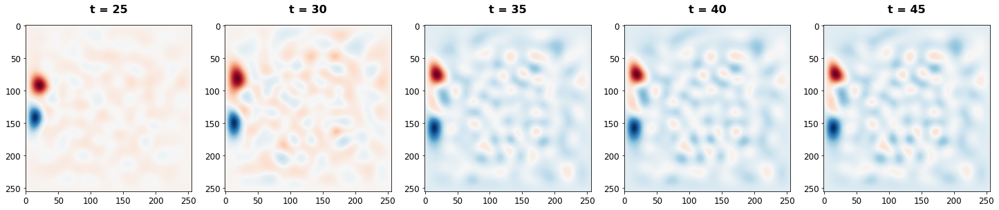

In [ ]:
print (model_dir_arr[5])
print(' --------------------------')
X_gen_mult = invert_data3(model_pred_multiple[5]).reshape(-1, nx, ny)
plot_vortex(X_gen_mult, times[-5:], 5, 1, skips=5, c_bar=False, )

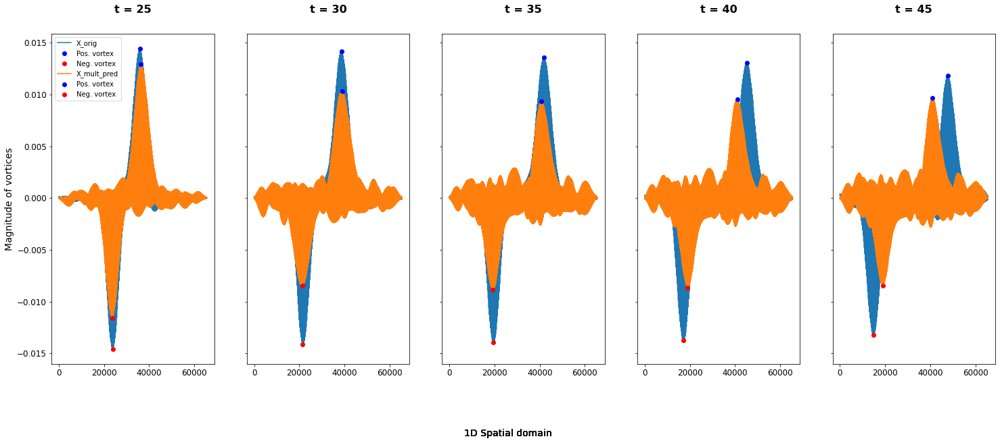

In [ ]:
data_dict = {'X_orig':X_real_all, 'X_mult_pred':X_gen_mult}
plot_linevortex(data_dict, times[-5:], 5, 1, skips=5)